# 1. Building Energy Analytics

# 2. Contributions:

Andrew Ebert - Primary coder and Project Communicator. Worked on loading in DPA and CDHS dataframes to connect to property info dataframe and adjusted expenses to account for inflation. Built webscraping tool to take CDHS property names and convert them to the address in the property info dataframe. Integrated API that gathers weather temperatures for each Month and Year across all indexed counties. Created timeseries plot and yearly totals plot with regression line. Experimented with linear regression model that predicts future year trends (electricity expenses) for each building. Worked on implementing the Auto-ARIMA and evaluated metrics across the various AutoRegressive models.

Silas Torres - Secondary Coder. Loaded dataframes. Explored data visualization functions (e.g. heatmaps, stacked histograms, and year-to-year utility cost change plots).  Documentation of the data analysis and modeling process. Visualization. Modeling - specifically, implementing SARIMAX modeling. Extracted error metrics from SARIMA. Adjusted training model data. Researched SARIMAX relative to data. Used ACF and PACF plots to determine parameters.

Manuela Carrasco - Secondary Coder and Project Manager. Created data frames and functions for data visualization. Collaborated with Mr. Ebert on matching adresses across data frames that allow user to work with data sources. Ensured that matching functions match facility buildings to corresponding addresses. Worked across plotting and visualization display of the data including it's correspoding metrics. Incorporated linear regression model to study cost per square footage over time. Worked on initiating data frames for SARIMA and initialized a model. Plotted model results for SARIMA and SARIMAX.

# 3. Abstract:

We are working with electricity usage cost data provided by the Colorado Office of Susatinability (CoOoS). The datasets consist of the Department of Personnel and Administration (DPA) buildings and the Colorado Department of Human Services (CDHS) buildings, with both dating back to 2015. The goal of this project is to analyze both datasets individually and develop models to predict future cost for each building. These predictions can then help identify the buildings which could benefit most from funding.

# 4. Introduction:

The original motivation of this project, prior to Math Clinic, was to transition Colorado state buildings to more efficient electricity usage through improvements like high efficiency heating and cooling, weatherization, and LED lighing.  The Colorado Office of Sustainability has 28 million square feet of facilities (equivalent to nearly 500 football fields), which incurs substantial energy costs, making it a prime candidate for cost-saving improvements through efficiency upgrades. Ideally, our data analysis can help target buildings most in need of funding, which can then be petitioned, reduce overall electricity costs, and contribute to environmental sustainability.

# Required Files

The required files include files for CDHS data, DPA data, and Property Info data. Another dependent file includes the data to connect property names in the CDHS data to a corresponding address (the notebook does require this data, but if this file doesn't exist, the notebook will run a webscraping script which will generate an excel file to connect property names to address). With this said, each of these files is loaded in with a shareable URL which allows anyone to run this notebook regardless of whether or not they have this data accessbile.

# 5. Methods:

| DF Name                          | Shape       | Memory Usage (bytes) | Dtypes Summary                      |
|----------------------------------|-------------|-----------------------|--------------------------------------|
| `property_info_df`              | (87, 9)     | 78523                | object(9)                            |
| `weather_df`                    | (17, 103)   | 15122                | float64(102), object(1)              |
| `matched_cdhs_df`              | (53, 131)   | 228205               | float64(125), int64(5), object(1)    |
| `matched_dpa_df`               | (18, 131)   | 77264                | float64(124), int64(6), object(1)    |
| `normalized_chds_with_lot_size`| (50, 107)   | 171393               | float64(106), object(1)              |
| `normalized_dpa_with_lot_size`| (9, 107)    | 8397                 | float64(106), object(1)              |
| `comparison_df`                | (7, 10)     | 1126                 | float64(9), object(1)                |



The data types present were primarily numeric, as most of these dataframes contain some variation of cost spent or weather for a building in a given month, season, or year. With this said, our property_info_df contains some non-numeric data, such as building descriptions, city, county, and building type (CDHS or DPA).

Furthermore, we load in four files, which are directly read into dataframes and the metrics can be seen above. The first being our CDHS data, which contains Month, Year expenses for different buildings across the state. Likewise, the DPA data has the same format but for different buildings. We also load in a dataframe that contains more information for these buildings, such as county, square footage, and a building description. Finally, we load in a facility addresses dataframe, which was generated from webscraping the CoOoS site, and allows us to connect generic property names to their corresponding address, which can then be connected to the property info dataframe.

In addition, we are using two different models to analyze our data. The first model is a [Linear Regression Model](#https://colab.research.google.com/drive/1mUIW1MReZ58ljXWe8yqkEfiDYnix22Yb#scrollTo=3AX9WOSs3bF3&line=1&uniqifier=1) where we analyze the relationship between total cost and the year and fit a straight line to the data. While admittedly flawed, we wanted to see the general trends in total electricity costs incured by building by year. The second are [Auto Regressive Models](#https://colab.research.google.com/drive/1mUIW1MReZ58ljXWe8yqkEfiDYnix22Yb#scrollTo=DkkZU7tQD5tz&line=1&uniqifier=1) which are forecasting models that incorporates seasonal effects, trends, and exogenous variables to capture patterns in our data and make predictions based on those patterns. Also, finetuning the parameters to achieve optimal accuracy while addressing the overfitting tradeoff.

## Dependencies

## Installations

In [ ]:
!pip install thefuzz
!pip install seaborn
!pip install statsmodels
!pip install meteostat
!pip install statsforecast
!pip install cpi

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 28.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.4/354.4 kB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 285.8/285.8 kB 22.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 278.2/278.2 kB 22.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.3/62.3 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.3/135.3 kB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.6/18.6 MB 61.4 MB/s eta 0:00:00


##Imports

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.cm as cm
from thefuzz import process # match near-identical strings
import seaborn as sns
import math
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from meteostat import Stations, Monthly
from datetime import datetime
import requests
import textwrap # string formatting
import math
from statsforecast import StatsForecast
from statsforecast.models import AutoARIMA
from statsforecast.arima import arima_string
from scipy.stats import boxcox
import cpi # inflation adjustment
from scipy.stats import linregress
from matplotlib.lines import Line2D

## Functions

### Data Processing/Cleaning Functions

In [ ]:
# Load and clean Property Info

def getPropertyInfoDF():
  file_id = '1N8m2Q-ZODUgClOmogjUgcs2kb1BmaYBJ'
  url = f'https://drive.google.com/uc?id={file_id}'

  # Read the Excel file
  property_df = pd.read_excel(url)

  property_df.columns = property_df.iloc[1]
  property_df = property_df[2:].reset_index(drop=True)

  property_df.dropna(subset=['Street Address'], inplace=True)

  property_df = property_df.dropna(axis=1, how="all") # Dropping Building(s) Sq Ftg since there is no data for any building

  property_df = property_df.drop('Zip Code', axis=1) # Dropping Zip codes for now since only one building as a zip code in the data
  property_df.columns.str.strip() # Removes any whitespace from columns names

  property_df.reset_index(drop=True, inplace=True)

  property_df = property_df.set_index('Street Address')

  return property_df

In [ ]:
# Return duplicates from df

def getDuplicates(data_frame):

  return data_frame[data_frame.index.duplicated(keep=False)]

In [ ]:
# Load Colorado Department of Human Services (CDHS) data

def getDataWithSheets(file_id, url):

  # Read the Excel file
  xls = pd.ExcelFile(url)

  # Load all sheets into a dictionary
  data_info = {
      sheet: (
          xls.parse(sheet)
          .drop(columns=xls.parse(sheet).columns[:2])  # Drop first two columns
          .dropna(how='all')  # Drop rows where all values are NaN
          .reset_index(drop=True)  # Reset index
      )
      for sheet in xls.sheet_names if sheet != "Report Overview"
  }

  # Process each DataFrame
  for sheet_name, df in data_info.items():
      # Set first row as column names and remove it from the DataFrame
      df.columns = df.iloc[0] + (f' {sheet_name}')
      df = df[1:].reset_index(drop=True)  # Drop the first row

      # Drop columns where all values are NaN again, in case there are any
      df.dropna(axis=1, how='all', inplace=True)

      df.columns = df.columns.fillna('')
      df.columns.str.strip() # removes any whitespace from column names

      df.columns.values[0] = 'Address'

      months_to_increment = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun']
      new_columns = []
      for col in df.columns:
          month_year = col.split()  # Split by space to separate month and year
          if len(month_year) == 2 and month_year[0] in months_to_increment:
              month, year = month_year[0], int(month_year[1])
              year += 1  # Increment year for months January to July
              new_columns.append(f'{month} {year}')
          else:
              new_columns.append(col)

      df.columns = new_columns

      # Save changes
      data_info[sheet_name] = df


      print(f'Sheet name: {sheet_name}')
      display(df)

  return data_info

In [ ]:
# Merge multiple df sheets to single df

def getMergedDF(data_with_sheets):
  merged_df = data_with_sheets['2015']

  # Merge the rest of the DataFrames using a for loop
  for year, df in data_with_sheets.items():
      if year != '2015':  # Skip the first year since it's already assigned
          merged_df = pd.merge(merged_df, df, on='Address')


  # Display the merged and cleaned DataFrame
  display(merged_df)

  return merged_df

In [ ]:
# Facility name to address linked using web scraping above

def getFacilityAddresses():
  file_id = '1Ripb6AUci8XHG4M20YNsuQj0ie7ArpHV'
  url = f'https://drive.google.com/uc?id={file_id}'

  # Read the Excel file
  facility_to_address = pd.read_excel(url)

  display(facility_to_address)

  facility_to_address.set_index("Facility Name", inplace=True)

  return facility_to_address

In [ ]:
# Convert facility name to address found in property info df

def convertCDHSFacilityNameToAddress(cdhs_merged_df, facility_to_address):
  for index, row in cdhs_merged_df.iloc[:-1].iterrows():
    facility_name = row['Address']

    if facility_name in facility_to_address.index:  # Ensure the key exists
          cdhs_merged_df.loc[index, "Address"] = facility_to_address.loc[facility_name, "Address"]

  display(cdhs_merged_df)

  return cdhs_merged_df

In [ ]:
# Link address in DPA/CDHS dfs to property info df (using similarity and some manual exclusions due to some incorrect matches)

def get_best_match(address, property_df_index, threshold=85):
    '''Finds the best match for an address from the property_df_index.'''
    best_match, score = process.extractOne(address, property_df_index)
    return best_match if score >= threshold else None

def match_addresses_to_property_info(input_df, property_info_df, address_column='Address', threshold=85):
    '''Matches addresses in input_df to property_info_df using fuzzy matching.'''

    # Create a copy to avoid modifying the original DataFrame
    new_df = input_df.copy()

    # Clean and normalize addresses
    new_df[address_column] = new_df[address_column].str.strip().str.lower()

    # Normalize property addresses and split them
    property_df_index = property_info_df.index.str.strip().str.lower()

    # Function to find best match across split addresses
    def get_best_match_for_property(address, property_df_index, threshold):
        '''Finds the best match by splitting each property address and matching.'''
        best_match = None
        best_score = 0

        for prop_address in property_df_index:
            split_addresses = [part.strip() for part in prop_address.split(',')]  # Split property address into parts
            for part in split_addresses:
                match, score = process.extractOne(address, split_addresses)  # Match against split parts
                if score >= threshold and score > best_score:
                    best_match = prop_address  # Store full original property address
                    best_score = score  # Update best score
        # print(f'Address {address} matched with {best_match}')
        return best_match  # Return the best found match or None

    # Apply fuzzy matching
    new_df['Matched Address'] = new_df[address_column].apply(
        lambda x: get_best_match_for_property(x, property_df_index, threshold)
    )

    # Replace address only if a match is found
    new_df.loc[new_df['Matched Address'].notnull(), address_column] = new_df['Matched Address']

    # Drop the helper column, but keep all rows
    new_df = new_df.drop(columns=['Matched Address'])

    return new_df

In [ ]:
# Month-year columns to seasonal

def convert_columns_to_seasonal_format(df):
    # Create a copy of the DataFrame to avoid modifying the original
    df_copy = df.copy()

    # Store the 'Address' column separately to avoid modification
    address_column = 'Address'

    # Check if the 'Address' column exists in the DataFrame
    if address_column not in df_copy.columns:
        raise ValueError(f"The DataFrame must contain a column named '{address_column}'.")

    # Create a dictionary to store the new column names
    new_columns = []

    # Iterate over the current column names
    for col in df_copy.columns:
        if col == address_column:  # Keep the 'Address' column unchanged
            new_columns.append(col)
        elif 'Total' in col:  # Skip the 'Total' column
            new_columns.append(col)
        else:
            # Split the column name into 'Month Year' format
            month, year = col.split()

            # Get the season corresponding to the month
            season = get_season(month)

            if season:
                # Create the new column name in 'Season-Year' format
                new_column_name = f"{season}-{year}"
                new_columns.append(new_column_name)

    # Update the DataFrame's columns with the new names
    df_copy.columns = new_columns

    return df_copy  # Return the modified copy, not the original df

In [ ]:
# Group seasons for each address

def aggregate_by_season_year(df, address_column='Address'):
    """
    Aggregates the columns by 'Season-Year' and adds the 'Address' column back.

    Parameters:
    - df: pandas DataFrame containing the data.
    - address_column: string, the name of the column that holds the address values (default is 'Address').

    Returns:
    - df: pandas DataFrame with aggregated values for 'Season-Year' columns and 'Address' column retained.
    """
    # Separate the 'Address' column before aggregation
    df_values = df.drop(columns=address_column)

    # Transpose the DataFrame to treat columns as rows
    df_transposed = df_values.T

    # Group by 'Season-Year' (based on splitting the column name at '-')
    df_grouped = df_transposed.groupby(df_transposed.index.str.split('-').str[0] + '-' + df_transposed.index.str.split('-').str[1]).sum()

    # Transpose back to return to the original format (columns as 'Season-Year')
    aggregated_df = df_grouped.T

    # Add the 'Address' column back to the aggregated DataFrame
    aggregated_df[address_column] = df[address_column]

    # Reorder the columns to move 'Address' to the front
    cols = [address_column] + [col for col in aggregated_df.columns if col != address_column]
    aggregated_df = aggregated_df[cols]

    # Return the resulting aggregated DataFrame
    return aggregated_df

In [ ]:
# Convert to seasonal we can work with

def create_seasonal_column_names(df, year_filter=None):
    new_columns = []
    for col in df.columns:
        if 'Total' in col or (year_filter and any(year in col for year in year_filter)):
            continue  # Skip columns with 'Total' and specified years (e.g., 2024, 2025)

        # Ensure that the column name is in the 'Month Year' format
        if len(col.split()) == 2:
            month, year = col.split()  # Split 'Month Year' format into two
            season = get_season(month)
            if season:
                seasonal_col = f"{season}-{year}"
                new_columns.append(seasonal_col)

    return new_columns

def get_season(month):
    season_map = {
        'Dec': 'Winter', 'Jan': 'Winter', 'Feb': 'Winter',
        'Mar': 'Spring', 'Apr': 'Spring', 'May': 'Spring',
        'Jun': 'Summer', 'Jul': 'Summer', 'Aug': 'Summer',
        'Sep': 'Fall', 'Oct': 'Fall', 'Nov': 'Fall'
    }
    return season_map.get(month)

In [ ]:
# Connect lot size from property info df to each address

def add_lot_size_to_matched_df(matched_df, property_info_df):

    '''
    After matching addresses using your fuzzy function, this merges the final lot size (in sq ft) into the dataframe.
    Prioritizes sq ft, but converts acres if needed.
    '''
    # Clean property_info_df index and parse sizes
    prop_df = property_info_df.copy()
    prop_df.index = prop_df.index.str.strip().str.lower()
    prop_df = prop_df[~prop_df.index.duplicated(keep='first')]

    # Clean up lot size fields
    def parse_size(val):
        if pd.isna(val): return np.nan
        if isinstance(val, str): val = val.replace(',', '').lower()
        val = ''.join(filter(lambda x: x.isdigit() or x == '.', str(val)))
        try: return float(val)
        except: return np.nan

    prop_df['Lot Size (sq. ft.)'] = prop_df['Lot Size (sq. ft.)'].apply(parse_size)
    prop_df['Lot Size (Acres)'] = prop_df['Lot Size (Acres)'].apply(parse_size)

    # Calculate final lot size in sq ft
    prop_df['Lot Size (Final SqFt)'] = prop_df['Lot Size (sq. ft.)']
    needs_acres = prop_df['Lot Size (Final SqFt)'].isna() & prop_df['Lot Size (Acres)'].notna()
    prop_df.loc[needs_acres, 'Lot Size (Final SqFt)'] = prop_df.loc[needs_acres, 'Lot Size (Acres)'] * 43560

    # Clean matched_df addresses to match the cleaned property index
    matched_df = matched_df.copy()
    matched_df['Address_cleaned'] = matched_df['Address'].str.strip().str.lower()

    # Merge lot size into matched_df
    merged_df = matched_df.merge(
        prop_df[['Lot Size (Final SqFt)']],
        how='left',
        left_on='Address_cleaned',
        right_index=True
    )

    return merged_df.drop(columns=['Address_cleaned'])

### Property Name to Address Webscraping Function

In [ ]:
# Should only run if you don't have spreadsheet linking CDHS to property info
# Connects CDHS generic property names to address (where addresses are present in property info df and not property names)

!apt-get update
!apt-get install -y chromium-chromedriver
!pip install selenium

from selenium import webdriver
from selenium.webdriver.common.by import By
from selenium.webdriver.common.keys import Keys
from selenium.webdriver.chrome.service import Service
from selenium.webdriver.chrome.options import Options
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC
import time

def webscrapingCDHSToPropertyInfo(cdhs_merged_df):
  # URL for CDHS Property Names to Property Info Addresses
  url = 'https://drive.google.com/uc?id=1Ripb6AUci8XHG4M20YNsuQj0ie7ArpHV'
  response = requests.get(url, timeout=5)

  # Can't access url, runs
  if response.status_code == 200:
    return True

  else:
    # Set up Chrome options
    chrome_options = Options()
    chrome_options.add_argument("--headless")
    chrome_options.add_argument("--no-sandbox")
    chrome_options.add_argument("--disable-dev-shm-usage")

    # Set up ChromeDriver
    driver = webdriver.Chrome(options=chrome_options)

    facility_names = []
    addresses = []

    # Iterate over all but the last row
    for index, row in cdhs_merged_df.iloc[:-1].iterrows():
      facility_name = row['Facility Name']

      # Open the webpage
      driver.get("https://app.energycap.com/app/embedded?key=ZW5jLXB1YmxpYy1kYXNoYm9hcmR8UHJvZHVjdGlvbg%3D%3D.Y29sb3JhZG9fZ2VvfDEwMjQ%3D.NmE0MzM4YmYtNjMyYS00Mjk3LTg5YmEtMDNlMDNmNzc3ODkx&dashboardId=3200&dashboardType=MAP")

      # Wait for page to load
      time.sleep(10)  # Adjust this if needed

      # Find the search box using its ID
      search_box = driver.find_element(By.ID, "searchableListBuildings_searchbox_input")

      # Enter search text
      search_box.send_keys(facility_name)

      # Press ENTER to search
      search_box.send_keys(Keys.RETURN)

      # Wait for results to load
      time.sleep(10)  # Adjust this based on website response time

      try:
          address_element = driver.find_element(By.CLASS_NAME, "text-caption-1")
          address = address_element.text
          address = address.split(',')[0]  # Get the first part of the address
          facility_names.append(facility_name)
          addresses.append(address)

          #print(address)
          #print(facility_name)


      except Exception as e:
          print("Address not found:", str(e))
          facility_names.append(facility_name)
          addresses.append(None)

    driver.quit()

    # Create a DataFrame with the results
    output_df = pd.DataFrame({
        'Facility Name': facility_names,
        'Address': addresses
    })

    # Save to Excel
    output_df.to_excel("Facility_addresses.xlsx", index=False)

Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Hit:7 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:8 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:9 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [8,944 kB]
Get:10 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1,683 kB]
Get:11 http://security.ubuntu.com/ubuntu jammy-security/restricted amd64 Packages [4,363 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:13 https://ppa.launchpadconten

### Plotting Functions

In [ ]:
# Timeseries of each building's electricity expenses by Month-Year

def plotMonthYearByCost(merged_df):
    # Filter out unnecessary columns and rows, excluding 'Total' row
    df_filtered = merged_df.loc[:, ~merged_df.columns.str.contains('Total|2024|2025')]

    # Exclude the 'Total' row safely
    if df_filtered.iloc[-1, 0].strip().lower() == 'total':
        df_filtered = df_filtered.iloc[:-1]

    plt.figure(figsize=(30, 12))

    num_addresses = df_filtered.shape[0]
    color_map = cm.get_cmap('tab20', num_addresses)

    # Plot all addresses with different colors
    for index, (i, row) in enumerate(df_filtered.iterrows()):
        x = row.index[1:]  # Skip Address column
        y = row[1:]        # Skip Address column
        short_label = ' '.join(row['Address'].split()[:10])  # Truncated address label
        color = color_map(index / num_addresses)
        plt.plot(x, y, '.-', label=short_label, color=color)

    plt.xlabel('Month-Year')
    plt.ylabel('Cost (Dollar)')
    plt.yscale('log')
    plt.title('Monthly and Yearly Costs per Address')
    plt.xticks(rotation=90)
    plt.legend(title='Addresses ', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')

    plt.tight_layout()
    plt.show()

    # === Statistical Analysis ===
    #The highest cost is calculated in the plot by summing the costs for each address across all months and then identifying the address with the highest total.
    # Total cost per address
    df_filtered['TotalCost'] = df_filtered.iloc[:, 1:].sum(axis=1)

    # Sort addresses by total cost in descending order and print the DataFrame
    df_sorted_by_cost = df_filtered[['Address', 'TotalCost']].sort_values(by='TotalCost', ascending=False)
    print("\nAddresses Sorted by Total Cost:")
    print(df_sorted_by_cost)

    # Find address with the highest total expense
    highest_expense_address = df_sorted_by_cost.iloc[0]
    print(f"\nAddress with Highest Total Expense: {highest_expense_address['Address']} with ${highest_expense_address['TotalCost']:.2f}")

In [ ]:
# Timeseries of total electricity expenses per building per year

def plot_yearly_totals(df):
    # Unique colors in plot
    color_map = cm.get_cmap("tab20", len(df))

    # Exclude the last row
    df = df.iloc[:-1]

    # Set figure size
    plt.figure(figsize=(30, 6))

    # Lists to store regression info
    addresses = []
    slopes = []
    intercepts = []
    r_squared = []

    for index, row in df.iterrows():
        x = row.index[1:]
        y = row[1:].values

        color = color_map(index)

        # Truncate address to first 5 words
        truncated_label = ' '.join(row['Address'].split()[:5])

        # Plot the data
        plt.plot(x, y, '.-', label=truncated_label, color=color)

        # Convert x to numeric
        x_numeric = np.arange(len(x))
        y_numeric = np.array(y, dtype=np.float64)

        # Linear regression
        result = linregress(x_numeric, y_numeric)
        y_fit = result.slope * x_numeric + result.intercept

        # Plot regression line
        plt.plot(x_numeric, y_fit, '--', color=color)

        # Store regression stats
        addresses.append(truncated_label)
        slopes.append(result.slope)
        intercepts.append(result.intercept)
        r_squared.append(result.rvalue ** 2)

    plt.xlabel('Year')
    plt.ylabel('Cost (Dollars)')
    plt.yscale('log')
    plt.title('Yearly Totals per Address with Linear Regression Line')
    plt.legend(fontsize='small', loc='upper left', bbox_to_anchor=(1, 1))
    plt.xticks(rotation=90)
    plt.show()

    # Create and print summary DataFrame
    summary_df = pd.DataFrame({
        'Address': addresses,
        'Slope': slopes,
        'Intercept': intercepts,
        'R_squared': r_squared
    }).sort_values(by='R_squared', ascending=False)

    display(summary_df)

In [ ]:
# Display heatmap for df

def heatmap(data_frame, y_labels):
  min_year = data_frame.columns.min().year
  max_year = data_frame.columns.max().year

  for year in range(min_year, max_year):
    start_date = pd.Timestamp(year=year, month=7, day=1)
    end_date = pd.Timestamp(year=year + 1, month=6, day=1)

    fiscal_year_df = data_frame.loc[:, (data_frame.columns >= start_date) & (data_frame.columns <= end_date)]
    if not fiscal_year_df.empty:
      fiscal_year_df.columns = [col.strftime('%b %Y') for col in fiscal_year_df.columns]

      plt.figure(figsize=(12,8))
      sns.heatmap(fiscal_year_df, annot=True, fmt=".0f", cmap="YlGnBu", linewidths=0.5, xticklabels=True, yticklabels=y_labels)

      plt.title("Monthly Utility cost per building")
      plt.ylabel("Building")
      plt.xlabel("Month")
      plt.show()

In [ ]:
# Hist of building costs

def plot_histogram(data_frame, x_label, y_label, title_labels):
  cols = 3
  rows = math.ceil(len(data_frame) / cols) # number of rows for subplot

  fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(18, rows * 4))


  for i, (index, row) in enumerate(data_frame.iterrows()):
      ax = axes.flatten()[i]  # Converts 2d array into 1D array

      sns.histplot(row, bins=30, ax=ax, multiple="stack")
      ax.set_title(f"{title_labels.iloc[index]}")
      ax.set_xlabel(x_label)
      ax.set_ylabel(y_label)

  plt.tight_layout()
  plt.show()

In [ ]:
# Shorten plot titles for arbitrarily long address names

def shorten_title(text, max_len=30):
    return text if len(text) <= max_len else text[:max_len] + "..."

In [ ]:
# Year-year total expense change for each building

def plot_yearly_change_histogram(data_frame, x_label, y_label, title_labels):
    df = data_frame.copy()
    df.columns = pd.to_datetime(df.columns)
    yearly_df = df.T.groupby(df.columns.year).sum().T

    year_diff_df = yearly_df.diff(axis=1).iloc[:, 1:]
    year_labels = [f"{y1}→{y2}" for y1, y2 in zip(yearly_df.columns[:-1], yearly_df.columns[1:])]

    # Ensure title_labels has same index
    title_labels.index = data_frame.index

    cols = 3
    rows = math.ceil(len(year_diff_df) / cols)
    fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(20, rows * 4))

    for i, (index, row) in enumerate(year_diff_df.iterrows()):
        ax = axes.flatten()[i]

        row_clean = row.dropna()
        mean_val = row_clean.mean()
        std_val = row_clean.std()

        sns.barplot(x=year_labels, y=row.values, ax=ax)
        ax.axhline(0, color='gray', linestyle='--', linewidth=1)

        title = shorten_title(title_labels.loc[index])
        ax.set_title(f"{title}")

        ax.text(0.95, 0.95, f"Mean: {mean_val:.2f}\nSD: {std_val:.2f}",
                transform=ax.transAxes, ha="right", va="top", fontsize=12,
                bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))

        ax.set_xlabel(x_label)
        ax.set_ylabel(y_label)
        ax.tick_params(axis='x', rotation=45)

    plt.tight_layout()
    plt.show()

In [ ]:
# Stacked hist of all month-year electricity costs for each year (distribution of electricity costs)

def plot_stacked_histogram(data_frame, x_label, y_label, title_labels):
    min_year = data_frame.columns.min().year
    max_year = data_frame.columns.max().year

    # Apply shorten_title to each address
    original_addresses = data_frame.index.tolist()
    short_addresses = [shorten_title(addr) for addr in original_addresses]

    for year in range(min_year, max_year):
        start_date = pd.Timestamp(year=year, month=7, day=1)
        end_date = pd.Timestamp(year=year + 1, month=6, day=1)

        fiscal_year_df = data_frame.loc[:, (data_frame.columns >= start_date) & (data_frame.columns <= end_date)]

        if not fiscal_year_df.empty:
            address_data = []
            valid_labels = []
            for idx, row in fiscal_year_df.iterrows():
                clean_values = row.dropna().values
                if len(clean_values) > 0:
                    address_data.append(clean_values)
                    valid_labels.append(shorten_title(idx))  # Match cleaned data with shortened label

            if len(address_data) == 0:
                continue

            fig, ax = plt.subplots(figsize=(18, 10))

            ax.hist(
                address_data,
                bins=30,
                stacked=True,
                edgecolor='black',
                label=valid_labels,  # Use shortened labels
                alpha=0.85
            )

            all_values = np.concatenate(address_data)
            mean_val = np.mean(all_values)
            median_val = np.median(all_values)

            ax.axvline(mean_val, color='red', linestyle='--', label=f'Mean: {mean_val:.2f}')
            ax.axvline(median_val, color='blue', linestyle='-', label=f'Median: {median_val:.2f}')

            ax.set_title(f"{shorten_title(title_labels)} Fiscal Year {year}-{year+1}")
            ax.set_xlabel(x_label)
            ax.set_ylabel(y_label)
            ax.set_yscale('log')
            if len(valid_labels) > 20:
              ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=4, fontsize='small')
            else:
              ax.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
            plt.tight_layout()
            plt.show()

In [ ]:
# Plot time series normalized by acre

def plot_acre_vs_yearly_cost(df, property_info_df):
  color_map = cm.get_cmap("tab20", len(df))

  plt.figure(figsize=(20, 6))

  for index, row in df.iterrows():
      x = row.index[1:]  # Extract month-year labels
      y = row[1:].values.astype(np.float64)  # Convert values to float64 for calculations

      # Find matching property by address
      best_match, score = process.extractOne(row[0], property_info_df.index)

      # Exclude addresses that don't meet the 90% similarity threshold
      if score < 90:
          print(f"Skipping address '{row[0]}' ")
          continue

      elif pd.isna(property_info_df.loc[best_match, "Lot Size (Acres)"]) and pd.isna(property_info_df.loc[best_match, "Lot Size (sq. ft.)"]):
          print(f"Skipping address '{row[0]}' ")
          continue

      if pd.isna(property_info_df.loc[best_match, "Lot Size (Acres)"]):
          lot_size = property_info_df.loc[best_match, "Lot Size (sq. ft.)"]

      else:
        lot_size = property_info_df.loc[best_match, "Lot Size (Acres)"]
        acre_to_sqft = 43560
        lot_size *= acre_to_sqft

      y /= lot_size

      # Generate color for the plot
      color = color_map(index)

      # Plot the data
      plt.plot(x, y, label=row["Address"], color=color)

  # Configure plot labels and formatting
  plt.xlabel("Month-Year")
  plt.ylabel("Dollar per Square Foot")
  plt.title("Yearly Totals per Square Foot")
  plt.xticks(rotation=90)
#  plt.legend()
  plt.show()

In [ ]:
# Not currently being used

def plot_time_series(df):
  plt.figure(figsize=(30, 10))

  for index, row in df.iterrows():
      x = row.index
      y = row.values

      plt.plot(x, y, '.-', label=str(index))  # Use the address (index) as the label for each line

  plt.xlabel('Month-Year', fontsize=14)
  plt.ylabel('Values', fontsize=14)
  plt.title('Time Series of Values (Summed for Duplicate Addresses)', fontsize=16)

  plt.xticks(rotation=90, fontsize=10)

#  plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10, title="Address")

  plt.tight_layout()

  plt.show()

In [ ]:
# Seasonal plot for each

def plotSeasonalCostPerAddress(merged_df):
    address_column = 'Address'
    addresses = merged_df[address_column]
    shortened_addresses = [shorten_title(addr) for addr in addresses]

    # Filter out unnecessary columns and rows, excluding 'Total' row
    df_filtered = merged_df.loc[:, ~merged_df.columns.str.contains('Total|2024|2025')]


    if 'Total' in df_filtered.iloc[-1].values:
        df_filtered = df_filtered.iloc[:-1]


    fig, axs = plt.subplots(2, 2, figsize=(15, 10))
    axs = axs.flatten()  # Flatten to easily access subplots in a loop

    # Define the seasons for plotting
    seasons = ['Winter', 'Spring', 'Summer', 'Fall']

    # Create a list to hold all labels for the combined legend
    all_labels = []

    # Use a colormap to assign unique colors to each address
    colormap = plt.get_cmap("tab20")  # Use 'tab20' colormap which has many distinct colors
    colors = [colormap(i / len(addresses)) for i in range(len(addresses))]

    for i, season in enumerate(seasons):
        season_columns = [col for col in df_filtered.columns if season in col]
        season_data = df_filtered[season_columns]

        for idx, address in enumerate(addresses):
            row = season_data.iloc[idx]  # Access the row by index
            x = season_data.columns
            y = row
            color = colors[idx]  # Get a unique color for each address
            line, = axs[i].plot(x, y, '.-', label=shortened_addresses[idx], color=color)  # Plot each row with the corresponding address label
            if i == 0:  # Only add labels for the first subplot to avoid repeated legends
                all_labels.append(line)

        # Customize the plot for each season
        axs[i].set_title(f'{season} Data')
        axs[i].set_xlabel('Season-Year')
        axs[i].set_yscale('log')
        axs[i].set_ylabel('Total Utility Cost (Dollars)')

        axs[i].tick_params(axis='x', rotation=45)

    plt.tight_layout()
    fig.legend(
        all_labels,
        shortened_addresses,
        bbox_to_anchor=(1.05, 1),
        loc='upper left',
        fontsize=10,
        title="Address",
        ncol=4
    )
    # Add a single combined legend outside the plot
 #   fig.legend(all_labels, [address for address in addresses], loc='upper left', bbox_to_anchor=(1.05, 1), title="Address")

    plt.show()


    return None

In [ ]:
# Each buildings month/year cost per acre

def plot_acre_vs_monthly_cost(df, property_info_df):

    color_map = plt.colormaps["tab20"](np.linspace(0, 1, len(df)))  # Adjust color mapping based on the number of properties
    plt.figure(figsize=(30, 15))
    df['Address'] = df['Address'].str.strip().str.lower()  # Normalize addresses in df

    matched_df = match_addresses_to_property_info(df, property_info_df)  # Match addresses to the property_info_df using fuzzy matching

    # Loop through each property in the dataframe
    for index, row in matched_df.iterrows():
        x = row.index[1:]  # Extract month-year labels (excluding 'Address')
        y = row[1:].values.astype(np.float64)  # Convert values to float64 for calculations

        address = row['Address'].strip().lower()  # Find matching property data from the property_info_df
        property_data = property_info_df.loc[property_info_df.index.str.strip().str.lower() == address]

        # Skip properties with missing data
        if property_data.empty or (pd.isna(property_data["Lot Size (Acres)"]).all() and pd.isna(property_data["Lot Size (sq. ft.)"]).all()):
            print(f"Missing lot size data for property: {row['Address']}")  # Message for missing data
            continue

        # Get Lot Size (convert acres to square feet if necessary)
        lot_size = property_data["Lot Size (Acres)"].values[0] if not pd.isna(property_data["Lot Size (Acres)"]).all() else property_data["Lot Size (sq. ft.)"].values[0]
        if isinstance(lot_size, (float, int)) and lot_size > 0:
            if not pd.isna(property_data["Lot Size (Acres)"]).all():
                lot_size *= 43560  # Convert acres to square feet
        else:
            print(f"Invalid lot size for property: {row['Address']}")  # Message for invalid lot size
            continue

        y /= lot_size  # Normalize the costs by lot size (cost per square foot)

        # Truncate the address to show only the first 5 words for the legend
        truncated_address = ' '.join(address.split()[:6])

        # Scatter plot with log scale for Y axis
        plt.scatter(x, y, label=truncated_address, color=color_map[index], s=45)  # Use truncated address as the label

        plt.yscale('log')  # Apply log scale to the y-axis

    # Configure plot labels and formatting
    plt.xlabel("Month-Year")
    plt.ylabel("Cost per Square Foot")  # label for log scale
    plt.title("Monthly Cost per Square Foot for Each Property")
    plt.xticks(rotation=90)

    # Place the legend outside the plot to avoid overlap
    plt.legend(loc='upper right', bbox_to_anchor=(1.15, 1), title="Address", fontsize=10, markerscale=1, ncol=1)

    plt.tight_layout()  # Ensure the labels and legend don't overlap
    plt.show()

### Linear Regression Functions

In [ ]:
# Function to calculate MAPE

def mean_absolute_percentage_error(y_true, y_pred):

    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100  # Expressed as a percentage

In [ ]:
# Format dataset

def formatYearlyTotalRegressionDF(df):

    df = df[(df != 0).all(axis=1)]
    df = df[df["Address"] != "total"]

    # Reshape the data from wide to long format
    df = df.melt(id_vars=["Address"], var_name="Year", value_name="Total_Cost")

    # Clean up the "Year" column to remove "Total " prefix
    df["Year"] = df["Year"].str.replace("Total ", "").astype(int)
    return df

In [ ]:
# Train/test split

def trainTestSplitYearly(df):

    train_test_data = {}

    for address, group in df.groupby("Address"):

        X = group["Year"].values.reshape(-1, 1)
        y = group["Total_Cost"].values

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=2/9, random_state=42)

        train_test_data[address] = {
            "X_train": X_train, "X_test": X_test, "y_train": y_train, "y_test": y_test
        }
    return train_test_data

In [ ]:
# Linear regression with MAPE evaluation

def linRegYearly(train_test_data):
    best_models = {}

    for key, value in train_test_data.items():
        X_train = value["X_train"]
        X_test = value["X_test"]
        y_train = value["y_train"]
        y_test = value["y_test"]

        model = LinearRegression()
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        # Get the coefficients
        coefficients = model.coef_

        # Get the intercept
        intercept = model.intercept_

        mape = mean_absolute_percentage_error(y_test, y_pred) # Normalize per output

        mse = mean_squared_error(y_test, y_pred)
        rmse = np.sqrt(mse)
        nrmse = rmse / (np.max(y_test, axis=0) - np.min(y_test, axis=0))

        if mape < 20:  # Setting a threshold for a "good" model (adjustable)
            best_models[key] = mape

        print(f'Metrics for {key}')
        print(f'y = {coefficients}x + {intercept}')
        # print(f'MAPE: {mape:.2f}%')
        print(f'R^2: {r2_score(y_test, y_pred)}')
        # print(f'Mean squared error: {mean_squared_error(y_test, y_pred)}\n')
        print(f'NRMSE: {nrmse}')

    return best_models

### Weather Data Functions

In [ ]:
# Load weather data for each city in properties

def loadWeatherData(df):

  # Clean up city column (ex: some cities are 'Grand Junction, Grand Junction, Grand Junction' due to aggregation)
  df['City'] = df['City'].str.split(',').str[0].str.strip()

  # Find unique cities
  cities = set(df['City'])

  # print(cities)

  results = []


  for city in cities:
    # Get Coordinates for the City
    state = "Colorado"
    url = f"https://nominatim.openstreetmap.org/search?city={city}&state={state}&country=USA&format=json"

    response = requests.get(url, headers={'User-Agent': 'YourAppName'})
    location_data = response.json()[0]

    lat = float(location_data['lat'])
    lon = float(location_data['lon'])

    # Find Nearest Weather Station
    stations = Stations()
    stations = stations.nearby(lat, lon)
    station = stations.fetch(1)

    station_id = station.index[0]
    # print(f"Nearest station: {station_id} - {station.loc[station_id]['name']}")

    # Set Time Period
    start = datetime(2015, 7, 1)
    end = datetime(2023, 12, 31)

    # Fetch Monthly Data
    monthly_data = Monthly(station_id, start, end).fetch()

    # Add year and month columns for grouping
    monthly_data['Year'] = monthly_data.index.year
    monthly_data['Month'] = monthly_data.index.month

    # Group by Year and Month, then calculate the average temperature
    monthly_avg_temp = monthly_data.groupby(['Year', 'Month'])['tavg'].mean().reset_index()

    # Save the result with the city, year, month, and average temperature
    for _, row in monthly_avg_temp.iterrows():
        results.append({
            'City': city,
            'Year': row['Year'],
            'Month': row['Month'],
            'Monthly Average Temp': (row['tavg'] * 9/5) + 32 # Convert to Fahrenheit
        })

  # Convert results to DataFrame
  results_df = pd.DataFrame(results)

  results_df['Month-Year'] = pd.to_datetime(results_df[['Year', 'Month']].assign(DAY=1))

  results_df['Month-Year'] = results_df['Month-Year'].dt.strftime('%B %Y')

  # Sort chronologically
  results_df = results_df.sort_values('Month-Year')

  # Pivot the data, so each row is a city and each column is a 'Month-Year'
  pivoted_df = results_df.pivot_table(index='City', columns='Month-Year', values='Monthly Average Temp')

  pivoted_df = pivoted_df.reindex(columns=sorted(pivoted_df.columns, key=lambda x: pd.to_datetime(x, format='%B %Y')))

  # Reset index for a clean format
  pivoted_df.reset_index(inplace=True)

  # Loop through and fill NaN values with average on city's month averages
  for index, row in pivoted_df.iterrows():
      for column in pivoted_df.columns[1:]:  # Skip 'City' column
          if pd.isna(row[column]):  # If the value is NaN
              target_month = column.split()[0]  # Extract the month name (e.g., "July")

              # Get data for the given city
              city_data = results_df[results_df['City'] == row['City']]

              # Get data for the target month across all years for the city
              month_data = city_data[city_data['Month-Year'].str.contains(target_month)]

              # Check if we have valid data for the given month
              valid_month_data = month_data['Monthly Average Temp'].dropna()

              if not valid_month_data.empty:
                  # Calculate the mean of available data for the target month across all years
                avg_temp = valid_month_data.mean()
                pivoted_df.at[index, column] = avg_temp  # Update the value in the pivoted DataFrame

              else:
                aggregated_avg = pivoted_df[column].dropna().mean()  # Aggregate the mean across all cities for the month
                pivoted_df.at[index, column] = aggregated_avg

  return pivoted_df

In [ ]:
def plotWeatherByCity(df):
    # Set figure size
    plt.figure(figsize=(30, 6))

    # Iterate through each row of the DataFrame
    for index, row in df.iterrows():

        x = row.index[1:]
        y = row[1:]

        plt.plot(x, y, '.-', label=row['City'])  # Plot each row with its address as the label

    plt.xlabel('Month Year')
    plt.ylabel('Temperature (Fahrenheit)')
    plt.title('Temperature (Month-year average) by City')
    plt.yscale('log')
    plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
    plt.legend()
    plt.show()

### SARIMA Modeling Functions

In [ ]:
# Scaling factor for AutoRegressive models to address convergence/small change issues noticed in R^2

global scaling_factor
scaling_factor = 1

In [ ]:
# SARIMA time series modeling to forecast the next 12 months of normalized cost per square foot for each building

def backtest_sarima(data_frame, order=(1, 1, 2), seasonal_order=(1, 1, 1, 6)):
    # Prepare output DataFrames
    forecast_results = []
    failed_buildings = []
    error_metrics = []
    modeled_data = {}

    # Columns to ignore (non-time-series)
    non_date_columns = ['Address', 'Lot Size (Final SqFt)', 'Average Cost/SqFt', 'Cost Growth Rate (slope)', 'R² Score']
    date_columns = [col for col in data_frame.columns if col not in non_date_columns]

    train_end = pd.to_datetime('2022-12-01')
    test_start = pd.to_datetime('2023-01-01')
    test_end = pd.to_datetime('2023-12-01')

    # Loop through each building
    for idx, row in data_frame.iterrows():
        address = row['Address']
        try:
            display(address)

            # Extract time series and prepare index
            ts = row[date_columns].T
            ts = ts * scaling_factor
            ts.index = pd.to_datetime(ts.index)
            ts = ts.astype(float)
            ts.index = ts.index.to_period('M').to_timestamp()
            ts.index.freq = 'MS'

            train_data = ts[ts.index <= train_end]
            test_data = ts[(ts.index >= test_start) & (ts.index <= test_end)]

            print(f"{address}: Training = {len(train_data)}, Testing = {len(test_data)}")

            # Skip if not enough data
            if len(train_data) < 12 or len(test_data) < 1:
                failed_buildings.append((address, "Insufficient data for training or testing."))
                continue

            # Fit SARIMA model
            model = SARIMAX(train_data, order=order, seasonal_order=seasonal_order)
            results = model.fit(disp=False)
            aic = results.aic

            # Forecast for length of test data
            forecast = results.get_forecast(steps=len(test_data))
            forecast_values = forecast.predicted_mean
            conf_int = forecast.conf_int()

            # Store forecast results
            for date, actual, pred, lower, upper in zip(test_data.index, test_data.values, forecast_values.values, conf_int.iloc[:, 0], conf_int.iloc[:, 1]):
                forecast_results.append({
                    'Address': address,
                    'Date': date,
                    'Actual Cost/SqFt': actual,
                    'Forecasted Cost/SqFt': pred,
                    'Lower CI': lower,
                    'Upper CI': upper
                })

            # Evaluation Metrics
            rmse = np.sqrt(mean_squared_error(test_data, forecast_values))
            mae = mean_absolute_error(test_data, forecast_values)
            predicted_r2 = r2_score(test_data, forecast_values)
            modeled_r2 = r2_score(train_data, results.fittedvalues)
            residuals = test_data.values - forecast_values.values
            modeled_data[address] = results.fittedvalues

            error_metrics.append({
                'Address': address,
                'RMSE': rmse,
                'MAE': mae,
                'Predicted R²': predicted_r2,
                'Modeled R²': modeled_r2,
                'Residual Mean': np.mean(residuals),
                'Residual Std': np.std(residuals),
                'AIC': aic
            })

        except Exception as e:
            failed_buildings.append((address, str(e)))

    print('OUT OF LOOP')

    # Create forecast DataFrame
    forecast_df = pd.DataFrame(forecast_results)
    forecast_df = forecast_df.sort_values(by=['Address', "Date"]).reset_index(drop=True)

    print("Backtesting complete.")
    print(f"Buildings failed to forecast: {len(failed_buildings)}")
    display(failed_buildings)

    return forecast_df, failed_buildings, ts, error_metrics, modeled_data

In [ ]:
# Plots ACF/PACF metrics for each building

def plot_ACF_PACF(ts, address, lags, differenced=True):
  fig, ax = plt.subplots(1, 2, figsize=(15, 5))
  plot_acf(ts, lags=lags, ax=ax[0])
  plot_pacf(ts, lags=lags, ax=ax[1])

  ax[0].set_title(f'ACF {address}')
  ax[1].set_title(f'PACF {address}')
  plt.show()

In [ ]:
# Define the backtest function with weather data as exogenous

def backtest_sarima_weather(data_frame, weather_df, order=(1, 1, 2), seasonal_order=(1, 1, 1, 6)):

    # Prepare output DataFrames
    forecast_results = []
    failed_buildings = []
    error_metrics = []
    modeled_data = {}

    # Columns to ignore (non-time-series)
    non_date_columns = ['Address', 'Lot Size (Final SqFt)', 'Average Cost/SqFt', 'Cost Growth Rate (slope)', 'R² Score', 'City']
    date_columns = [col for col in data_frame.columns if col not in non_date_columns]

    # Define train and test date ranges
    train_end = pd.to_datetime('2022-12-01')
    test_start = pd.to_datetime('2023-01-01')
    test_end = pd.to_datetime('2023-12-01')

    # Loop through each building
    for idx, row in data_frame.iterrows():
        address = row['Address']
        try:
            # Extract time series
            ts = row[date_columns].T
            ts.index = pd.to_datetime(ts.index)
            ts = ts.astype(float)
            ts.index = ts.index.to_period('M').to_timestamp()
            ts.index.freq = 'MS'

            # Match city from property_info_df (assumes it's defined globally)
            normalized_address = address.lower()
            address_index_lower = property_info_df.index.str.lower()
            matching_rows = property_info_df[address_index_lower == normalized_address]

            if not matching_rows.empty:
                city = matching_rows.iloc[0]['City']
                weather_row = weather_df[weather_df['City'].str.lower() == city.lower()]
                if weather_row.empty:
                    failed_buildings.append((address, "No weather data found for city."))
                    continue
                weather_data = weather_row[date_columns].values.flatten()
            else:
                failed_buildings.append((address, "Address not found in property_info_df."))
                continue

            # Split time series
            train_data = ts[ts.index <= train_end]
            test_data = ts[(ts.index >= test_start) & (ts.index <= test_end)]

            if len(train_data) < 12 or len(test_data) < 1:
                failed_buildings.append((address, "Insufficient data for training or testing."))
                continue

            # Align exogenous variables
            train_exog = weather_data[ts.index <= train_end]
            test_exog = weather_data[(ts.index >= test_start) & (ts.index <= test_end)]

            # Fit SARIMAX model
            model = SARIMAX(train_data, exog=train_exog, order=order, seasonal_order=seasonal_order)
            results = model.fit(disp=False)
            aic = results.aic

            # Forecast
            forecast = results.get_forecast(steps=len(test_data), exog=test_exog)
            forecast_values = forecast.predicted_mean
            conf_int = forecast.conf_int()

            # Store forecasts
            for date, actual, pred, lower, upper in zip(test_data.index, test_data.values, forecast_values.values, conf_int.iloc[:, 0], conf_int.iloc[:, 1]):
                forecast_results.append({
                    'Address': address,
                    'Date': date,
                    'Actual Cost/SqFt': actual,
                    'Forecasted Cost/SqFt': pred,
                    'Lower CI': lower,
                    'Upper CI': upper
                })

            # Store metrics
            rmse = np.sqrt(mean_squared_error(test_data, forecast_values))
            mae = mean_absolute_error(test_data, forecast_values)
            predicted_r2 = r2_score(test_data, forecast_values)
            modeled_r2 = r2_score(train_data, results.fittedvalues)
            residuals = test_data.values - forecast_values.values
            modeled_data[address] = results.fittedvalues

            error_metrics.append({
                'Address': address,
                'RMSE': rmse,
                'MAE': mae,
                'Predicted R²': predicted_r2,
                'Modeled R²': modeled_r2,
                'Residual Mean': np.mean(residuals),
                'Residual Std': np.std(residuals),
                'AIC': aic
            })

        except Exception as e:
            failed_buildings.append((address, str(e)))

    print('OUT OF LOOP *****************************************************************')

    forecast_df = pd.DataFrame(forecast_results).sort_values(by=['Address', 'Date']).reset_index(drop=True)
    display(forecast_df)
    display(pd.DataFrame(error_metrics))
    print("Backtesting complete.")
    print(f"Buildings failed to forecast: {len(failed_buildings)}")
    display(failed_buildings)

    return forecast_df, failed_buildings, ts, error_metrics, modeled_data

In [ ]:
# Auto-ARIMA used to finetune parameters for optimal model (weather data not used as exogenous var here)

def backtest_auto_arima(data_frame, seasonal=True, m=12):
    forecast_results = []
    failed_buildings = []
    error_metrics = []
    modeled_data = {}

    non_date_columns = ['Address', 'Lot Size (Final SqFt)', 'Average Cost/SqFt', 'Cost Growth Rate (slope)', 'R² Score']
    date_columns = [col for col in data_frame.columns if col not in non_date_columns]

    train_end = pd.to_datetime('2022-12-01')
    test_start = pd.to_datetime('2023-01-01')
    test_end = pd.to_datetime('2023-12-01')

    for idx, row in data_frame.iterrows():
        address = row['Address']
        try:
            print(f"Processing {address}")

            ts = row[date_columns].T
            ts = ts * scaling_factor
            ts.index = pd.to_datetime(ts.index)
            ts = ts.astype(float)
            ts.index = ts.index.to_period('M').to_timestamp()
            ts.index.freq = 'MS'

            train_data = ts[ts.index <= train_end]
            test_data = ts[(ts.index >= test_start) & (ts.index <= test_end)]

            if len(train_data) < 12 or len(test_data) < 1:
                failed_buildings.append((address, "Insufficient data"))
                continue

            # Prepare StatsForecast-compatible DataFrame
            df_train = pd.DataFrame({
                'ds': train_data.index,
                'y': train_data.values,
                'unique_id': address
            })

            # Initialize and fit the AutoARIMA model
            sf = StatsForecast(models=[AutoARIMA(season_length=m, trace=True)], freq='MS', n_jobs=1, verbose=2)
            sf.fit(df=df_train)

            # Access the fitted model and extract AIC
            fitted_model = sf.fitted_[0, 0].model_  # Access the fitted ARIMA model
            best_aic = fitted_model['aic']

            # Forecast with the fitted model
            df_forecast = sf.forecast(df=df_train, h=len(test_data), level=[90], fitted=True)
            fitted_df = sf.forecast_fitted_values()

            print(f'Optimal parameters: {arima_string(fitted_model)}')

            # Extract forecast values
            forecast_values = df_forecast['AutoARIMA'].values
            lower_ci = df_forecast['AutoARIMA-lo-90'].values
            upper_ci = df_forecast['AutoARIMA-hi-90'].values

            # Store forecast results
            for date, actual, pred, lower, upper in zip(test_data.index, test_data.values, forecast_values, lower_ci, upper_ci):
                forecast_results.append({
                    'Address': address,
                    'Date': date,
                    'Actual Cost/SqFt': actual,
                    'Forecasted Cost/SqFt': pred,
                    'Lower CI': lower,
                    'Upper CI': upper
                })

            # Calculate metrics
            rmse = np.sqrt(mean_squared_error(test_data, forecast_values))
            mae = mean_absolute_error(test_data, forecast_values)
            predicted_r2 = r2_score(test_data, forecast_values)

            # Get in-sample fitted values
            fitted_values = fitted_df[fitted_df['unique_id'] == address]['AutoARIMA'].values

            modeled_r2 = r2_score(train_data, fitted_values)
            modeled_data[address] = pd.Series(fitted_values, index=train_data.index)

            residuals = test_data.values - forecast_values

            # Store error metrics
            error_metrics.append({
                'Address': address,
                'RMSE': rmse,
                'MAE': mae,
                'Predicted R²': predicted_r2,
                'Modeled R²': modeled_r2,
                'Residual Mean': np.mean(residuals),
                'Residual Std': np.std(residuals),
                'AIC': best_aic  # Add AIC to error metrics
            })

        except Exception as e:
            failed_buildings.append((address, str(e)))

    # Print and display results
    forecast_df = pd.DataFrame(forecast_results).sort_values(by=['Address', 'Date']).reset_index(drop=True)
    print("StatsForecast ARIMA backtesting complete.")
    print(f"Buildings failed: {len(failed_buildings)}")
    display(failed_buildings)

    return forecast_df, failed_buildings, ts, error_metrics, modeled_data

In [ ]:
"""
Plot SARIMA/SARIMAX results with observed, modeled, and forecasted data per building.
Works for single buildings, subsets, or full datasets with varying columns.
"""

def plot_sarima_results(buildings_df, forecast_df, modeled_data, error_metrics, title,
                         scaling_factor=1.0, use_log_scale=True, include_legend=True,
                         include_ci=False, ci_alpha=0.2, max_label_width=25):

    plt.figure(figsize=(18, 10))
    plotted_labels = set()

    # Dynamically detect non-time-series columns to exclude
    possible_static_cols = ['Address', 'Lot Size (Final SqFt)', 'Average Cost/SqFt',
                            'Cost Growth Rate (slope)', 'R² Score', 'City']
    static_cols = [col for col in possible_static_cols if col in buildings_df.columns]

    for idx, row in buildings_df.iterrows():
        address = row['Address']

        try:
            # --- Validate that error metrics exist ---
            error_row = next((m for m in error_metrics if m['Address'].strip().lower() == address.strip().lower()), None)
            if error_row is None:
                print(f"Skipping {address} due to missing metrics.")
                continue

            predicted_r2 = error_row.get('Predicted R²', None)
            modeled_r2 = error_row.get('Modeled R²', None)
            aic = error_row.get('AIC', None)

            # Build label only with available components
            metric_parts = []
            if predicted_r2 is not None:
                metric_parts.append(f"Pred. R²={predicted_r2:.2f}")
            if modeled_r2 is not None:
                metric_parts.append(f"Mod. R²={modeled_r2:.2f}")
            if aic is not None:
                metric_parts.append(f"AIC={aic:.1f}")
            label = f"{textwrap.shorten(address, width=max_label_width)} ({', '.join(metric_parts)})"

            # Get time series (everything except static cols)
            y = row.drop(static_cols, errors='ignore')
            y.index = pd.to_datetime(y.index)
            y_values = pd.to_numeric(y.values, errors='coerce')

            # Plot observed data
            line, = plt.plot(y.index, y_values, 'x', alpha=0.4)
            line_color = line.get_color()

            # Plot modeled data
            if address in modeled_data:
                fitted = modeled_data[address]
                fitted.index = pd.to_datetime(fitted.index)
                plt.plot(fitted.index, fitted.values / scaling_factor, linestyle='-', color=line_color, alpha=0.8, label=label)

                # Plot confidence interval if enabled
                if include_ci:
                    ci_upper = fitted.values + 0.1 * fitted.values  # Example upper bound
                    ci_lower = fitted.values - 0.1 * fitted.values  # Example lower bound
                    plt.fill_between(fitted.index, ci_lower / scaling_factor, ci_upper / scaling_factor,
                                     color=line_color, alpha=ci_alpha, label=f"{label} CI")

            # Plot forecast
            building_forecast = forecast_df[forecast_df['Address'].str.lower() == address.lower()]
            if not building_forecast.empty:
                plt.plot(building_forecast['Date'], building_forecast['Forecasted Cost/SqFt'] / scaling_factor,
                         linestyle='--', color=line_color, alpha=0.6)

            plotted_labels.add(address)

        except Exception as e:
            print(f"Skipping {address} due to error: {e}")
            continue

    # Custom legend lines
    custom_lines = [
        Line2D([0], [0], marker='x', color='gray', linestyle='None', label='Observed'),
        Line2D([0], [0], color='gray', linestyle='-', label='Modeled'),
        Line2D([0], [0], color='gray', linestyle='--', label='Forecasted')
    ]

    # De-duplicate plotted handles
    handles, labels = plt.gca().get_legend_handles_labels()
    seen = set()
    unique_handles = []
    for h, l in zip(handles, labels):
        if l not in seen:
            unique_handles.append(h)
            seen.add(l)

    if include_legend:
        plt.legend(handles=custom_lines + unique_handles, title='Legend', fontsize=9, loc='lower left')

    # Plot styling
    plt.title(title, fontsize=16)
    plt.xlabel('Year', fontsize=12)
    plt.ylabel('Cost per SqFt ($)', fontsize=12)
    if use_log_scale:
        plt.yscale('log')
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()

In [ ]:
# Plot SARIMA/SARIMAX results with observed, modeled, and forecasted data for specific building

def plot_single_building_forecast(building_name,
                                   historical_df,
                                   forecast_df,
                                   modeled_data,
                                   error_metrics,
                                   scaling_factor=1.0,
                                   custom_title=None):  # Make sure this is included!
    import matplotlib.pyplot as plt
    from matplotlib.lines import Line2D

    building_name_clean = building_name.strip().lower()

    # 1. Get error metrics
    building_metrics = next(
        (m for m in error_metrics if m['Address'].strip().lower() == building_name_clean),
        None
    )
    if building_metrics is None:
        print(f" Metrics not found for '{building_name}'.")
        return

    # 2. Get historical time series
    historical_df = historical_df.set_index('Address')
    if building_name not in historical_df.index:
        print(f"Building '{building_name}' not found in the historical data.")
        return

    ts = historical_df.loc[building_name].drop([
        'Lot Size (Final SqFt)', 'Average Cost/SqFt',
        'Cost Growth Rate (slope)', 'R² Score', 'City'
    ], errors='ignore')

    ts.index = pd.to_datetime(ts.index)

    # 3. Get forecast data
    building_forecast = forecast_df[forecast_df['Address'].str.lower() == building_name_clean]
    if building_forecast.empty:
        print(f" No forecast found for '{building_name}'.")
        return

    # 4. Plot all components
    plt.figure(figsize=(14, 6))
    plt.plot(ts.index, ts.values, 'x', color='blue', label='Observed')

    if building_name in modeled_data:
        fitted = modeled_data[building_name]
        plt.plot(fitted.index, fitted.values / scaling_factor, linestyle='-', color='blue', label='Modeled')

    plt.plot(
        building_forecast['Date'],
        building_forecast['Forecasted Cost/SqFt'] / scaling_factor,
        linestyle='--',
        color='red',
        label='Forecasted'
    )

    plt.fill_between(
        building_forecast['Date'],
        building_forecast['Lower CI'] / scaling_factor,
        building_forecast['Upper CI'] / scaling_factor,
        color='pink',
        alpha=0.3,
        label='Confidence Interval'
    )

    title = custom_title if custom_title else f'Historical, Modeled, and Forecasted Cost/SqFt – {building_name}'
    plt.title(title)
    plt.xlabel('Year')
    plt.ylabel('Cost per SqFt ($)')
    plt.grid(True)

    custom_lines = [
        Line2D([0], [0], marker='x', color='blue', linestyle='None', label='Observed'),
        Line2D([0], [0], color='blue', linestyle='-', label='Modeled'),
        Line2D([0], [0], color='red', linestyle='--', label='Forecasted'),
        Line2D([0], [0], color='pink', linestyle='-', linewidth=10, alpha=0.3, label='Confidence Interval')
    ]
    plt.legend(handles=custom_lines, title="Legend", loc='lower left')

    metrics_text = (
        f"Predicted R² = {building_metrics.get('Predicted R²', float('nan')):.5f}\n"
        f"Modeled R² = {building_metrics.get('Modeled R²', float('nan')):.5f}\n"
        f"RMSE = {building_metrics.get('RMSE', float('nan')):.5f}\n"
        f"MAE = {building_metrics.get('MAE', float('nan')):.5f}\n"
        f"Residual Mean = {building_metrics.get('Residual Mean', float('nan')):.5f}\n"
        f"Residual Std = {building_metrics.get('Residual Std', float('nan')):.5f}\n"
        f"AIC = {building_metrics.get('AIC', float('nan')):.5f}" if 'AIC' in building_metrics else "AIC = N/A"
    )

    plt.gca().text(
        0.02, 0.95, metrics_text,
        transform=plt.gca().transAxes,
        fontsize=12,
        verticalalignment='top',
        bbox=dict(boxstyle='round', facecolor='white', alpha=0.7)
    )

    plt.tight_layout()
    plt.show()

In [ ]:
"""
Group buildings into R²-based categories for plotting.
Returns a dictionary of category name → list of rows (as dicts).
"""

def group_buildings_by_r2(data_df, error_df):

    # Normalize address for both
    data_df['Address'] = data_df['Address'].str.strip().str.lower()
    error_df['Address'] = error_df['Address'].str.strip().str.lower()

    # Define R² categories
    categories = {
        'Excellent (Predicted R² ≥0.9)': [],
        'Good (Predicted R² 0.75–0.9)': [],
        'Moderate (Predicted R² 0.5–0.75)': [],
        'Weak (Predicted R² 0.25–0.5)': [],
        'Very Weak (Predicted R² 0–0.25)': [],
        'Below Baseline (Predicted R² <0)': []
    }

    for idx, row in data_df.iterrows():
        address = row['Address']
        building_metrics = error_df[error_df['Address'] == address]

        if building_metrics.empty:
            continue

        r2 = building_metrics['Predicted R²'].iloc[0]

        # Assign to the right group
        if r2 >= 0.9:
            categories['Excellent (Predicted R² ≥0.9)'].append(row)
        elif r2 >= 0.75:
            categories['Good (Predicted R² 0.75–0.9)'].append(row)
        elif r2 >= 0.5:
            categories['Moderate (Predicted R² 0.5–0.75)'].append(row)
        elif r2 >= 0.25:
            categories['Weak (Predicted R² 0.25–0.5)'].append(row)
        elif r2 >= 0:
            categories['Very Weak (Predicted R² 0–0.25)'].append(row)
        else:
            categories['Below Baseline (Predicted R² <0)'].append(row)

    # Convert each category to list of dicts
    return {k: [r for r in v] for k, v in categories.items() if len(v) > 0}

In [ ]:
# Plots like above grouped by Predicted R^2 metric

def plot_grouped_sarima_results(categories,
                                 error_df,
                                 forecast_df,
                                 modeled_data,
                                 scaling_factor=1.0,
                                 title_prefix=""):


    for category_name, buildings in categories.items():
        if len(buildings) == 0:
            continue

        plt.figure(figsize=(16, 8))
        plotted_labels = set()

        for row in buildings:
            address = row['Address']
            try:
                error_row = error_df[error_df['Address'].str.lower() == address.lower()]
                if error_row.empty:
                    raise ValueError(f"No error metrics for {address}")

                predicted_r2 = error_row['Predicted R²'].iloc[0]
                modeled_r2 = error_row['Modeled R²'].iloc[0]
                aic = error_row['AIC'].iloc[0]

                if address not in plotted_labels:
                    label = f"{textwrap.shorten(address, width=20, placeholder='...')} (Pred. R²={predicted_r2:.2f}, Mod. R²={modeled_r2:.2f}, AIC={aic:.2f})"
                    plotted_labels.add(address)

                y = row.drop([
                    'Address', 'Lot Size (Final SqFt)', 'Average Cost/SqFt',
                    'Cost Growth Rate (slope)', 'R² Score', 'City'
                ], errors='ignore')

                y.index = pd.to_datetime(y.index)
                y_values = pd.to_numeric(y.values, errors='coerce')

                # Actual
                line, = plt.plot(y.index, y_values, 'x', alpha=0.4, label=label)
                line_color = line.get_color()

                # Modeled
                if address in modeled_data:
                    fitted = modeled_data[address]
                    plt.plot(fitted.index, fitted.values / scaling_factor,
                             linestyle='-', color=line_color, alpha=0.8)

                # Forecast
                building_forecast = forecast_df[forecast_df['Address'].str.lower() == address.lower()]
                if not building_forecast.empty:
                    plt.plot(building_forecast['Date'],
                             building_forecast['Forecasted Cost/SqFt'] / scaling_factor,
                             linestyle='--', alpha=0.5, color=line_color)

            except Exception as e:
                print(f"Skipping {address} due to error: {e}")
                continue

        # Add custom legend
        custom_lines = [
            Line2D([0], [0], marker='x', color='gray', linestyle='None', label='Actual'),
            Line2D([0], [0], color='gray', linestyle='-', label='Modeled'),
            Line2D([0], [0], color='gray', linestyle='--', label='Forecasted')
        ]

        handles, labels = plt.gca().get_legend_handles_labels()
        seen = set()
        unique_handles = []
        unique_labels = []

        for h, l in zip(handles, labels):
            if l not in seen:
                unique_handles.append(h)
                unique_labels.append(l)
                seen.add(l)

        combined_handles = custom_lines + unique_handles
        combined_labels = [h.get_label() for h in custom_lines] + unique_labels

        plt.title(f"{title_prefix}{category_name} – Normalized Cost/SqFt Over Time, Actual, Modeled, and Forecasted")
        plt.xlabel('Date')
        plt.ylabel('Cost per SqFt')
        plt.yscale('log')
        plt.grid(True)
        plt.legend(combined_handles, combined_labels, title="Legend")
        plt.tight_layout()
        plt.show()

# Property Info

In [ ]:
property_info_df = getPropertyInfoDF()

display(property_info_df)

1,Agency/Department/Institution,Parcel ID or Schedule Number,Title Holder,County,City,Lot Size (sq. ft.),Lot Size (Acres),Description,Predominant Characteriscts
Street Address,,,,,,,,,
1406 W 17th St.,CDHS,52610020,State of Colorado Asylum,Pueblo,Pueblo,287060,6.59,"Pueblo Youth Services Support Building 52, Pue...",Youth Detention facility
1600 W 24th St.,CDHS,523400001,State of Colorado,Pueblo,Pueblo,6786893,155.7,NaN,NaN
198 E. Galatea Dr.,CDHS,612218013,Central Bank of Denver TR,Pueblo,Pueblo West,21250,0.487,PRC 198 Galatea Group Home,Residential Group Home
614 Clarion,CDHS,518014019,CENTRAL BANK OF DENVER TR ; c/oC/O CORPORATE T...,Pueblo,Pueblo West,18500,0.425,PRC 614 S Clarion,Residential Group Home
268 W. Harmony Dr.,CDHS,614213008,Central Bank of Denver TR,Pueblo,Pueblo West,12000,0.275,PRC 268 Harmony Group Home,Residential Group Home
...,...,...,...,...,...,...,...,...,...
690 Kipling St.,DPA,49-033-10-003,STATE OF COLORADO,Jefferson,Lakewood,NaN,2.08,DCS - Dale Tooley St. Office,Office type contents
700 Kipling St.,DPA,49-033-10-002,STATE OF COLORADO,Jefferson,Lakewood,NaN,2.33,DCS - Resources Park West,Office type contents
1881 Pierce St.,DPA,39-354-19-001,STATE OF COLORADO,Jefferson,Lakewood,NaN,17.04,DCS - Pierce Street,Office type contents


In [ ]:
# Finding duplicate addresses

getDuplicates(property_info_df)

1,Agency/Department/Institution,Parcel ID or Schedule Number,Title Holder,County,City,Lot Size (sq. ft.),Lot Size (Acres),Description,Predominant Characteriscts
Street Address,,,,,,,,,
1406 W 17th St.,CDHS,52610020,State of Colorado Asylum,Pueblo,Pueblo,287060,6.59,"Pueblo Youth Services Support Building 52, Pue...",Youth Detention facility
1600 W 24th St.,CDHS,523400001,State of Colorado,Pueblo,Pueblo,6786893,155.7,NaN,NaN
1406 W 17th St.,CDHS,526100020,State of Colorado Asylum,Pueblo,Pueblo,NaN,0.311,"Pueblo Youth Services Support Building, CMHIP ...","Other, Medical/Clinic"
1600 W 24th St.,CDHS,523400001,STATE OF COLORADO - DEPT OF NATURAL RESOURCES ...,Pueblo,Pueblo,NaN,152.13,"CMHIP Administration Building 125, CMHIP Bldg ...","Medical/Clinic, Office type contents, Garage O..."
2800 Riverside Pkwy,CDHS,2943-183-01-036,State of Colorado Department of Institutions,Mesa,Grand Junction,NaN,4.8,Vacant -GJRC Sudan Center,"Other ""Transfer of ownership could be affected..."
2800 Riverside Pkwy,CDHS,2943-183-01-038,State of Colorado Department of Institutions,Mesa,Grand Junction,NaN,2.49,GJRC Warehouse Procurement,"Warehouse Operations ""Transfer of ownership co..."
2800 Riverside Pkwy,CDHS,2943-183-01-037,State of Colorado Department of Institutions,Mesa,Grand Junction,NaN,2.08,NaN,"""Transfer of ownership could be affected by SB..."
2800 Riverside Pkwy,CDHS,2943-183-00-108,State of Colorado Department of Institutions,Mesa,Grand Junction,NaN,35.96,"GJRC Admin/Maintenance Shop, GJRC Bldg 17 Comp...","Warehouse Operations, Medical/Clinic, Other, S..."
851 E. 5th St.,CDHS,217716101003,STATE OF COLORADO DEPARTMENT OF SOCIAL SERVICES,Garfield,Rifle,NaN,1.92,Rifle Maintenance Building,Shop/Metalworking


In [ ]:
# Remove certain id, address pairs and duplicates
# Address CDHS duplicate issue from above
# Aggregate for '2800 Riverside Pkwy'

addresses_to_remove = ['1600 W 24th St.', '7862 W Mansfield', '1406 W 17th St.']
values_to_remove = [523400001, '59-022-00-003', 526100020]

rows_to_drop = []

# First, remove the rows where the index (address) is in addresses_to_remove and Parcel ID is in values_to_remove or NaN
for index, row in property_info_df.iterrows():
    if index in addresses_to_remove and (row['Parcel ID or Schedule Number'] in values_to_remove or \
                                         pd.isna(row['Parcel ID or Schedule Number'])):
        rows_to_drop.append(index)

property_info_df = property_info_df.drop(rows_to_drop)

target_address = '2800 Riverside Pkwy'

# Get rows with the target address (using .loc for index-based selection)
if target_address in property_info_df.index:
    targets = property_info_df.loc[target_address]  # Get rows

    # Ensure targets is a DataFrame (in case it's a single row)
    if isinstance(targets, pd.Series):
        targets = targets.to_frame().T

    # Merge only the target address rows
    df_merged = targets.groupby(level=0).agg(lambda x: ', '.join(x.astype(str)))

    # Drop original rows for the target address from the main DataFrame
    df_rest = property_info_df.drop(target_address, errors='ignore')

    # Concatenate the modified target rows with the rest of the DataFrame
    property_info_df = pd.concat([df_merged, df_rest])

# Weather Data

In [ ]:
# Load in weather data for each city present in our dataset(July 2015 - December 2023)

weather_df = loadWeatherData(property_info_df)

weather_df

Month-Year,City,July 2015,August 2015,September 2015,October 2015,November 2015,December 2015,January 2016,February 2016,March 2016,...,March 2023,April 2023,May 2023,June 2023,July 2023,August 2023,September 2023,October 2023,November 2023,December 2023
0,Arvada,75.320,74.120000,68.360,53.96,43.28,38.240000,32.840,30.860,43.655,...,38.12,48.38,58.82,64.22,74.12,73.40,67.46,53.24,44.78,39.74
1,Aurora,76.604,74.540000,67.250,49.46,38.93,31.760000,30.632,29.912,43.655,...,38.12,47.30,59.54,65.48,75.38,74.12,66.38,51.80,40.28,33.44
2,Brighton,72.140,73.400000,69.080,56.12,38.12,29.840000,30.920,37.580,41.900,...,35.78,47.48,58.46,63.68,73.04,73.22,67.46,52.16,42.98,37.22
3,Centennial,70.700,71.780000,68.000,55.40,37.40,35.060000,32.000,38.480,43.655,...,38.12,46.40,57.38,62.42,72.14,71.60,65.66,51.26,42.80,36.50
4,Colorado Springs,69.980,70.880000,67.460,54.68,38.66,32.180000,32.180,37.220,42.260,...,37.94,46.94,58.28,63.68,72.32,71.42,66.02,51.80,42.62,37.04
5,Denver,76.604,74.540000,67.250,49.46,38.93,31.760000,30.632,29.912,43.655,...,38.12,47.30,59.54,65.48,75.38,74.12,66.38,51.80,40.28,33.44
6,Durango,66.920,68.642857,61.700,50.72,34.16,27.217143,19.220,28.760,43.655,...,38.12,45.50,55.94,61.70,74.66,70.70,60.98,50.72,36.32,30.02
7,Florence,78.350,75.830000,69.890,54.86,41.63,36.320000,32.720,35.600,43.655,...,38.12,50.72,61.16,66.74,78.26,76.46,69.62,54.86,44.78,37.94
8,Fort Lyon,77.900,77.750000,73.400,54.14,42.98,33.590000,32.900,40.820,43.655,...,38.12,51.98,63.14,68.36,76.64,77.18,69.26,54.32,42.80,35.24
9,Golden,75.320,74.120000,68.360,53.96,43.28,38.240000,32.840,30.860,43.655,...,38.12,48.38,58.82,64.22,74.12,73.40,67.46,53.24,44.78,39.74


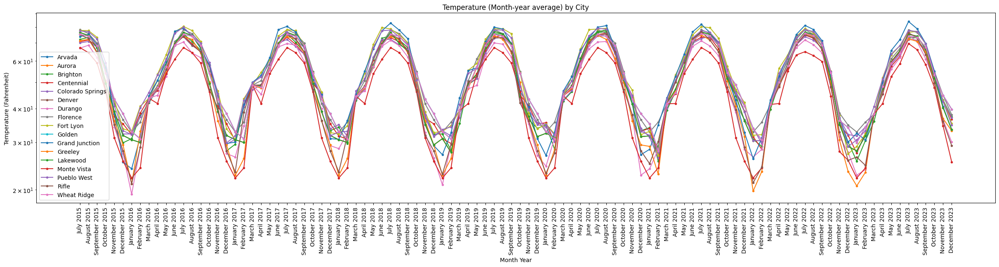

In [ ]:
plotWeatherByCity(weather_df)

# 6. Results & Discussion:

### Data Processing

In [ ]:
# Colorado Department of Human Services (CDHS) data

file_id = '1QKXDwgpPyaKiKfFs45FZ7JhwwFkM7UqE'
url = f'https://drive.google.com/uc?id={file_id}'

cdhs_data_with_sheets = getDataWithSheets(file_id, url)

Sheet name: 2015


,Address,Jul 2015,Aug 2015,Sep 2015,Oct 2015,Nov 2015,Dec 2015,Jan 2016,Feb 2016,Mar 2016,Apr 2016,May 2016,Jun 2016,Total 2015
0,SMHMAS MASTER,11138.45152,11658.061664,11507.420192,17100.206368,24647.999008,33159.351072,32529.16328,27431.7096,19624.961216,23223.061664,17329.044835,11305.828009,240655.258428
1,NFLMAS MASTER,3463.333987,3631.052934,3292.717979,3468.833972,5304.934955,6371.019979,6131.457656,5018.536045,4860.539732,4241.076919,3580.156282,3347.697902,52711.358342
2,NLMMAS MASTER,964.705072,954.75968,996.217428,1760.486104,2693.766476,3159.155732,3081.408996,2635.477568,2624.148876,2176.74258,1776.81368,922.900136,23746.582328
3,WRCMAS MASTER,1492.661836,1413.017524,1390.68598,1566.295276,2181.870464,3137.137172,3317.741108,2571.503392,1823.530116,1295.788852,1132.026564,1074.892116,22397.1504
4,NPV100 PLATTE VALLEY YSC,653.49616,611.14144,588.16656,705.29632,1137.11328,1641.94832,1390.8326,1202.20272,1135.092,846.19456,801.54288,619.66304,11332.68988
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0,0,0,0,0,0,6.9,0,0,0,0,0,6.9
154,SMH031 TRUCK SCALE HOUSE,0,0,0.2,0,0,0,0.2,0,0,0,0,0,0.4
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0,0,0,0,0,0,0,0,0,0,0,0,0
156,NFL Shed Soccer Field,0,0,0,0,0,0,0,0,0,0,0,0,0


Sheet name: 2016


,Address,Jul 2016,Aug 2016,Sep 2016,Oct 2016,Nov 2016,Dec 2016,Jan 2017,Feb 2017,Mar 2017,Apr 2017,May 2017,Jun 2017,Total 2016
0,SMHMAS MASTER,15009.590498,12289.626299,11835.041886,15877.188265,2564.190788,28024.034877,31063.406252,23353.967959,22359.185732,20084.53779,17093.030046,11616.871054,211170.671446
1,NFLMAS MASTER,3680.333004,3489.062838,3207.715591,3170.592076,4168.506298,6270.53917,6185.820096,4654.895397,4121.336104,4018.669858,3421.013076,3226.912154,49615.395662
2,NLMMAS MASTER,853.247596,969.575124,1086.5734,1600.540128,2284.597292,3341.647056,3209.809948,2536.885592,2342.246984,2160.598128,1911.525352,1108.522256,23405.768856
3,WRCMAS MASTER,1197.691152,1092.103704,992.429224,1309.259448,1566.055568,2204.619116,2252.879864,1562.970256,1525.950084,1367.549732,1201.374312,1011.631396,17284.513856
4,NPV100 PLATTE VALLEY YSC,525.9624,557.09424,615.9512,684.15424,1077.50688,1607.51568,1356.51264,1063.66528,901.25248,761.09376,779.7968,657.00096,10587.50656
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0,0,0,0,0,0,0,0,0,0,0,0,0
154,SMH031 TRUCK SCALE HOUSE,0.2,0,0.2,0,0,0,0,0,0,0.4,0,0,0.8
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0,0,0,0,0,0,0,0,0,0,0,0,0
156,NFL Shed Soccer Field,0,0,0,0,0,0,0,0,0,0,0,0,0


Sheet name: 2017


,Address,Jul 2017,Aug 2017,Sep 2017,Oct 2017,Nov 2017,Dec 2017,Jan 2018,Feb 2018,Mar 2018,Apr 2018,May 2018,Jun 2018,Total 2017
0,SMHMAS MASTER,11434.568441,11823.829016,5571.597583,19207.48518,22842.347186,29762.234248,30613.378706,29257.756082,24998.421266,19567.776763,12914.361117,10955.432692,228949.18828
1,NFLMAS MASTER,3457.598391,3304.937458,3192.45765,3847.144656,4374.638091,5740.454183,5563.653229,5237.503416,4415.530662,3844.594632,3269.851001,3439.279702,49687.643071
2,NLMMAS MASTER,759.183024,1000.39116,1300.006716,2212.009848,2420.75992,3032.664404,3044.424968,3019.994216,2526.38942,2192.2268,1728.08438,1268.40628,24504.541136
3,WRCMAS MASTER,1024.719,970.211728,1094.6786,1525.778912,1769.407564,2259.157924,2292.888088,1942.55144,1605.453052,1236.623372,1022.603484,798.887564,17542.960728
4,NPV100 PLATTE VALLEY YSC,637.89776,703.47328,621.50928,735.67104,1054.47024,1293.96368,1286.44044,1293.60992,915.30352,843.25296,648.11136,786.3212,10820.02468
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0,0,0,0,0,0,0,0,0,0,0,0,0
154,SMH031 TRUCK SCALE HOUSE,0.2,0.2,0,0,0.2,0,0,0.2,0,0,0.2,0,1
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0,0,0,0,0,0,0,0,0,0,0,0,0
156,NFL Shed Soccer Field,0,0,0,0,0,0,0,0,0,0,0,0,0


Sheet name: 2018


,Address,Jul 2018,Aug 2018,Sep 2018,Oct 2018,Nov 2018,Dec 2018,Jan 2019,Feb 2019,Mar 2019,Apr 2019,May 2019,Jun 2019,Total 2018
0,SMHMAS MASTER,12019.31746,11540.637336,11882.922399,20268.867214,26562.615427,31089.395722,31256.066749,26861.700766,28392.696825,18861.439653,18832.756054,12968.736713,250537.152318
1,NFLMAS MASTER,3702.973253,3524.336215,3318.3689,3834.811383,4795.536217,5565.820126,5518.541385,5285.563432,4813.822167,3522.25304,3319.375406,3030.609932,50232.011456
2,NLMMAS MASTER,1016.394592,1188.3727,1273.386324,2065.32914,2771.793472,3134.589052,3115.057608,3094.827316,2942.384876,2194.127852,2202.827048,1368.252984,26367.342964
3,WRCMAS MASTER,843.166232,789.99192,756.329404,1118.758136,1605.950052,2202.485172,2469.417508,2164.76694,1869.33276,1407.699632,1013.447944,640.5796,16881.9253
4,NPV100 PLATTE VALLEY YSC,687.62464,667.70928,538.648,744.94656,1152.92992,1277.23888,1304.68912,1299.41152,1012.57952,818.05504,400.33648,634.0492,10538.21816
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0,0,0,0,0,0,0,0,0,0,0,0,0
154,SMH031 TRUCK SCALE HOUSE,0,0.2,0,0,0.2,0,0,0,0.2,0,0,0,0.6
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0,0,0,0,0,0,0,0,0,0,0,0,0
156,NFL Shed Soccer Field,0,0,0,0,0,0,0,0,0,0,0,0,0


Sheet name: 2019


,Address,Jul 2019,Aug 2019,Sep 2019,Oct 2019,Nov 2019,Dec 2019,Jan 2020,Feb 2020,Mar 2020,Apr 2020,May 2020,Jun 2020,Total 2019
0,SMHMAS MASTER,12465.939009,11430.619448,11068.575033,22085.329838,24715.441487,26998.716557,27401.349427,19836.174162,19876.928,12559.0048,15590.6272,11848.9488,215877.653761
1,NFLMAS MASTER,3542.34927,3622.209802,3197.563171,4400.914544,5212.93514,5911.575042,5756.365069,5761.158839,4625.16746,4128.716792,3423.452712,3323.467796,52905.875637
2,NLMMAS MASTER,828.7119,871.897008,1176.643916,2372.014668,2787.96266,3067.281676,3054.734332,3139.469316,2595.238716,2236.803984,1554.723264,967.74686,24653.2283
3,WRCMAS MASTER,874.632784,1057.160796,937.008932,1158.283,1200.97536,1407.754148,1619.676,1483.676516,1085.796788,906.347272,674.640152,672.35356,13078.305308
4,NPV100 PLATTE VALLEY YSC,640.73792,752.40336,529.74064,1038.474,1158.36672,1476.17184,1314.26912,1258.7772,1086.3868,948.58336,672.09912,670.47448,11546.48456
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0,0,0,0,0,0,0,0,0,0,0,0,0
154,SMH031 TRUCK SCALE HOUSE,0.2,0,0.2,0,0,0.2,0,0,0,0,0.2,0,0.8
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0,0,0,0,0,0,0,0,0,0,0,0,0
156,NFL Shed Soccer Field,0,0,0,0,0,0,0,0,0,0,0,0,0


Sheet name: 2020


,Address,Jul 2020,Aug 2020,Sep 2020,Oct 2020,Nov 2020,Dec 2020,Jan 2021,Feb 2021,Mar 2021,Apr 2021,May 2021,Jun 2021,Total 2020
0,SMHMAS MASTER,12002.1792,11759.3472,14725.6832,12348.704,20851.0336,23151.886632,28368.253652,19286.471468,24025.29746,19926.12768,16728.554479,11463.651804,214637.190375
1,NFLMAS MASTER,3889.92078,3810.609692,3640.399836,4383.6298,4421.775676,5674.83198,6214.3055,5353.774828,4829.122812,4055.760004,3558.82574,3612.552824,53445.509472
2,NLMMAS MASTER,757.258092,845.752848,1337.616908,2067.654416,2355.365832,3034.82788,2951.281656,2989.002152,2658.643324,2354.772428,1832.18786,960.652188,24145.015584
3,WRCMAS MASTER,685.479244,720.714096,735.249192,665.097608,854.132016,1390.272764,1397.419752,1127.9307,1037.975916,922.064632,790.408404,687.188928,11013.933252
4,NPV100 PLATTE VALLEY YSC,607.2212,584.2132,677.62192,888.03136,1031.74992,1435.8968,1207.34312,1315.29208,1080.3604,899.77784,741.99496,711.46808,11180.97088
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0,0,0,0,0,0,0,0,0,0,0,0,0
154,SMH031 TRUCK SCALE HOUSE,0.2,0.2,0,0,0,0,0,0,0,0,0.2,0,0.6
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0,0,0,0,0,0,0,0,0,0,0,0,0
156,NFL Shed Soccer Field,0,0,0,0,0,0,0,0,0,0,0,0,0


Sheet name: 2021


,Address,Jul 2021,Aug 2021,Sep 2021,Oct 2021,Nov 2021,Dec 2021,Jan 2022,Feb 2022,Mar 2022,Apr 2022,May 2022,Jun 2022,Total 2021
0,SMHMAS MASTER,10723.359772,10369.564752,10344.48288,15778.189364,19769.819756,22846.197356,26464.340728,22048.745524,23645.669344,18405.951112,14409.501316,11120.46552,205926.287424
1,NFLMAS MASTER,3750.771772,3749.372312,3414.160412,4317.919544,4265.243416,5148.801288,6264.057604,5242.697476,4810.867204,3500.442436,3441.125144,3749.907412,51655.36602
2,NLMMAS MASTER,862.773052,920.76906,1124.93194,1722.05788,2115.283384,2613.006152,2833.05816,2573.894396,2351.550352,1899.21114,1509.971744,952.753408,21479.260668
3,WRCMAS MASTER,595.52414,560.514744,580.23836,702.172384,865.229532,1205.787404,1315.43226,1309.55538,979.263644,744.97818,429.98728,268.545872,9557.22918
4,NPV100 PLATTE VALLEY YSC,612.12344,622.17928,630.15104,674.0996,902.21576,1331.39856,1266.88336,1149.7448,1040.82376,771.25984,693.45616,564.85544,10259.19104
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0,0,0,0,0,0,0,0,0,0,0,0,0
154,SMH031 TRUCK SCALE HOUSE,0.2,0,0.2,0,0,0.2,0,0,0.2,0,0.2,0,1
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0.47768,0.713108,0.310492,0.303668,0.32414,0.406028,0.300256,0.098948,0.269548,0.269548,0.245664,0.2559,3.97498
156,NFL Shed Soccer Field,0,0,0,0,0,0,0,0,0,0,0,0,0


Sheet name: 2022


,Address,Jul 2022,Aug 2022,Sep 2022,Oct 2022,Nov 2022,Dec 2022,Jan 2023,Feb 2023,Mar 2023,Apr 2023,May 2023,Jun 2023,Total 2022
0,SMHMAS MASTER,10532.383684,10636.953772,10677.489956,15807.387848,23266.958492,26667.758628,28194.30684,23797.054564,23779.791572,9334.385636,13863.489072,11618.822316,208176.78238
1,NFLMAS MASTER,4150.975684,3744.733692,3208.424856,3639.779664,4633.463796,4594.513592,5550.201952,4068.577504,4392.376204,3200.015967,2919.585216,3076.954336,47179.602463
2,NLMMAS MASTER,755.745728,692.338832,1047.628264,1779.110768,2610.521344,3005.325176,3104.545508,2643.789472,2582.33026,2039.133953,1582.256932,1108.77642,22951.502657
3,WRCMAS MASTER,263.160736,365.585532,332.440224,567.463824,725.203076,946.705784,940.988692,857.709472,786.453568,641.873019,521.375754,471.262804,7420.222485
4,NPV100 PLATTE VALLEY YSC,499.81776,503.37104,427.36408,641.7268,1070.58232,1449.19288,1238.70256,1172.76056,1119.88272,753.3404,411.70504,388.87,9677.31616
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0,0,0,0,0,0,0,0,0,0,0,0,0
154,SMH031 TRUCK SCALE HOUSE,0,0.2,0,0,0.2,0,0.2,0,0,0.2,0,0,0.8
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0.23884,0.249076,0.296844,0.29002,0.327552,0.368496,0.344612,0.310492,0.279784,0.269548,0.262724,0,3.237988
156,NFL Shed Soccer Field,0,0,0,0,0,0,0,0,0,0.027296,0.044356,0.047768,0.11942


Sheet name: 2023


,Address,Jul 2023,Aug 2023,Sep 2023,Oct 2023,Nov 2023,Dec 2023,Jan 2024,Feb 2024,Mar 2024,Apr 2024,May 2024,Jun 2024,Total 2023
0,SMHMAS MASTER,11229.324276,10809.557118,10318.960893,15431.985792,21997.659163,25840.166732,28656.238729,22781.305965,22431.911093,18758.20481,16097.314245,11388.724423,215741.353239
1,NFLMAS MASTER,3636.657258,3455.753853,3071.930573,3200.282535,3321.152538,3773.964551,4904.952487,3549.86593,3342.079467,2755.428075,2746.348595,4164.368076,41922.783938
2,NLMMAS MASTER,769.769264,844.369692,1071.557608,1689.480256,2258.241337,2634.940725,3189.915389,2602.198343,2523.928818,2075.970856,1810.857024,826.138854,22297.368166
3,WRCMAS MASTER,344.884894,203.839704,298.090176,715.901673,930.670069,1019.231106,971.622274,844.053099,835.26222,162.13541,83.948848,77.097552,6486.737025
4,NPV100 PLATTE VALLEY YSC,359.48616,385.08304,294.73512,277.7084,1103.45656,1127.43008,1368.00884,1102.3688,887.98072,689.8876,630.06624,492.7224,8718.93396
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0,0,0,0,0,0,20.7966,0,0,0,0,0,20.7966
154,SMH031 TRUCK SCALE HOUSE,0.2,0,0,0.2,0,0,0.2,0,0.2,0,0,0,0.8
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0,0,0,0,0,0,0,0,0,0,0,0,0
156,NFL Shed Soccer Field,0.044356,0.044356,0.105772,0.040944,0.037532,0.037532,0.03412,0.037532,0.037532,0.037532,0.044356,0.044356,0.54592


Sheet name: 2024


,Address,Jul 2024,Aug 2024,Sep 2024,Oct 2024,Nov 2024,Dec 2024,Jan 2025,Feb 2025,Mar 2025,Apr 2025,May 2025,Jun 2025,Total 2024
0,SMHMAS MASTER,11855.333885,11940.17068,12602.595117,15514.995353,22176.362195,22921.103748,113.85,0,0,0,0,0,97124.410978
1,NFLMAS MASTER,3983.749125,3867.679529,3442.18113,2875.756654,3423.891053,3648.955144,55.2552,0,0,0,0,0,21297.467835
2,NLMMAS MASTER,782.555627,831.610687,978.274671,1511.321084,2654.106484,2714.129093,0,0,0,0,0,0,9471.997646
3,WRCMAS MASTER,89.476288,67.666784,51.7771,51.275536,51.524612,48.699476,0,0,0,0,0,0,360.419796
4,NPV100 PLATTE VALLEY YSC,498.28592,435.61232,322.79096,664.07136,1041.44976,1344.032956,0,0,0,0,0,0,4306.243276
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0,0,0,0,0,0,0,0,0,0,0,0,0
154,SMH031 TRUCK SCALE HOUSE,0.2,0,0,0.2,0,0,0.5,0,0,0,0,0,0.9
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0,0,0,0,0,0,0,0,0,0,0,0,0
156,NFL Shed Soccer Field,0.044356,0.044356,0.040944,0.044356,0.03412,0.037532,0,0,0,0,0,0,0.245664


In [ ]:
cdhs_data_merged = getMergedDF(cdhs_data_with_sheets)

,Address,Jul 2015,Aug 2015,Sep 2015,Oct 2015,Nov 2015,Dec 2015,Jan 2016,Feb 2016,Mar 2016,...,Oct 2024,Nov 2024,Dec 2024,Jan 2025,Feb 2025,Mar 2025,Apr 2025,May 2025,Jun 2025,Total 2024
0,SMHMAS MASTER,11138.45152,11658.061664,11507.420192,17100.206368,24647.999008,33159.351072,32529.16328,27431.7096,19624.961216,...,15514.995353,22176.362195,22921.103748,113.85,0,0,0,0,0,97124.410978
1,NFLMAS MASTER,3463.333987,3631.052934,3292.717979,3468.833972,5304.934955,6371.019979,6131.457656,5018.536045,4860.539732,...,2875.756654,3423.891053,3648.955144,55.2552,0,0,0,0,0,21297.467835
2,NLMMAS MASTER,964.705072,954.75968,996.217428,1760.486104,2693.766476,3159.155732,3081.408996,2635.477568,2624.148876,...,1511.321084,2654.106484,2714.129093,0,0,0,0,0,0,9471.997646
3,WRCMAS MASTER,1492.661836,1413.017524,1390.68598,1566.295276,2181.870464,3137.137172,3317.741108,2571.503392,1823.530116,...,51.275536,51.524612,48.699476,0,0,0,0,0,0,360.419796
4,NPV100 PLATTE VALLEY YSC,653.49616,611.14144,588.16656,705.29632,1137.11328,1641.94832,1390.8326,1202.20272,1135.092,...,664.07136,1041.44976,1344.032956,0,0,0,0,0,0,4306.243276
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0,0,0,0,0,0,6.9,0,0,...,0,0,0,0,0,0,0,0,0,0
154,SMH031 TRUCK SCALE HOUSE,0,0,0.2,0,0,0,0.2,0,0,...,0.2,0,0,0.5,0,0,0,0,0,0.9
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
156,NFL Shed Soccer Field,0,0,0,0,0,0,0,0,0,...,0.044356,0.03412,0.037532,0,0,0,0,0,0,0.245664


In [ ]:
# Adjust electricity expense for inflation (auto adjustment is to prior full year -- 2024 right now)

# Pre-fetch CPI data for the necessary years
cpi_data = {}

# Fetch CPI data for all years present in the dataset
for col in cdhs_data_merged.columns:
    if col != "Address":
        try:
            year = int(col.split(' ')[1])
            if year not in cpi_data and year < 2025:
                cpi_data[year] = cpi.inflate(1, year)
        except (ValueError, IndexError):
            continue

def inflate_value(val, col_name):
    try:
        # Extract year from the column name
        year = int(col_name.split(' ')[1])
        # Use pre-fetched CPI data
        if year in cpi_data:
            return val * cpi_data[year]
        else:
            return val
    except (ValueError, IndexError):
        return val

# Apply inflation adjustment using precomputed CPI values
for col in cdhs_data_merged.columns:
    if col != "Address":
        cdhs_data_merged[col] = cdhs_data_merged[col].apply(lambda x: inflate_value(x, col))

display(cdhs_data_merged)

,Address,Jul 2015,Aug 2015,Sep 2015,Oct 2015,Nov 2015,Dec 2015,Jan 2016,Feb 2016,Mar 2016,...,Oct 2024,Nov 2024,Dec 2024,Jan 2025,Feb 2025,Mar 2025,Apr 2025,May 2025,Jun 2025,Total 2024
0,SMHMAS MASTER,14741.599627,15429.297077,15229.924995,22631.906721,32621.314761,43885.981505,42515.596212,35853.227417,25649.812126,...,15514.995353,22176.362195,22921.103748,113.850000,0,0,0,0,0,97124.410978
1,NFLMAS MASTER,4583.678703,4805.652606,4357.870575,4590.957863,7021.014278,8431.964316,8013.811350,6559.223495,6352.722412,...,2875.756654,3423.891053,3648.955144,55.255200,0,0,0,0,0,21297.467835
2,NLMMAS MASTER,1276.774954,1263.612354,1318.481159,2329.981079,3565.165841,4181.102632,4027.399645,3444.567545,3429.760952,...,1511.321084,2654.106484,2714.129093,0.000000,0,0,0,0,0,9471.997646
3,WRCMAS MASTER,1975.519050,1870.110811,1840.555295,2072.971976,2887.677947,4151.961346,4336.285568,3360.953337,2383.352730,...,51.275536,51.524612,48.699476,0.000000,0,0,0,0,0,360.419796
4,NPV100 PLATTE VALLEY YSC,864.893898,808.837962,778.430999,933.450754,1504.955036,2173.097822,1817.817345,1571.278209,1483.564539,...,664.071360,1041.449760,1344.032956,0.000000,0,0,0,0,0,4306.243276
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,NGYMAS MASTER,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.018296,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0,0,0,0,0,0.000000
154,SMH031 TRUCK SCALE HOUSE,0.000000,0.000000,0.264697,0.000000,0.000000,0.000000,0.261400,0.000000,0.000000,...,0.200000,0.000000,0.000000,0.500000,0,0,0,0,0,0.900000
155,NRV0DCT DAY CARE TRAILIER-KIOSK,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0,0,0,0,0,0.000000
156,NFL Shed Soccer Field,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.044356,0.034120,0.037532,0.000000,0,0,0,0,0,0.245664


In [ ]:
# Ensure excel file exists, will be printed in next code cell

webscrapingCDHSToPropertyInfo(cdhs_data_merged)

True

In [ ]:
# Load in Facility_addresses

facility_to_address = getFacilityAddresses()

,Facility Name,Address
0,SMHMAS MASTER,1600 W. 24TH ST.
1,NFLMAS MASTER,4112 S. Knox Ct.
2,NLMMAS MASTER,2901 Ford St
3,WRCMAS MASTER,2800 RIVERSIDE PKWY.
4,NPV100 PLATTE VALLEY YSC,2200 O St.
...,...,...
152,SMHMASSOC - SOUTH CAMPUS MASTER,1600 W. 24TH ST.
153,NGYMAS MASTER,2844 Downing St.
154,SMH031 TRUCK SCALE HOUSE,1600 W. 24TH ST.
155,NRV0DCT DAY CARE TRAILIER-KIOSK,28101 E. Quincy Ave.


In [ ]:
# Convert Facility Name to Address

cdhs_data_merged = convertCDHSFacilityNameToAddress(cdhs_data_merged, facility_to_address)

,Address,Jul 2015,Aug 2015,Sep 2015,Oct 2015,Nov 2015,Dec 2015,Jan 2016,Feb 2016,Mar 2016,...,Oct 2024,Nov 2024,Dec 2024,Jan 2025,Feb 2025,Mar 2025,Apr 2025,May 2025,Jun 2025,Total 2024
0,1600 W. 24TH ST.,14741.599627,15429.297077,15229.924995,22631.906721,32621.314761,43885.981505,42515.596212,35853.227417,25649.812126,...,15514.995353,22176.362195,22921.103748,113.850000,0,0,0,0,0,97124.410978
1,4112 S. Knox Ct.,4583.678703,4805.652606,4357.870575,4590.957863,7021.014278,8431.964316,8013.811350,6559.223495,6352.722412,...,2875.756654,3423.891053,3648.955144,55.255200,0,0,0,0,0,21297.467835
2,2901 Ford St,1276.774954,1263.612354,1318.481159,2329.981079,3565.165841,4181.102632,4027.399645,3444.567545,3429.760952,...,1511.321084,2654.106484,2714.129093,0.000000,0,0,0,0,0,9471.997646
3,2800 RIVERSIDE PKWY.,1975.519050,1870.110811,1840.555295,2072.971976,2887.677947,4151.961346,4336.285568,3360.953337,2383.352730,...,51.275536,51.524612,48.699476,0.000000,0,0,0,0,0,360.419796
4,2200 O St.,864.893898,808.837962,778.430999,933.450754,1504.955036,2173.097822,1817.817345,1571.278209,1483.564539,...,664.071360,1041.449760,1344.032956,0.000000,0,0,0,0,0,4306.243276
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,2844 Downing St.,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.018296,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0,0,0,0,0,0.000000
154,1600 W. 24TH ST.,0.000000,0.000000,0.264697,0.000000,0.000000,0.000000,0.261400,0.000000,0.000000,...,0.200000,0.000000,0.000000,0.500000,0,0,0,0,0,0.900000
155,28101 E. Quincy Ave.,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0,0,0,0,0,0.000000
156,3631 West Princeton Circle,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.044356,0.034120,0.037532,0.000000,0,0,0,0,0,0.245664


In [ ]:
# Remove certain rows that don't properly match

addresses_to_remove = ['4140 s. lowell blvd', '1425 w. rio grande ave.', '4106-4108-4112-4116-4118',
                       '4103 s. stuart st.', '308 cedar st.', '28101 e. quincy ave.', '195 desert st.']

cdhs_data_merged = cdhs_data_merged[~cdhs_data_merged['Address'].isin(addresses_to_remove)]


In [ ]:
# Match CDHS Addresses to Property info:

matched_cdhs_df = match_addresses_to_property_info(cdhs_data_merged, property_info_df, address_column='Address', threshold=85)

display(matched_cdhs_df)

,Address,Jul 2015,Aug 2015,Sep 2015,Oct 2015,Nov 2015,Dec 2015,Jan 2016,Feb 2016,Mar 2016,...,Oct 2024,Nov 2024,Dec 2024,Jan 2025,Feb 2025,Mar 2025,Apr 2025,May 2025,Jun 2025,Total 2024
0,270 w. john powell blvd.,14741.599627,15429.297077,15229.924995,22631.906721,32621.314761,43885.981505,42515.596212,35853.227417,25649.812126,...,15514.995353,22176.362195,22921.103748,113.850000,0,0,0,0,0,97124.410978
1,"3520 w. oxford ave., 3525 w. oxford ave, 3526 ...",4583.678703,4805.652606,4357.870575,4590.957863,7021.014278,8431.964316,8013.811350,6559.223495,6352.722412,...,2875.756654,3423.891053,3648.955144,55.255200,0,0,0,0,0,21297.467835
2,"2901 ford st.,",1276.774954,1263.612354,1318.481159,2329.981079,3565.165841,4181.102632,4027.399645,3444.567545,3429.760952,...,1511.321084,2654.106484,2714.129093,0.000000,0,0,0,0,0,9471.997646
3,2800 riverside pkwy,1975.519050,1870.110811,1840.555295,2072.971976,2887.677947,4151.961346,4336.285568,3360.953337,2383.352730,...,51.275536,51.524612,48.699476,0.000000,0,0,0,0,0,360.419796
4,2200 o st.,864.893898,808.837962,778.430999,933.450754,1504.955036,2173.097822,1817.817345,1571.278209,1483.564539,...,664.071360,1041.449760,1344.032956,0.000000,0,0,0,0,0,4306.243276
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,2844 downing st.,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.018296,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0,0,0,0,0,0.000000
154,270 w. john powell blvd.,0.000000,0.000000,0.264697,0.000000,0.000000,0.000000,0.261400,0.000000,0.000000,...,0.200000,0.000000,0.000000,0.500000,0,0,0,0,0,0.900000
155,2882 elm ave.,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0,0,0,0,0,0.000000
156,"3610 w. princeton circle, 3620 w. princeton ci...",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.044356,0.034120,0.037532,0.000000,0,0,0,0,0,0.245664


In [ ]:
# Create a copy of the DataFrame to avoid fragmentation
matched_cdhs_df = matched_cdhs_df.copy()

# Group by 'Address' and sum the numerical columns
matched_cdhs_df = matched_cdhs_df.groupby('Address', as_index=False).sum()

# Display the updated DataFrame
display(matched_cdhs_df)

,Address,Jul 2015,Aug 2015,Sep 2015,Oct 2015,Nov 2015,Dec 2015,Jan 2016,Feb 2016,Mar 2016,...,Oct 2024,Nov 2024,Dec 2024,Jan 2025,Feb 2025,Mar 2025,Apr 2025,May 2025,Jun 2025,Total 2024
0,10285 ridge road,477.251760,448.341926,423.498549,722.054440,1318.306374,1713.073352,1623.706847,1266.106249,1226.064164,...,514.454020,1038.681697,1095.209952,0.000000,0,0,0,0,0,3777.690091
1,1034 xenon st.,190.510513,155.264156,137.144640,141.345929,168.391620,214.278064,172.627715,161.256747,175.479671,...,101.338300,121.723572,139.605920,0.000000,0,0,0,0,0,629.165292
2,13500 e. fremont pl.,740.090735,696.624870,772.313523,1067.420707,1445.637392,1784.740684,1736.151527,1448.806512,1360.497269,...,618.588212,1075.757466,1168.351152,246.482880,0,0,0,0,0,4433.603748
3,1427 w. rio grande st.,114.519920,87.166856,39.901126,94.518315,348.469977,491.844473,418.108098,294.054356,239.437116,...,56.211284,154.626104,173.312312,0.000000,0,0,0,0,0,454.362972
4,15038 w. 49th pl.,26.239487,27.007501,28.182684,32.129588,50.317660,79.388510,98.303637,73.325901,63.681867,...,19.748880,36.975152,44.474384,55.823716,0,0,0,0,0,200.833716
5,17767 w. 59th pl.,20.343403,19.684106,17.638476,13.199505,9.451441,11.637059,12.183305,8.798558,10.368295,...,5.391812,20.772136,32.602304,52.436140,0,0,0,0,0,126.583688
6,183 s wiggins dr.,2.900873,3.637991,6.822000,13.501980,50.751695,52.968621,52.467571,33.294816,35.112612,...,9.813108,64.949560,67.866364,0.000000,0,0,0,0,0,145.498524
7,1852 independence st.,5.591199,5.893754,5.442180,43.256437,25.156609,67.624899,44.847843,34.767820,46.161906,...,23.824028,42.111148,48.316664,0.000000,0,0,0,0,0,157.908716
8,192 bromley business parkway,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,321.405760,416.539360,500.809280,445.500000,0,0,0,0,0,2736.174560
9,1933 e. bridge st.,192.687878,201.127868,194.469938,177.205056,316.944392,530.081066,584.828112,388.958143,347.496567,...,15.707592,75.682628,43.882884,7.185672,0,0,0,0,0,147.659460


DPA

In [ ]:
# Department of Personnel and Administration (DPA) data

file_id = '1dVGm7cUTZXrmjSntkV_gE2mtWcO48yhw'
url = f'https://drive.google.com/uc?id={file_id}'

dpa_data_with_sheets = getDataWithSheets(file_id, url)

Sheet name: 2015


,Address,Jul 2015,Aug 2015,Sep 2015,Oct 2015,Nov 2015,Dec 2015,Jan 2016,Feb 2016,Mar 2016,Apr 2016,May 2016,Jun 2016,Total 2015
0,690 Kipling,1796.615804,1832.282488,1888.232772,1695.033188,1675.439132,2076.079468,2166.922544,1902.456036,1876.312492,1635.83048,1716.873532,1678.583908,21940.661844
1,1525 Sherman,978.884814,869.627699,812.883068,718.225482,1787.396393,1151.474646,1275.247658,1129.493603,1035.428085,1014.390753,778.497986,910.181212,12461.731399
2,1881 Pierce,405.6502,402.128988,796.454704,0,914.80188,762.54938,1996.171596,865.506548,666.50052,679.769524,609.69802,498.932096,8598.163456
3,200 E. Colfax,760.323939,711.513572,665.086147,585.593576,625.333413,636.851984,567.529902,574.194767,582.813887,570.019707,597.352897,685.375537,7561.989328
4,1313 Sherman,633.603282,592.927977,554.238456,487.994647,521.111178,530.709986,472.941585,478.495639,485.67824,475.016423,497.794081,571.146281,6301.657775
5,1575 Sherman,506.882626,474.342381,443.390765,390.395718,416.888942,424.567989,378.353268,382.79651,388.542592,380.013137,398.235265,456.917024,5041.326217
6,200 E. 14th Ave,337.92175,316.228254,295.593843,260.263811,484.825961,469.845326,476.335512,453.797674,399.928395,385.642092,342.190176,323.811349,4546.384143
7,1375 Sherman,338.034346,316.351086,295.593843,260.396879,278.243277,283.209102,252.409524,255.368274,259.171699,253.485396,265.613008,304.720533,3362.596967
8,201 E. Colfax,422.61032,395.51051,369.74138,325.602724,347.721355,354.461762,315.997262,319.33488,324.072101,316.957398,331.862721,380.979143,4204.851556
9,1001 E 62nd Ave,183.45812,183.87592,189.41314,157.331212,199.832176,308.888368,362.720072,260.350352,248.06716,177.161512,186.505168,199.035436,2656.638636


Sheet name: 2016


,Address,Jul 2016,Aug 2016,Sep 2016,Oct 2016,Nov 2016,Dec 2016,Jan 2017,Feb 2017,Mar 2017,Apr 2017,May 2017,Jun 2017,Total 2016
0,690 Kipling,1628.864848,1790.23468,1770.73506,1752.193416,1646.125716,2104.049676,1696.642768,1758.647568,0,1815.104884,1750.607244,1816.999556,19530.205416
1,1525 Sherman,963.19012,805.70695,774.306178,723.240889,749.888227,1002.092232,660.356023,1192.143332,942.598723,1077.59786,971.555993,917.111428,10779.787955
2,1881 Pierce,484.164756,503.50548,465.60922,532.566544,350.535232,739.191468,446.047348,786.400492,736.561908,491.9162,475.013836,465.016324,6476.528808
3,200 E. Colfax,776.691916,659.214778,633.523237,591.742546,569.035822,615.102735,540.291292,585.689999,536.64441,538.934612,549.618539,636.882078,7233.371964
4,1313 Sherman,647.243263,549.345648,527.936031,493.118789,474.196519,512.585613,450.242743,488.074999,447.203674,449.112177,458.01545,530.735065,6027.809971
5,1575 Sherman,517.794612,439.476518,422.348825,394.49503,379.357215,410.06849,360.194194,390.459999,357.76294,359.289742,366.41236,424.588052,4822.247977
6,200 E. 14th Ave,345.296408,293.084346,281.565883,263.196687,292.10481,380.978994,516.329463,486.806666,379.708626,330.426494,323.374907,314.858701,4207.731985
7,1375 Sherman,345.298768,293.096942,281.688715,263.129755,253.05835,273.54277,240.303475,260.477266,238.65193,239.669798,244.397739,283.167885,3216.483393
8,201 E. Colfax,431.703642,366.455624,352.206429,329.018818,316.444916,342.051294,300.161829,325.721121,298.41898,299.687902,305.582473,354.038332,4021.49136
9,1001 E 62nd Ave,204.88292,195.45272,189.14146,170.352652,178.610256,320.534344,353.007592,262.022032,248.39676,207.009032,221.825648,212.921676,2764.157092


Sheet name: 2017


,Address,Jul 2017,Aug 2017,Sep 2017,Oct 2017,Nov 2017,Dec 2017,Jan 2018,Feb 2018,Mar 2018,Apr 2018,May 2018,Jun 2018,Total 2017
0,690 Kipling,1847.27892,1711.93378,1780.12702,1772.079924,1802.773552,1652.629464,3547.043184,1818.53502,1558.453424,1548.600544,1599.6134,1738.860972,22377.929204
1,1525 Sherman,832.281424,741.633821,762.699783,716.434932,978.215025,2218.755529,1453.871326,1575.014292,1090.227286,947.165755,709.592662,731.971622,12757.863457
2,1881 Pierce,378.172456,378.864864,357.8766,354.742616,679.2637,678.730684,1395.48924,1161.211044,602.570716,506.88086,395.647916,431.485524,7320.93622
3,200 E. Colfax,676.702984,606.791308,624.027095,526.528581,531.175929,597.154524,513.712904,560.220784,520.631416,517.962891,566.093996,597.004054,6838.006466
4,1313 Sherman,563.919153,505.659423,520.022579,438.773817,442.646607,497.628769,428.094086,466.850653,433.859513,431.635743,471.744996,497.503378,5698.338717
5,1575 Sherman,451.135323,404.527539,416.018063,351.019054,354.117286,398.103016,342.47527,373.480523,347.087611,345.308594,377.395997,398.002703,4558.670979
6,200 E. 14th Ave,300.756881,269.685026,277.345376,259.112703,331.378191,378.20201,601.316846,445.887015,373.39174,329.40573,253.197331,265.335135,4085.013984
7,1375 Sherman,300.859241,269.797622,277.468208,234.145771,236.231731,265.565786,228.490858,249.300919,231.535044,230.328562,251.706515,265.437495,3040.867752
8,201 E. Colfax,376.154234,337.331475,346.930795,292.788838,295.425291,332.10395,285.733846,311.516965,289.51946,287.996001,314.711621,331.877052,3802.089528
9,1001 E 62nd Ave,221.5386,217.35688,207.4229,191.105772,228.29232,276.823376,352.825936,292.259792,240.24924,223.844552,201.456728,223.603116,2876.779212


Sheet name: 2018


,Address,Jul 2018,Aug 2018,Sep 2018,Oct 2018,Nov 2018,Dec 2018,Jan 2019,Feb 2019,Mar 2019,Apr 2019,May 2019,Jun 2019,Total 2018
0,690 Kipling,1631.604752,1879.020696,1907.228072,1581.801328,1744.013856,1984.436748,1712.90388,1926.606828,1483.035772,1591.430948,1686.121808,1532.863348,20661.068036
1,1525 Sherman,780.245242,710.665417,750.036455,1090.839782,1460.449905,1785.189052,1439.143119,1878.63704,1279.552192,1022.032541,940.099456,692.000411,13828.890612
2,1881 Pierce,418.333316,363.963352,353.787224,655.21558,825.324904,963.487332,971.383564,1140.83818,721.767292,624.494956,494.884192,363.206288,7896.68618
3,200 E. Colfax,638.38247,581.453523,594.684372,512.950731,514.268104,554.47286,481.126188,552.303033,487.433611,520.635715,535.908646,548.100336,6521.719589
4,1313 Sherman,531.985392,484.544603,495.57031,427.458943,428.556754,462.060717,400.93849,460.252528,406.194676,433.863096,446.590538,456.75028,5434.766327
5,1575 Sherman,425.588314,387.635682,396.456248,341.967154,342.845403,369.648574,320.750792,368.202022,324.955741,347.090477,357.272431,365.400224,4347.813062
6,200 E. 14th Ave,283.725542,258.523788,274.904165,337.678103,443.363602,537.832382,419.933861,492.468015,399.137161,324.693651,309.68162,243.900149,4325.842039
7,1375 Sherman,283.725542,258.423788,264.437233,228.131643,228.727378,246.606394,214.004461,245.611319,216.780465,231.516483,238.290804,243.702509,2899.958019
8,201 E. Colfax,354.88212,323.278811,330.653167,285.286532,286.032054,308.391914,267.630115,307.118214,271.076235,289.480904,297.941982,304.916451,3626.688499
9,1001 E 62nd Ave,226.37076,197.23464,198.4517,205.477932,570.134256,370.480584,2.408872,365.073072,287.70588,208.049352,203.192688,175.972076,3010.551812


Sheet name: 2019


,Address,Jul 2019,Aug 2019,Sep 2019,Oct 2019,Nov 2019,Dec 2019,Jan 2020,Feb 2020,Mar 2020,Apr 2020,May 2020,Jun 2020,Total 2019
0,690 Kipling,1500.184748,1654.332084,1519.139796,1703.286736,1752.927744,0,1586.909052,1448.981992,1391.024312,1395.20774,1492.5351,1373.947316,16818.47662
1,1525 Sherman,816.220414,779.306942,824.754215,1388.791594,2008.540382,1957.501687,1803.359842,1920.110594,1347.216738,977.288834,700.425117,656.914981,15180.43134
2,1881 Pierce,381.138252,363.229204,418.14498,843.760028,1038.180108,0,779.92206,735.27384,600.622796,399.838136,313.101936,280.675608,6153.886948
3,200 E. Colfax,667.816703,637.61477,636.917085,513.729486,559.587585,538.528653,518.285325,530.763214,451.731876,424.9545,485.202368,479.794075,6444.92564
4,1313 Sherman,556.513919,531.345642,530.764237,428.107905,466.322987,448.773877,431.904437,442.302678,376.44323,354.12875,404.335307,399.828396,5370.771365
5,1575 Sherman,445.211135,425.076514,424.61139,342.486324,373.05839,359.019102,345.52355,353.842142,301.154584,283.303,323.468245,319.862717,4296.617093
6,200 E. 14th Ave,296.807423,283.384342,293.67426,413.324216,726.305593,413.546068,398.349033,411.694762,306.869723,238.468667,226.645497,216.941811,4226.011395
7,1375 Sherman,297.032615,283.507174,283.207328,396.377756,495.869369,507.513256,596.019633,486.738066,399.313027,265.091499,236.154681,227.544171,4474.368575
8,201 E. Colfax,371.234471,354.479504,354.115785,285.719174,311.209544,299.534021,288.27408,295.15506,251.241938,236.324674,269.771827,266.760396,3583.820474
9,1001 E 62nd Ave,382.35304,367.44024,6.35954,177.217452,215.825776,274.41776,2.408872,289.143632,199.01036,196.947752,154.381648,193.923116,2459.429188


Sheet name: 2020


,Address,Jul 2020,Aug 2020,Sep 2020,Oct 2020,Nov 2020,Dec 2020,Jan 2021,Feb 2021,Mar 2021,Apr 2021,May 2021,Jun 2021,Total 2020
0,690 Kipling,1310.897224,1231.428332,1444.48726,822.341132,1187.4176,1522.58956,1326.959928,1604.164168,1505.496136,1455.91368,1461.036284,1515.207544,16387.938848
1,1525 Sherman,648.460631,642.834584,572.373839,891.388435,1304.943318,1742.147015,1491.619914,1894.105509,1515.625468,1391.653129,774.048495,601.26264,13470.462977
2,1881 Pierce,268.91072,278.581456,328.3864,465.580988,678.0762,777.1156,650.487844,718.226344,576.34226,871.892528,505.88624,203.311892,6322.798472
3,200 E. Colfax,530.558698,525.955569,468.142232,436.326901,468.362715,469.511194,402.479929,484.859053,454.111746,484.734378,457.976041,491.94216,5674.960616
4,1313 Sherman,442.132249,438.296308,390.118526,363.605751,390.302263,391.259329,335.399941,404.049211,378.426455,403.945315,381.646701,409.9518,4729.133849
5,1575 Sherman,353.705799,350.637046,312.094821,290.884601,312.24181,313.007463,268.319953,323.239368,302.741164,323.156252,305.317361,327.96144,3783.307078
6,200 E. 14th Ave,236.903866,234.958031,228.763214,267.123067,208.161207,420.271642,355.979969,425.992912,329.727443,316.737501,222.644907,220.24096,3467.504719
7,1375 Sherman,235.916462,238.580863,262.996282,443.330147,407.924983,582.345654,508.450569,1006.736216,568.570747,351.360333,229.454091,223.14332,5058.809667
8,201 E. Colfax,294.980024,292.446614,260.351978,242.717738,260.52906,261.190988,223.937749,269.649336,252.564088,269.535717,254.64609,273.509332,3156.058714
9,1001 E 62nd Ave,178.93412,169.68888,339.65122,231.905612,311.405616,339.287304,2.408872,359.208432,269.80348,235.655912,172.910448,185.474636,2796.334532


Sheet name: 2021


,Address,Jul 2021,Aug 2021,Sep 2021,Oct 2021,Nov 2021,Dec 2021,Jan 2022,Feb 2022,Mar 2022,Apr 2022,May 2022,Jun 2022,Total 2021
0,690 Kipling,1639.844696,1538.608372,1606.471587,1634.600408,1644.54366,1874.272592,1752.64048,1935.614892,1674.1239,1577.85434,1815.354988,1602.537712,20296.467627
1,1525 Sherman,727.160731,614.201422,600.46211,780.436528,1042.480842,1637.436554,1867.716829,1239.8,1312.024973,945.201378,746.241631,535.75804,12048.921038
2,1881 Pierce,92.537872,203.254712,316.419964,434.193096,447.589572,706.106612,629.97226,713.281512,450.729036,331.935944,272.506912,205.230688,4803.75818
3,200 E. Colfax,594.949689,502.528436,476.559909,396.111704,432.63887,404.293544,480.368315,0,411.89316,394.5284,456.906789,438.347488,4989.126304
4,1313 Sherman,495.791408,418.773697,397.133258,330.093087,360.532392,336.911287,400.306929,0,343.2443,328.773667,380.755657,365.289573,4157.605255
5,1575 Sherman,396.633126,335.018957,317.706606,264.07447,288.425914,269.529029,320.245543,0,274.59544,263.018933,304.604526,292.231658,3326.084202
6,200 E. 14th Ave,265.722084,224.845972,219.904404,256.049646,249.483942,360.28602,404.997029,174.1,330.963627,262.945956,250.569684,195.821106,3195.68947
7,1375 Sherman,264.63468,226.468804,243.337472,345.503186,436.647718,814.960032,501.867629,102.843304,183.206931,221.268788,229.478868,195.423466,3765.640878
8,201 E. Colfax,330.752797,279.43154,265.028465,220.375962,240.68248,224.95896,267.209074,0.283196,229.109317,219.421284,254.052061,243.734514,2775.03965
9,1001 E 62nd Ave,181.58308,185.1468,189.13938,234.076812,113.237456,258.484744,333.676072,325.608272,306.32284,263.965352,256.925808,251.272236,2899.438852


Sheet name: 2022


,Address,Jul 2022,Aug 2022,Sep 2022,Oct 2022,Nov 2022,Dec 2022,Jan 2023,Feb 2023,Mar 2023,Apr 2023,May 2023,Jun 2023,Total 2022
0,690 Kipling,273,1034.477456,1114.543448,994.575964,1180.4315,1149.332816,1276.938484,1129.58406,1082.579496,1189.484748,1023.480488,977.046528,12425.474988
1,1525 Sherman,642.322648,563.819216,626.20836,1241.546416,1590.342624,2026.543852,1899.910811,1642.026631,1325.007275,770.868884,803.909613,632.645735,13765.152065
2,1881 Pierce,206.55426,225.531376,302.342856,415.844956,720.594536,825.009828,969.47698,764.520824,502.699492,482.381924,234.92748,200.317008,5850.20152
3,200 E. Colfax,525.536712,461.306631,474.879567,380.410704,410.59851,452.081334,490.427027,432.676334,450.08777,448.992723,382.998774,411.664692,5321.660778
4,1313 Sherman,437.94726,384.422192,395.732972,317.00892,342.165425,376.734445,408.689189,360.563612,375.073142,374.160602,319.165645,343.05391,4434.717314
5,1575 Sherman,350.357808,307.537754,316.586378,253.607136,273.73234,301.387556,326.951352,288.450889,300.058513,299.328482,255.332516,274.443128,3547.773852
6,200 E. 14th Ave,233.571872,205.025169,218.957585,236.471424,395.188227,431.925037,453.267568,401.400593,346.139009,244.752321,217.721677,183.862085,3568.282567
7,1375 Sherman,233.684468,205.148001,211.190653,180.824964,302.252003,445.299049,218.138168,192.443897,200.182313,199.675153,170.330861,183.064445,2742.233975
8,201 E. Colfax,292.190032,256.530538,264.094942,211.653184,228.437836,251.507732,272.797248,240.658937,250.328545,249.679242,212.992053,228.910739,2959.781028
9,1001 E 62nd Ave,254.75652,248.48248,247.39698,234.349452,333.190256,447.286184,465.271592,443.720592,310.57356,310.116872,207.924848,216.274636,3719.343972


Sheet name: 2023


,Address,Jul 2023,Aug 2023,Sep 2023,Oct 2023,Nov 2023,Dec 2023,Jan 2024,Feb 2024,Mar 2024,Apr 2024,May 2024,Jun 2024,Total 2023
0,690 Kipling,1118.286952,1043.579904,1064.214056,1132.014644,1466.923336,2637.751932,2726.501904,2517.725224,1210.45024,2083.122108,2046.979628,6.6,19054.149928
1,1525 Sherman,537.034128,562.103843,520.697074,810.101174,1578.666462,2237.494974,2429.956583,1238,867.4,607.2,0,0,11388.654238
2,1881 Pierce,230.05748,230.928364,283.895004,537.128168,806.09596,763.569944,941.452352,713.600816,1497.566116,423.547096,45.1,186.745584,6659.686884
3,200 E. Colfax,439.39156,456.630417,424.224878,382.337324,466.581651,448.359524,475.573568,0,0,0,0,0,3093.098922
4,1313 Sherman,366.159633,380.525347,353.520732,318.614437,388.818043,373.632937,396.311306,0,0,0,0,0,2577.582435
5,1575 Sherman,292.927706,304.420278,282.816586,254.891549,311.054434,298.906349,317.049045,0,0,0,0,0,2062.065947
6,200 E. 14th Ave,195.285138,202.946852,191.44439,200.8277,337.669623,421.3709,435.16603,178.1,116.9,72.5,0,0,2352.210633
7,1375 Sherman,195.397734,203.069684,188.677458,170.08124,207.533399,199.444912,246.73663,36.443304,0,0.122832,0.109184,0.10236,1447.718737
8,201 E. Colfax,244.331614,253.932641,235.953448,212.723528,259.53958,249.44006,264.545326,0.286608,0,0.23884,0.214956,0,1721.206601
9,1001 E 62nd Ave,274.37124,207.42008,208.59506,199.749932,293.128976,334.622664,429.613512,643.057872,275.83756,220.423112,199.057488,407.609224,3693.48672


Sheet name: 2024


,Address,Jul 2024,Aug 2024,Sep 2024,Oct 2024,Nov 2024,Dec 2024,Jan 2025,Feb 2025,Mar 2025,Apr 2025,May 2025,Jun 2025,Total 2024
0,690 Kipling,1279.291156,3,3.3,0,1241.426852,0,0,0,0,0,0,0,2527.018008
1,1525 Sherman,0,0.9,0.5,0,1445.8,0,0,0,0,0,0,0,1447.2
2,1881 Pierce,229.83624,225.47124,11.8,0,347.8,0,0,0,0,0,0,0,814.90748
3,200 E. Colfax,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1313 Sherman,0,0,0,0,0,0,0,0,0,0,0,0,0
5,1575 Sherman,0,0,0,0,0,0,0,0,0,0,0,0,0
6,200 E. 14th Ave,0.2,0,0,0,176.4,0,0,0,0,0,0,0,176.6
7,1375 Sherman,0.112596,0.122832,0.133068,0,1052.863776,0,0,0,0,0,0,0,1053.232272
8,201 E. Colfax,0.225192,0.249076,0.27296,0,0.327552,0,0,0,0,0,0,0,1.07478
9,1001 E 62nd Ave,1.5354,208.987724,216.4341,463.196732,341.132336,0,0,0,0,0,0,0,1231.286292


In [ ]:
# Initialize a merged DataFrame

dpa_data_merged = getMergedDF(dpa_data_with_sheets)

,Address,Jul 2015,Aug 2015,Sep 2015,Oct 2015,Nov 2015,Dec 2015,Jan 2016,Feb 2016,Mar 2016,...,Oct 2024,Nov 2024,Dec 2024,Jan 2025,Feb 2025,Mar 2025,Apr 2025,May 2025,Jun 2025,Total 2024
0,690 Kipling,1796.615804,1832.282488,1888.232772,1695.033188,1675.439132,2076.079468,2166.922544,1902.456036,1876.312492,...,0,1241.426852,0,0,0,0,0,0,0,2527.018008
1,1525 Sherman,978.884814,869.627699,812.883068,718.225482,1787.396393,1151.474646,1275.247658,1129.493603,1035.428085,...,0,1445.8,0,0,0,0,0,0,0,1447.2
2,1881 Pierce,405.6502,402.128988,796.454704,0,914.80188,762.54938,1996.171596,865.506548,666.50052,...,0,347.8,0,0,0,0,0,0,0,814.90748
3,200 E. Colfax,760.323939,711.513572,665.086147,585.593576,625.333413,636.851984,567.529902,574.194767,582.813887,...,0,0,0,0,0,0,0,0,0,0
4,1313 Sherman,633.603282,592.927977,554.238456,487.994647,521.111178,530.709986,472.941585,478.495639,485.67824,...,0,0,0,0,0,0,0,0,0,0
5,1575 Sherman,506.882626,474.342381,443.390765,390.395718,416.888942,424.567989,378.353268,382.79651,388.542592,...,0,0,0,0,0,0,0,0,0,0
6,200 E. 14th Ave,337.92175,316.228254,295.593843,260.263811,484.825961,469.845326,476.335512,453.797674,399.928395,...,0,176.4,0,0,0,0,0,0,0,176.6
7,1375 Sherman,338.034346,316.351086,295.593843,260.396879,278.243277,283.209102,252.409524,255.368274,259.171699,...,0,1052.863776,0,0,0,0,0,0,0,1053.232272
8,201 E. Colfax,422.61032,395.51051,369.74138,325.602724,347.721355,354.461762,315.997262,319.33488,324.072101,...,0,0.327552,0,0,0,0,0,0,0,1.07478
9,1001 E 62nd Ave,183.45812,183.87592,189.41314,157.331212,199.832176,308.888368,362.720072,260.350352,248.06716,...,463.196732,341.132336,0,0,0,0,0,0,0,1231.286292


In [ ]:
# Adjust electricity expense for inflation (auto adjustment is to prior full year -- 2024 right now)

# Pre-fetch CPI data for the necessary years
cpi_data = {}

# Fetch CPI data for all years present in the dataset
for col in dpa_data_merged.columns:
    if col != "Address":
        try:
            year = int(col.split(' ')[1])
            if year not in cpi_data and year < 2025:
                cpi_data[year] = cpi.inflate(1, year)
        except (ValueError, IndexError):
            continue

# Apply inflation adjustment using precomputed CPI values
for col in cdhs_data_merged.columns:
    if col != "Address":
        dpa_data_merged[col] = dpa_data_merged[col].apply(lambda x: inflate_value(x, col))

display(dpa_data_merged)

,Address,Jul 2015,Aug 2015,Sep 2015,Oct 2015,Nov 2015,Dec 2015,Jan 2016,Feb 2016,Mar 2016,...,Oct 2024,Nov 2024,Dec 2024,Jan 2025,Feb 2025,Mar 2025,Apr 2025,May 2025,Jun 2025,Total 2024
0,690 Kipling,2377.798280,2425.002685,2499.052178,2243.354973,2217.422488,2747.664903,2832.166420,2486.508858,2452.339262,...,0.000000,1241.426852,0.0,0,0,0,0,0,0,2527.018008
1,1525 Sherman,1295.541663,1150.941254,1075.840453,950.562336,2365.596506,1523.962122,1666.747897,1476.247438,1353.303864,...,0.000000,1445.800000,0.0,0,0,0,0,0,0,1447.200000
2,1881 Pierce,536.872906,532.212627,1054.097721,0.000000,1210.728711,1009.224454,2608.995037,1131.216521,871.115766,...,0.000000,347.800000,0.0,0,0,0,0,0,0,814.907480
3,200 E. Colfax,1006.279111,941.679208,880.233099,775.025687,827.620858,842.865541,741.761230,750.472204,761.737388,...,0.000000,0.000000,0.0,0,0,0,0,0,0,0.000000
4,1313 Sherman,838.565925,784.732674,733.527583,645.854740,689.684049,702.387950,618.134358,625.393503,634.781158,...,0.000000,0.000000,0.0,0,0,0,0,0,0,0.000000
5,1575 Sherman,670.852741,627.786138,586.822066,516.683792,551.747239,561.910360,494.507486,500.314801,507.824927,...,0.000000,0.000000,0.0,0,0,0,0,0,0,0.000000
6,200 E. 14th Ave,447.235160,418.524092,391.214710,344.455860,641.661024,621.834343,622.570218,593.113278,522.706164,...,0.000000,176.400000,0.0,0,0,0,0,0,0,176.600000
7,1375 Sherman,447.384179,418.686659,391.214710,344.631974,368.251456,374.823662,329.899091,333.766176,338.737250,...,0.000000,1052.863776,0.0,0,0,0,0,0,0,1053.232272
8,201 E. Colfax,559.319410,523.453155,489.348037,430.931085,460.204813,469.125656,413.008225,417.370490,423.562035,...,0.000000,0.327552,0.0,0,0,0,0,0,0,1.074780
9,1001 E 62nd Ave,242.804500,243.357453,250.685894,208.225868,264.475356,408.809846,474.074909,340.277748,324.223624,...,463.196732,341.132336,0.0,0,0,0,0,0,0,1231.286292


In [ ]:
# Match DPA Addresses to Property info:

matched_dpa_df = match_addresses_to_property_info(dpa_data_merged, property_info_df, address_column='Address', threshold=85)

display(matched_dpa_df)

,Address,Jul 2015,Aug 2015,Sep 2015,Oct 2015,Nov 2015,Dec 2015,Jan 2016,Feb 2016,Mar 2016,...,Oct 2024,Nov 2024,Dec 2024,Jan 2025,Feb 2025,Mar 2025,Apr 2025,May 2025,Jun 2025,Total 2024
0,690 kipling st.,2377.798280,2425.002685,2499.052178,2243.354973,2217.422488,2747.664903,2832.166420,2486.508858,2452.339262,...,0.000000,1241.426852,0.0,0,0,0,0,0,0,2527.018008
1,1525 sherman st.,1295.541663,1150.941254,1075.840453,950.562336,2365.596506,1523.962122,1666.747897,1476.247438,1353.303864,...,0.000000,1445.800000,0.0,0,0,0,0,0,0,1447.200000
2,1881 pierce st.,536.872906,532.212627,1054.097721,0.000000,1210.728711,1009.224454,2608.995037,1131.216521,871.115766,...,0.000000,347.800000,0.0,0,0,0,0,0,0,814.907480
3,200 e. colfax ave.,1006.279111,941.679208,880.233099,775.025687,827.620858,842.865541,741.761230,750.472204,761.737388,...,0.000000,0.000000,0.0,0,0,0,0,0,0,0.000000
4,1313 sherman st,838.565925,784.732674,733.527583,645.854740,689.684049,702.387950,618.134358,625.393503,634.781158,...,0.000000,0.000000,0.0,0,0,0,0,0,0,0.000000
5,1575 n sherman st,670.852741,627.786138,586.822066,516.683792,551.747239,561.910360,494.507486,500.314801,507.824927,...,0.000000,0.000000,0.0,0,0,0,0,0,0,0.000000
6,210 e 14th ave.,447.235160,418.524092,391.214710,344.455860,641.661024,621.834343,622.570218,593.113278,522.706164,...,0.000000,176.400000,0.0,0,0,0,0,0,0,176.600000
7,1375 sherman st,447.384179,418.686659,391.214710,344.631974,368.251456,374.823662,329.899091,333.766176,338.737250,...,0.000000,1052.863776,0.0,0,0,0,0,0,0,1053.232272
8,201 e. colfax ave. / 1530 sherman,559.319410,523.453155,489.348037,430.931085,460.204813,469.125656,413.008225,417.370490,423.562035,...,0.000000,0.327552,0.0,0,0,0,0,0,0,1.074780
9,1001 e 62nd ave,242.804500,243.357453,250.685894,208.225868,264.475356,408.809846,474.074909,340.277748,324.223624,...,463.196732,341.132336,0.0,0,0,0,0,0,0,1231.286292


In [ ]:
# Delete irrelvant dfs moving forward

del cdhs_data_with_sheets, dpa_data_with_sheets, cdhs_data_merged, dpa_data_merged

**Computational Space for working DFs moving forward**

In [ ]:
matched_cdhs_df.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53 entries, 0 to 52
Columns: 131 entries, Address to Total 2024
dtypes: float64(125), int64(5), object(1)
memory usage: 59.0 KB


In [ ]:
matched_dpa_df.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18 entries, 0 to 17
Columns: 131 entries, Address to Total 2024
dtypes: float64(124), int64(6), object(1)
memory usage: 19.7 KB


In [ ]:
property_info_df.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
Index: 87 entries, 2800 Riverside Pkwy to 222 S. 6th St.
Data columns (total 9 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   Agency/Department/Institution  87 non-null     object
 1   Parcel ID or Schedule Number   85 non-null     object
 2   Title Holder                   85 non-null     object
 3   County                         85 non-null     object
 4   City                           87 non-null     object
 5   Lot Size (sq. ft.)             55 non-null     object
 6   Lot Size (Acres)               68 non-null     object
 7   Description                    84 non-null     object
 8   Predominant Characteriscts     84 non-null     object
dtypes: object(9)
memory usage: 74.6 KB


In [ ]:
weather_df.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17 entries, 0 to 16
Columns: 103 entries, City to December 2023
dtypes: float64(102), object(1)
memory usage: 14.8 KB


### Graphing and Visualizing

#### Timeseries

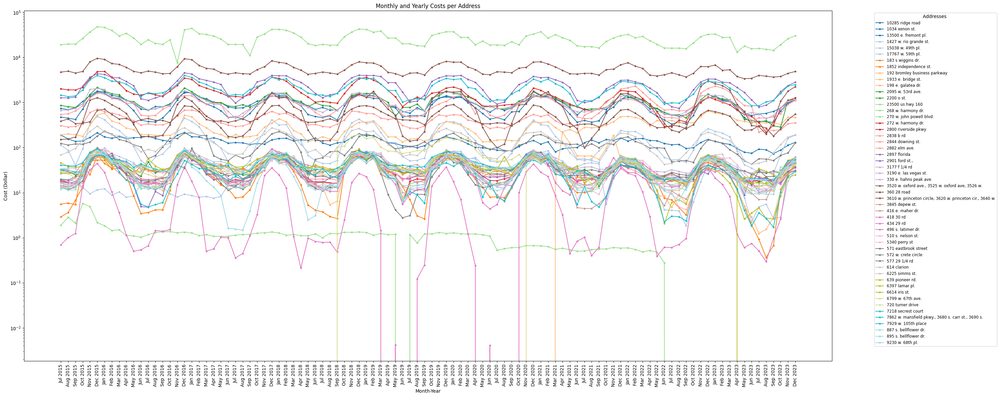


Addresses Sorted by Total Cost:
                                              Address     TotalCost
15                           270 w. john powell blvd.  2.679455e+06
26  3520 w. oxford ave., 3525 w. oxford ave, 3526 ...  5.670410e+05
22                                     2901 ford st.,  2.477711e+05
47  7862 w. mansfield pkwy., 3680 s. carr st., 369...  2.155518e+05
17                                2800 riverside pkwy  1.639570e+05
12                                         2200 o st.  1.078229e+05
24                              3190 e. las vegas st.  1.045701e+05
2                                13500 e. fremont pl.  1.000993e+05
19                                   2844 downing st.  8.914999e+04
0                                    10285 ridge road  8.578411e+04
28  3610 w. princeton circle, 3620 w. princeton ci...  8.308045e+04
20                                      2882 elm ave.  6.310156e+04
27                                        360 28 road  4.863254e+04
9              

In [ ]:
plotMonthYearByCost(matched_cdhs_df)

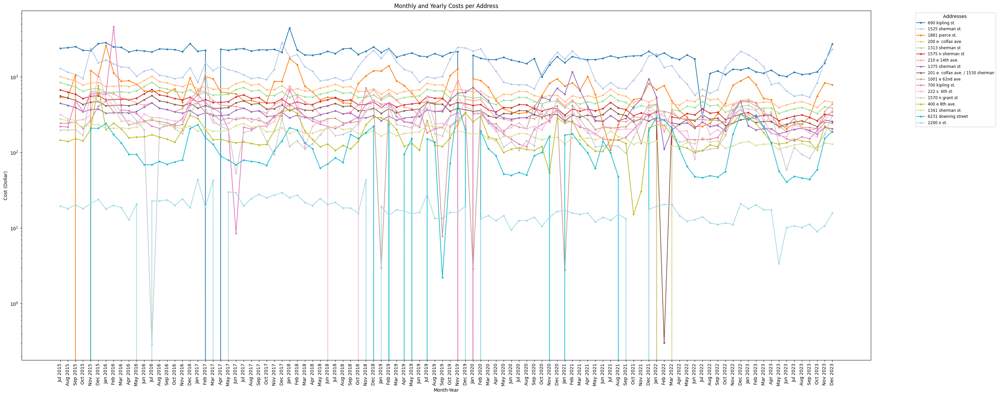


Addresses Sorted by Total Cost:
                              Address      TotalCost
0                     690 kipling st.  192251.441416
1                    1525 sherman st.  132254.587965
2                     1881 pierce st.   68051.031069
3                  200 e. colfax ave.   64507.770156
4                     1313 sherman st   53756.475134
5                   1575 n sherman st   43005.180108
6                     210 e 14th ave.   40088.648889
8   201 e. colfax ave. / 1530 sherman   35871.695469
7                     1375 sherman st   35782.057125
10                    700 kipling st.   31599.310659
9                     1001 e 62nd ave   29430.865753
11                     222 s. 6th st.   27988.591591
12                    1570 n grant st   24855.736916
13                     400 e 8th ave.   18232.163692
14                   1341 sherman st.   17918.825040
15                6231 downing street   11583.664578
16                         2200 o st.    1751.698002

Address with

In [ ]:
# Remove columns containing 'Total' or '2024' and the last row

plotMonthYearByCost(matched_dpa_df)

#### CDHS Yearly Totals per Address

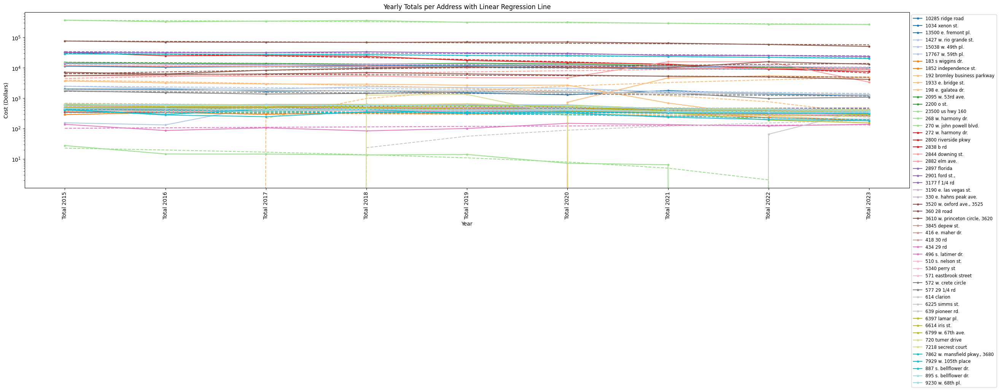

,Address,Slope,Intercept,R_squared
17,2800 riverside pkwy,-3019.953052,30942.841235,0.964303
47,"7862 w. mansfield pkwy., 3680",-1059.211261,29768.315975,0.938151
2,13500 e. fremont pl.,-452.516700,13695.324540,0.917875
40,6225 simms st.,-73.322909,1951.315041,0.876688
13,23500 us hwy 160,-2.970937,22.865912,0.875912
9,1933 e. bridge st.,-458.030920,3973.541106,0.852307
30,416 e. maher dr.,-24.802289,464.396101,0.834472
15,270 w. john powell blvd.,-12189.833023,367233.244482,0.824932
0,10285 ridge road,-315.733442,11492.799856,0.792764
19,2844 downing st.,-343.439148,11962.241237,0.789387


In [ ]:
# Filter down ot only include yearly totals

matched_cdhs_df_filtered = matched_cdhs_df.loc[:,
    matched_cdhs_df.columns.str.contains('Total|Address') &  # Keep columns with 'Total' or 'Address'
    ~matched_cdhs_df.columns.str.contains('2024|2025')  # Exclude columns with '2024 and 2025'
]

plot_yearly_totals(matched_cdhs_df_filtered)

#### DPA Yearly Totals per Address

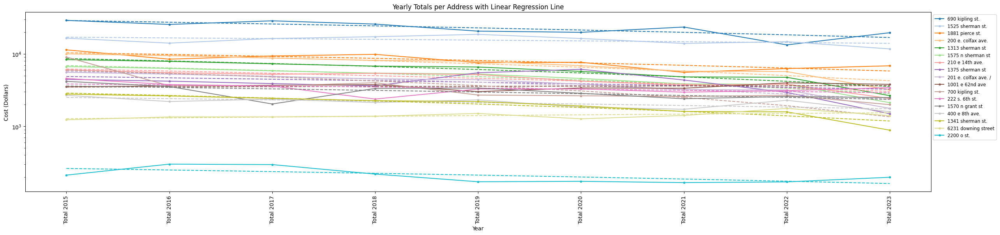

,Address,Slope,Intercept,R_squared
4,1313 sherman st,-635.614529,8636.016979,0.939556
3,200 e. colfax ave.,-762.737435,10363.220374,0.939556
5,1575 n sherman st,-508.491624,6908.813583,0.939556
14,1341 sherman st.,-211.871510,2878.672325,0.939556
8,201 e. colfax ave. /,-423.911314,5761.975395,0.939546
6,210 e 14th ave.,-394.398913,6186.721800,0.887623
2,1881 pierce st.,-574.884507,10408.437125,0.722539
0,690 kipling st.,-1509.019881,28918.544863,0.672197
13,400 e 8th ave.,-94.719214,2506.488343,0.556825
10,700 kipling st.,-575.052256,5955.019205,0.550096


In [ ]:
# Remove columns containing 'Total' or '2024' and the last row
df_filtered = matched_dpa_df.loc[:,
    matched_dpa_df.columns.str.contains('Total|Address') &
    ~matched_dpa_df.columns.str.contains('2024')
]
plot_yearly_totals(df_filtered)

dpa_data_filtered = df_filtered.copy()

####  Histograms - Utility Cost per Fiscal Year

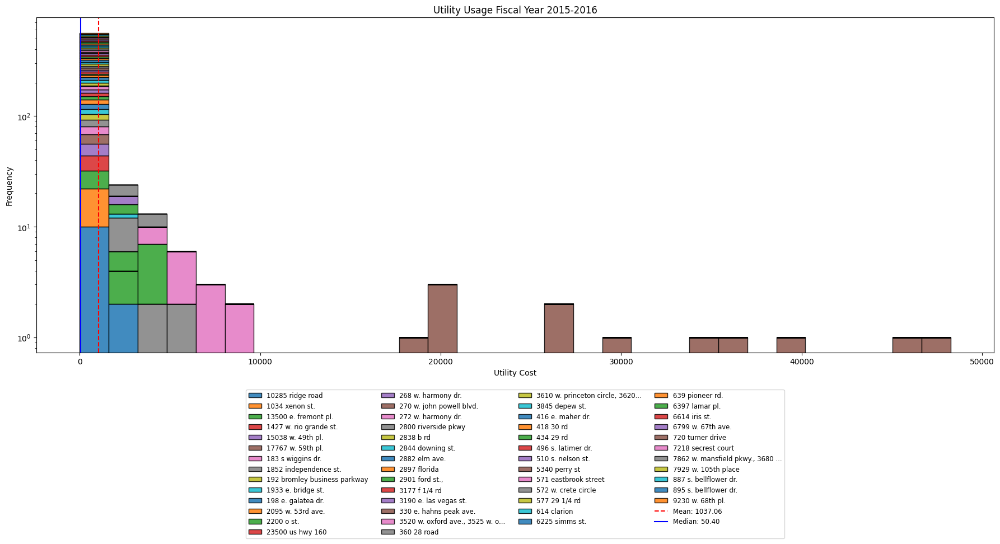

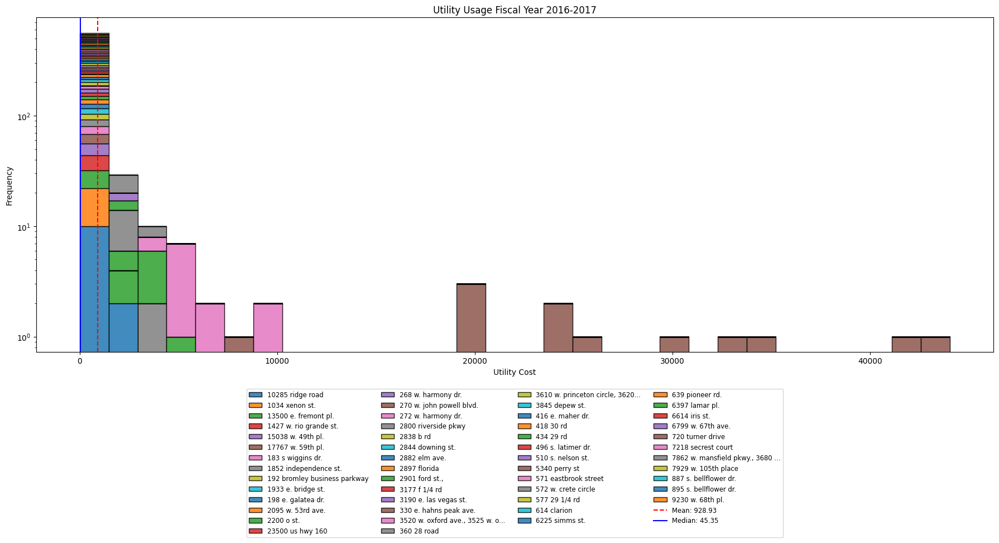

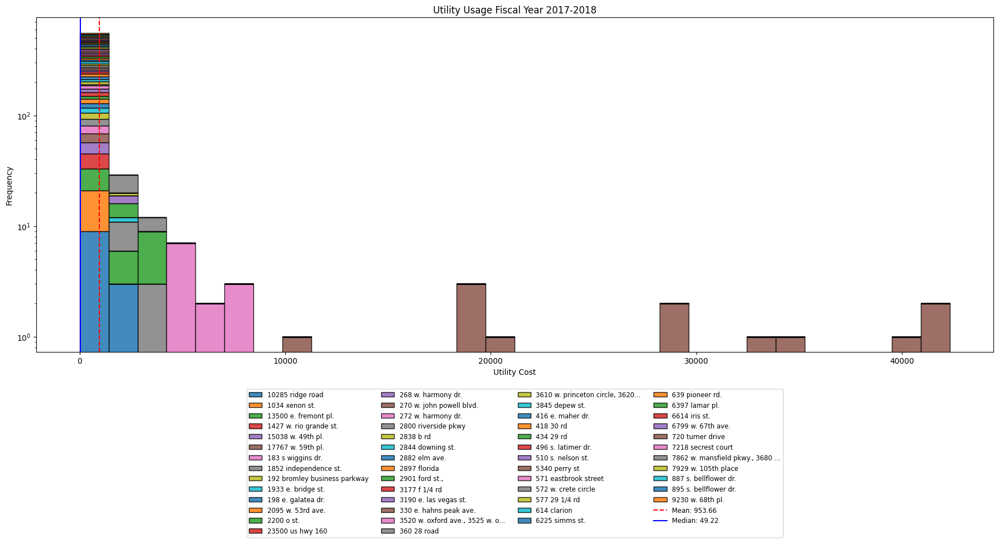

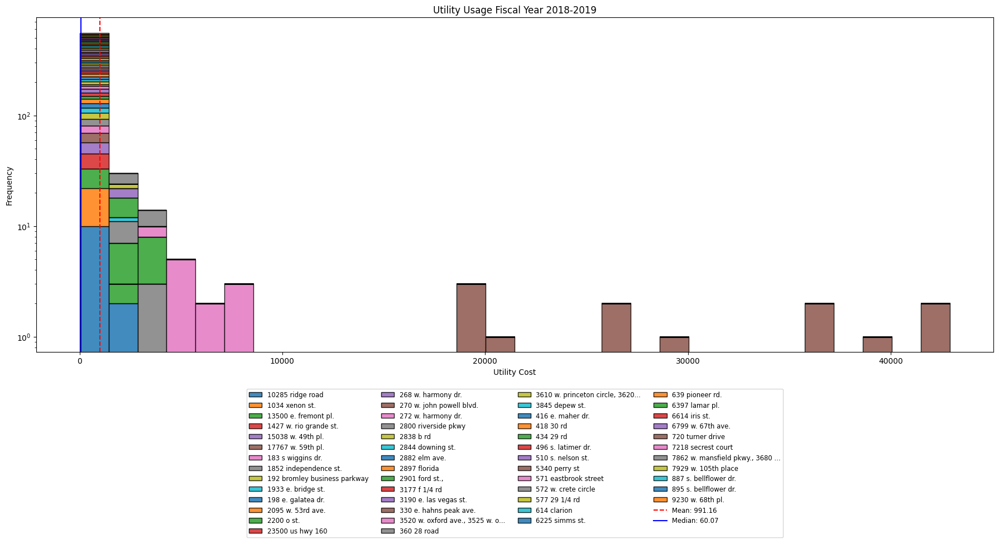

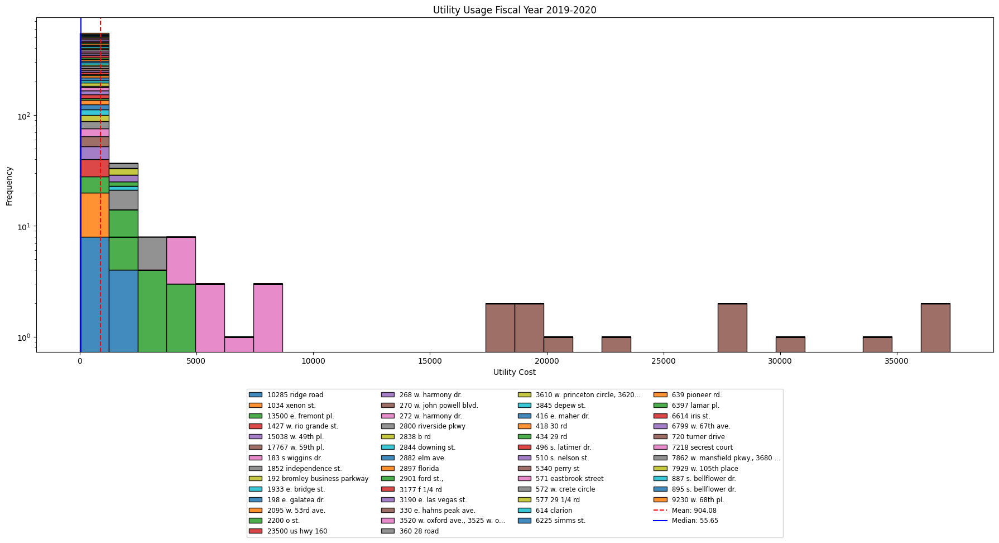

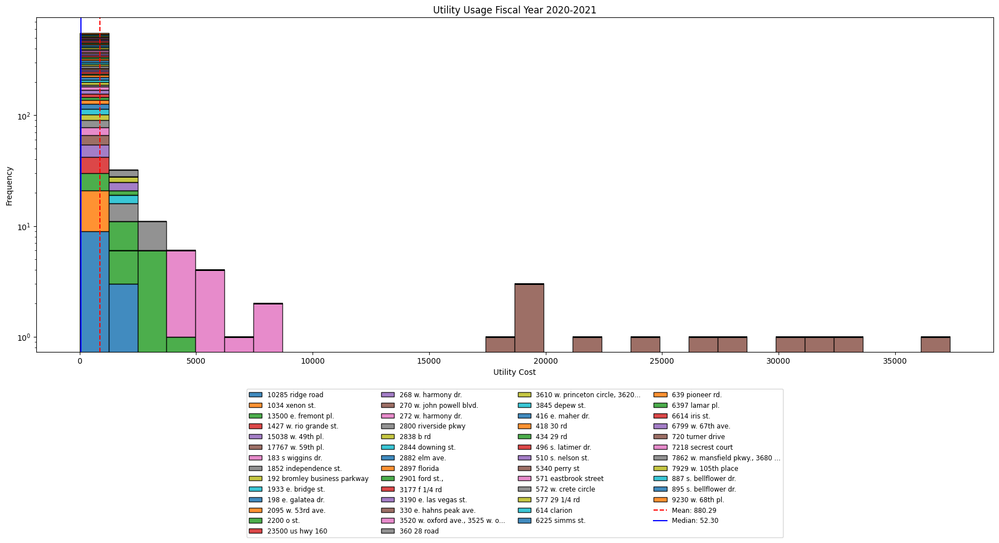

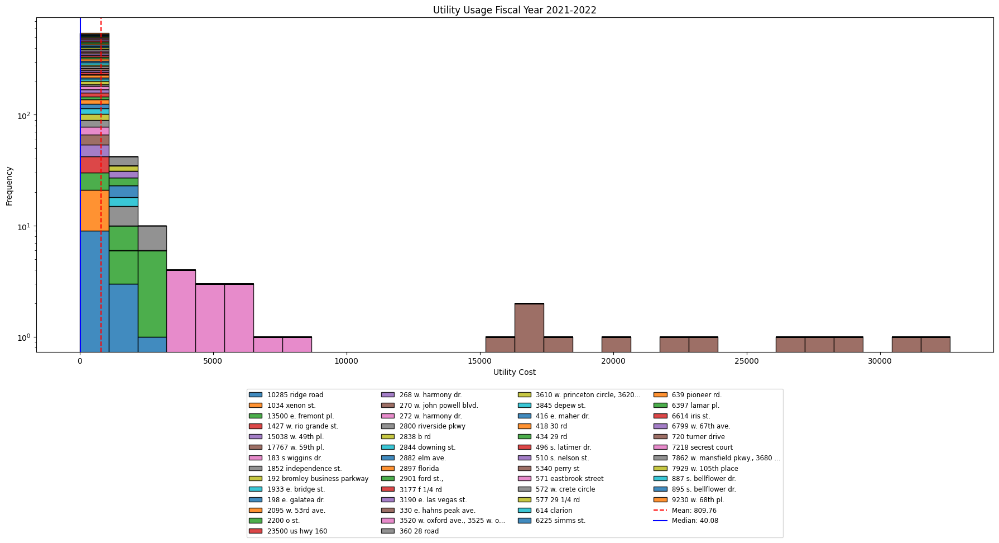

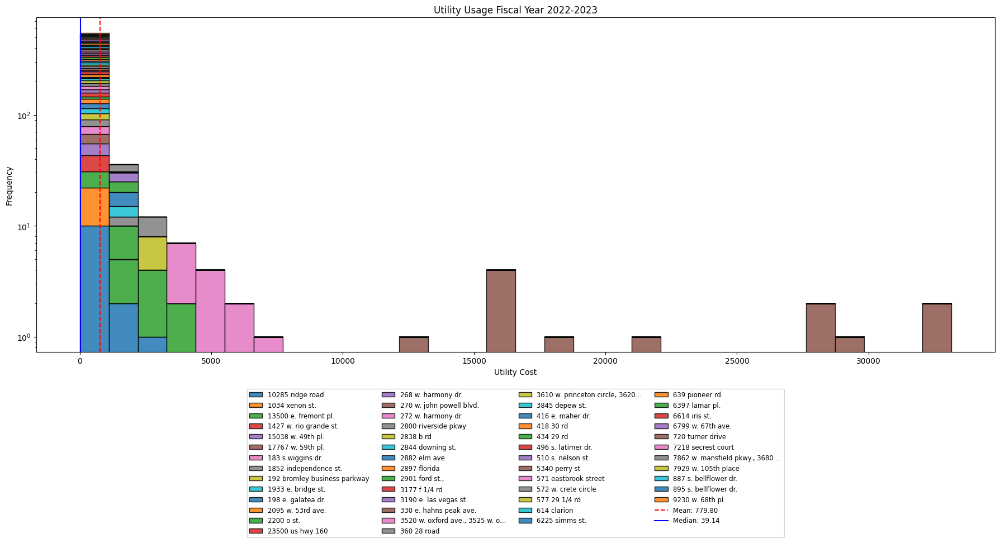

In [ ]:
df_filtered = matched_cdhs_df.loc[:, ~matched_cdhs_df.columns.str.contains('Total|2024|2025')]  # Exclude columns with 'Total' or '2024, 2025'
df_filtered = df_filtered.iloc[:-1]  # Exclude the last row if needed
# Extract the 'Address' column as labels for the plot
df_filtered_labels = df_filtered['Address']

# Drop the 'Address' column, and convert the remaining columns to numeric, coercing errors to NaN
df_filtered = df_filtered.drop(columns='Address').apply(pd.to_numeric, errors='coerce')

# Convert the column names to DateTime format
df_filtered.columns = pd.to_datetime(df_filtered.columns, format='%b %Y')

df_filtered.index = df_filtered_labels
# Call the plot_histogram function
# plot_histogram(df_filtered, 'Utility Cost', 'Frequency', df_filtered_labels)

plot_stacked_histogram(df_filtered, 'Utility Cost', 'Frequency', 'Utility Usage')


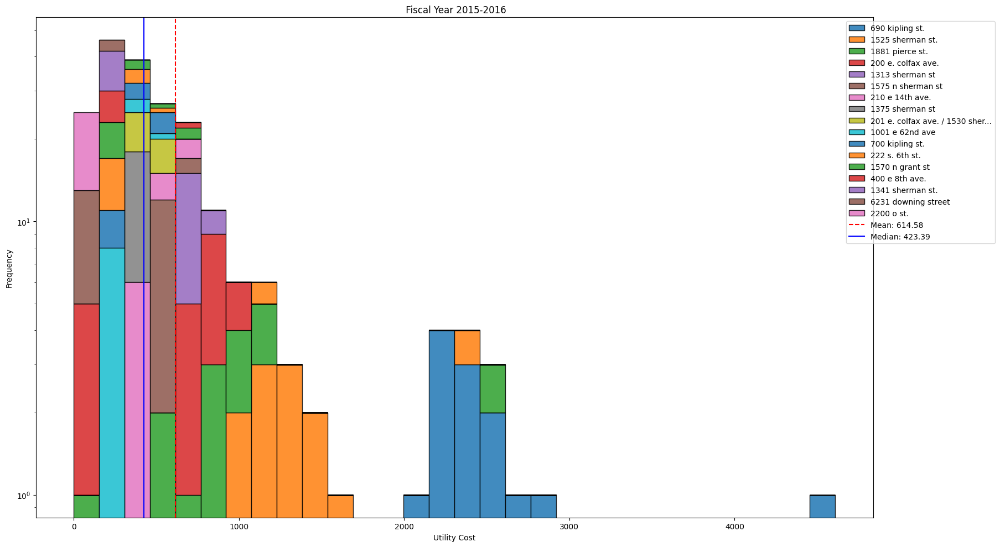

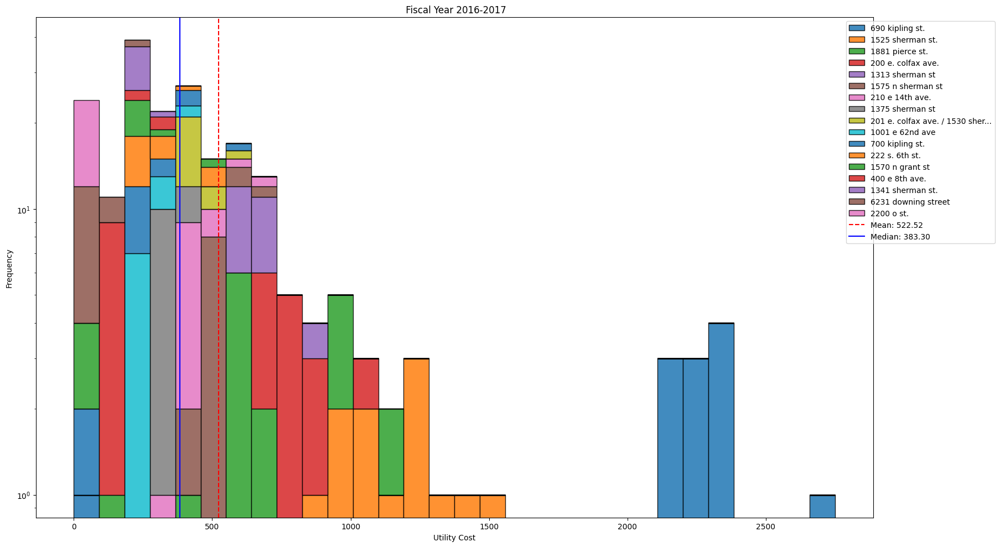

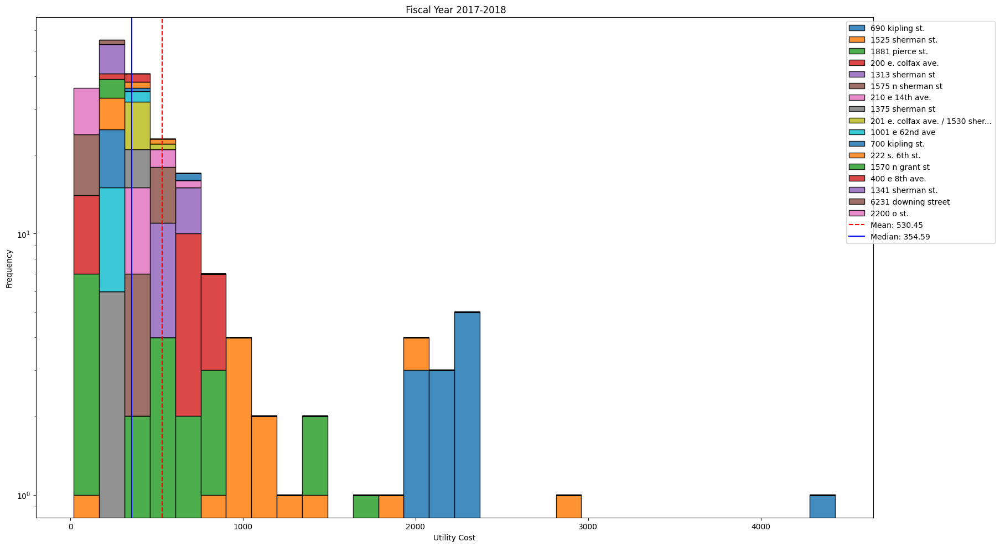

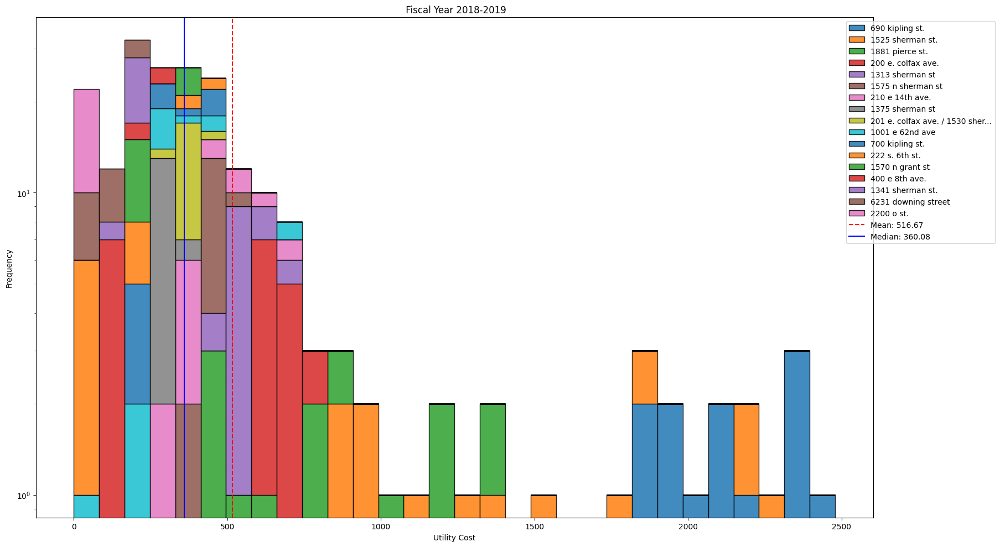

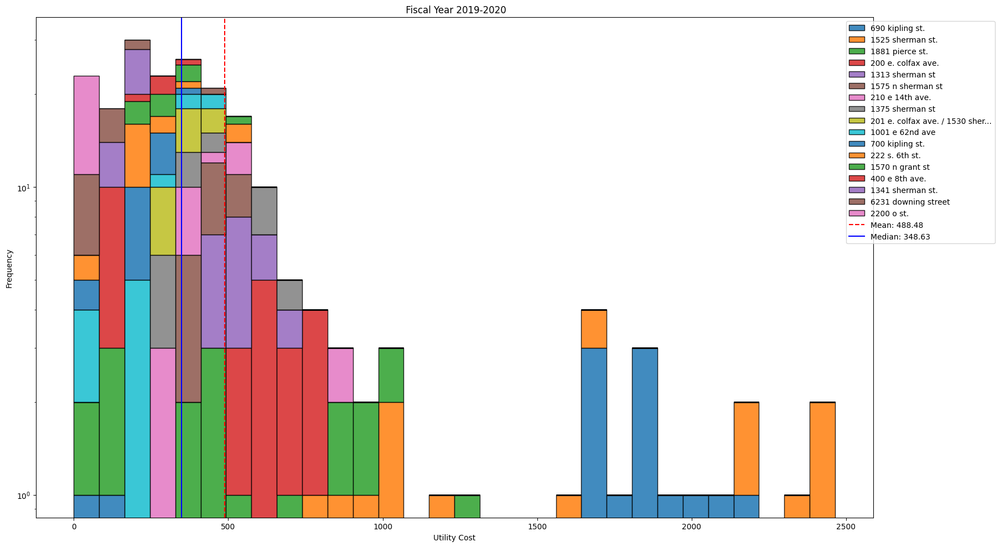

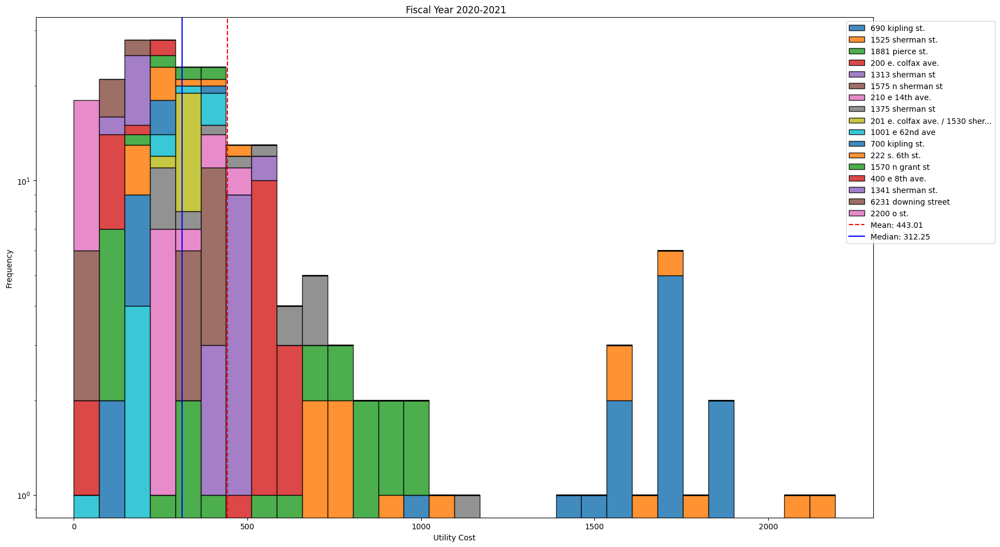

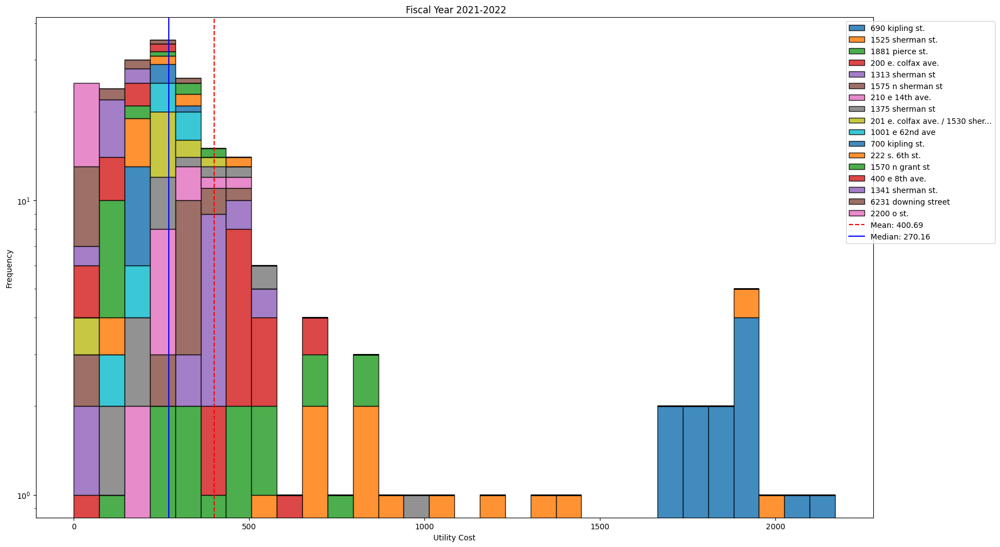

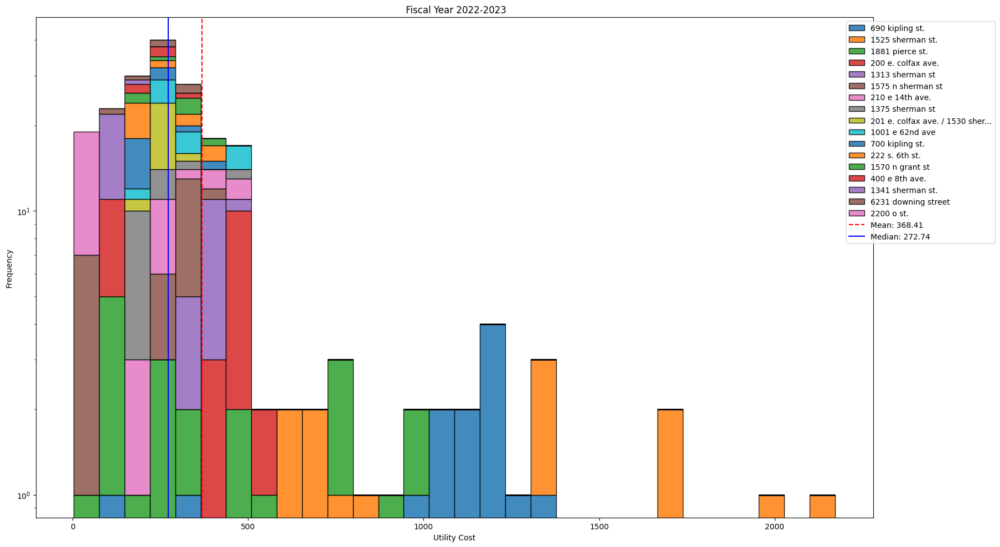

In [ ]:
df_filtered_dpa = matched_dpa_df.loc[:, ~matched_dpa_df.columns.str.contains('Total|2024|2025')]
df_filtered_dpa = df_filtered_dpa.iloc[:-1]

df_filtered_dpa = df_filtered_dpa.rename(columns={df_filtered_dpa.columns[0]: 'Address'})
# Convert value columns to numeric
df_filtered_dpa.iloc[:, 1:] = df_filtered_dpa.iloc[:, 1:].apply(pd.to_numeric, errors='coerce')

df_filtered_labels_dpa = df_filtered_dpa['Address']

# Convert date columns to datetime
date_cols = pd.to_datetime(df_filtered_dpa.columns[1:], format='%b %Y', errors='coerce')
df_filtered_dpa.columns = ['Address'] + list(date_cols)

# Drop any columns that failed to convert to datetime
df_filtered_dpa = df_filtered_dpa.loc[:, ~df_filtered_dpa.columns.isnull()]


df_filtered_dpa = df_filtered_dpa.set_index('Address')


plot_stacked_histogram(df_filtered_dpa, 'Utility Cost', 'Frequency', '')

#### Histogram - Utility Costs by Building

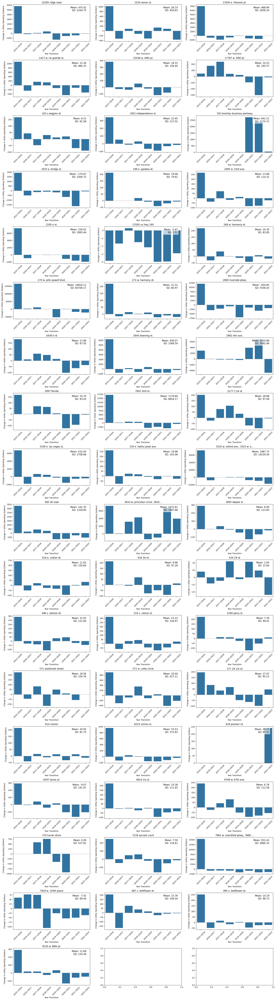

In [ ]:
plot_yearly_change_histogram(df_filtered, 'Year Transition', 'Change in Utility Spending (Dollars)', df_filtered_labels)

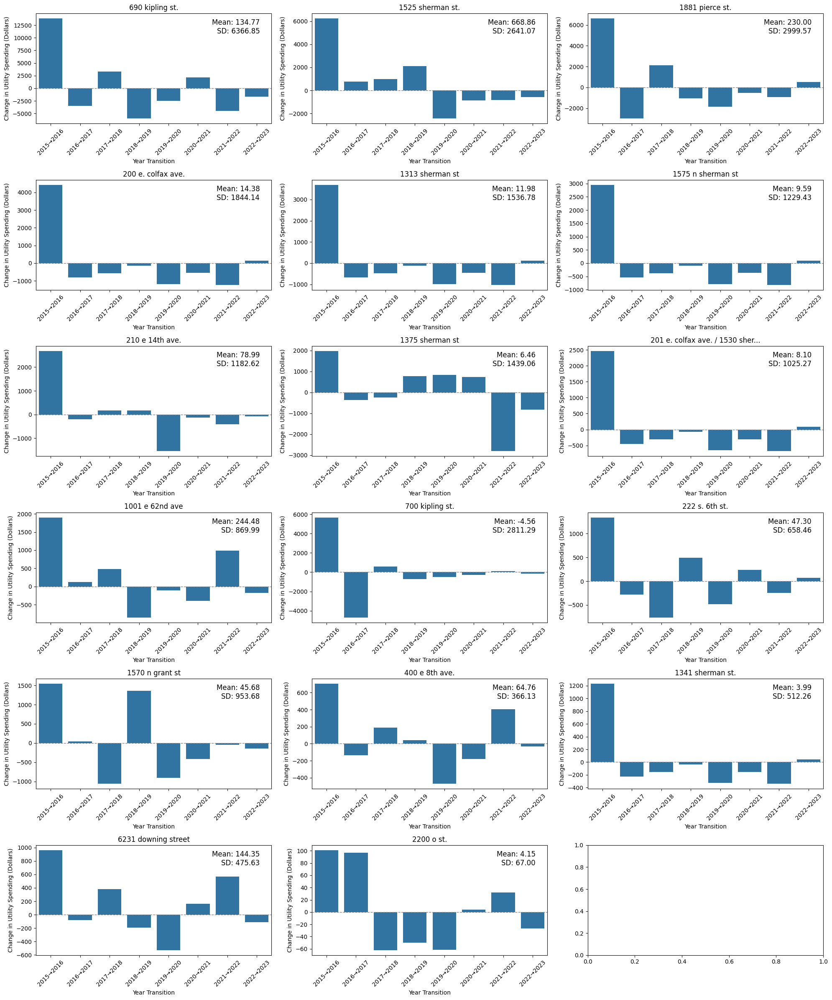

In [ ]:
plot_yearly_change_histogram(df_filtered_dpa, 'Year Transition', 'Change in Utility Spending (Dollars)', df_filtered_labels_dpa)

#### Seasonal Plots

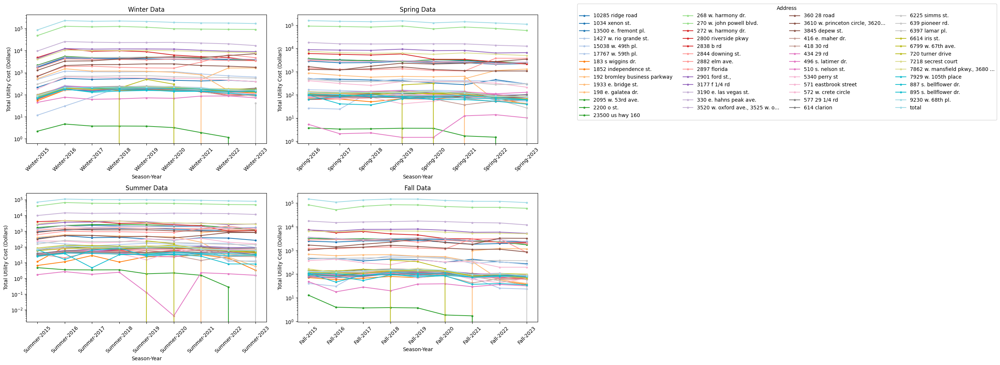

In [ ]:
#Convert Columns from 'Month-Year' to 'Season-Year'

season_year_cdhs = convert_columns_to_seasonal_format(matched_cdhs_df)
#Aggregate columns by 'Season-Year'
season_year_cdhs_aggregated = aggregate_by_season_year(season_year_cdhs)

plotSeasonalCostPerAddress(season_year_cdhs_aggregated)

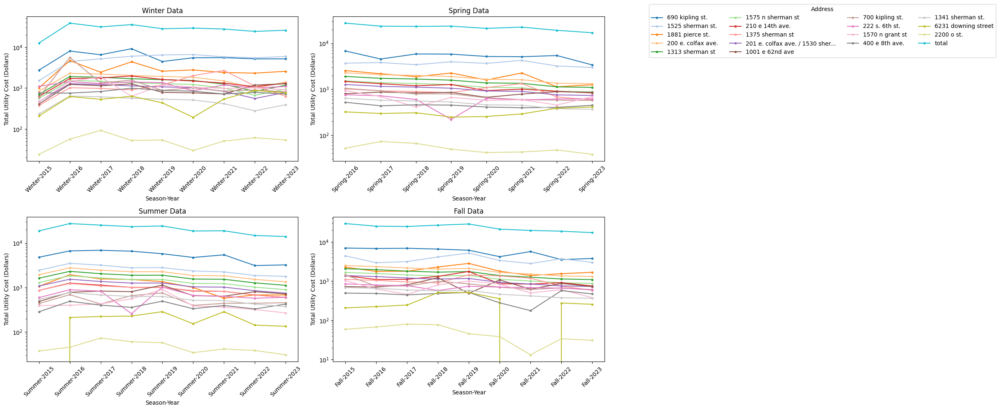

In [ ]:
#Convert Columns from 'Month-Year' to 'Season-Year'
season_year_dpa = convert_columns_to_seasonal_format(matched_dpa_df)

#Aggregate columns by 'Season-Year'
season_year_dpa_aggregated = aggregate_by_season_year(season_year_dpa)

plotSeasonalCostPerAddress(season_year_dpa_aggregated)

#### CDHS Scatter Plot - Monthly (Cost per Square Ft.) by Property


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Missing lot size data for property: 10285 ridge road
Missing lot size data for property: 192 bromley business parkway
Invalid lot size for property: 2095 w. 53rd ave.
Missing lot size data for property: 2200 o st.
Missing lot size data for property: 23500 us hwy 160
Invalid lot size for property: 2800 riverside pkwy
Missing lot size data for property: 5340 perry st
Missing lot size data for property: 720 turner drive
Missing lot size data for property: 7929 w. 105th place
Missing lot size data for property: total


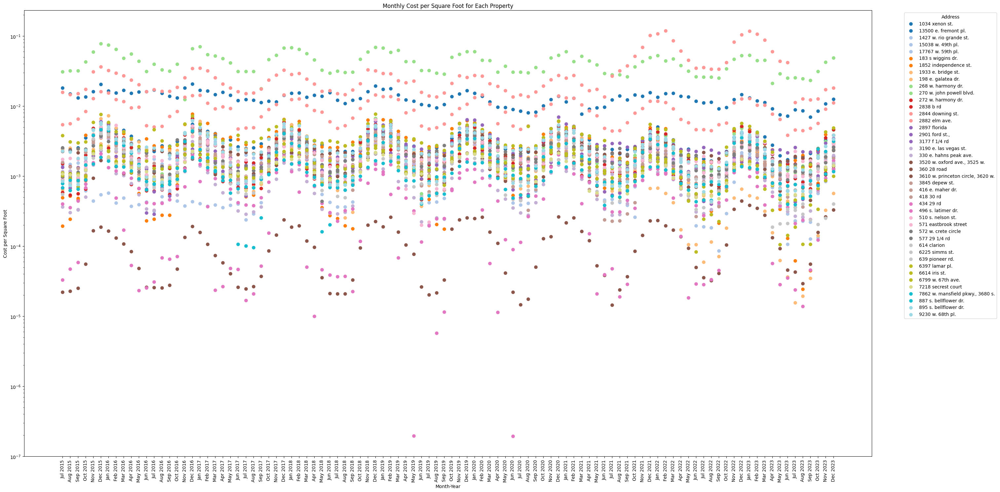

In [ ]:
# Filter the dataframe to exclude columns that contain '2024', '2025', or 'Total'
matched_cdhs_filtered_by_month_year = matched_cdhs_df.loc[:, ~matched_cdhs_df.columns.str.contains('Total|2024|2025')]  # Exclude columns with 'Total', '2024', '2025'

# Exclude the last row
# matched_cdhs_filtered_by_month_year = matched_cdhs_filtered_by_month_year.iloc[:-1]  # Exclude the last row

# Call the plot function with this filtered DataFrame
plot_acre_vs_monthly_cost(matched_cdhs_filtered_by_month_year, property_info_df)

#### DPA Scatter Plot - Monthly (Cost per Square Ft.) by Property

Missing lot size data for property: 6231 downing street
Missing lot size data for property: 2200 o st.


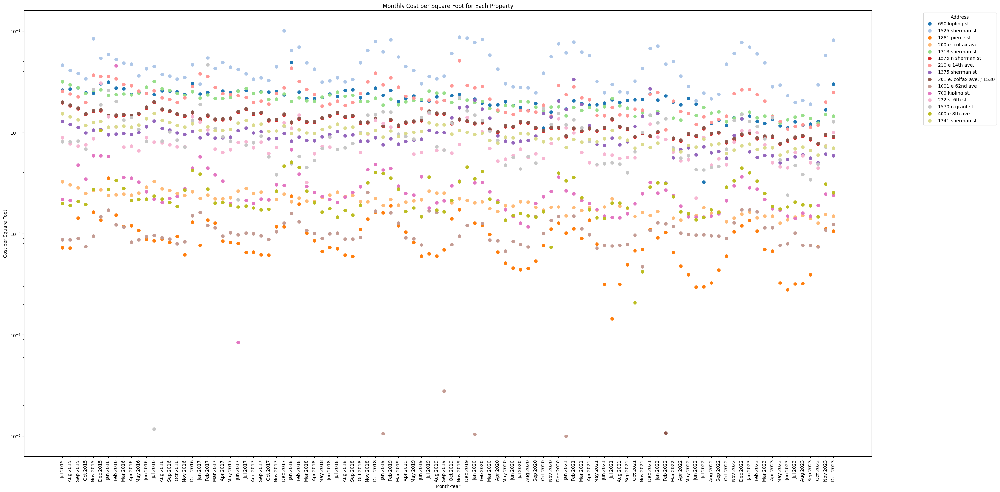

In [ ]:
# Filter the dataframe to exclude columns that contain '2024', '2025', or 'Total'
matched_dpa_filtered_by_month_year = matched_dpa_df.loc[:, ~matched_dpa_df.columns.str.contains('Total|2024|2025')]  # Exclude columns with 'Total', '2024', '2025'

# Exclude the last row
matched_dpa_filtered_by_month_year = matched_dpa_filtered_by_month_year.iloc[:-1]  # Exclude the last row

#Call the plot function with this filtered DataFrame
plot_acre_vs_monthly_cost(matched_dpa_filtered_by_month_year, property_info_df)

In [ ]:
# Delete irrelevant dfs moving forward

del df_filtered, season_year_cdhs, season_year_cdhs_aggregated, season_year_dpa, \
    season_year_dpa_aggregated


## Models
Implementing machine learning models to fit the CDHS and DPA data. Regression - to predict future monthly/yearly electricity expenses in the future - and classification - to determine which buildings should receive funding.

###Yearly Totals Regression Model

For more information on regression model evaluations, see our reference section below.  
[Jump to Regression Evaluation reference](#regression-id)

In [ ]:
# Implement lin regression model for each address(CDHS) with costs as features

year_tot_reg_cdhs_df = formatYearlyTotalRegressionDF(matched_cdhs_df_filtered)
train_test_data = trainTestSplitYearly(year_tot_reg_cdhs_df)
best_models = linRegYearly(train_test_data)

print(f'{len(best_models)} are "good" out of {len(train_test_data)}')

Metrics for 10285 ridge road
y = [-353.65040519]x + 724372.3116308445
R^2: 0.03933301657420829
NRMSE: 0.4900681032840721
Metrics for 1034 xenon st.
y = [-83.88392696]x + 170979.6535850456
R^2: 0.9268667798617808
NRMSE: 0.135215772136814
Metrics for 13500 e. fremont pl.
y = [-438.7511582]x + 897731.9229846302
R^2: 0.9904108513187498
NRMSE: 0.048962099325014
Metrics for 1427 w. rio grande st.
y = [-144.54071627]x + 293836.21475345583
R^2: 0.4688859748077473
NRMSE: 0.3643878514688205
Metrics for 15038 w. 49th pl.
y = [-32.75262275]x + 66662.6758236334
R^2: 0.964656145868633
NRMSE: 0.09399980602555381
Metrics for 17767 w. 59th pl.
y = [-5.59528463]x + 11740.375402188343
R^2: -34.16299240950483
NRMSE: 2.9649195777248676
Metrics for 183 s wiggins dr.
y = [-7.06480731]x + 14569.48859037008
R^2: 0.4885340868131842
NRMSE: 0.35758422545842805
Metrics for 1852 independence st.
y = [-12.0250904]x + 24742.84461937501
R^2: 0.6126084759253717
NRMSE: 0.31120392192042995
Metrics for 1933 e. bridge st.


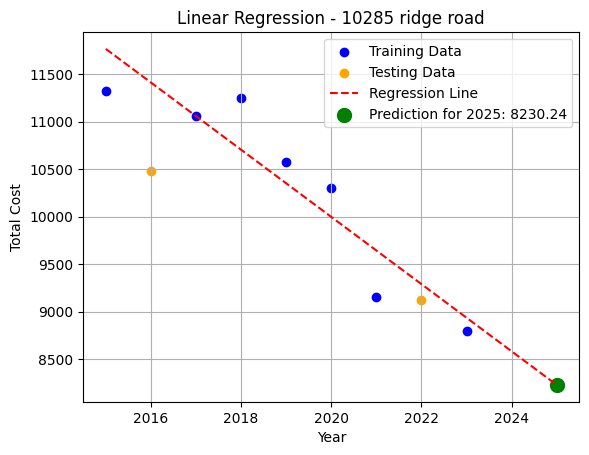

In [ ]:
# Example for how you'd test future years on a given address

address = '10285 ridge road'
year = 2025

X_train = train_test_data[address]['X_train']
y_train = train_test_data[address]['y_train']
X_test = train_test_data[address]['X_test']
y_test = train_test_data[address]['y_test']

model = LinearRegression()
model.fit(X_train, y_train)
y_preds = model.predict([[year]])

X_range = np.arange(min(X_train), 2026, 1).reshape(-1, 1)  # Range of years up to 2025
y_pred_line = model.predict(X_range)

# Plot training data
plt.scatter(X_train, y_train, color='blue', label='Training Data')

# Plot testing data
plt.scatter(X_test, y_test, color='orange', label='Testing Data')

# Plot regression line
plt.plot(X_range, y_pred_line, color='red', linestyle='--', label='Regression Line')

# Highlight 2025 prediction
plt.scatter([year], y_preds, color='green', marker='o', s=100, label=f'Prediction for {year}: {y_preds[0]:.2f}')

# Labels and title
plt.xlabel("Year")
plt.ylabel("Total Cost")
plt.title(f"Linear Regression - {address}")
plt.legend()
plt.grid(True)

In [ ]:
# Implement lin regression model for each address(DPA) with costs as features

year_tot_reg_dpa_df = formatYearlyTotalRegressionDF(dpa_data_filtered)
train_test_data = trainTestSplitYearly(year_tot_reg_dpa_df)
best_models = linRegYearly(train_test_data)

print(f'{len(best_models)} are "good" out of {len(train_test_data)}')

Metrics for 1001 e 62nd ave
y = [2.95335837]x + -2459.3544867143837
R^2: -2.418095497738803
NRMSE: 0.9244046053729399
Metrics for 1313 sherman st
y = [-684.81432568]x + 1388670.1566956772
R^2: 0.8673698810266754
NRMSE: 0.18209209138051863
Metrics for 1341 sherman st.
y = [-228.27144167]x + 462890.05178427784
R^2: 0.867369880461672
NRMSE: 0.18209209176837418
Metrics for 1375 sherman st
y = [-199.89007999]x + 407783.1814543704
R^2: -0.0063625662476425315
NRMSE: 0.5015881194385595
Metrics for 1525 sherman st.
y = [-589.96911838]x + 1206964.941022833
R^2: -56.545164890138345
NRMSE: 3.792926472070687
Metrics for 1570 n grant st
y = [-154.00328395]x + 313886.0772129478
R^2: 0.9419255048730232
NRMSE: 0.1204932520174645
Metrics for 1575 n sherman st
y = [-547.85146075]x + 1110936.1257719577
R^2: 0.8673698803328667
NRMSE: 0.18209209185679465
Metrics for 1881 pierce st.
y = [-664.53887155]x + 1350024.6387339358
R^2: -0.4222945158916189
NRMSE: 0.5962999488285277
Metrics for 200 e. colfax ave.
y =

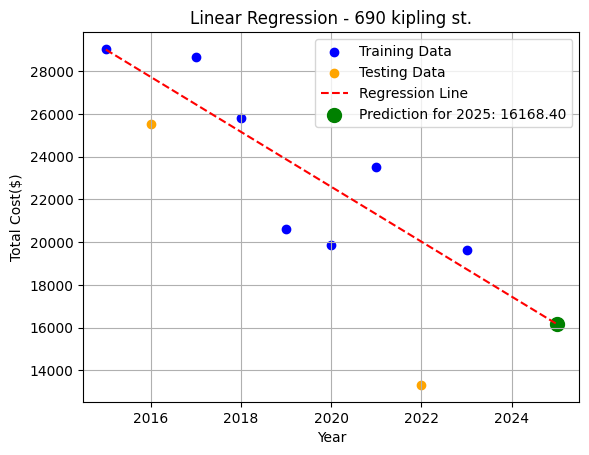

In [ ]:
# Example for how you'd test future years on a given address

address = '690 kipling st.'
year = 2025

X_train = train_test_data[address]['X_train']
y_train = train_test_data[address]['y_train']
X_test = train_test_data[address]['X_test']
y_test = train_test_data[address]['y_test']

model = LinearRegression()
model.fit(X_train, y_train)
y_preds = model.predict([[year]])

X_range = np.arange(min(X_train), 2026, 1).reshape(-1, 1)  # Range of years up to 2025
y_pred_line = model.predict(X_range)

# Plot training data
plt.scatter(X_train, y_train, color='blue', label='Training Data')

# Plot testing data
plt.scatter(X_test, y_test, color='orange', label='Testing Data')

# Plot regression line
plt.plot(X_range, y_pred_line, color='red', linestyle='--', label='Regression Line')

# Highlight 2025 prediction
plt.scatter([year], y_preds, color='green', marker='o', s=100, label=f'Prediction for {year}: {y_preds[0]:.2f}')

# Labels and title
plt.xlabel("Year")
plt.ylabel("Total Cost($)")
plt.title(f"Linear Regression - {address}")
plt.legend()
plt.grid(True)


In [ ]:
del matched_cdhs_df_filtered, dpa_data_filtered

### Linear Regression Model Historical Cost per Square Footage




We applied linear regression models to analyze historical cost data for buildings associated with CDHS and DPA. Rather than forecasting future costs, our objective was to identify general growth patterns in building expenses over time. Each building's cost trend was summarized using two key metrics:

Slope: Indicates the rate at which costs are increasing or decreasing over time.

R² Score: Measures how well a straight line fits the data, reflecting the consistency of the trend.
ResearchGate

However, this model does not account for seasonality. Based on the R² scores, it was determined that these were not reliable measures of growth in utility costs.


In [ ]:
# Clean and merge for CDHS

cdhs_with_lot_size = add_lot_size_to_matched_df(matched_cdhs_filtered_by_month_year, property_info_df)

In [ ]:
# Copy the dataframe to preserve original

normalized_chds_with_lot_size = cdhs_with_lot_size.copy()

# Identify only the date columns (excluding 'Address' and 'Lot Size')
date_columns_cdhs = normalized_chds_with_lot_size.columns.drop(['Address', 'Lot Size (Final SqFt)'])

# Normalize each value by square footage
normalized_chds_with_lot_size[date_columns_cdhs] = normalized_chds_with_lot_size[date_columns_cdhs].div(normalized_chds_with_lot_size['Lot Size (Final SqFt)'], axis=0)

# Drop rows with any 0 values in date columns
normalized_chds_with_lot_size = normalized_chds_with_lot_size[
    ~(normalized_chds_with_lot_size[date_columns_cdhs] == 0).any(axis=1)
]

In [ ]:
# Calculate average normalized cost across all months for each building

normalized_chds_with_lot_size['Average Cost/SqFt'] = normalized_chds_with_lot_size[date_columns_cdhs].mean(axis=1)

# Sort buildings by average cost (highest to lowest)
top_avg_cost_buildings = normalized_chds_with_lot_size.sort_values('Average Cost/SqFt', ascending=False)

# Display top 5
top_avg_cost_buildings[['Address', 'Average Cost/SqFt']].head()

,Address,Average Cost/SqFt
15,270 w. john powell blvd.,0.042231
20,2882 elm ave.,0.031560
1,1034 xenon st.,0.012990
19,2844 downing st.,0.008724
43,6614 iris st.,0.003688


In [ ]:
# Time index for regression (e.g., 0 to N-1)

time_index = np.arange(len(date_columns_cdhs)).reshape(-1, 1)

# Prepare lists for storing slopes and R² scores
growth_rates = []
r2_scores = []

# Track corresponding addresses
valid_addresses = []

# Loop through buildings
for idx, row in normalized_chds_with_lot_size.iterrows():
    y = row[date_columns_cdhs].values.astype(float)

    # Skip if more than, say, 20% of data is missing
    if np.isnan(y).sum() > 0.2 * len(y):
        growth_rates.append(np.nan)  # Or skip entirely
        r2_scores.append(np.nan)
        continue

    # Fill small gaps with linear interpolation
    y = pd.Series(y).interpolate(limit_direction='both').values

    # Fit linear regression
    model = LinearRegression().fit(time_index, y)
    slope = model.coef_[0]

    # Predict the values and calculate R²
    y_pred = model.predict(time_index)
    r2 = r2_score(y, y_pred)

    growth_rates.append(slope)
    r2_scores.append(r2)
    valid_addresses.append(row['Address'])

# Add slopes and R² scores to the DataFrame
normalized_chds_with_lot_size['Cost Growth Rate (slope)'] = growth_rates
normalized_chds_with_lot_size['R² Score'] = r2_scores

# Drop rows with NaN growth rate or R² score if needed
valid_growth_df = normalized_chds_with_lot_size.dropna(subset=['Cost Growth Rate (slope)', 'R² Score'])

# Create a new DataFrame with Address, Growth Slopes, and R² Scores
final_df = valid_growth_df[['Address', 'Cost Growth Rate (slope)', 'R² Score']]

# Show the resulting DataFrame
final_df.head()

,Address,Cost Growth Rate (slope),R² Score
1,1034 xenon st.,-0.000060,0.349483
2,13500 e. fremont pl.,-0.000011,0.094025
3,1427 w. rio grande st.,-0.000007,0.042929
4,15038 w. 49th pl.,-0.000012,0.100871
5,17767 w. 59th pl.,0.000002,0.002771


In [ ]:
# Properly initialize DF

dpa_with_lot_size = add_lot_size_to_matched_df(matched_dpa_filtered_by_month_year, property_info_df)

normalized_dpa_with_lot_size = dpa_with_lot_size.copy()

# Identify only the date columns (excluding 'Address' and 'Lot Size')
date_columns_dpa = normalized_dpa_with_lot_size.columns.drop(['Address', 'Lot Size (Final SqFt)'])

# Normalize each value by square footage
normalized_dpa_with_lot_size[date_columns_cdhs] = normalized_dpa_with_lot_size[date_columns_cdhs].div(normalized_dpa_with_lot_size['Lot Size (Final SqFt)'], axis=0)

# Drop rows with any 0 values in date columns
normalized_dpa_with_lot_size = normalized_dpa_with_lot_size[
    ~(normalized_dpa_with_lot_size[date_columns_cdhs] == 0).any(axis=1)
]

# Calculate average normalized cost across all months for each building
normalized_dpa_with_lot_size['Average Cost/SqFt'] = normalized_dpa_with_lot_size[date_columns_cdhs].mean(axis=1)

# Sort buildings by average cost (highest to lowest)
top_avg_cost_buildings = normalized_dpa_with_lot_size.sort_values('Average Cost/SqFt', ascending=False)

# Display top 5
top_avg_cost_buildings[['Address', 'Average Cost/SqFt']].head()

,Address,Average Cost/SqFt
1,1525 sherman st.,0.046007
6,210 e 14th ave.,0.022459
8,201 e. colfax ave. / 1530 sherman,0.012481
7,1375 sherman st,0.010052
12,1570 n grant st,0.009919


In [ ]:
# Time index for regression (e.g., 0 to N-1)

time_index = np.arange(len(date_columns_dpa)).reshape(-1, 1)

# Prepare lists for storing slopes and R² scores
growth_rates = []
r2_scores = []

# Track corresponding addresses
valid_addresses = []

# Loop through buildings
for idx, row in normalized_dpa_with_lot_size.iterrows():
    y = row[date_columns_cdhs].values.astype(float)

    # Skip if more than, say, 20% of data is missing
    if np.isnan(y).sum() > 0.2 * len(y):
        growth_rates.append(np.nan)  # Or skip entirely
        r2_scores.append(np.nan)
        continue

    # Fill small gaps with linear interpolation
    y = pd.Series(y).interpolate(limit_direction='both').values

    # Fit linear regression
    model = LinearRegression().fit(time_index, y)
    slope = model.coef_[0]

    # Predict the values and calculate R²
    y_pred = model.predict(time_index)
    r2 = r2_score(y, y_pred)

    growth_rates.append(slope)
    r2_scores.append(r2)
    valid_addresses.append(row['Address'])

# Add slopes and R² scores to the DataFrame
normalized_dpa_with_lot_size['Cost Growth Rate (slope)'] = growth_rates
normalized_dpa_with_lot_size['R² Score'] = r2_scores

# Drop rows with NaN growth rate or R² score if needed
valid_growth_df = normalized_dpa_with_lot_size.dropna(subset=['Cost Growth Rate (slope)', 'R² Score'])

# Create a new DataFrame with Address, Growth Slopes, and R² Scores
final_df = valid_growth_df[['Address', 'Cost Growth Rate (slope)', 'R² Score']]

# Show the resulting DataFrame
final_df

,Address,Cost Growth Rate (slope),R² Score
1,1525 sherman st.,-5.741586e-05,0.008375
6,210 e 14th ave.,-1.343660e-04,0.278288
7,1375 sherman st,-2.101459e-05,0.019649
8,201 e. colfax ave. / 1530 sherman,-9.015520e-05,0.738803
9,1001 e 62nd ave,-4.983605e-07,0.001549
12,1570 n grant st,-5.259661e-05,0.063361
13,400 e 8th ave.,-7.457369e-06,0.031234


In [ ]:
# Delete irrelevant dfs moving forward

del matched_cdhs_filtered_by_month_year, matched_dpa_filtered_by_month_year, year_tot_reg_cdhs_df, \
    year_tot_reg_dpa_df, final_df, cdhs_with_lot_size, dpa_with_lot_size

**Computational Space of models moving forward**

In [ ]:
normalized_chds_with_lot_size.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
Index: 51 entries, 0 to 52
Columns: 107 entries, Address to R² Score
dtypes: float64(106), object(1)
memory usage: 47.6 KB


In [ ]:
normalized_dpa_with_lot_size.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
Index: 9 entries, 1 to 16
Columns: 107 entries, Address to R² Score
dtypes: float64(106), object(1)
memory usage: 8.2 KB




###SARIMA Model
In our time series analysis and forecast, we implement a SARIMA Model (Seasonal AutoRegressive Integrated Moving Average). This model was chosen because of the seasonality in our data, where utility costs are higher in some months and lower in others. SARIMA is an extension of ARIMA models (AutoRegressive Integrated Moving Average). It combines autoregression, differencing (integration), and moving average components, along with a seasonal component, to make more accurate forecasts.

**(AR)** - Autoregressive component the forecast variable is calculated using a linear combination of its past values. For example:

$
m_t = \beta_0 + \beta_1 m_{t-1} + \beta_2 m_{t-2} + \cdots + \beta_p m_{t-p}
$

Where the current value of **$m_t$** is expressed as a linear function of its past values and it's regression coeffienients $[0,p]$.

**(I)** - Integration  component refers to any differencing applied to our model in order to make the data stationary.   

**(MA**) - Moving Average component uses past forecast error to predict future values. For example:

$
m_t = β_0 + β_1 e_{t-1} + β_2 e_{t-2} + ... + β_q e_{t-q}
$

Where $e$ represents the error or residual deviation between past values and the target.  [Bajaj 2022]



For the SARIMA model a seasonal component to the ARIMA model. With the following structure:

SARIMA $(p, d, q)(P, D, Q, m)$


$p$: Number of lagged observations, a value of p=1 will have the model use the value from the previous timestep to predict the current value.
$d$: Number of times data is differenced, d=1 will take the first difference.

$q$: Size of moving average window, a value of q=1 will use the error from the previous forecast to predict the current value.

$P$: Seasonal autoregressive order, a value of P=1 will have the model use the value of the same month from the previous year to predict current months value

$D$: Seasonal difference order, a value of D=1 is used for removing seasonal trends

$Q$: Seasonal moving average order, a value of Q=1 would mean using the forecast error from the same month in the previous year

$m$: Length of the seasonal period. [Penn State 2025]

[Jump to references](#auto_arima-id)

In [ ]:
#Prepare the dataframe so we can treat time series columns (e.g. "Jan 2016", "Feb 2016", etc.) as datetime objects

# List all non-date columns
non_date_columns = ['Address', 'Lot Size (Final SqFt)', 'Average Cost/SqFt', 'Cost Growth Rate (slope)', 'R² Score']

# Apply conversion only to likely date columns
normalized_chds_with_lot_size.columns = [
    pd.to_datetime(col) if col not in non_date_columns else col
    for col in normalized_chds_with_lot_size.columns
]

# Extract only datetime columns for SARIMA modeling
time_columns = [col for col in normalized_chds_with_lot_size.columns if col not in non_date_columns]
normalized_chds_with_lot_size = normalized_chds_with_lot_size[normalized_chds_with_lot_size.drop(columns=['Address']).notna().any(axis=1)]

normalized_chds_with_lot_size.head()

,Address,2015-07-01 00:00:00,2015-08-01 00:00:00,2015-09-01 00:00:00,2015-10-01 00:00:00,2015-11-01 00:00:00,2015-12-01 00:00:00,2016-01-01 00:00:00,2016-02-01 00:00:00,2016-03-01 00:00:00,...,2023-07-01 00:00:00,2023-08-01 00:00:00,2023-09-01 00:00:00,2023-10-01 00:00:00,2023-11-01 00:00:00,2023-12-01 00:00:00,Lot Size (Final SqFt),Average Cost/SqFt,Cost Growth Rate (slope),R² Score
1,1034 xenon st.,0.018223,0.014852,0.013118,0.013520,0.016107,0.020496,0.016512,0.015425,0.016785,...,0.008875,0.008556,0.007006,0.008478,0.010775,0.012526,10454.4,0.012990,-0.000060,0.349483
2,13500 e. fremont pl.,0.002448,0.002304,0.002555,0.003531,0.004782,0.005904,0.005743,0.004793,0.004500,...,0.001832,0.001912,0.002111,0.002486,0.003258,0.003847,302306.4,0.003246,-0.000011,0.094025
3,1427 w. rio grande st.,0.000942,0.000717,0.000328,0.000778,0.002867,0.004047,0.003440,0.002420,0.001970,...,0.000231,0.000229,0.000220,0.000569,0.001318,0.001561,121532.0,0.001350,-0.000007,0.042929
4,15038 w. 49th pl.,0.001434,0.001476,0.001540,0.001756,0.002750,0.004339,0.005373,0.004008,0.003481,...,0.000985,0.000847,0.000761,0.000953,0.001722,0.002566,18295.2,0.002410,-0.000012,0.100871
5,17767 w. 59th pl.,0.000953,0.000922,0.000826,0.000618,0.000443,0.000545,0.000571,0.000412,0.000486,...,0.000227,0.000260,0.000127,0.000133,0.000840,0.001475,21344.4,0.001502,0.000002,0.002771


In [ ]:
# Run the backtest and get the results

forecast_df_cdhs, failed_buildings_cdhs, ts_cdhs, error_metrics_cdhs, modeled_data_cdhs = backtest_sarima(normalized_chds_with_lot_size, (3, 1, 3), (1, 1, 1, 12))

# Convert the error metrics list to a DataFrame
error_df_cdhs = pd.DataFrame(error_metrics_cdhs)

sarima_error_cdhs_df = error_df_cdhs.copy()
# Display the error metrics DataFrame
display(error_df_cdhs)

'1034 xenon st.'

1034 xenon st.: Training = 90, Testing = 12


'13500 e. fremont pl.'

13500 e. fremont pl.: Training = 90, Testing = 12


'1427 w. rio grande st.'

1427 w. rio grande st.: Training = 90, Testing = 12


'15038 w. 49th pl.'

15038 w. 49th pl.: Training = 90, Testing = 12


'17767 w. 59th pl.'

17767 w. 59th pl.: Training = 90, Testing = 12


'183 s wiggins dr.'

183 s wiggins dr.: Training = 90, Testing = 12


'1852 independence st.'

1852 independence st.: Training = 90, Testing = 12


'1933 e. bridge st.'

1933 e. bridge st.: Training = 90, Testing = 12


'198 e. galatea dr.'

198 e. galatea dr.: Training = 90, Testing = 12


'268 w. harmony dr.'

268 w. harmony dr.: Training = 90, Testing = 12


'270 w. john powell blvd.'

270 w. john powell blvd.: Training = 90, Testing = 12


'272 w. harmony dr.'

272 w. harmony dr.: Training = 90, Testing = 12


'2838 b rd'

2838 b rd: Training = 90, Testing = 12


'2844 downing st.'

2844 downing st.: Training = 90, Testing = 12


'2882 elm ave.'

2882 elm ave.: Training = 90, Testing = 12


'2897 florida'

2897 florida: Training = 90, Testing = 12


'2901 ford st.,'

2901 ford st.,: Training = 90, Testing = 12


'3177 f 1/4 rd'

3177 f 1/4 rd: Training = 90, Testing = 12


'3190 e. las vegas st.'

3190 e. las vegas st.: Training = 90, Testing = 12


'330 e. hahns peak ave.'

330 e. hahns peak ave.: Training = 90, Testing = 12


'3520 w. oxford ave., 3525 w. oxford ave, 3526 w. oxford ave., 3550 w. oxford ave., 4100 w.  oxford ave., 4106 s. knox court, 4106 s. knox ct., 4110 s. julian way, 4111 s. julian way, 4111 s. julian way, 4112 s. knox ct., 4116 s. knox ct., 4120 s. julian way, 4120 s. julian way, 4121 s. julian way, 4121 s. julian way, 4126 s. knox court, 4126 s. knox ct., 4130 s. julian way, 4131 s. julian way, 4132 s. julian way, 4136 s. knox ct., 4137 s. knox court, 4140 w. oxford ave, 4141 s. julian way, 4150 w. oxford ave., 4177 s. knox court, 4255 s. knox ct., 4300 s. knox court, 4388 w. oxford ave., 4390 w. oxford ave., 4395 w. oxford ave.'

3520 w. oxford ave., 3525 w. oxford ave, 3526 w. oxford ave., 3550 w. oxford ave., 4100 w.  oxford ave., 4106 s. knox court, 4106 s. knox ct., 4110 s. julian way, 4111 s. julian way, 4111 s. julian way, 4112 s. knox ct., 4116 s. knox ct., 4120 s. julian way, 4120 s. julian way, 4121 s. julian way, 4121 s. julian way, 4126 s. knox court, 4126 s. knox ct., 4130 s. julian way, 4131 s. julian way, 4132 s. julian way, 4136 s. knox ct., 4137 s. knox court, 4140 w. oxford ave, 4141 s. julian way, 4150 w. oxford ave., 4177 s. knox court, 4255 s. knox ct., 4300 s. knox court, 4388 w. oxford ave., 4390 w. oxford ave., 4395 w. oxford ave.: Training = 90, Testing = 12


'360 28 road'

360 28 road: Training = 90, Testing = 12


'3610 w. princeton circle, 3620 w. princeton cir., 3640 w. princeton cir., 3644 w. princeton cir., 3650 w. princeton cir., 3660 w. princeton cir., 3680 w. princeton cir., 3685 w. oxford ave., 3702 w. princeton cir., 3722 w. princeton cir., 3732 w. princeton cir., 3742 w. princeton cir., 3762 w. princeton cir., 3785 w.  oxford ave., 3804 w. princeton cir., 3808 w. princeton cir., 3814 w. princeton cir., 3824 w princeton cir., 3844 w. princeton cir., 3854 w. princeton cir., 3864 w. princeton cir., 3884 w. princeton cir., 4024 s. newton st., 4055 s. lowell blvd., 4075 s. lowell blvd., 4301 s. stuart st., 4375 s. stuart st.'

3610 w. princeton circle, 3620 w. princeton cir., 3640 w. princeton cir., 3644 w. princeton cir., 3650 w. princeton cir., 3660 w. princeton cir., 3680 w. princeton cir., 3685 w. oxford ave., 3702 w. princeton cir., 3722 w. princeton cir., 3732 w. princeton cir., 3742 w. princeton cir., 3762 w. princeton cir., 3785 w.  oxford ave., 3804 w. princeton cir., 3808 w. princeton cir., 3814 w. princeton cir., 3824 w princeton cir., 3844 w. princeton cir., 3854 w. princeton cir., 3864 w. princeton cir., 3884 w. princeton cir., 4024 s. newton st., 4055 s. lowell blvd., 4075 s. lowell blvd., 4301 s. stuart st., 4375 s. stuart st.: Training = 90, Testing = 12


'3845 depew st.'

3845 depew st.: Training = 90, Testing = 12


'416 e. maher dr.'

416 e. maher dr.: Training = 90, Testing = 12


'418 30 rd'

418 30 rd: Training = 90, Testing = 12


'496 s. latimer dr.'

496 s. latimer dr.: Training = 90, Testing = 12


'510 s. nelson st.'

510 s. nelson st.: Training = 90, Testing = 12


'571 eastbrook street'

571 eastbrook street: Training = 90, Testing = 12


'572 w. crete circle'

572 w. crete circle: Training = 90, Testing = 12


'577 29 1/4 rd'

577 29 1/4 rd: Training = 90, Testing = 12


'614 clarion'

614 clarion: Training = 90, Testing = 12


'6225 simms st.'

6225 simms st.: Training = 90, Testing = 12


'6397 lamar pl.'

6397 lamar pl.: Training = 90, Testing = 12


'6614 iris st.'

6614 iris st.: Training = 90, Testing = 12


'6799 w. 67th ave.'

6799 w. 67th ave.: Training = 90, Testing = 12


'7218 secrest court'

7218 secrest court: Training = 90, Testing = 12


'7862 w. mansfield pkwy., 3680 s. carr st., 3690 s. carr st., 3720 s. carr st., 8001 w. mansfield pkwy.'

7862 w. mansfield pkwy., 3680 s. carr st., 3690 s. carr st., 3720 s. carr st., 8001 w. mansfield pkwy.: Training = 90, Testing = 12


'887 s. bellflower dr.'

887 s. bellflower dr.: Training = 90, Testing = 12


'895 s. bellflower dr.'

895 s. bellflower dr.: Training = 90, Testing = 12


'9230 w. 68th pl.'

9230 w. 68th pl.: Training = 90, Testing = 12


OUT OF LOOP
Backtesting complete.
Buildings failed to forecast: 0


[]

,Address,RMSE,MAE,Predicted R²,Modeled R²,Residual Mean,Residual Std,AIC
0,1034 xenon st.,0.002587,0.002377,-0.605759,0.022048,-2.101176e-03,0.001510,-737.264299
1,13500 e. fremont pl.,0.000299,0.000251,0.898463,0.677555,2.280061e-04,0.000193,-940.529271
2,1427 w. rio grande st.,0.000224,0.000200,0.872424,0.799272,1.536739e-04,0.000163,-990.179887
3,15038 w. 49th pl.,0.000726,0.000613,0.409465,0.739107,5.678663e-04,0.000452,-935.275285
4,17767 w. 59th pl.,0.000322,0.000306,0.794219,0.838747,-1.277587e-04,0.000295,-951.193206
5,183 s wiggins dr.,0.000367,0.000254,0.873122,0.765398,-2.134649e-04,0.000299,-907.718765
6,1852 independence st.,0.000594,0.000535,0.693474,0.516961,2.836577e-04,0.000521,-836.003539
7,1933 e. bridge st.,0.001239,0.001091,-36.629278,0.737694,1.009539e-03,0.000718,-885.755257
8,198 e. galatea dr.,0.001163,0.001090,-1.246435,-0.233216,1.089789e-03,0.000407,-830.913497
9,268 w. harmony dr.,0.000329,0.000267,0.933774,0.732574,-2.229814e-04,0.000242,-880.059122


In [ ]:
#Prepare the dataframe so we can treat time series columns (e.g. "Jan 2016", "Feb 2016", etc.) as datetime objects

# List all non-date columns
non_date_columns = ['Address', 'Lot Size (Final SqFt)', 'Average Cost/SqFt', 'Cost Growth Rate (slope)', 'R² Score']

# Apply conversion only to likely date columns
normalized_dpa_with_lot_size.columns = [
    pd.to_datetime(col) if col not in non_date_columns else col
    for col in normalized_dpa_with_lot_size.columns
]

# Extract only datetime columns for SARIMA modeling
time_columns = [col for col in normalized_dpa_with_lot_size.columns if col not in non_date_columns]

normalized_dpa_with_lot_size = normalized_dpa_with_lot_size[normalized_dpa_with_lot_size.drop(columns=['Address']).notna().any(axis=1)]
display(normalized_dpa_with_lot_size)

,Address,2015-07-01 00:00:00,2015-08-01 00:00:00,2015-09-01 00:00:00,2015-10-01 00:00:00,2015-11-01 00:00:00,2015-12-01 00:00:00,2016-01-01 00:00:00,2016-02-01 00:00:00,2016-03-01 00:00:00,...,2023-07-01 00:00:00,2023-08-01 00:00:00,2023-09-01 00:00:00,2023-10-01 00:00:00,2023-11-01 00:00:00,2023-12-01 00:00:00,Lot Size (Final SqFt),Average Cost/SqFt,Cost Growth Rate (slope),R² Score
1,1525 sherman st.,0.045969,0.040838,0.038173,0.033728,0.083937,0.054074,0.059140,0.052381,0.048018,...,0.019617,0.020533,0.019020,0.029592,0.057667,0.081733,28183.0,0.046007,-5.741586e-05,0.008375
6,210 e 14th ave.,0.025556,0.023916,0.022355,0.019683,0.036666,0.035533,0.035575,0.033892,0.029869,...,0.011488,0.011939,0.011262,0.011814,0.019865,0.024789,17500.0,0.022459,-1.343660e-04,0.278288
7,1375 sherman st,0.012819,0.011997,0.011210,0.009875,0.010552,0.010740,0.009453,0.009564,0.009706,...,0.005764,0.005990,0.005566,0.005017,0.006122,0.005883,34900.0,0.010052,-2.101459e-05,0.019649
8,201 e. colfax ave. / 1530 sherman,0.019850,0.018577,0.017366,0.015293,0.016332,0.016649,0.014657,0.014812,0.015032,...,0.008927,0.009278,0.008621,0.007772,0.009482,0.009113,28178.0,0.012481,-9.015520e-05,0.738803
9,1001 e 62nd ave,0.000870,0.000872,0.000898,0.000746,0.000947,0.001464,0.001698,0.001219,0.001161,...,0.001012,0.000765,0.000769,0.000736,0.001081,0.001234,279219.6,0.001033,-4.983605e-07,0.001549
12,1570 n grant st,0.008024,0.008050,0.008165,0.006835,0.026666,0.018728,0.026020,0.020204,0.013199,...,0.004731,0.003824,0.003390,0.004886,0.007115,0.012770,24567.0,0.009919,-5.259661e-05,0.063361
13,400 e 8th ave.,0.001998,0.001905,0.002075,0.001949,0.002728,0.010439,0.002722,0.003340,0.002800,...,0.002046,0.001936,0.001896,0.001468,0.003083,0.002535,73130.0,0.002444,-7.457369e-06,0.031234


In [ ]:
# Run the backtest and get the results

forecast_df_dpa, failed_buildings_dpa, ts_dpa, error_metrics_dpa, modeled_dpa_data = backtest_sarima(normalized_dpa_with_lot_size, (1, 1, 2), (1, 1, 1, 6))

# Convert the error metrics list to a DataFrame
error_df_dpa = pd.DataFrame(error_metrics_dpa)

sarima_dpa_error_df = error_df_dpa.copy()

# Display the error metrics DataFrame
display(error_df_dpa)

'1525 sherman st.'

1525 sherman st.: Training = 90, Testing = 12


'210 e 14th ave.'

210 e 14th ave.: Training = 90, Testing = 12


'1375 sherman st'

1375 sherman st: Training = 90, Testing = 12


'201 e. colfax ave. / 1530 sherman'

201 e. colfax ave. / 1530 sherman: Training = 90, Testing = 12


'1001 e 62nd ave'

1001 e 62nd ave: Training = 90, Testing = 12


'1570 n grant st'

1570 n grant st: Training = 90, Testing = 12


'400 e 8th ave.'

400 e 8th ave.: Training = 90, Testing = 12
OUT OF LOOP
Backtesting complete.
Buildings failed to forecast: 0


[]

,Address,RMSE,MAE,Predicted R²,Modeled R²,Residual Mean,Residual Std,AIC
0,1525 sherman st.,0.010319,0.008951,0.757366,0.221668,-0.006846,0.007721,-464.800991
1,210 e 14th ave.,0.004095,0.003139,0.489474,0.047386,0.001717,0.003718,-589.435901
2,1375 sherman st,0.001792,0.001517,-18.824920,0.092141,-0.000040,0.001791,-662.245695
3,201 e. colfax ave. / 1530 sherman,0.002094,0.001302,-10.293363,0.014185,0.000685,0.001979,-816.329316
4,1001 e 62nd ave,0.000370,0.000344,-0.326397,-0.333339,-0.000222,0.000296,-1032.179727
5,1570 n grant st,0.003640,0.003170,0.164007,-0.339086,-0.001379,0.003369,-579.942398
6,400 e 8th ave.,0.002293,0.002164,-9.148156,-1.433012,-0.002164,0.000760,-842.481724


#### ACF and PACF Plots

 - ACF: Shows raw correlations with past values. Values closer to 1 mean that the utility cost is positively correlated with the previous month meaning(e.g if the
cost is high the previous month it is likely to be high in the current month), if the values are closer to -1
that means that the utility cost is negatively correlated with the previous month which means if the utility costs were high in the previous month
it is more likely to be low in the current month. Values closer to 0 indicate no significant correlation with past values.

- PACF: Measures direct correlation between the variable(in our case is the monthly utility cost) and a lagged value. Values closer to 1 are positively correlated
and indicates a strong correlation between the current utility cost and the utility cost at the specific lag. Values closer to 0 mean there is no significant correlation.
Values closer to -1 are negatively correlated. ex) If we have a PACF lag at 4 and the value is close to -1 then the utility costs from 4 months ago are negatively correlated
with the current utility cost. So if the utility cost was higher 4 months ago it is more likely to be lower in the current month.

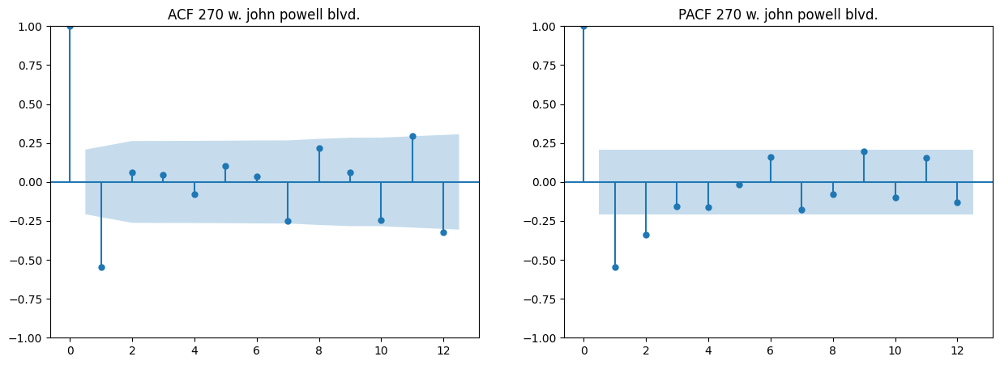

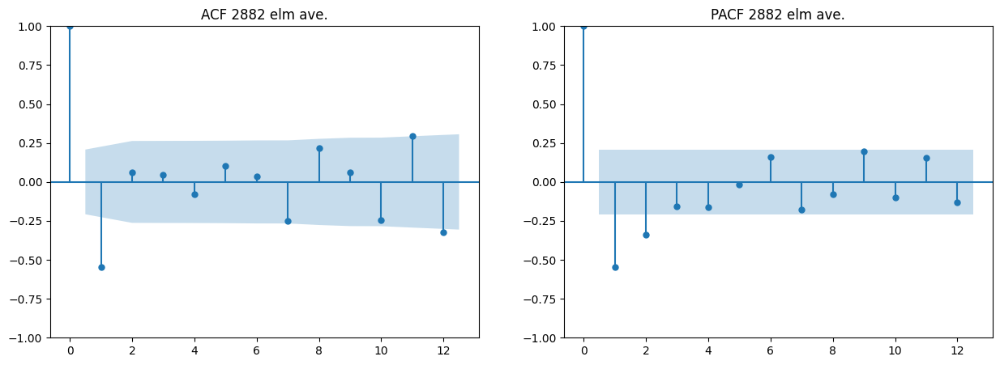

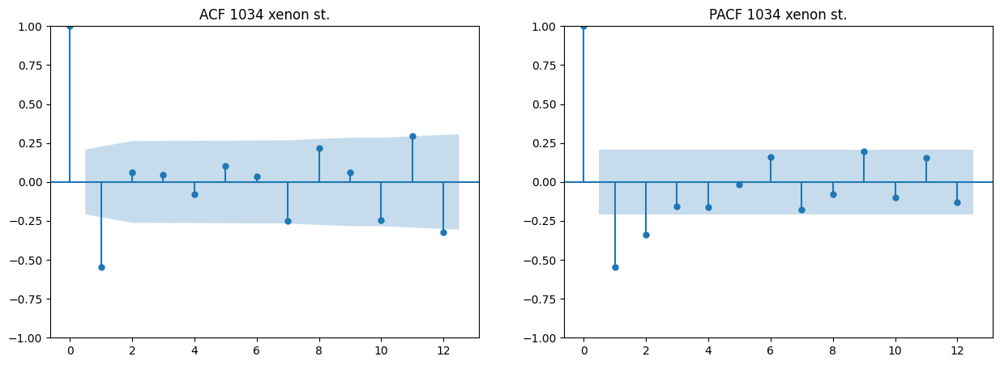

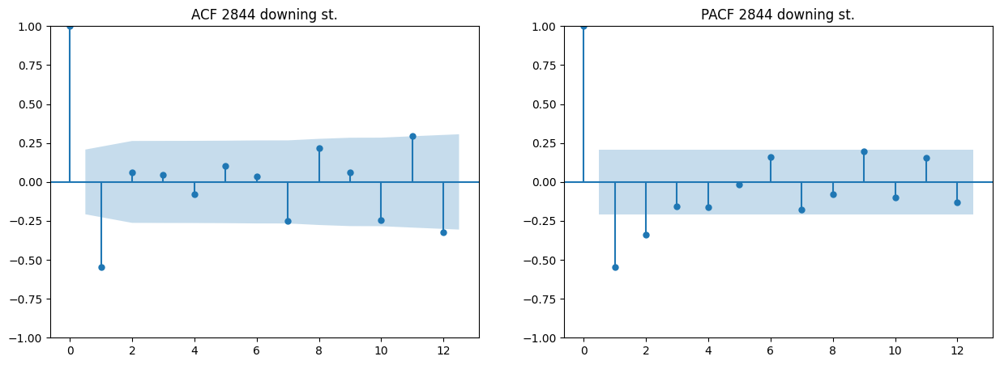

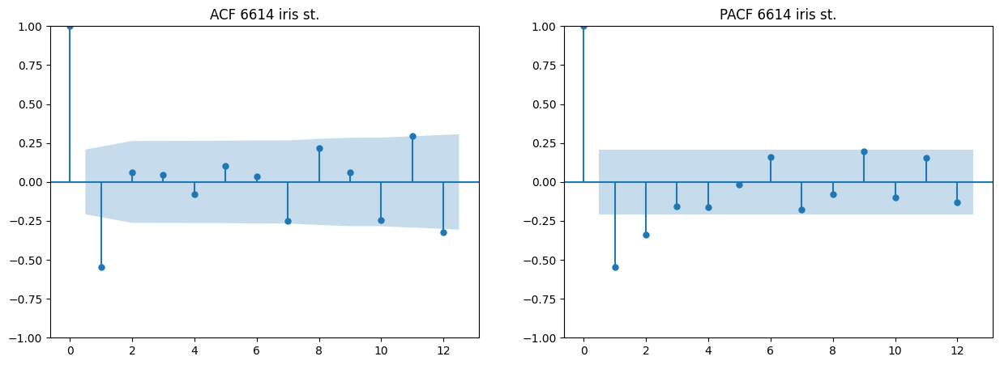

In [ ]:
# Group top 5 lot size buildings for sample plot, ACF/PACF plots by building

top_5 = normalized_chds_with_lot_size.sort_values('Average Cost/SqFt', ascending=False).head(5)

# Seasonal differencing (lag 12)
ts_seasonal_diff = ts_cdhs.diff(12)

# Regular differencing
ts_diff = ts_seasonal_diff.diff().dropna()


for idx, row in top_5.iterrows():
  address = row['Address']
  if ts_diff is not None and len(ts_diff.dropna()) > 12:
      plot_ACF_PACF(ts_diff, address, 12)
  else:
      print(f"Skipping {address}: not enough data ({len(ts_diff)} values)")

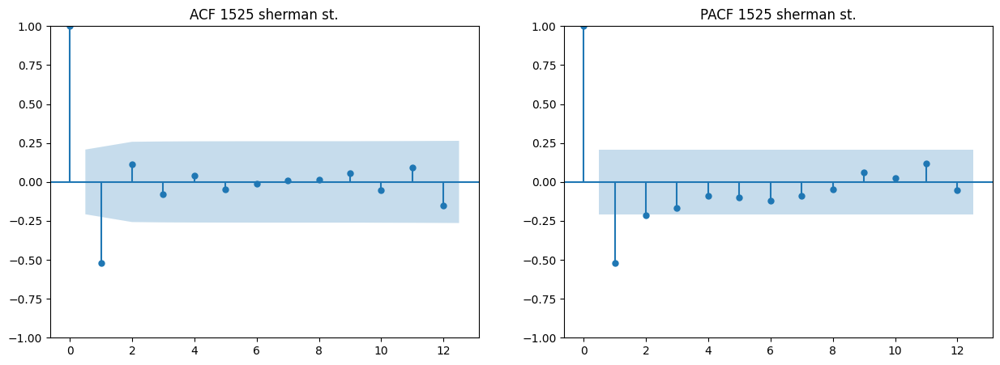

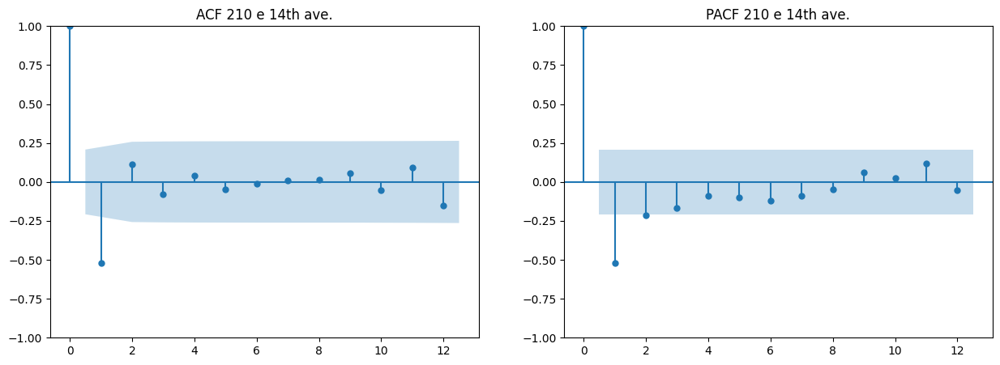

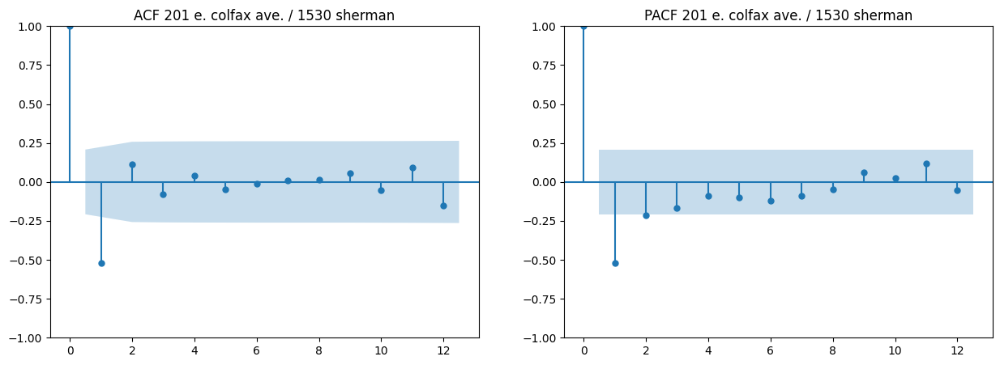

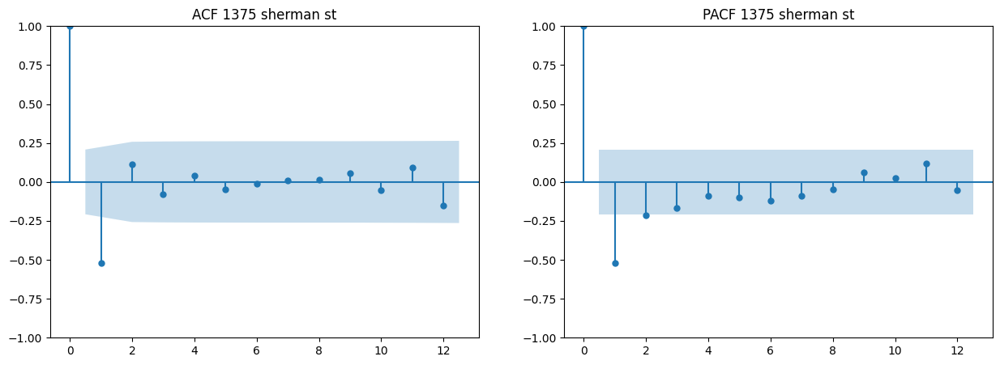

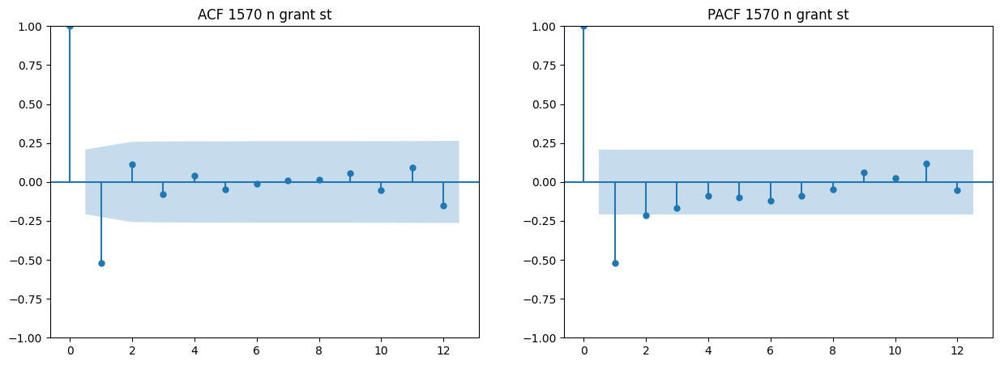

In [ ]:
# ACF/PACF DPA

top_5 = normalized_dpa_with_lot_size.sort_values('Average Cost/SqFt', ascending=False).head(5)

# Seasonal differencing (lag 12)
ts_seasonal_diff = ts_dpa.diff(12)

# Regular differencing
ts_diff = ts_seasonal_diff.diff().dropna()

for idx, row in top_5.iterrows():
    address = row['Address']

    # Make sure ts_diff has enough data

    if ts_diff is not None and len(ts_diff.dropna()) > 12:
        plot_ACF_PACF(ts_diff, address, 12)
    else:
        print(f"Skipping {address}: not enough data ({len(ts_diff)} values)")

#### Highest Cost per Square Foot – SARIMA Forecast (Single Building)


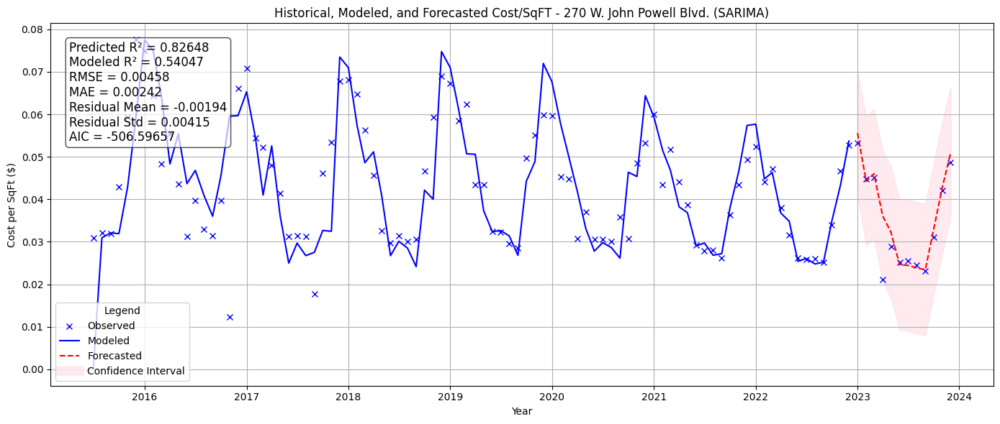

In [ ]:
# Highest Cost/SqFT CDHS (with SARIMA results):

plot_single_building_forecast(
    building_name='270 w. john powell blvd.',
    historical_df=normalized_chds_with_lot_size,
    forecast_df=forecast_df_cdhs,
    modeled_data=modeled_data_cdhs,
    error_metrics=error_metrics_cdhs,
    scaling_factor=1.0,
    custom_title="Historical, Modeled, and Forecasted Cost/SqFT - 270 W. John Powell Blvd. (SARIMA)"
)

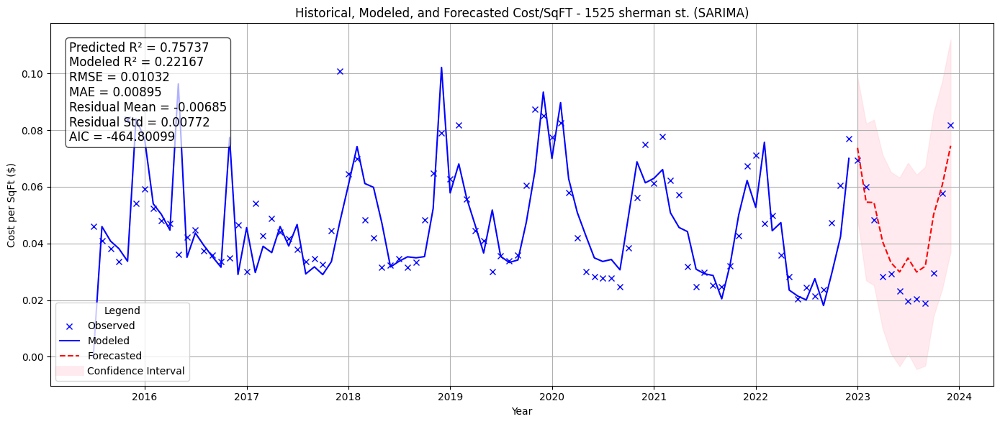

In [ ]:
# Highest Cost/SqFT DPA (with SARIMA results):

building_name = '1525 sherman st.'

# Retrieve metrics for this building from error_df_dpa
building_metrics = next(
    (m for m in error_metrics_dpa if m['Address'].strip().lower() == building_name.strip().lower()),
    None
)
plot_single_building_forecast(
    building_name=building_name,
    historical_df=normalized_dpa_with_lot_size,
    forecast_df=forecast_df_dpa,
    modeled_data=modeled_dpa_data,
    error_metrics=error_metrics_dpa,
    scaling_factor=1.0,
    custom_title="Historical, Modeled, and Forecasted Cost/SqFT - 1525 sherman st. (SARIMA)"
)


#### Top 5 Buildings with Highest Cost/SqFt - SARIMA Forecast by Agency


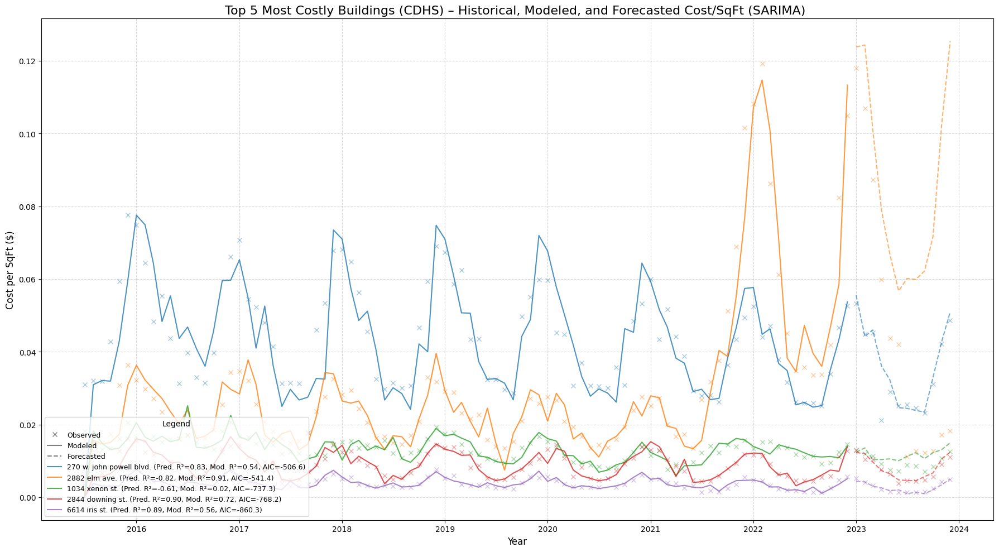

In [ ]:
# For top 5 buildings (with SARIMA results):

top_5 = normalized_chds_with_lot_size.sort_values('Average Cost/SqFt', ascending=False).head(5)

plot_sarima_results(
    buildings_df=top_5,
    forecast_df=forecast_df_cdhs,
    modeled_data=modeled_data_cdhs,
    error_metrics=error_metrics_cdhs,
    title="Top 5 Most Costly Buildings (CDHS) – Historical, Modeled, and Forecasted Cost/SqFt (SARIMA) ",
    scaling_factor=scaling_factor,
    use_log_scale=False
)

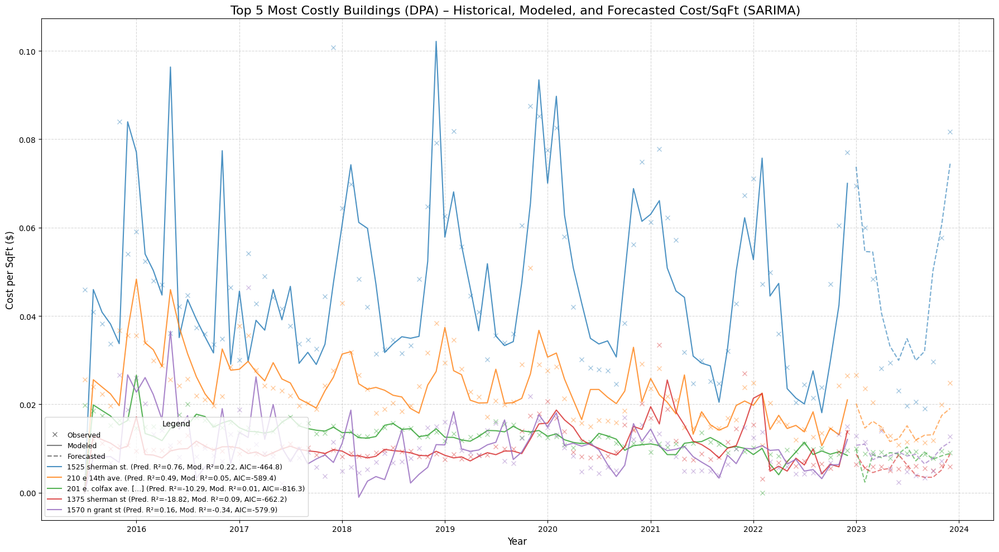

In [ ]:
# For top 5 buildings DPA (with SARIMA results):

top_5 = normalized_dpa_with_lot_size.sort_values('Average Cost/SqFt', ascending=False).head(5)

plot_sarima_results(
    buildings_df=top_5,
    forecast_df=forecast_df_dpa,
    modeled_data=modeled_dpa_data,
    error_metrics=error_metrics_dpa,
    title="Top 5 Most Costly Buildings (DPA) – Historical, Modeled, and Forecasted Cost/SqFt (SARIMA) ",
    scaling_factor=scaling_factor,
    use_log_scale=False
)

#### All Buildings (SARIMA Forecast)

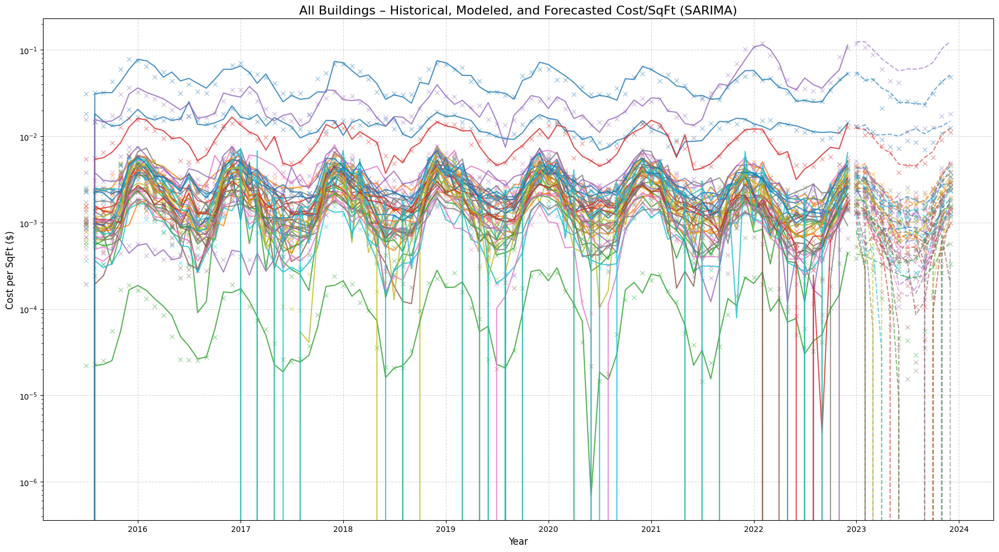

In [ ]:
#For All CDHS Buildings (with SARIMA results)

plot_sarima_results(
    normalized_chds_with_lot_size,
    forecast_df=forecast_df_cdhs,
    modeled_data=modeled_data_cdhs,
    error_metrics=error_metrics_cdhs,
    title= "All Buildings – Historical, Modeled, and Forecasted Cost/SqFt (SARIMA)",
    scaling_factor=1.0,
    use_log_scale=True,
    include_legend=False,
    include_ci=False,
    ci_alpha=0.2, max_label_width=25)

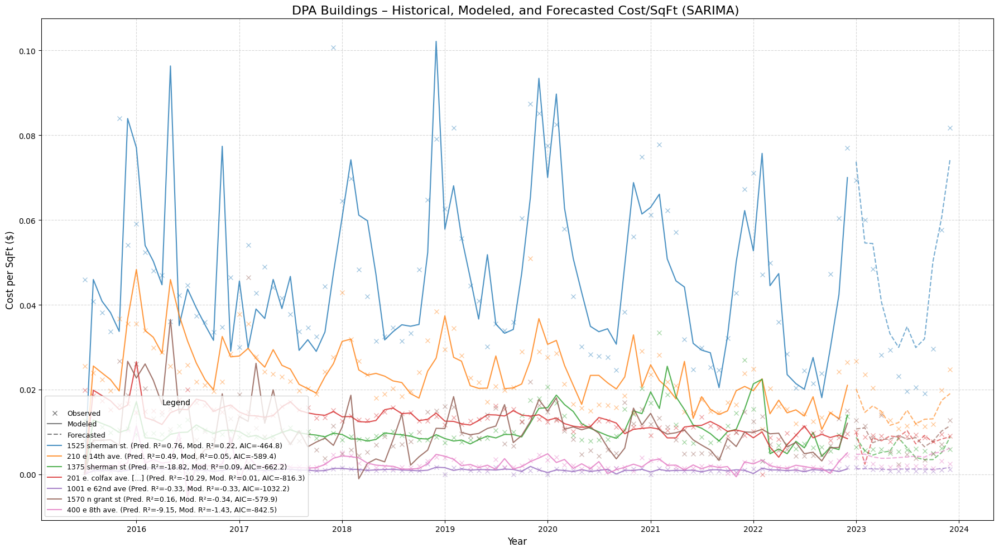

In [ ]:
# For All buildings DPA(with SARIMA results):

plot_sarima_results(
    buildings_df=normalized_dpa_with_lot_size,
    forecast_df=forecast_df_dpa,
    modeled_data=modeled_dpa_data,
    error_metrics=error_metrics_dpa,
    title="DPA Buildings – Historical, Modeled, and Forecasted Cost/SqFt (SARIMA) ",
    scaling_factor=scaling_factor,
    use_log_scale=False)

#### SARIMA Forecast– Grouped by $R^2$ scores Model Accuracy

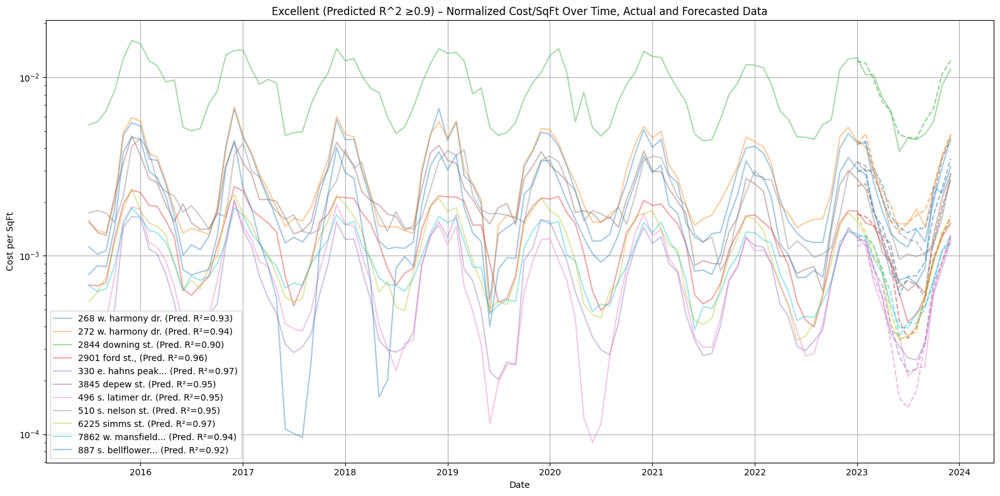

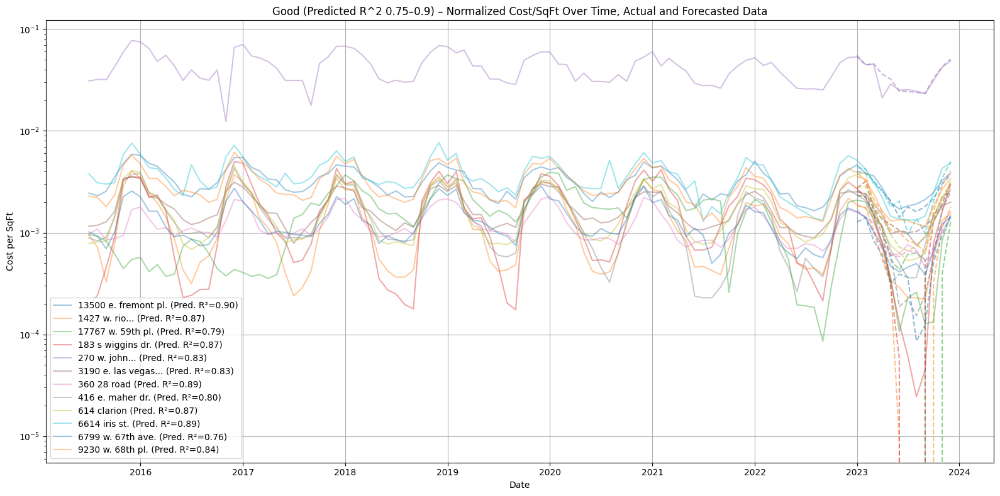

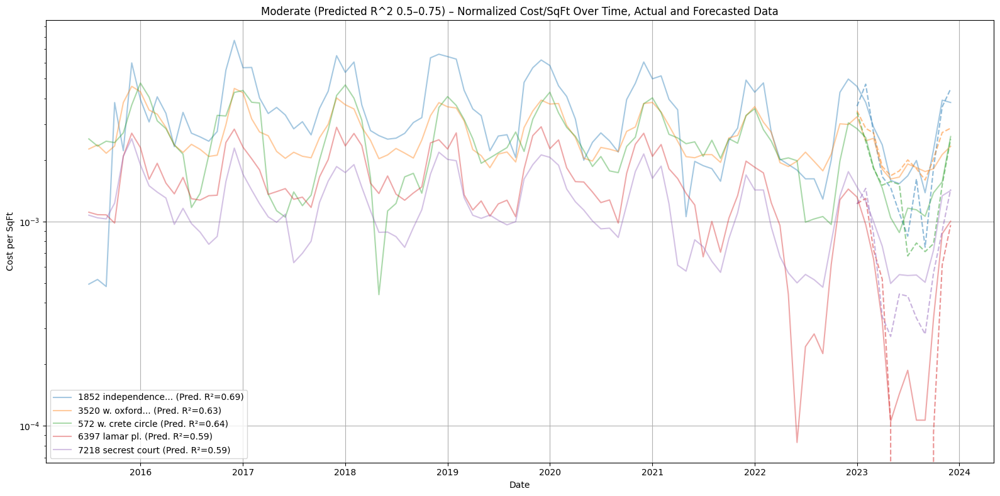

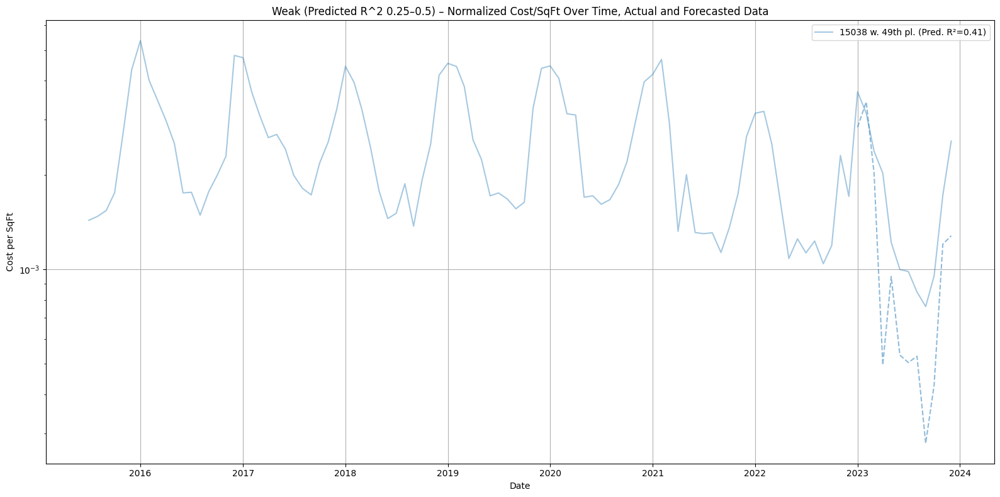

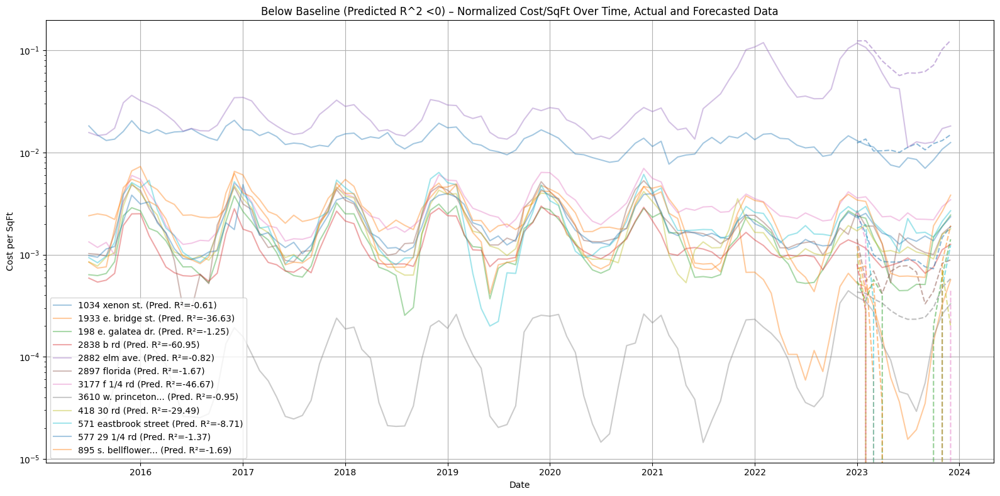

In [ ]:
# Plotting buildings on R^2

# Normalize address fields
normalized_chds_with_lot_size['Address'] = normalized_chds_with_lot_size['Address'].str.strip().str.lower()
error_df_cdhs['Address'] = error_df_cdhs['Address'].str.strip().str.lower()

if 'forecast_df' in locals():
    forecast_df_cdhs['Address'] = forecast_df_cdhs['Address'].str.strip().str.lower()
    forecast_df_cdhs['Date'] = pd.to_datetime(forecast_df_cdhs['Date'])  # Ensure Date column is datetime

# R^2 categories
excellent, good, moderate, weak, very_weak, below_baseline = [], [], [], [], [], []

for idx, row in normalized_chds_with_lot_size.iterrows():
    address = row['Address']
    building_metrics = error_df_cdhs[error_df_cdhs['Address'] == address]

    if building_metrics.empty:
        print(f"Skipping row {idx}: address '{address}' not found in error_df")
        continue

    predicted_r2 = building_metrics['Predicted R²'].iloc[0]

    # Grouping
    if predicted_r2 >= 0.9:
        excellent.append(row)
    elif predicted_r2 >= 0.75:
        good.append(row)
    elif predicted_r2 >= 0.5:
        moderate.append(row)
    elif predicted_r2 >= 0.25:
        weak.append(row)
    elif predicted_r2 >= 0:
        very_weak.append(row)
    else:
        below_baseline.append(row)

categories = {
    'Excellent (Predicted R^2 ≥0.9)': excellent,
    'Good (Predicted R^2 0.75–0.9)': good,
    'Moderate (Predicted R^2 0.5–0.75)': moderate,
    'Weak (Predicted R^2 0.25–0.5)': weak,
    'Very Weak (Predicted R^2 0–0.25)': very_weak,
    'Below Baseline (Predicted R^2 <0)': below_baseline
}

for category_name, buildings in categories.items():
    if len(buildings) == 0:
        continue

    plt.figure(figsize=(16, 8))

    for row in buildings:
        address = row['Address']
        predicted_r2 = error_df_cdhs[error_df_cdhs['Address'] == address]['Predicted R²'].iloc[0]

        label = f"{textwrap.shorten(address, width=20, placeholder='...')} (Pred. R²={predicted_r2:.2f})"

        y = row.drop([
            'Address',
            'Lot Size (Final SqFt)',
            'Average Cost/SqFt',
            'Cost Growth Rate (slope)',
            'R² Score'
        ], errors='ignore')

        try:
            y.index = pd.to_datetime(y.index)
            line, = plt.plot(y.index, pd.to_numeric(y.values, errors='coerce'), alpha=0.4, label=label)

            line_color = line.get_color()


        except Exception as e:
            print(f"Skipping {address} due to error: {e}")

        # Plot forecast if available
        if 'forecast_df_cdhs' in locals() and not forecast_df_cdhs.empty:
            building_forecast = forecast_df_cdhs[forecast_df_cdhs['Address'] == address]
            if not building_forecast.empty:
                try:
                    plt.plot(
                        building_forecast['Date'],
                        building_forecast['Forecasted Cost/SqFt'] / scaling_factor,
                        linestyle='--',
                        alpha=0.5,
                        color=line_color
                    )

                except Exception as e:
                    print(f"Skipping forecast for {address} due to error: {e}")

    plt.title(f'{category_name} – Normalized Cost/SqFt Over Time, Actual and Forecasted Data')
    plt.xlabel('Date')
    plt.ylabel('Cost per SqFt')
    plt.yscale('log')
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

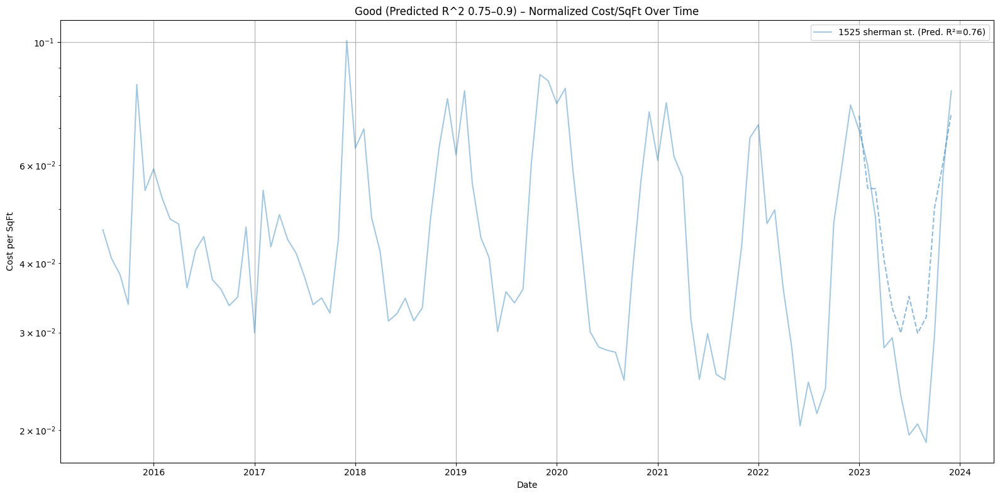

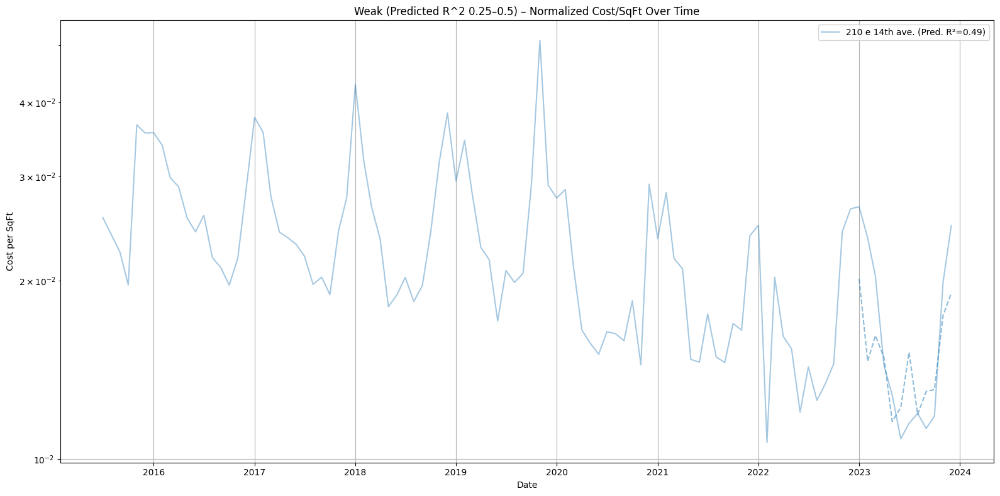

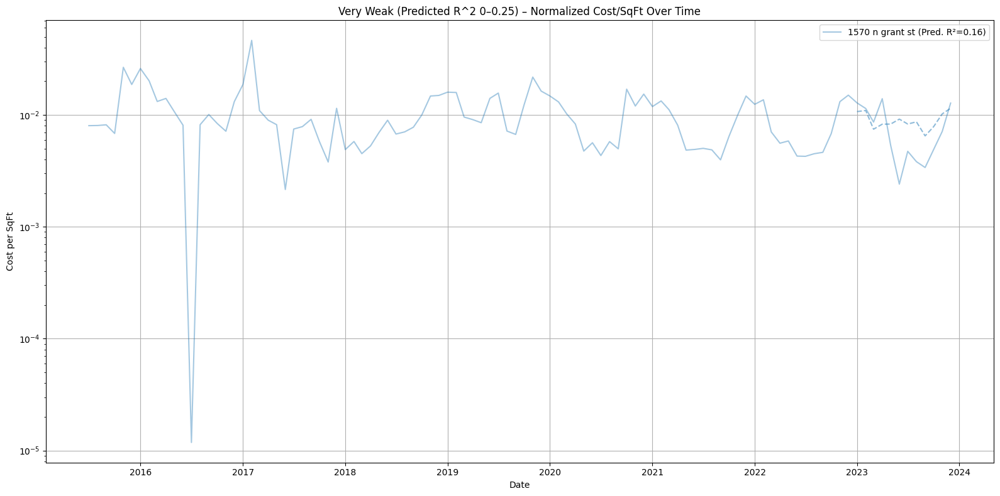

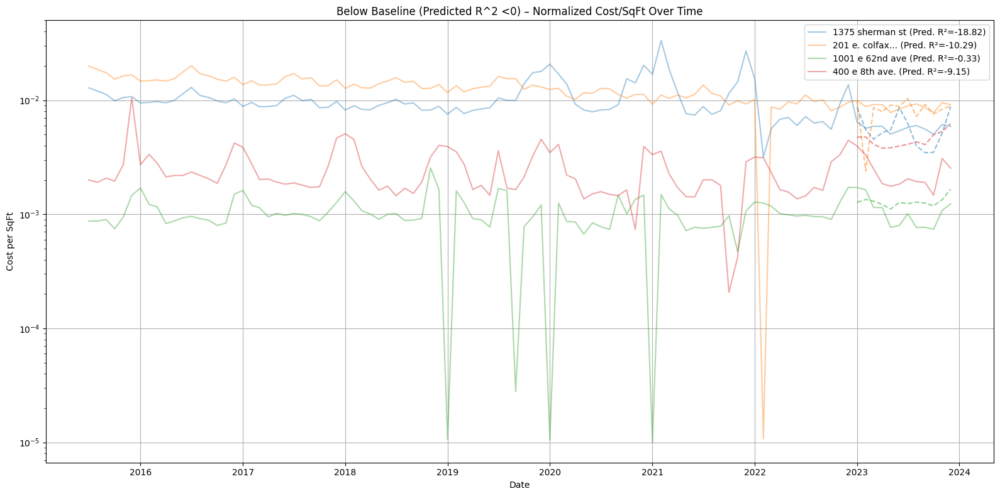

In [ ]:
# Plotting buildings on R^2 DPA

# Normalize address fields
normalized_dpa_with_lot_size['Address'] = normalized_dpa_with_lot_size['Address'].str.strip().str.lower()
error_df_dpa['Address'] = error_df_dpa['Address'].str.strip().str.lower()

if 'forecast_df' in locals():
    forecast_df_dpa['Address'] = forecast_df_dpa['Address'].str.strip().str.lower()
    forecast_df_dpa['Date'] = pd.to_datetime(forecast_df_dpa['Date'])  # Ensure Date column is datetime

# R^2 categories
excellent, good, moderate, weak, very_weak, below_baseline = [], [], [], [], [], []

for idx, row in normalized_dpa_with_lot_size.iterrows():
    address = row['Address']
    building_metrics = error_df_dpa[error_df_dpa['Address'] == address]

    if building_metrics.empty:
        print(f"Skipping row {idx}: address '{address}' not found in error_df")
        continue

    r2 = building_metrics['Predicted R²'].iloc[0]

    # Grouping
    if r2 >= 0.9:
        excellent.append(row)
    elif r2 >= 0.75:
        good.append(row)
    elif r2 >= 0.5:
        moderate.append(row)
    elif r2 >= 0.25:
        weak.append(row)
    elif r2 >= 0:
        very_weak.append(row)
    else:
        below_baseline.append(row)

categories = {
    'Excellent (Predicted R^2 ≥0.9)': excellent,
    'Good (Predicted R^2 0.75–0.9)': good,
    'Moderate (Predicted R^2 0.5–0.75)': moderate,
    'Weak (Predicted R^2 0.25–0.5)': weak,
    'Very Weak (Predicted R^2 0–0.25)': very_weak,
    'Below Baseline (Predicted R^2 <0)': below_baseline
}

for category_name, buildings in categories.items():
    if len(buildings) == 0:
        continue

    plt.figure(figsize=(16, 8))

    for row in buildings:
        address = row['Address']
        predicted_r2 = error_df_dpa[error_df_dpa['Address'] == address]['Predicted R²'].iloc[0]
        label = f"{textwrap.shorten(address, width=20, placeholder='...')} (Pred. R²={predicted_r2:.2f})"

        y = row.drop([
            'Address',
            'Lot Size (Final SqFt)',
            'Average Cost/SqFt',
            'Cost Growth Rate (slope)',
            'R² Score'
        ], errors='ignore')

        try:
            y.index = pd.to_datetime(y.index)
            line, = plt.plot(y.index, pd.to_numeric(y.values, errors='coerce'), alpha=0.4, label=label)

            line_color = line.get_color()
        except Exception as e:
            print(f"Skipping {address} due to error: {e}")

        # Plot forecast if available
        if 'forecast_df_dpa' in locals() and not forecast_df_dpa.empty:
            building_forecast = forecast_df_dpa[forecast_df_dpa['Address'] == address]
            if not building_forecast.empty:
                try:
                    plt.plot(
                        building_forecast['Date'],
                        building_forecast['Forecasted Cost/SqFt'] / scaling_factor,
                        linestyle='--',
                        alpha=0.5,
                        color=line_color
                    )
                except Exception as e:
                    print(f"Skipping forecast for {address} due to error: {e}")

    plt.title(f'{category_name} – Normalized Cost/SqFt Over Time')
    plt.xlabel('Date')
    plt.ylabel('Cost per SqFt')
    plt.yscale('log')
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

#### Actual, Forecasted, and Modeled Time Series Data


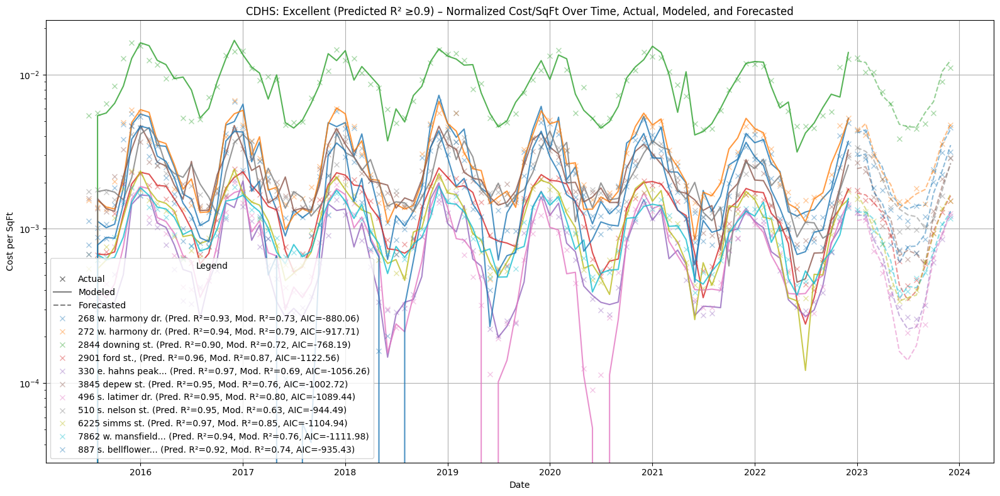

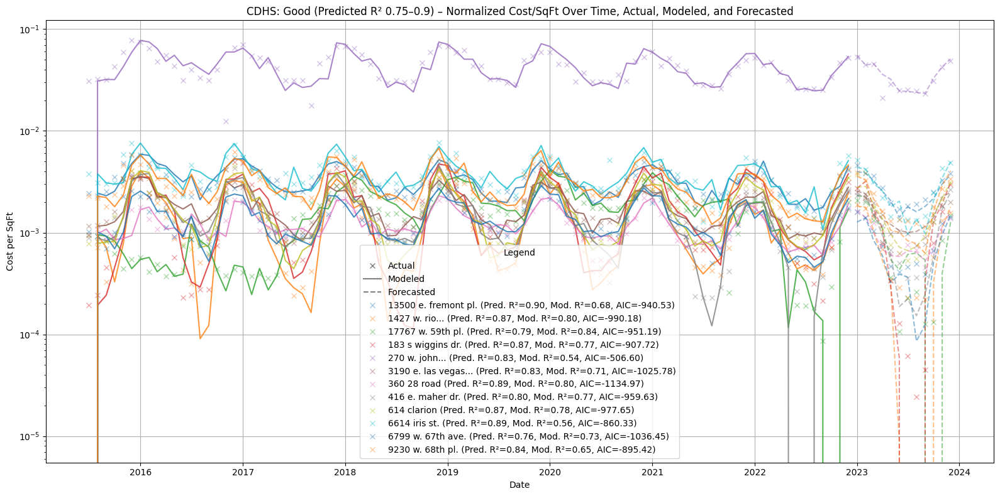

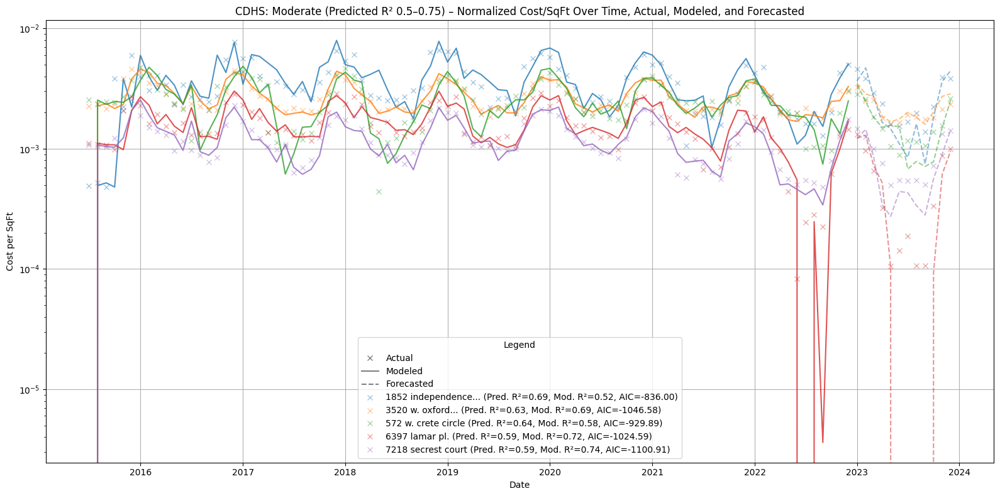

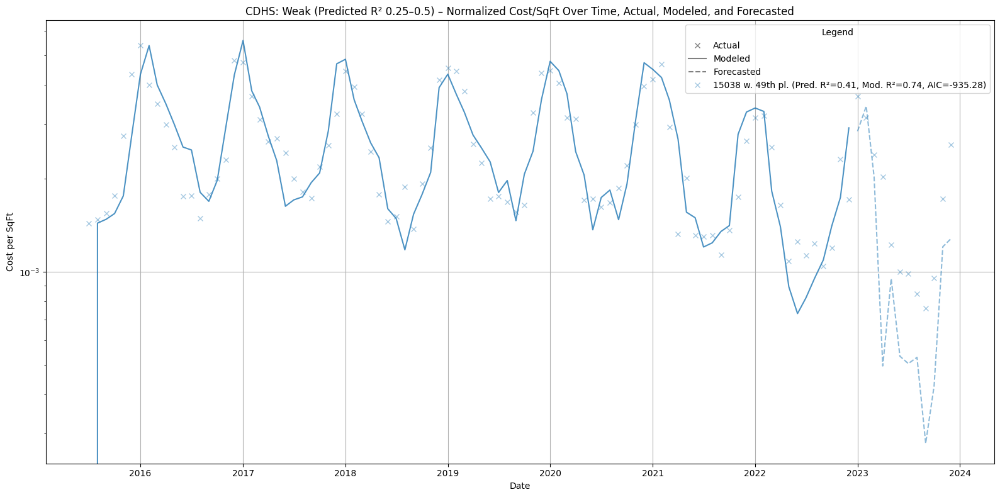

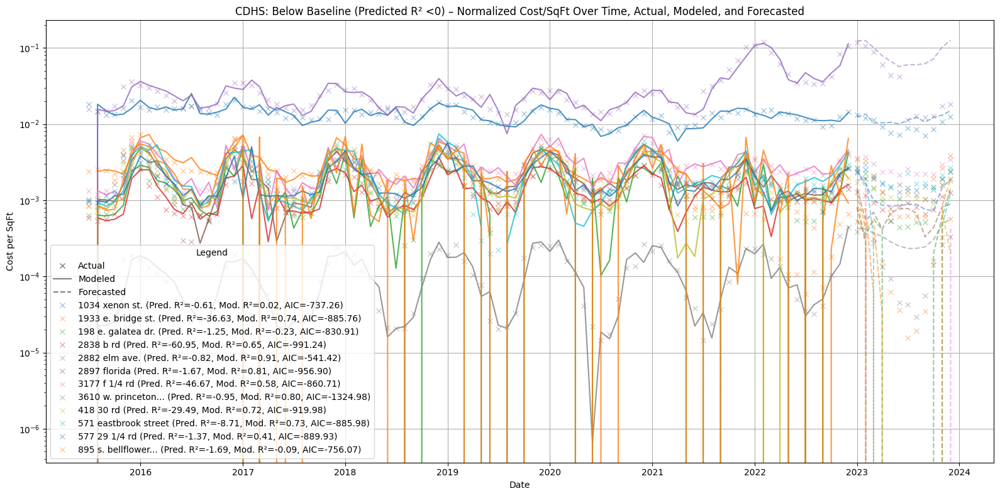

In [ ]:
cdhs_categories = group_buildings_by_r2(normalized_chds_with_lot_size.copy(), error_df_cdhs.copy())

plot_grouped_sarima_results(
    categories=cdhs_categories,
    error_df=error_df_cdhs,
    forecast_df=forecast_df_cdhs,
    modeled_data=modeled_data_cdhs,
    scaling_factor=1.0,
    title_prefix="CDHS: "
)

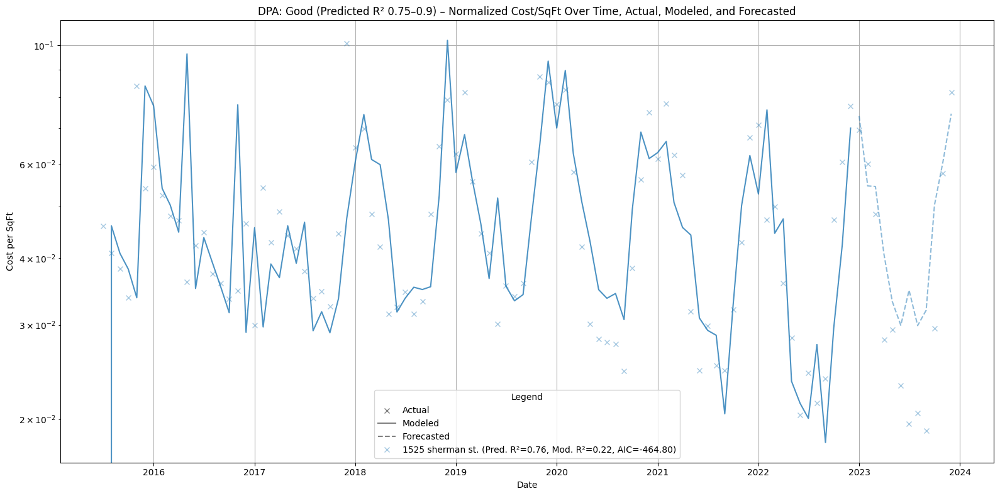

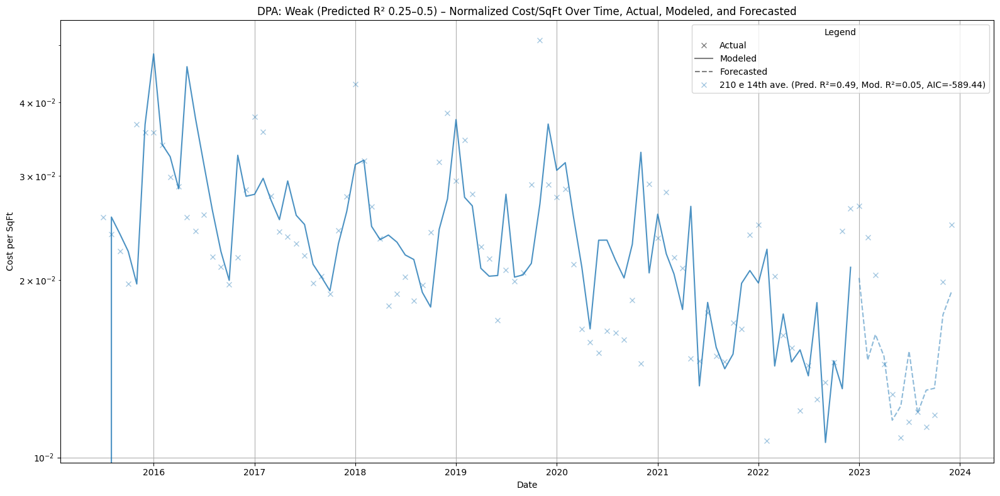

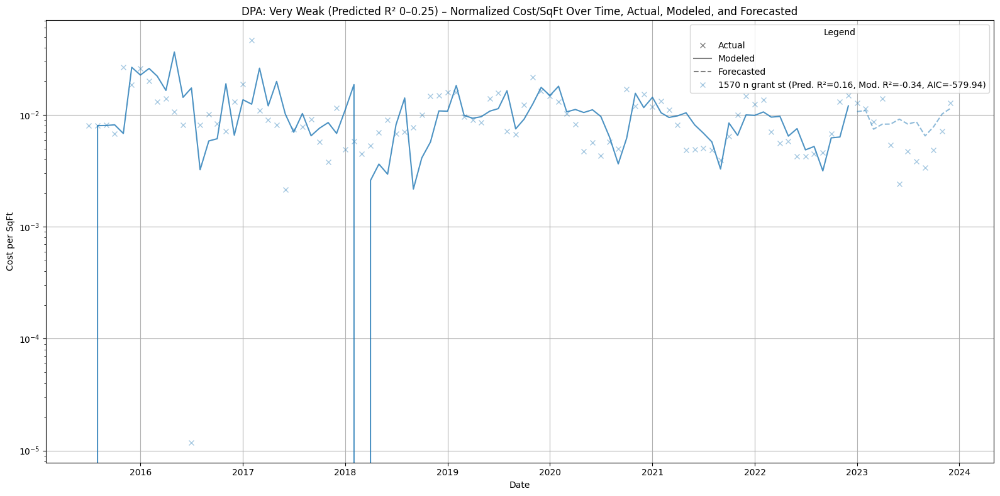

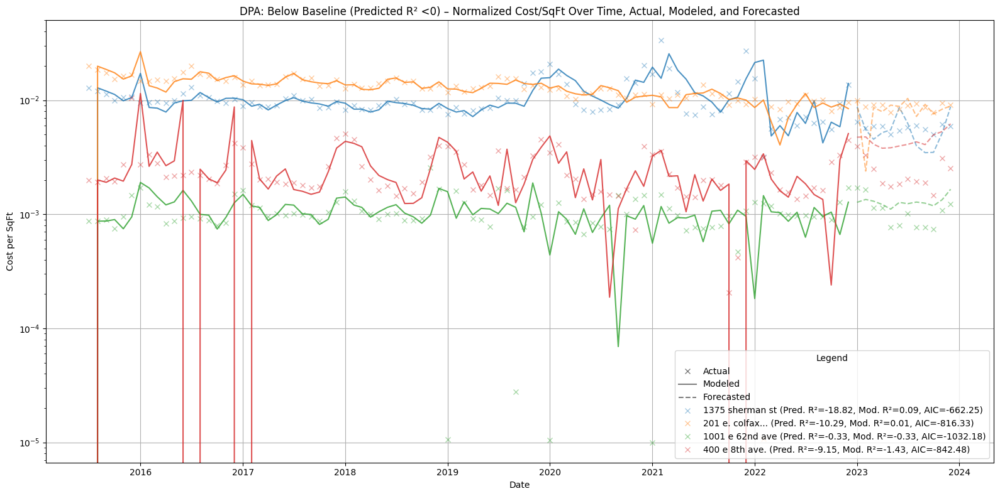

In [ ]:
# Group DPA buildings by Predicted R²

dpa_categories = group_buildings_by_r2(normalized_dpa_with_lot_size.copy(), error_df_dpa.copy())

# Plot using general plotter
plot_grouped_sarima_results(
    categories=dpa_categories,
    error_df=error_df_dpa,
    forecast_df=forecast_df_dpa,
    modeled_data=modeled_dpa_data,
    scaling_factor=1.0,
    title_prefix="DPA: "
)

In [ ]:
# Display property info of each address in each category

property_info_df.index = property_info_df.index.str.lower()

for category_name, buildings in categories.items():
    print(f'\n Category: {category_name}')
    for row in buildings:
        building = row['Address']
        lowercase_building = building.lower()
        if lowercase_building in property_info_df.index:
            print(f'Address: {building}, {property_info_df.loc[lowercase_building]}')
        else:
            print(f'Address: {building} not found in property_info_df')


 Category: Excellent (Predicted R^2 ≥0.9)

 Category: Good (Predicted R^2 0.75–0.9)
Address: 1525 sherman st., 1
Agency/Department/Institution                                    DPA
Parcel ID or Schedule Number                        02349-39-009-000
Title Holder                                       STATE OF COLORADO
County                                                        Denver
City                                                          Denver
Lot Size (sq. ft.)                                             28183
Lot Size (Acres)                                                 NaN
Description                      Personnel & Administration Building
Predominant Characteriscts                      Office type contents
Name: 1525 sherman st., dtype: object

 Category: Moderate (Predicted R^2 0.5–0.75)

 Category: Weak (Predicted R^2 0.25–0.5)
Address: 210 e 14th ave., 1
Agency/Department/Institution                                DPA
Parcel ID or Schedule Number                  

In [ ]:
# Display property info of each address in each category

for category_name, buildings in categories.items():
    print(f'\n Category: {category_name}')
    for row in buildings:
        building = row['Address']
        lowercase_building = building.lower()
        if lowercase_building in property_info_df.index:
            print(f'Address: {building}, {property_info_df.loc[lowercase_building]}')
        else:
            print(f'Address: {building} not found in property_info_df')


 Category: Excellent (Predicted R^2 ≥0.9)

 Category: Good (Predicted R^2 0.75–0.9)
Address: 1525 sherman st., 1
Agency/Department/Institution                                    DPA
Parcel ID or Schedule Number                        02349-39-009-000
Title Holder                                       STATE OF COLORADO
County                                                        Denver
City                                                          Denver
Lot Size (sq. ft.)                                             28183
Lot Size (Acres)                                                 NaN
Description                      Personnel & Administration Building
Predominant Characteriscts                      Office type contents
Name: 1525 sherman st., dtype: object

 Category: Moderate (Predicted R^2 0.5–0.75)

 Category: Weak (Predicted R^2 0.25–0.5)
Address: 210 e 14th ave., 1
Agency/Department/Institution                                DPA
Parcel ID or Schedule Number                  

### SARIMAX with Weather


In [ ]:
# Use normalized (by lot size) cdhs df from above and generate normalized weather with timedate

non_date_columns = ['City']

# Separate out the non-date columns and numeric columns
non_date_df = weather_df[non_date_columns]
numeric_df = weather_df.drop(columns=non_date_columns)

# Normalize only the numeric columns
numeric_df = (numeric_df - numeric_df.min()) / (numeric_df.max() - numeric_df.min())
numeric_df.columns = [
    pd.to_datetime(col)
    for col in numeric_df.columns
]

# Recombine the non-date columns with the normalized numeric data
normalized_weather_data = pd.concat([non_date_df, numeric_df], axis=1)

# Extract only datetime columns for SARIMA modeling
time_columns = [col for col in normalized_chds_with_lot_size.columns if col not in non_date_columns]



#display(normalized_weather_data)

In [ ]:
forecast_df_cdhs, failed_buildings_cdhs, ts_cdhs, error_metrics_cdhs, modeled_data_cdhs = backtest_sarima_weather(normalized_chds_with_lot_size, normalized_weather_data, (1, 1, 2), (1, 1, 2, 12) )

error_df_cdhs = pd.DataFrame(error_metrics_cdhs)

weather_error_cdhs_df = error_df_cdhs.copy()

OUT OF LOOP *****************************************************************


,Address,Date,Actual Cost/SqFt,Forecasted Cost/SqFt,Lower CI,Upper CI
0,1034 xenon st.,2023-01-01,0.013079,0.011984,0.008576,0.015391
1,1034 xenon st.,2023-02-01,0.011923,0.013457,0.008888,0.018027
2,1034 xenon st.,2023-03-01,0.011311,0.010943,0.005686,0.016200
3,1034 xenon st.,2023-04-01,0.009195,0.010849,0.004871,0.016827
4,1034 xenon st.,2023-05-01,0.007552,0.010953,0.004389,0.017516
...,...,...,...,...,...,...
463,9230 w. 68th pl.,2023-08-01,0.001221,0.001642,0.000191,0.003093
464,9230 w. 68th pl.,2023-09-01,0.001153,0.001622,0.000104,0.003141
465,9230 w. 68th pl.,2023-10-01,0.001808,0.002426,0.000843,0.004009
466,9230 w. 68th pl.,2023-11-01,0.002694,0.004077,0.002431,0.005722


,Address,RMSE,MAE,Predicted R²,Modeled R²,Residual Mean,Residual Std,AIC
0,1034 xenon st.,0.002569,0.002358,-0.583243,0.009675,-0.002114,0.001460,-739.801034
1,1427 w. rio grande st.,0.000253,0.000209,0.838131,0.823187,-0.000199,0.000156,-1022.632455
2,15038 w. 49th pl.,0.001655,0.001607,-2.070730,0.709018,0.001607,0.000398,-922.951071
3,17767 w. 59th pl.,0.000346,0.000282,0.761946,0.823494,-0.000282,0.000200,-947.618529
4,183 s wiggins dr.,0.000334,0.000271,0.895335,0.759861,-0.000137,0.000304,-911.296298
5,1852 independence st.,0.000606,0.000455,0.680339,0.582957,-0.000439,0.000418,-850.682168
6,1933 e. bridge st.,0.001155,0.001025,-31.728570,0.737552,0.000949,0.000659,-894.941193
7,198 e. galatea dr.,0.000265,0.000239,0.883041,0.781849,-0.000072,0.000256,-998.926889
8,268 w. harmony dr.,0.000254,0.000198,0.960665,0.800971,0.000052,0.000248,-914.369097
9,270 w. john powell blvd.,0.004605,0.002751,0.824737,0.507938,-0.002007,0.004144,-507.169222


Backtesting complete.
Buildings failed to forecast: 2


[('13500 e. fremont pl.', 'Address not found in property_info_df.'),
 ('2901 ford st.,', 'Address not found in property_info_df.')]

In [ ]:
# Use normalized (by lot size) cdhs df from above and generate normalized weather with timedate

non_date_columns = ['City']

# Separate out the non-date columns and numeric columns
non_date_df = weather_df[non_date_columns]
numeric_df = weather_df.drop(columns=non_date_columns)

# Normalize only the numeric columns
numeric_df = (numeric_df - numeric_df.min()) / (numeric_df.max() - numeric_df.min())
numeric_df.columns = [
    pd.to_datetime(col)
    for col in numeric_df.columns
]

# Recombine the non-date columns with the normalized numeric data
normalized_weather_data = pd.concat([non_date_df, numeric_df], axis=1)

# Extract only datetime columns for SARIMA modeling
time_columns = [col for col in normalized_dpa_with_lot_size.columns if col not in non_date_columns]

###display(normalized_weather_data)

In [ ]:
forecast_df_dpa, failed_buildings_dpa, ts_dpa, error_metrics_dpa, modeled_data_dpa = backtest_sarima_weather(normalized_dpa_with_lot_size, normalized_weather_data, (1, 1, 2), (1, 1, 2, 12) )

error_df_dpa = pd.DataFrame(error_metrics_dpa)

weather_error_dpa_df = error_df_dpa.copy()

OUT OF LOOP *****************************************************************


,Address,Date,Actual Cost/SqFt,Forecasted Cost/SqFt,Lower CI,Upper CI
0,1001 e 62nd ave,2023-01-01,0.001715,0.001034,0.000174,0.001893
1,1001 e 62nd ave,2023-02-01,0.001636,0.001321,0.000426,0.002215
2,1001 e 62nd ave,2023-03-01,0.001145,0.001327,0.000431,0.002222
3,1001 e 62nd ave,2023-04-01,0.001143,0.001097,0.000192,0.002002
4,1001 e 62nd ave,2023-05-01,0.000767,0.000846,-0.000064,0.001755
...,...,...,...,...,...,...
79,400 e 8th ave.,2023-08-01,0.001936,0.002910,-0.002171,0.007991
80,400 e 8th ave.,2023-09-01,0.001896,0.004131,-0.001477,0.009740
81,400 e 8th ave.,2023-10-01,0.001468,0.001794,-0.003823,0.007412
82,400 e 8th ave.,2023-11-01,0.003083,0.003655,-0.002422,0.009732


,Address,RMSE,MAE,Predicted R²,Modeled R²,Residual Mean,Residual Std,AIC
0,1525 sherman st.,0.010238,0.008893,0.761124,0.322456,-0.008249,0.006064,-441.966875
1,210 e 14th ave.,0.002099,0.001498,0.865959,0.170677,-0.000064,0.002098,-567.843059
2,1375 sherman st,0.005076,0.003956,-158.128836,0.220225,-0.000405,0.005060,-609.551855
3,201 e. colfax ave. / 1530 sherman,0.002295,0.001456,-12.565280,0.171093,0.000895,0.002113,-767.807273
4,1001 e 62nd ave,0.000325,0.000281,-0.019685,-0.592492,-0.000108,0.000306,-952.119775
5,1570 n grant st,0.002819,0.001866,0.498641,-0.206581,-0.000224,0.002810,-548.794698
6,400 e 8th ave.,0.001599,0.001389,-3.932963,-0.996046,-0.001389,0.000792,-771.356963


Backtesting complete.
Buildings failed to forecast: 0


[]

####ACF and PACF Plots - (SARIMAX)

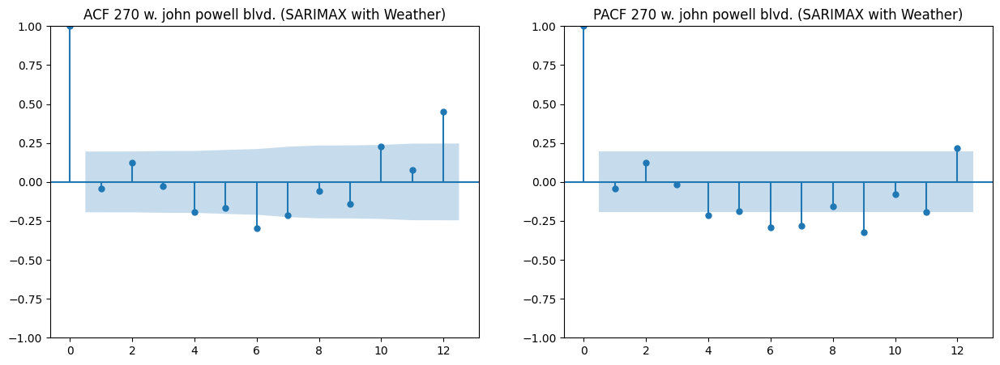

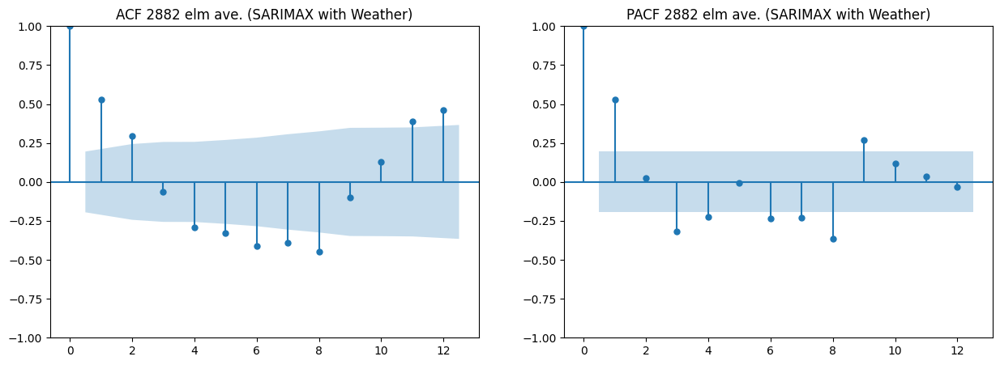

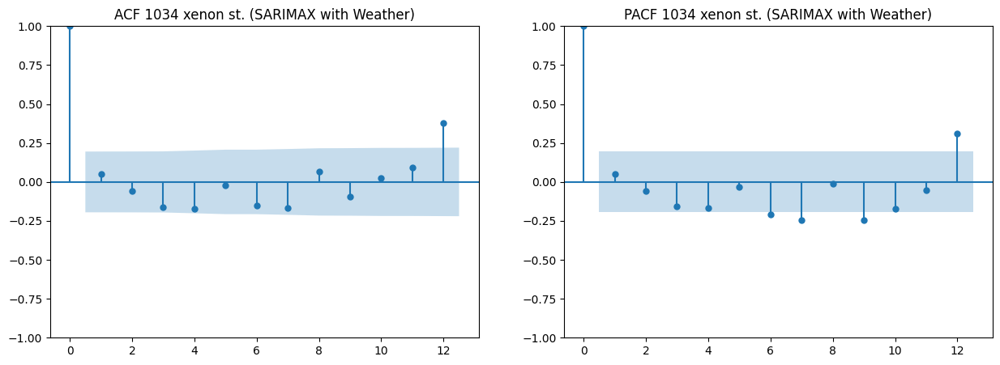

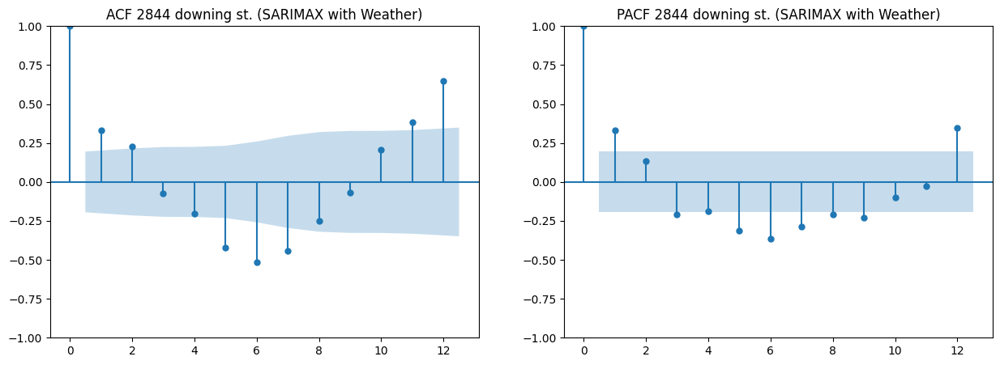

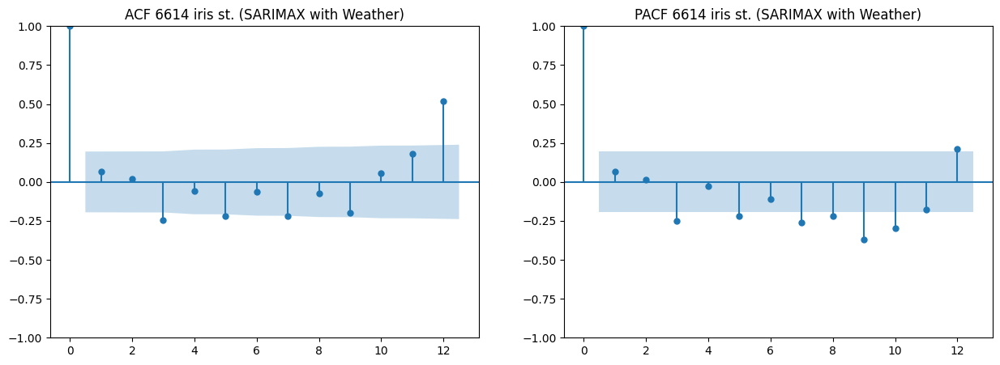

In [ ]:
# Get top 5 buildings by average cost/sqft CDHS

top_5 = normalized_chds_with_lot_size.sort_values('Average Cost/SqFt', ascending=False).head(5)

# Drop static metadata to get date columns
non_date_cols = ['Address', 'Lot Size (Final SqFt)', 'Average Cost/SqFt', 'Cost Growth Rate (slope)', 'R² Score', 'City']
date_columns = [col for col in normalized_chds_with_lot_size.columns if col not in non_date_cols]

# Loop through top 5 buildings and plot ACF/PACF on differenced time series
for idx, row in top_5.iterrows():
    address = row['Address']

    # Extract time series for this building
    ts = row[date_columns].astype(float)
    ts.index = pd.to_datetime(date_columns)
    ts = ts.sort_index()

    # Make stationary by differencing
    ts_diff = ts.diff().dropna()

    # Plot ACF/PACF
    plot_ACF_PACF(ts_diff, f"{address} (SARIMAX with Weather)", 12)

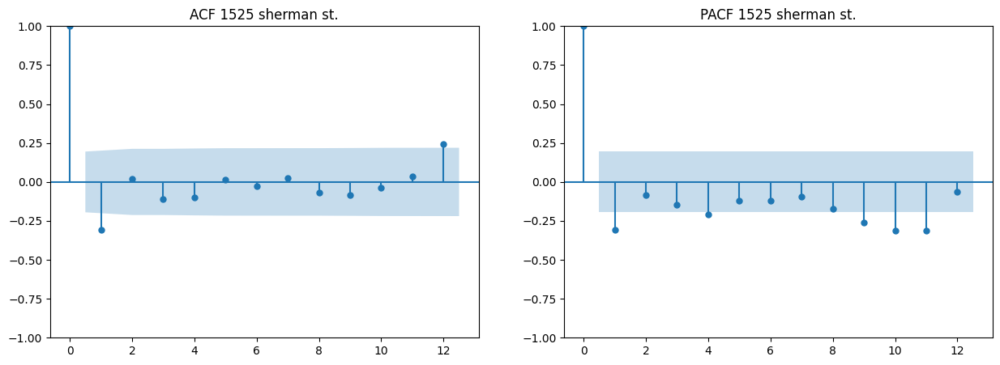

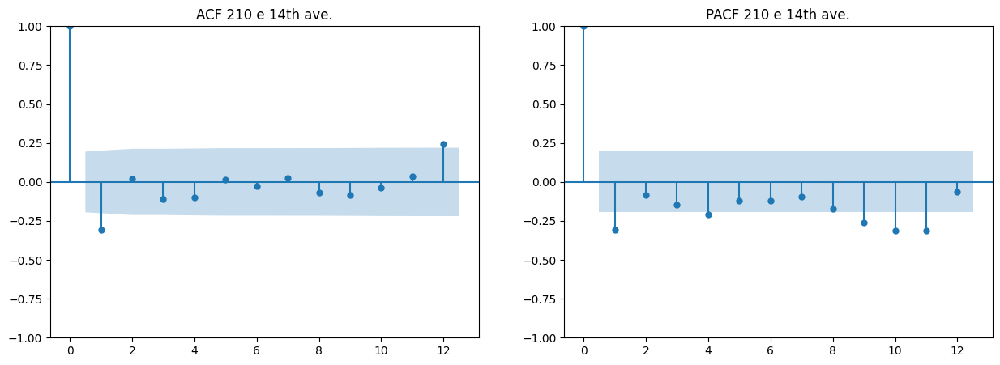

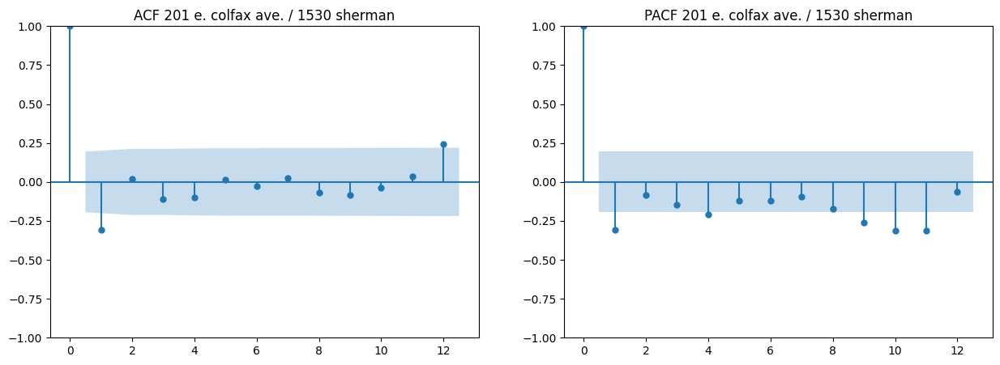

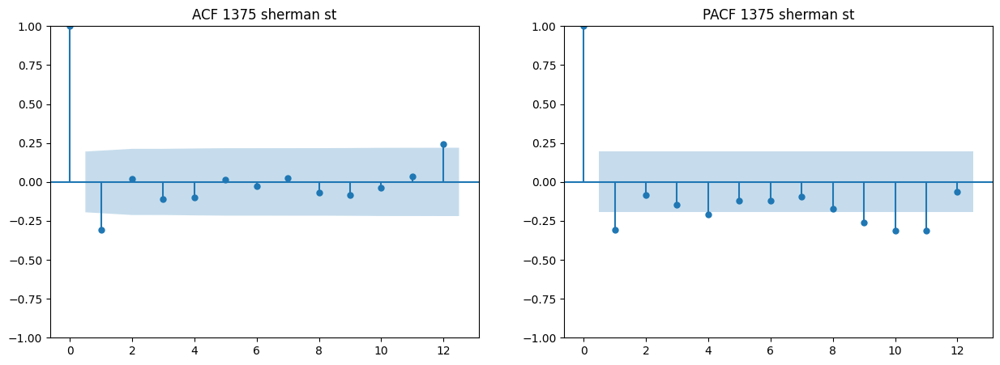

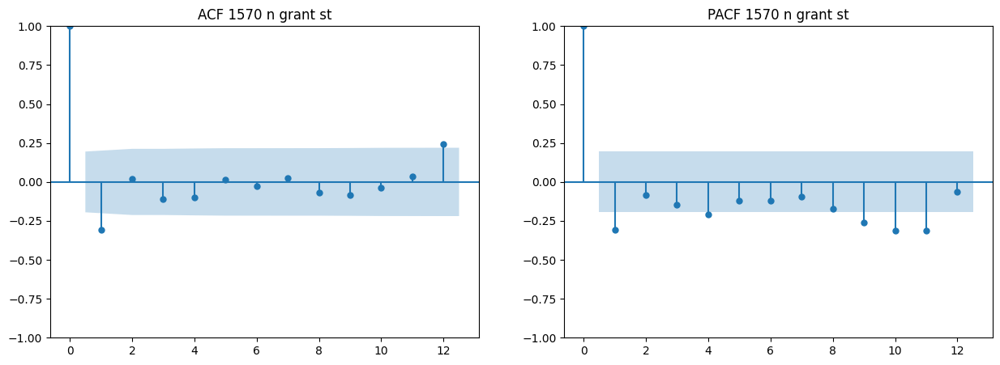

In [ ]:
# Get top 5 buildings by average cost/sqft DPA

top_5 = normalized_dpa_with_lot_size.sort_values('Average Cost/SqFt', ascending=False).head(5)

ts_diff = ts_dpa.diff().dropna() # remove trends and make data stationary

for idx, row in top_5.iterrows():
  address = row['Address']
  plot_ACF_PACF(ts_diff, address, 12)

#### Highest Cost per Square Foot – SARIMAX Forecast (Single Building)


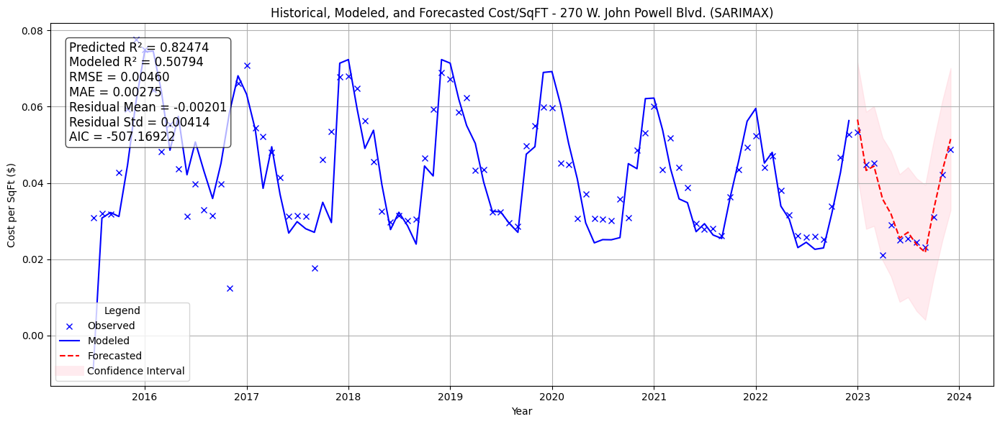

In [ ]:
# Highest Cost/SqFT CDHS (with SARIMAX results):

building_name = '270 w. john powell blvd.'
single_building_df = normalized_chds_with_lot_size[normalized_chds_with_lot_size['Address'].str.lower() == building_name.lower()]

plot_single_building_forecast(
    building_name=building_name,
    historical_df=normalized_chds_with_lot_size,
    forecast_df=forecast_df_cdhs,
    modeled_data=modeled_data_cdhs,
    error_metrics=error_metrics_cdhs,
    scaling_factor=scaling_factor,
    custom_title="Historical, Modeled, and Forecasted Cost/SqFT - 270 W. John Powell Blvd. (SARIMAX)"
)

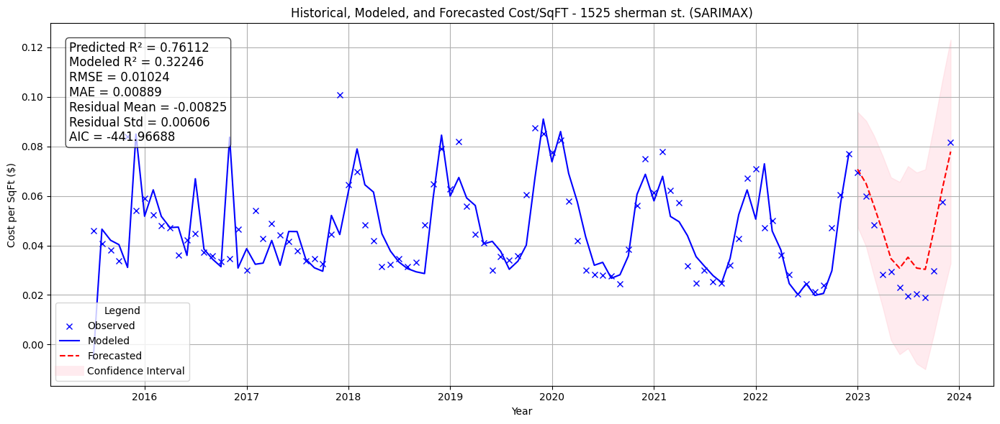

In [ ]:
# Highest Cost/SqFT CDHS DPA building (with SARIMAX results):

plot_single_building_forecast(
    building_name='1525 sherman st.',
    historical_df=normalized_dpa_with_lot_size,
    forecast_df=forecast_df_dpa,
    modeled_data=modeled_data_dpa,
    error_metrics=error_metrics_dpa,
    scaling_factor=scaling_factor,
    custom_title= "Historical, Modeled, and Forecasted Cost/SqFT - 1525 sherman st. (SARIMAX)"
)

Top 5 Buildings with Highest Cost/SqFt - SARIMAX Forecast by Agency

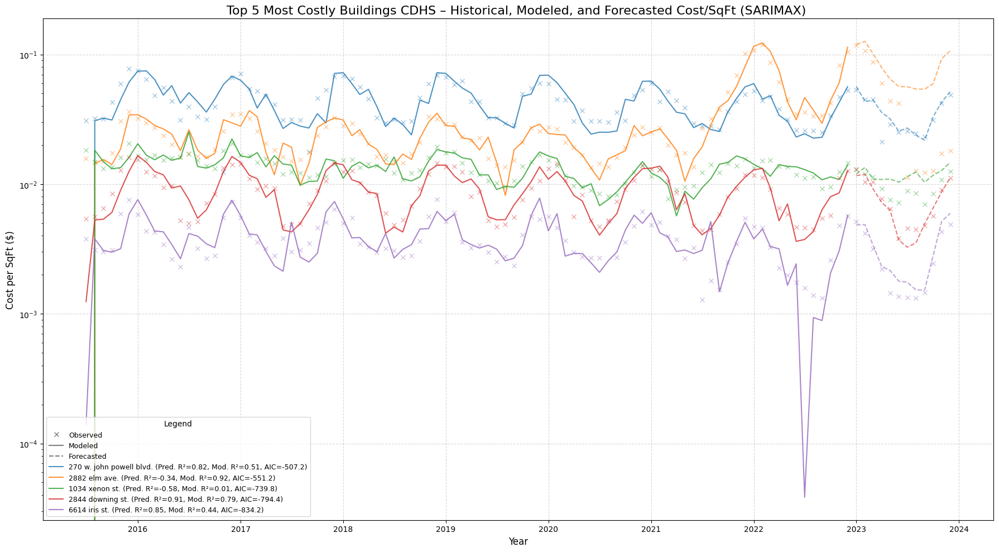

In [ ]:
# For top 5 buildings (with SARIMAX results):

top_5 = normalized_chds_with_lot_size.sort_values('Average Cost/SqFt', ascending=False).head(5)

plot_sarima_results(
    buildings_df=top_5,
    forecast_df=forecast_df_cdhs,
    modeled_data=modeled_data_cdhs,
    error_metrics=error_metrics_cdhs,
    title="Top 5 Most Costly Buildings CDHS – Historical, Modeled, and Forecasted Cost/SqFt (SARIMAX) ",
    scaling_factor=scaling_factor,
    use_log_scale=True
)

####Top 5 Buildings with Highest Cost/SqFt - SARIMAX Forecast by Agency

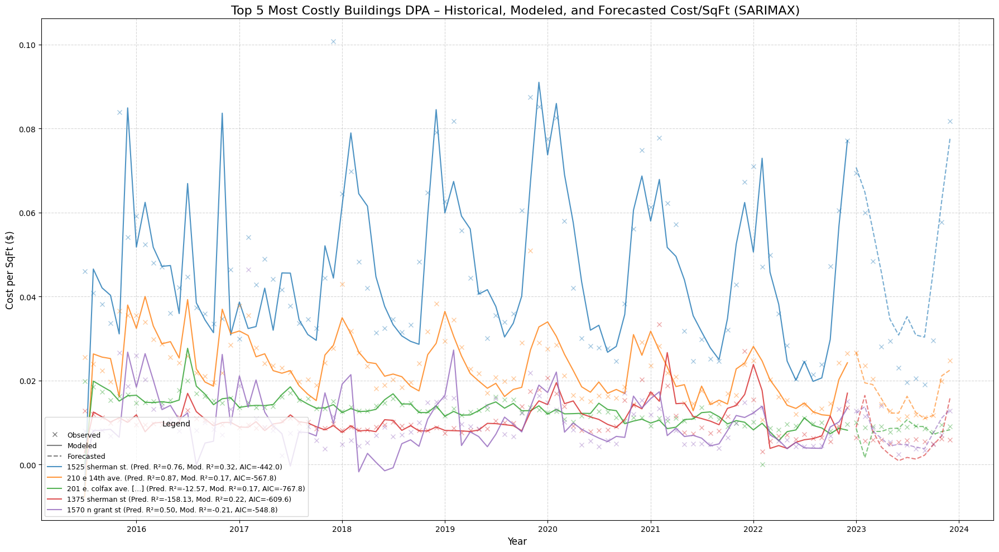

In [ ]:
# Pick top 5 buildings by average cost/sqft

top_5 = normalized_dpa_with_lot_size.sort_values('Average Cost/SqFt', ascending=False).head(5)

plot_sarima_results(
    buildings_df=top_5,
    forecast_df=forecast_df_dpa,
    modeled_data=modeled_data_dpa,
    error_metrics=error_metrics_dpa,
    title="Top 5 Most Costly Buildings DPA – Historical, Modeled, and Forecasted Cost/SqFt (SARIMAX) ",
    scaling_factor=scaling_factor,
    use_log_scale=False
)

#### All Buildings (SARIMAX Forecast)

Skipping 13500 e. fremont pl. due to missing metrics.
Skipping 2901 ford st., due to missing metrics.


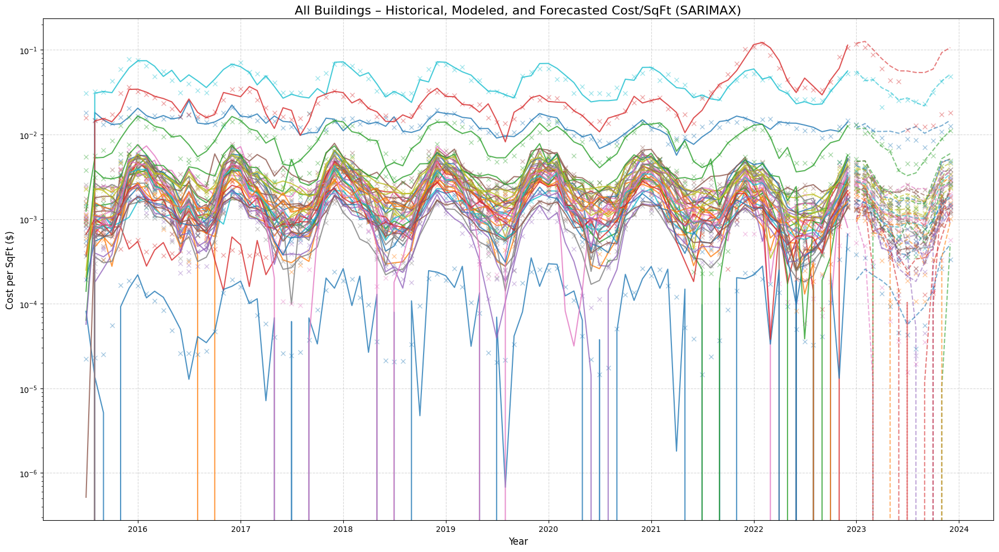

In [ ]:
# For All CDHS Buildings (with SARIMAX results)

plot_sarima_results(
    normalized_chds_with_lot_size,
    forecast_df=forecast_df_cdhs,
    modeled_data=modeled_data_cdhs,
    error_metrics=error_metrics_cdhs,
    title= "All Buildings – Historical, Modeled, and Forecasted Cost/SqFt (SARIMAX)",
    scaling_factor=1.0,
    use_log_scale=True,
    include_legend=False,
    include_ci=False,
    ci_alpha=0.2, max_label_width=25)

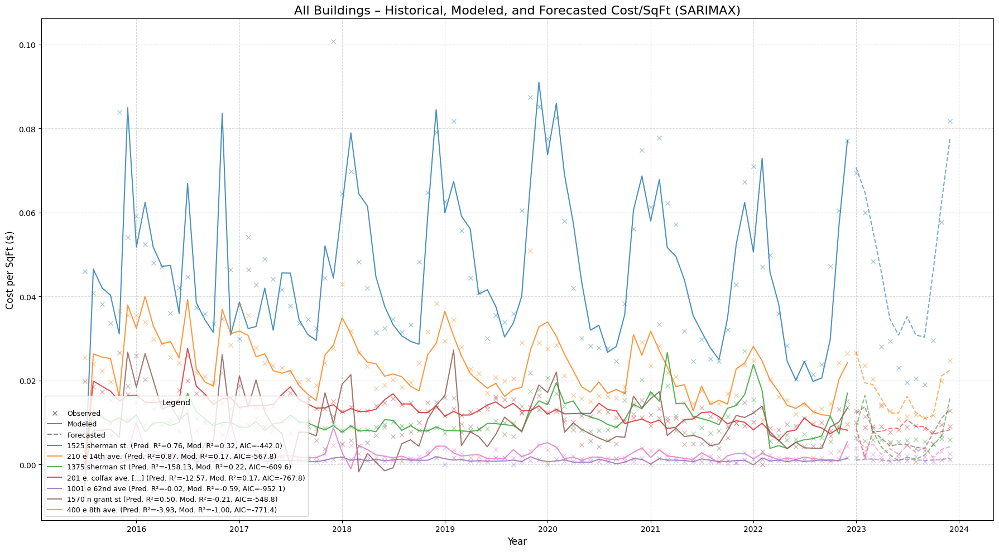

In [ ]:
# For All DPA Buildings (with SARIMAX results)
plot_sarima_results(
    normalized_dpa_with_lot_size,
    forecast_df=forecast_df_dpa,
    modeled_data=modeled_data_dpa,
    error_metrics=error_metrics_dpa,
    title= "All Buildings – Historical, Modeled, and Forecasted Cost/SqFt (SARIMAX)",
    scaling_factor=1.0,
    use_log_scale=False,
    include_legend=True,
    include_ci=False,
    ci_alpha=0.2, max_label_width=25)

#### Actual, Forecasted, and Modeled Time Series Data (SARIMAX Model)

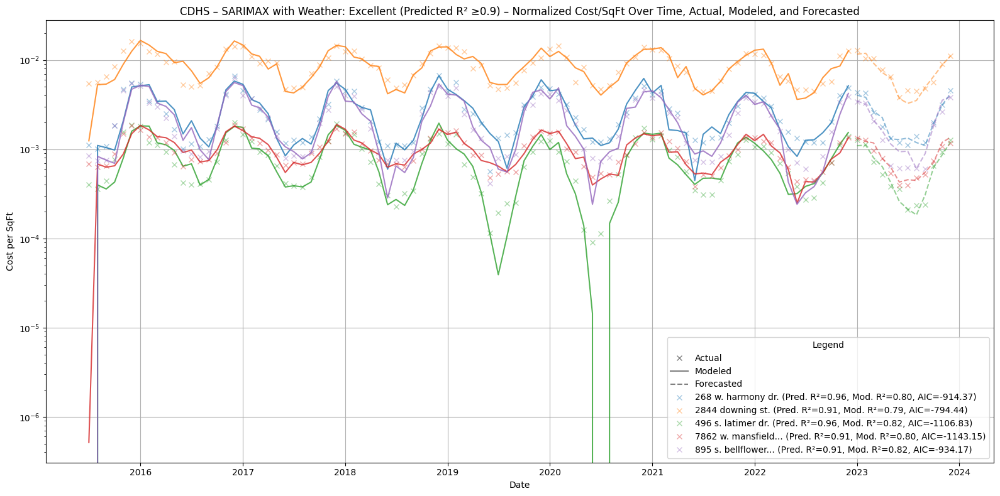

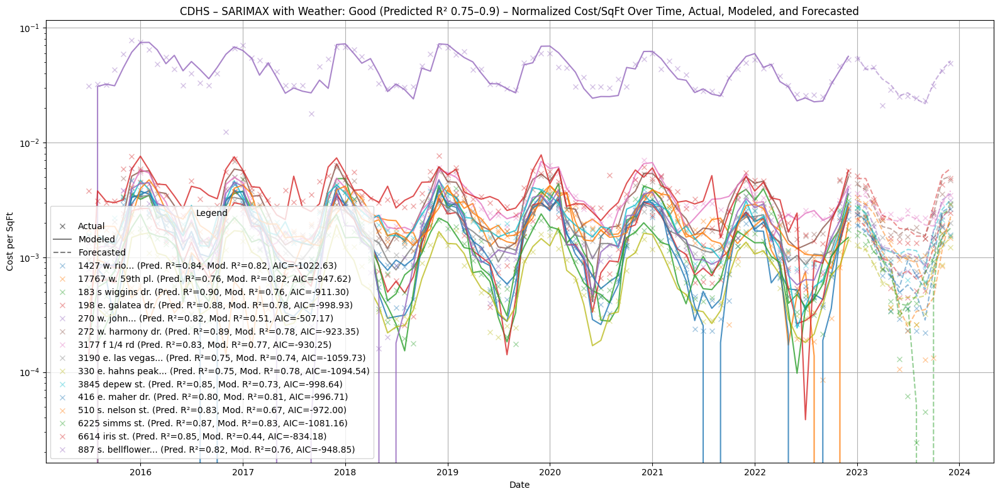

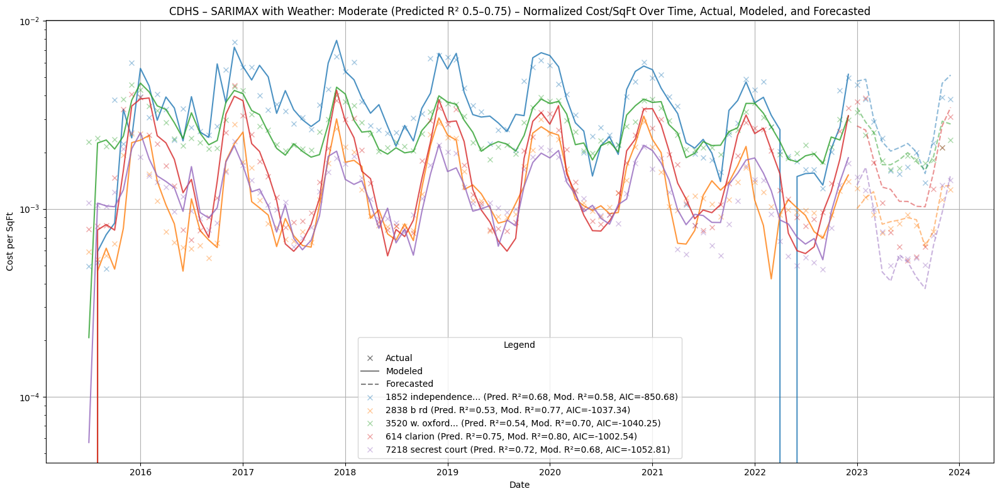

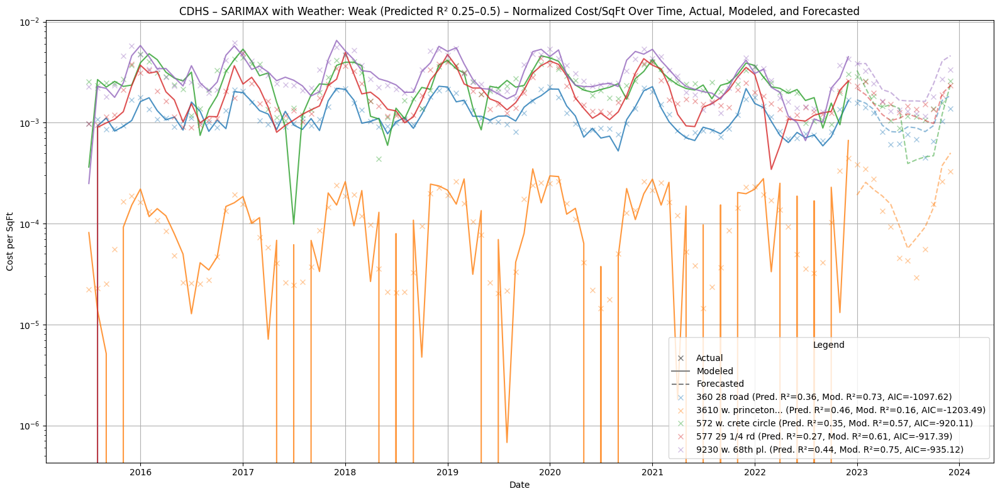

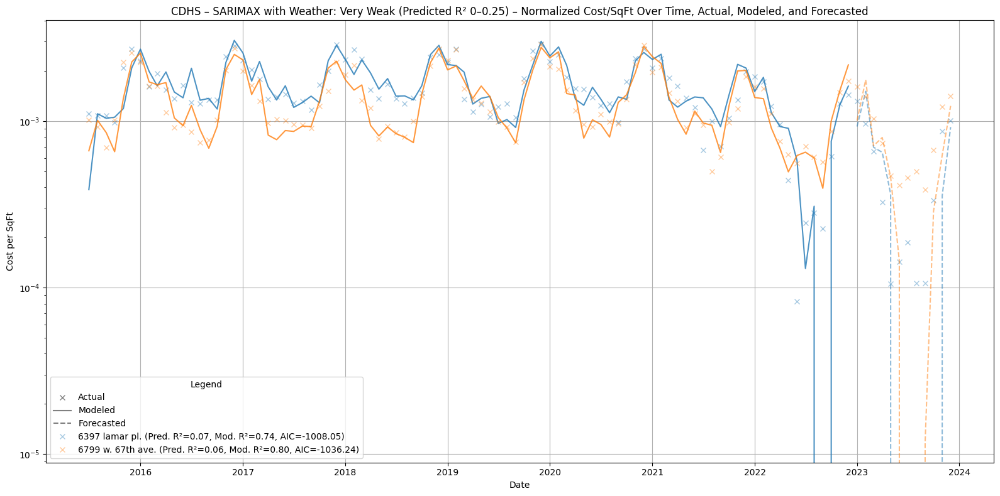

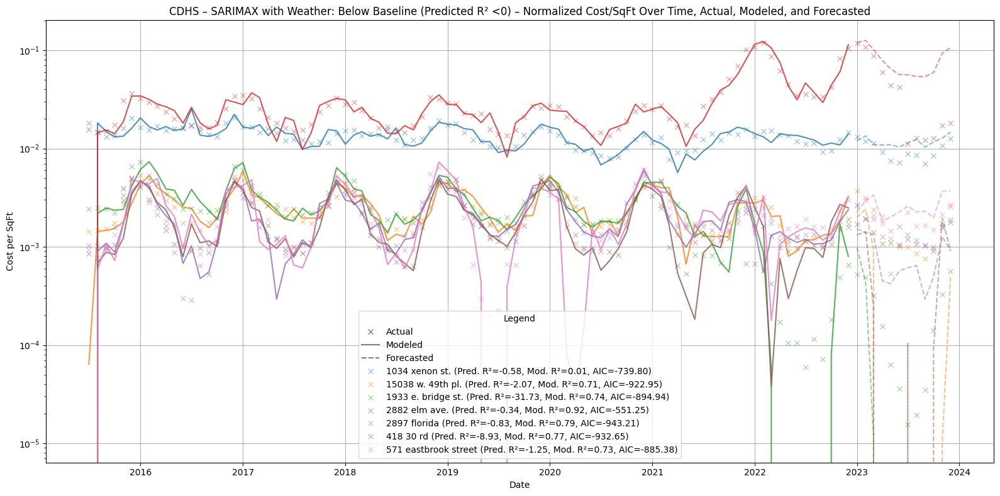

In [ ]:
# Group buildings by predicted R² for SARIMAX
cdhs_weather_categories = group_buildings_by_r2(
    normalized_chds_with_lot_size.copy(),
    error_df_cdhs.copy()
)

# Plot grouped forecast results from SARIMAX (with weather)
plot_grouped_sarima_results(
    categories=cdhs_weather_categories,
    error_df=error_df_cdhs,
    forecast_df=forecast_df_cdhs,
    modeled_data=modeled_data_cdhs,
    scaling_factor=1.0,
    title_prefix="CDHS – SARIMAX with Weather: "
)

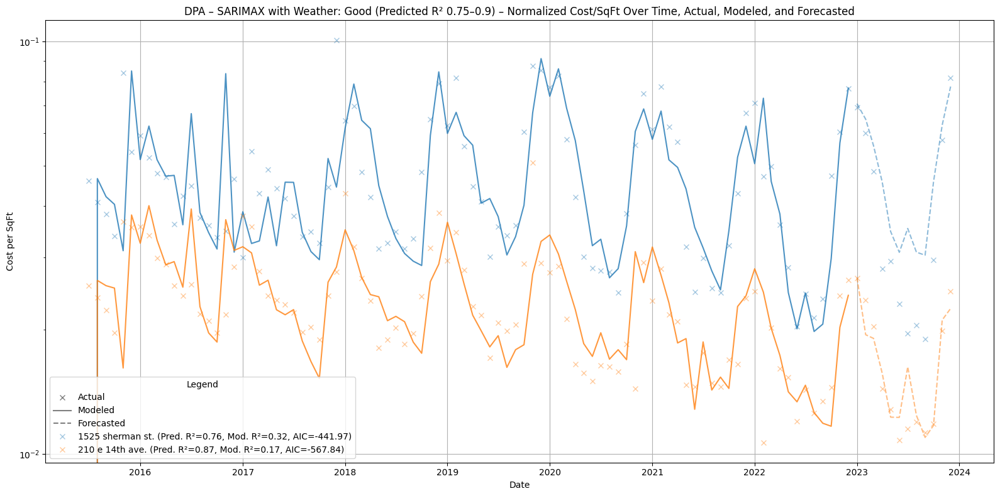

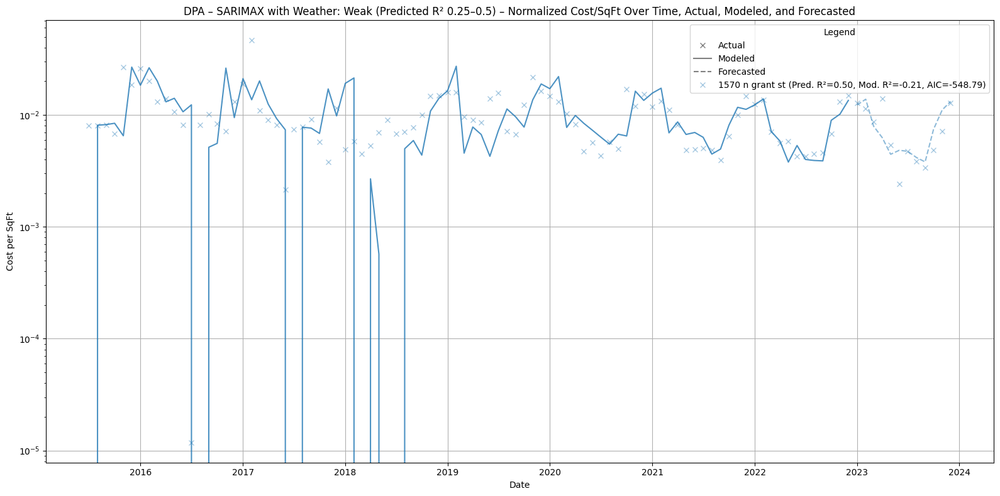

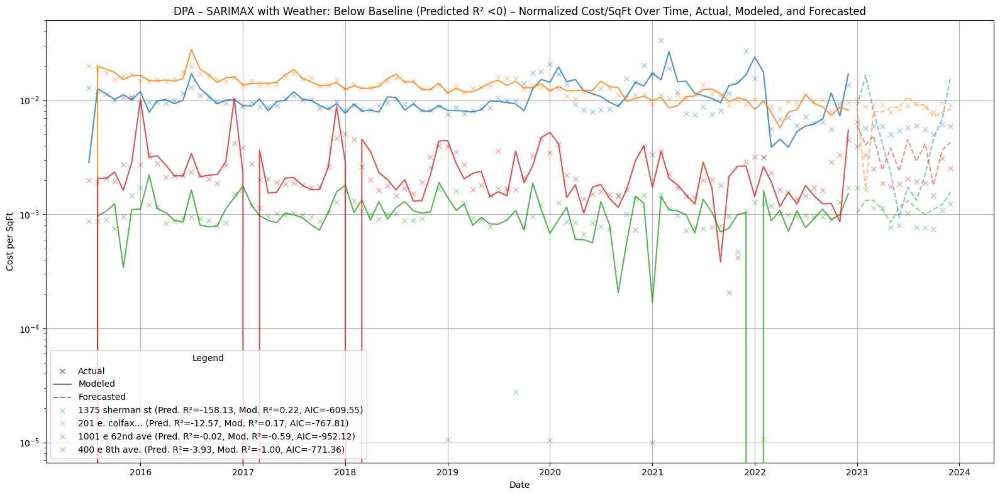

In [ ]:
# DPA  Group buildings by predicted R² for SARIMAX

dpa_weather_categories = group_buildings_by_r2(normalized_dpa_with_lot_size.copy(),
    error_df_dpa.copy())

# Plot grouped forecast results from SARIMAX (with weather)
plot_grouped_sarima_results(
    categories=dpa_weather_categories,
    error_df=error_df_dpa,
    forecast_df=forecast_df_dpa,
    modeled_data=modeled_data_dpa,
    scaling_factor=1.0,
    title_prefix="DPA – SARIMAX with Weather: "
)

### Auto ARIMA

- **p**: Number of autoregressive (AR) terms  
- **d**: Number of non-seasonal differences  
- **q**: Number of moving average (MA) terms  
- **P**: Number of seasonal autoregressive terms  
- **D**: Number of seasonal differences  
- **Q**: Number of seasonal moving average terms  
- **m**: Seasonal period (e.g., 12 for monthly data with yearly seasonality)

**AutoARIMA** automatically tests multiple combinations of these parameters to find the best fit based on information criteria like AIC (Akaike Information Criterion), while **SARIMA** requires the user to specify them manually.


For more details on the Auto ARIMA documentation, check out our reference section below.  
[Jump to Auto ARIMA reference](#auto_arima-id)

This cell might take more than 3 minutes to run

In [ ]:
forecast_df, failed_buildings, ts, error_metrics, modeled_data = backtest_auto_arima(normalized_chds_with_lot_size)

error_df = pd.DataFrame(error_metrics)

auto_error_cdhs_df = error_df.copy()

Processing 1034 xenon st.

ARIMA(2,1,2)(1,0,1)[12] with drift        :inf

ARIMA(0,1,0) with drift        :-854.3451291697963

ARIMA(1,1,0)(1,0,0)[12] with drift        :-864.7017650653289

ARIMA(0,1,1)(0,0,1)[12] with drift        :-858.9992732036832

ARIMA(0,1,0)                   :-856.3995848874819

ARIMA(1,1,0) with drift        :-852.2394432751885

ARIMA(1,1,0)(2,0,0)[12] with drift        :-868.4049353781758

ARIMA(1,1,0)(2,0,1)[12] with drift        :-865.8966324129954

ARIMA(1,1,0)(1,0,1)[12] with drift        :-867.5455478418029

ARIMA(0,1,0)(2,0,0)[12] with drift        :-869.9595416188689

ARIMA(0,1,0)(1,0,0)[12] with drift        :-866.2989984117248

ARIMA(0,1,0)(2,0,1)[12] with drift        :-867.7191130118484

ARIMA(0,1,0)(1,0,1)[12] with drift        :-868.9650194285108

ARIMA(0,1,1)(2,0,0)[12] with drift        :-867.9383054784308

ARIMA(1,1,1)(2,0,0)[12] with drift        :-864.114103761656

ARIMA(0,1,0)(2,0,0)[12]                   :-872.4703718088492

ARIMA(0,1,0)(1

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,0,1)[12] with drift        :inf

ARIMA(0,1,0) with drift        :-854.3451291697963

ARIMA(1,1,0)(1,0,0)[12] with drift        :-864.7017650653289

ARIMA(0,1,1)(0,0,1)[12] with drift        :-858.9992732036832

ARIMA(0,1,0)                   :-856.3995848874819

ARIMA(1,1,0) with drift        :-852.2394432751885

ARIMA(1,1,0)(2,0,0)[12] with drift        :-868.4049353781758

ARIMA(1,1,0)(2,0,1)[12] with drift        :-865.8966324129954

ARIMA(1,1,0)(1,0,1)[12] with drift        :-867.5455478418029

ARIMA(0,1,0)(2,0,0)[12] with drift        :-869.9595416188689

ARIMA(0,1,0)(1,0,0)[12] with drift        :-866.2989984117248

ARIMA(0,1,0)(2,0,1)[12] with drift        :-867.7191130118484

ARIMA(0,1,0)(1,0,1)[12] with drift        :-868.9650194285108

ARIMA(0,1,1)(2,0,0)[12] with drift        :-867.9383054784308

ARIMA(1,1,1)(2,0,0)[12] with drift        :-864.114103761656

ARIMA(0,1,0)(2,0,0)[12]                   :-872.4703718088492

ARIMA(0,1,0)(1,0,0)[12]                 

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :inf

ARIMA(0,0,0)(0,1,0)[12] with drift        :-992.3022685524112

ARIMA(1,0,0)(1,1,0)[12] with drift        :-999.3931229941345

ARIMA(0,0,1)(0,1,1)[12] with drift        :-987.9143233469317

ARIMA(0,0,0)(0,1,0)[12]                   :-984.3240415595795

ARIMA(1,0,0)(0,1,0)[12] with drift        :-991.062325447421

ARIMA(1,0,0)(2,1,0)[12] with drift        :-1001.0896087405705

ARIMA(1,0,0)(2,1,1)[12] with drift        :inf

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1006.2025210823743

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1007.9534149143792

ARIMA(1,0,0)(0,1,2)[12] with drift        :-1006.2135558487397

ARIMA(1,0,0)(1,1,2)[12] with drift        :-1004.8492708857635

ARIMA(0,0,0)(0,1,1)[12] with drift        :-990.1379442280868

ARIMA(2,0,0)(0,1,1)[12] with drift        :-1006.345885423853

ARIMA(1,0,1)(0,1,1)[12] with drift        :-1005.9115394284084

ARIMA(2,0,1)(0,1,1)[12] with drift        :-1003.7002653875389

ARIMA(1,0,0)(0,

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-1028.122858922291

ARIMA(0,0,0)(0,1,0)[12] with drift        :-1017.2735194262294

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1034.944618900623

ARIMA(0,0,1)(0,1,1)[12] with drift        :-1012.88557422075

ARIMA(0,0,0)(0,1,0)[12]                   :-1014.3381729586864

ARIMA(1,0,0)(0,1,0)[12] with drift        :-1035.6321840188175

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1036.8567823518988

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1035.1137999338102

ARIMA(1,0,0)(0,1,2)[12] with drift        :-1038.2951465419762

ARIMA(1,0,0)(1,1,2)[12] with drift        :-1035.4763820718583

ARIMA(0,0,0)(0,1,2)[12] with drift        :-1012.88557422075

ARIMA(2,0,0)(0,1,2)[12] with drift        :-1036.0020657525192

ARIMA(1,0,1)(0,1,2)[12] with drift        :-1035.9478819146816

ARIMA(0,0,1)(0,1,2)[12] with drift        :-1010.600186092896

ARIMA(2,0,1)(0,1,2)[12] with drift        :-1033.7069418373956

ARIMA(1,0,0)(0,1,2)[12]                   :-10

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :inf

ARIMA(0,1,0)(0,1,0)[12]                   :-904.2615516994495

ARIMA(1,1,0)(1,1,0)[12]                   :-941.4468751272057

ARIMA(0,1,1)(0,1,1)[12]                   :-954.8698091462406

ARIMA(0,1,1)(0,1,0)[12]                   :-934.5701560269071

ARIMA(0,1,1)(1,1,1)[12]                   :-952.1863897170743

ARIMA(0,1,1)(0,1,2)[12]                   :-953.7537991210876

ARIMA(0,1,1)(1,1,0)[12]                   :-952.1481888452586

ARIMA(0,1,1)(1,1,2)[12]                   :-950.6175436661099

ARIMA(0,1,0)(0,1,1)[12]                   :-933.1273604177312

ARIMA(1,1,1)(0,1,1)[12]                   :-953.3190804539423

ARIMA(0,1,2)(0,1,1)[12]                   :-953.548269391286

ARIMA(1,1,0)(0,1,1)[12]                   :-942.8582545636493

ARIMA(1,1,2)(0,1,1)[12]                   :-951.0934539485452
Now re-fitting the best model(s) without approximations...


ARIMA(0,1,1)(0,1,1)[12]                   :-954.8698091462406
Optimal par

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,0,1)[12] with drift        :inf

ARIMA(0,1,0) with drift        :-1098.267836235152

ARIMA(1,1,0)(1,0,0)[12] with drift        :-1120.768658638562

ARIMA(0,1,1)(0,0,1)[12] with drift        :-1113.75002903598

ARIMA(0,1,0)                   :-1100.3119064951952

ARIMA(1,1,0) with drift        :-1105.6804135784203

ARIMA(1,1,0)(2,0,0)[12] with drift        :-1121.189306566029

ARIMA(1,1,0)(2,0,1)[12] with drift        :inf

ARIMA(1,1,0)(1,0,1)[12] with drift        :inf

ARIMA(0,1,0)(2,0,0)[12] with drift        :-1123.120743470032

ARIMA(0,1,0)(1,0,0)[12] with drift        :-1122.574687487383

ARIMA(0,1,0)(2,0,1)[12] with drift        :-1121.1497860055435

ARIMA(0,1,0)(1,0,1)[12] with drift        :inf

ARIMA(0,1,1)(2,0,0)[12] with drift        :-1121.1439535797344

ARIMA(1,1,1)(2,0,0)[12] with drift        :-1113.633648548825

ARIMA(0,1,0)(2,0,0)[12]                   :-1125.4306659423949

ARIMA(0,1,0)(1,0,0)[12]                   :-1124.7095739414694

ARIMA(0,1,0)(2,0

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :inf

ARIMA(0,0,0)(0,1,0)[12] with drift        :-929.739503547598

ARIMA(1,0,0)(1,1,0)[12] with drift        :-950.1206512194778

ARIMA(0,0,1)(0,1,1)[12] with drift        :-925.3515583421186

ARIMA(0,0,0)(0,1,0)[12]                   :-931.8465528169182

ARIMA(1,0,0)(0,1,0)[12] with drift        :-932.6776262952146

ARIMA(1,0,0)(2,1,0)[12] with drift        :-948.9717629844964

ARIMA(1,0,0)(1,1,1)[12] with drift        :-948.5776668860254

ARIMA(1,0,0)(0,1,1)[12] with drift        :-952.4282447755347

ARIMA(1,0,0)(0,1,2)[12] with drift        :-950.1626673170969

ARIMA(1,0,0)(1,1,2)[12] with drift        :-947.2951363268957

ARIMA(0,0,0)(0,1,1)[12] with drift        :-927.5751792232736

ARIMA(2,0,0)(0,1,1)[12] with drift        :-950.7528855131965

ARIMA(1,0,1)(0,1,1)[12] with drift        :-951.0736360477105

ARIMA(2,0,1)(0,1,1)[12] with drift        :-950.3449793631731

ARIMA(1,0,0)(0,1,1)[12]                   :-954.4662107455222

ARIMA(1

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :inf

ARIMA(0,1,0)(0,1,0)[12]                   :-821.4789494060101

ARIMA(1,1,0)(1,1,0)[12]                   :-853.0374445193386

ARIMA(0,1,1)(0,1,1)[12]                   :-867.5981717809436

ARIMA(0,1,1)(0,1,0)[12]                   :-859.0606379432107

ARIMA(0,1,1)(1,1,1)[12]                   :-867.8535523209213

ARIMA(0,1,1)(1,1,0)[12]                   :-866.0410607160404

ARIMA(0,1,1)(2,1,1)[12]                   :-864.9402152645289

ARIMA(0,1,1)(1,1,2)[12]                   :-865.4423705954014

ARIMA(0,1,1)(0,1,2)[12]                   :-865.7360348465012

ARIMA(0,1,1)(2,1,0)[12]                   :-863.5308588761856

ARIMA(0,1,1)(2,1,2)[12]                   :-857.7052194190076

ARIMA(0,1,0)(1,1,1)[12]                   :inf

ARIMA(1,1,1)(1,1,1)[12]                   :-867.1364674187744

ARIMA(0,1,2)(1,1,1)[12]                   :-865.1718164932381

ARIMA(1,1,0)(1,1,1)[12]                   :-856.3194015248965

ARIMA(1,1,2)(1,1,1)[1

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :-890.780987576226

ARIMA(0,1,0)(0,1,0)[12]                   :-880.4547067863177

ARIMA(1,1,0)(1,1,0)[12]                   :-893.3114826814208

ARIMA(0,1,1)(0,1,1)[12]                   :-897.0788491710603

ARIMA(0,1,1)(0,1,0)[12]                   :-887.7775657030617

ARIMA(0,1,1)(1,1,1)[12]                   :-894.154185308125

ARIMA(0,1,1)(0,1,2)[12]                   :-895.156151246343

ARIMA(0,1,1)(1,1,0)[12]                   :-895.9472651265348

ARIMA(0,1,1)(1,1,2)[12]                   :-886.539570321597

ARIMA(0,1,0)(0,1,1)[12]                   :-893.9840423139916

ARIMA(1,1,1)(0,1,1)[12]                   :-899.0301345473532

ARIMA(1,1,1)(0,1,0)[12]                   :-886.5748091193448

ARIMA(1,1,1)(1,1,1)[12]                   :-895.8218105518588

ARIMA(1,1,1)(0,1,2)[12]                   :-897.2910660660634

ARIMA(1,1,1)(1,1,0)[12]                   :-895.6919289852295

ARIMA(1,1,1)(1,1,2)[12]                   :inf

ARIMA(1,1,

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-1022.8808167550816

ARIMA(0,0,0)(0,1,0)[12] with drift        :-1022.6401871633003

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1034.4816322109039

ARIMA(0,0,1)(0,1,1)[12] with drift        :-1018.2522419578208

ARIMA(0,0,0)(0,1,0)[12]                   :-1024.433206435022

ARIMA(1,0,0)(0,1,0)[12] with drift        :-1020.6604709756145

ARIMA(1,0,0)(2,1,0)[12] with drift        :-1031.5609523563128

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1033.456855389113

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1037.7335439123735

ARIMA(1,0,0)(0,1,2)[12] with drift        :-1035.7165082353326

ARIMA(1,0,0)(1,1,2)[12] with drift        :-1032.272825124497

ARIMA(0,0,0)(0,1,1)[12] with drift        :-1020.4758628389759

ARIMA(2,0,0)(0,1,1)[12] with drift        :-1035.6043973338524

ARIMA(1,0,1)(0,1,1)[12] with drift        :inf

ARIMA(2,0,1)(0,1,1)[12] with drift        :inf

ARIMA(1,0,0)(0,1,1)[12]                   :-1038.9999834747978

ARIMA(1,0,

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-945.4859351383374

ARIMA(0,0,0)(0,1,0)[12] with drift        :-939.1502376166851

ARIMA(1,0,0)(1,1,0)[12] with drift        :-950.7140092008033

ARIMA(0,0,1)(0,1,1)[12] with drift        :-934.7622924112056

ARIMA(0,0,0)(0,1,0)[12]                   :-941.0299625660001

ARIMA(1,0,0)(0,1,0)[12] with drift        :-937.3801055139038

ARIMA(1,0,0)(2,1,0)[12] with drift        :-946.3943813585955

ARIMA(1,0,0)(1,1,1)[12] with drift        :-947.1350009694492

ARIMA(1,0,0)(0,1,1)[12] with drift        :-950.920558047439

ARIMA(1,0,0)(0,1,2)[12] with drift        :-948.6572029353166

ARIMA(1,0,0)(1,1,2)[12] with drift        :-944.0592186537532

ARIMA(0,0,0)(0,1,1)[12] with drift        :-936.9859132923607

ARIMA(2,0,0)(0,1,1)[12] with drift        :-953.1219825029915

ARIMA(2,0,0)(0,1,0)[12] with drift        :-939.2932348962854

ARIMA(2,0,0)(1,1,1)[12] with drift        :-949.8380269674036

ARIMA(2,0,0)(0,1,2)[12] with drift        :-950.7677402

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-504.1561062271106

ARIMA(0,0,0)(0,1,0)[12] with drift        :-501.83510535142125

ARIMA(1,0,0)(1,1,0)[12] with drift        :-522.5602504184853

ARIMA(0,0,1)(0,1,1)[12] with drift        :-528.4928764112676

ARIMA(0,0,0)(0,1,0)[12]                   :-501.05088720821016

ARIMA(0,0,1)(0,1,0)[12] with drift        :-504.367082099953

ARIMA(0,0,1)(1,1,1)[12] with drift        :-514.2865334290228

ARIMA(0,0,1)(0,1,2)[12] with drift        :-525.8644889231676

ARIMA(0,0,1)(1,1,0)[12] with drift        :-522.107326173121

ARIMA(0,0,1)(1,1,2)[12] with drift        :-514.2094719116143

ARIMA(0,0,0)(0,1,1)[12] with drift        :-527.0278500760314

ARIMA(1,0,1)(0,1,1)[12] with drift        :-526.5582214890675

ARIMA(0,0,2)(0,1,1)[12] with drift        :-526.6772747204401

ARIMA(1,0,0)(0,1,1)[12] with drift        :-528.7563204245944

ARIMA(1,0,0)(0,1,0)[12] with drift        :-504.4166696805644

ARIMA(1,0,0)(1,1,1)[12] with drift        :-514.347273

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-943.1317237165407

ARIMA(0,0,0)(0,1,0)[12] with drift        :-947.6539415740243

ARIMA(1,0,0)(1,1,0)[12] with drift        :-957.2895414446039

ARIMA(0,0,1)(0,1,1)[12] with drift        :-943.2659963685448

ARIMA(0,0,0)(0,1,0)[12]                   :-949.5597453688991

ARIMA(1,0,0)(0,1,0)[12] with drift        :-945.5050039336784

ARIMA(1,0,0)(2,1,0)[12] with drift        :-954.7124401528891

ARIMA(1,0,0)(1,1,1)[12] with drift        :-955.4206123925431

ARIMA(1,0,0)(0,1,1)[12] with drift        :-959.3854904907193

ARIMA(1,0,0)(0,1,2)[12] with drift        :-957.139449637279

ARIMA(1,0,0)(1,1,2)[12] with drift        :-952.9572110063074

ARIMA(0,0,0)(0,1,1)[12] with drift        :-945.4896172496999

ARIMA(2,0,0)(0,1,1)[12] with drift        :-957.1145884137103

ARIMA(1,0,1)(0,1,1)[12] with drift        :-957.088179338957

ARIMA(2,0,1)(0,1,1)[12] with drift        :-954.9193548843253

ARIMA(1,0,0)(0,1,1)[12]                   :-961.44584606

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :-1027.9492782697373

ARIMA(0,1,0)(0,1,0)[12]                   :-1021.4022989330172

ARIMA(1,1,0)(1,1,0)[12]                   :-1036.3186994600928

ARIMA(0,1,1)(0,1,1)[12]                   :-1040.820816794158

ARIMA(0,1,1)(0,1,0)[12]                   :-1036.4071173487464

ARIMA(0,1,1)(1,1,1)[12]                   :-1033.828204576112

ARIMA(0,1,1)(0,1,2)[12]                   :-1038.6502213070944

ARIMA(0,1,1)(1,1,0)[12]                   :-1036.6134493114394

ARIMA(0,1,1)(1,1,2)[12]                   :-1032.346552561382

ARIMA(0,1,0)(0,1,1)[12]                   :-1035.300396667324

ARIMA(1,1,1)(0,1,1)[12]                   :-1039.4173427496057

ARIMA(0,1,2)(0,1,1)[12]                   :-1038.9622324717432

ARIMA(1,1,0)(0,1,1)[12]                   :-1041.6088543621254

ARIMA(1,1,0)(0,1,0)[12]                   :-1033.8276145401492

ARIMA(1,1,0)(1,1,1)[12]                   :-1033.492381449855

ARIMA(1,1,0)(0,1,2)[12]                   :-

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-823.7926720033337

ARIMA(0,0,0)(0,1,0)[12] with drift        :-808.1842139565264

ARIMA(1,0,0)(1,1,0)[12] with drift        :-828.1488149920638

ARIMA(0,0,1)(0,1,1)[12] with drift        :-834.2240833412159

ARIMA(0,0,0)(0,1,0)[12]                   :-805.7292938374457

ARIMA(0,0,1)(0,1,0)[12] with drift        :-812.1027021507932

ARIMA(0,0,1)(1,1,1)[12] with drift        :-828.0836940258199

ARIMA(0,0,1)(0,1,2)[12] with drift        :-831.8375260460863

ARIMA(0,0,1)(1,1,0)[12] with drift        :-828.0213973514615

ARIMA(0,0,1)(1,1,2)[12] with drift        :-828.1950080558576

ARIMA(0,0,0)(0,1,1)[12] with drift        :-831.6645641834516

ARIMA(1,0,1)(0,1,1)[12] with drift        :-831.9411353714573

ARIMA(0,0,2)(0,1,1)[12] with drift        :-831.9560111894112

ARIMA(1,0,0)(0,1,1)[12] with drift        :-833.9210297524362

ARIMA(1,0,2)(0,1,1)[12] with drift        :inf

ARIMA(0,0,1)(0,1,1)[12]                   :-825.4444141667573
Now re-

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :inf

ARIMA(0,1,0)(0,1,0)[12]                   :-531.7347079955383

ARIMA(1,1,0)(1,1,0)[12]                   :-539.6806992090118

ARIMA(0,1,1)(0,1,1)[12]                   :-538.1340778154434

ARIMA(1,1,0)(0,1,0)[12]                   :-538.8969779309492

ARIMA(1,1,0)(2,1,0)[12]                   :-538.5043988697653

ARIMA(1,1,0)(1,1,1)[12]                   :-539.9518703309336

ARIMA(1,1,0)(0,1,1)[12]                   :-541.4903442795302

ARIMA(1,1,0)(0,1,2)[12]                   :inf

ARIMA(1,1,0)(1,1,2)[12]                   :inf

ARIMA(0,1,0)(0,1,1)[12]                   :-532.0151465559937

ARIMA(2,1,0)(0,1,1)[12]                   :-539.904470764311

ARIMA(1,1,1)(0,1,1)[12]                   :-539.4101762130538

ARIMA(2,1,1)(0,1,1)[12]                   :-539.3080572074074
Now re-fitting the best model(s) without approximations...


ARIMA(1,1,0)(0,1,1)[12]                   :-541.4903442795302
Optimal parameters: ARIMA(1,1,0)(0,1,1)[1

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :-952.0217267678073

ARIMA(0,1,0)(0,1,0)[12]                   :-947.9704655960743

ARIMA(1,1,0)(1,1,0)[12]                   :-956.7260602774916

ARIMA(0,1,1)(0,1,1)[12]                   :-960.4330484566756

ARIMA(0,1,1)(0,1,0)[12]                   :-947.9627046522418

ARIMA(0,1,1)(1,1,1)[12]                   :-957.0473341351684

ARIMA(0,1,1)(0,1,2)[12]                   :-958.0795445424511

ARIMA(0,1,1)(1,1,0)[12]                   :-956.7556730051015

ARIMA(0,1,1)(1,1,2)[12]                   :-955.0145239644521

ARIMA(0,1,0)(0,1,1)[12]                   :-962.5158009972257

ARIMA(0,1,0)(1,1,1)[12]                   :-959.7770726324159

ARIMA(0,1,0)(0,1,2)[12]                   :-960.2128627051354

ARIMA(0,1,0)(1,1,0)[12]                   :-959.0138440214486

ARIMA(0,1,0)(1,1,2)[12]                   :-957.8412336220669

ARIMA(1,1,0)(0,1,1)[12]                   :-960.4544442428378

ARIMA(1,1,1)(0,1,1)[12]                   :-960.559368

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :-1128.5011200242336

ARIMA(0,1,0)(0,1,0)[12]                   :-1095.190425713597

ARIMA(1,1,0)(1,1,0)[12]                   :-1112.2666871014949

ARIMA(0,1,1)(0,1,1)[12]                   :-1131.757278113251

ARIMA(0,1,1)(0,1,0)[12]                   :-1112.917158354369

ARIMA(0,1,1)(1,1,1)[12]                   :-1125.5772141180928

ARIMA(0,1,1)(0,1,2)[12]                   :-1129.5698290088008

ARIMA(0,1,1)(1,1,0)[12]                   :-1125.8894192769735

ARIMA(0,1,1)(1,1,2)[12]                   :-1126.346920043035

ARIMA(0,1,0)(0,1,1)[12]                   :-1116.8977292135185

ARIMA(1,1,1)(0,1,1)[12]                   :-1134.2283770355941

ARIMA(1,1,1)(0,1,0)[12]                   :-1116.0079504156517

ARIMA(1,1,1)(1,1,1)[12]                   :-1128.0473158186946

ARIMA(1,1,1)(0,1,2)[12]                   :-1131.9065493812554

ARIMA(1,1,1)(1,1,0)[12]                   :-1128.2957292790802

ARIMA(1,1,1)(1,1,2)[12]                   :

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :inf

ARIMA(0,1,0)(0,1,0)[12]                   :-933.61594155227

ARIMA(1,1,0)(1,1,0)[12]                   :-937.1726103031942

ARIMA(0,1,1)(0,1,1)[12]                   :-943.724744898926

ARIMA(0,1,1)(0,1,0)[12]                   :-932.3279357196376

ARIMA(0,1,1)(1,1,1)[12]                   :-942.3320064013127

ARIMA(0,1,1)(0,1,2)[12]                   :-942.3183716033224

ARIMA(0,1,1)(1,1,0)[12]                   :-937.2193257687545

ARIMA(0,1,1)(1,1,2)[12]                   :-940.006315424655

ARIMA(0,1,0)(0,1,1)[12]                   :-945.8711319577388

ARIMA(0,1,0)(1,1,1)[12]                   :-945.5590256573935

ARIMA(0,1,0)(0,1,2)[12]                   :-944.3805754003338

ARIMA(0,1,0)(1,1,0)[12]                   :-939.6427476140149

ARIMA(0,1,0)(1,1,2)[12]                   :-943.7412821756647

ARIMA(1,1,0)(0,1,1)[12]                   :-943.6816317025393

ARIMA(1,1,1)(0,1,1)[12]                   :inf
Now re-fitting the best mo

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-1070.6807096170764

ARIMA(0,0,0)(0,1,0)[12] with drift        :-1067.3358758448574

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1078.3590958574628

ARIMA(0,0,1)(0,1,1)[12] with drift        :-1062.947930639378

ARIMA(0,0,0)(0,1,0)[12]                   :-1062.1945434998365

ARIMA(1,0,0)(0,1,0)[12] with drift        :-1080.453425128911

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1079.7613193309146

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1077.4304129414331

ARIMA(2,0,0)(0,1,0)[12] with drift        :-1078.7379667910698

ARIMA(1,0,1)(0,1,0)[12] with drift        :-1079.7151667619023

ARIMA(0,0,1)(0,1,0)[12] with drift        :-1065.171551520533

ARIMA(2,0,1)(0,1,0)[12] with drift        :-1077.8324112879952

ARIMA(1,0,0)(0,1,0)[12]                   :-1080.0617721649749
Now re-fitting the best model(s) without approximations...


ARIMA(1,0,0)(0,1,0)[12] with drift        :-1080.453425128911
Optimal parameters: ARIMA(1,0,0)(0,1,0)[12] with

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-1122.9142958338632

ARIMA(0,0,0)(0,1,0)[12] with drift        :-1125.0133868738883

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1132.2337108978406

ARIMA(0,0,1)(0,1,1)[12] with drift        :-1120.625441668409

ARIMA(0,0,0)(0,1,0)[12]                   :-1126.4028440851912

ARIMA(1,0,0)(0,1,0)[12] with drift        :-1122.922313777705

ARIMA(1,0,0)(2,1,0)[12] with drift        :-1132.706879167049

ARIMA(1,0,0)(2,1,1)[12] with drift        :inf

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1132.7947780847205

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1138.4380712483055

ARIMA(1,0,0)(0,1,2)[12] with drift        :-1136.3962199692523

ARIMA(1,0,0)(1,1,2)[12] with drift        :-1132.0743226200116

ARIMA(0,0,0)(0,1,1)[12] with drift        :-1122.849062549564

ARIMA(2,0,0)(0,1,1)[12] with drift        :-1136.6188623918183

ARIMA(1,0,1)(0,1,1)[12] with drift        :-1136.7185024765652

ARIMA(2,0,1)(0,1,1)[12] with drift        :-1134.4252043194

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-1061.5251480693623

ARIMA(0,0,0)(0,1,0)[12] with drift        :-1071.771382001691

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1070.0536518939987

ARIMA(0,0,1)(0,1,1)[12] with drift        :-1067.3834367962118

ARIMA(0,0,0)(0,1,0)[12]                   :-1064.359471441475

ARIMA(0,0,0)(1,1,0)[12] with drift        :-1069.2695340697628

ARIMA(0,0,0)(0,1,1)[12] with drift        :-1069.6070576773668

ARIMA(0,0,0)(1,1,1)[12] with drift        :-1066.5084424462964

ARIMA(1,0,0)(0,1,0)[12] with drift        :-1072.388952707099

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1072.054180599534

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1066.8301877573356

ARIMA(2,0,0)(0,1,0)[12] with drift        :-1070.1920836954

ARIMA(1,0,1)(0,1,0)[12] with drift        :-1071.120319787818

ARIMA(0,0,1)(0,1,0)[12] with drift        :-1069.6070576773668

ARIMA(2,0,1)(0,1,0)[12] with drift        :-1069.9054437273294

ARIMA(1,0,0)(0,1,0)[12]                   :-106

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :-1136.9378523804114

ARIMA(0,1,0)(0,1,0)[12]                   :-1119.0709163983151

ARIMA(1,1,0)(1,1,0)[12]                   :-1126.2863616162338

ARIMA(0,1,1)(0,1,1)[12]                   :-1137.313246650599

ARIMA(0,1,1)(0,1,0)[12]                   :-1128.3508806699615

ARIMA(0,1,1)(1,1,1)[12]                   :-1133.4297117389058

ARIMA(0,1,1)(0,1,2)[12]                   :-1137.251342747555

ARIMA(0,1,1)(1,1,0)[12]                   :-1130.4231880903722

ARIMA(0,1,1)(1,1,2)[12]                   :-1135.7947203353658

ARIMA(0,1,0)(0,1,1)[12]                   :-1135.0545037325514

ARIMA(1,1,1)(0,1,1)[12]                   :-1134.9523230372265

ARIMA(0,1,2)(0,1,1)[12]                   :-1142.9401422638573

ARIMA(0,1,2)(0,1,0)[12]                   :-1134.2585507114866

ARIMA(0,1,2)(1,1,1)[12]                   :-1139.9033342869075

ARIMA(0,1,2)(0,1,2)[12]                   :-1141.9019719767148

ARIMA(0,1,2)(1,1,0)[12]                  

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :inf

ARIMA(0,0,0)(0,1,0)[12] with drift        :-1343.376410186597

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1365.9392949327737

ARIMA(0,0,1)(0,1,1)[12] with drift        :-1338.9884649811177

ARIMA(0,0,0)(0,1,0)[12]                   :-1340.8483398748192

ARIMA(1,0,0)(0,1,0)[12] with drift        :-1366.3236989808065

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1370.5734166580496

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1369.5805952114913

ARIMA(1,0,0)(0,1,2)[12] with drift        :-1372.7720328253308

ARIMA(1,0,0)(1,1,2)[12] with drift        :-1369.6774712470092

ARIMA(0,0,0)(0,1,2)[12] with drift        :-1338.9884649811177

ARIMA(2,0,0)(0,1,2)[12] with drift        :-1370.3242856143536

ARIMA(1,0,1)(0,1,2)[12] with drift        :-1370.3705784454407

ARIMA(0,0,1)(0,1,2)[12] with drift        :-1336.7030768532638

ARIMA(2,0,1)(0,1,2)[12] with drift        :inf

ARIMA(1,0,0)(0,1,2)[12]                   :-1370.3025925572833
Now re-fi

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :-1012.4548214372495

ARIMA(0,1,0)(0,1,0)[12]                   :-979.3642195529058

ARIMA(1,1,0)(1,1,0)[12]                   :-1002.9394039610697

ARIMA(0,1,1)(0,1,1)[12]                   :-1017.8949227709502

ARIMA(0,1,1)(0,1,0)[12]                   :-999.4744102500143

ARIMA(0,1,1)(1,1,1)[12]                   :-1014.9574147918164

ARIMA(0,1,1)(0,1,2)[12]                   :-1015.8490514190897

ARIMA(0,1,1)(1,1,0)[12]                   :-1014.1823490431989

ARIMA(0,1,1)(1,1,2)[12]                   :-1014.0727348766379

ARIMA(0,1,0)(0,1,1)[12]                   :-1001.7199862264268

ARIMA(1,1,1)(0,1,1)[12]                   :-1017.810565057603

ARIMA(0,1,2)(0,1,1)[12]                   :-1019.3051008262718

ARIMA(0,1,2)(0,1,0)[12]                   :-997.9810334679814

ARIMA(0,1,2)(1,1,1)[12]                   :-1017.3780171263295

ARIMA(0,1,2)(0,1,2)[12]                   :-1017.6059035751248

ARIMA(0,1,2)(1,1,0)[12]                   :

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-1006.0375952854134

ARIMA(0,0,0)(0,1,0)[12] with drift        :-1015.2636144356562

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1015.5471227149189

ARIMA(0,0,1)(0,1,1)[12] with drift        :-1010.8756692301768

ARIMA(0,0,0)(0,1,0)[12]                   :-1008.7228388490201

ARIMA(1,0,0)(0,1,0)[12] with drift        :-1013.674184005916

ARIMA(1,0,0)(2,1,0)[12] with drift        :-1013.5109157230519

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1014.5831972106133

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1020.7350662133772

ARIMA(1,0,0)(0,1,2)[12] with drift        :-1022.1633206165908

ARIMA(1,0,0)(1,1,2)[12] with drift        :-1016.3831116615016

ARIMA(0,0,0)(0,1,2)[12] with drift        :-1010.8756692301768

ARIMA(2,0,0)(0,1,2)[12] with drift        :-1020.7756844378661

ARIMA(1,0,1)(0,1,2)[12] with drift        :-1022.4524257417894

ARIMA(1,0,1)(0,1,1)[12] with drift        :-1021.9024323655109

ARIMA(1,0,1)(1,1,2)[12] with drift      

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-964.9082016154817

ARIMA(0,0,0)(0,1,0)[12] with drift        :-949.9365635143666

ARIMA(1,0,0)(1,1,0)[12] with drift        :-972.7815269076498

ARIMA(0,0,1)(0,1,1)[12] with drift        :-945.5486183088872

ARIMA(0,0,0)(0,1,0)[12]                   :-948.0830340389249

ARIMA(1,0,0)(0,1,0)[12] with drift        :-968.9748291756894

ARIMA(1,0,0)(2,1,0)[12] with drift        :-970.7302817152305

ARIMA(1,0,0)(1,1,1)[12] with drift        :-970.8639536541156

ARIMA(1,0,0)(0,1,1)[12] with drift        :-973.5675221835527

ARIMA(1,0,0)(0,1,2)[12] with drift        :-971.276466761403

ARIMA(1,0,0)(1,1,2)[12] with drift        :-968.3881497659685

ARIMA(0,0,0)(0,1,1)[12] with drift        :-947.7722391900422

ARIMA(2,0,0)(0,1,1)[12] with drift        :-972.2034586432279

ARIMA(1,0,1)(0,1,1)[12] with drift        :-971.9790975010307

ARIMA(2,0,1)(0,1,1)[12] with drift        :-970.4081679411187

ARIMA(1,0,0)(0,1,1)[12]                   :-973.9108429

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-1122.6268863121225

ARIMA(0,0,0)(0,1,0)[12] with drift        :-1093.076231812768

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1127.0184774417094

ARIMA(0,0,1)(0,1,1)[12] with drift        :-1088.6882866072885

ARIMA(0,0,0)(0,1,0)[12]                   :-1093.1819252224548

ARIMA(1,0,0)(0,1,0)[12] with drift        :-1113.3787889807088

ARIMA(1,0,0)(2,1,0)[12] with drift        :-1124.1142989685195

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1129.1576170122614

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1131.4490542130388

ARIMA(1,0,0)(0,1,2)[12] with drift        :-1129.141384353413

ARIMA(1,0,0)(1,1,2)[12] with drift        :-1126.0710328546609

ARIMA(0,0,0)(0,1,1)[12] with drift        :-1090.9119074884436

ARIMA(2,0,0)(0,1,1)[12] with drift        :-1135.245836705786

ARIMA(2,0,0)(0,1,0)[12] with drift        :-1120.341496465493

ARIMA(2,0,0)(1,1,1)[12] with drift        :-1129.9473049868675

ARIMA(2,0,0)(0,1,2)[12] with drift        :

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-1005.6064730483398

ARIMA(0,0,0)(0,1,0)[12] with drift        :-991.6818662314612

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1000.7852975277601

ARIMA(0,0,1)(0,1,1)[12] with drift        :-987.2939210259817

ARIMA(0,0,0)(0,1,0)[12]                   :-987.9713032058979

ARIMA(2,0,2)(0,1,1)[12] with drift        :-1001.1674940764418

ARIMA(2,0,2)(1,1,0)[12] with drift        :-1001.8438810609108

ARIMA(2,0,2)(2,1,1)[12] with drift        :-993.2212478361231

ARIMA(2,0,2)(1,1,2)[12] with drift        :-1005.0473371939776

ARIMA(2,0,2)(0,1,0)[12] with drift        :-999.1406940208789

ARIMA(2,0,2)(0,1,2)[12] with drift        :-1001.7578461193428

ARIMA(2,0,2)(2,1,0)[12] with drift        :-1001.3232220151671

ARIMA(2,0,2)(2,1,2)[12] with drift        :-985.4877458314902

ARIMA(1,0,2)(1,1,1)[12] with drift        :-1009.4228664093508

ARIMA(1,0,2)(0,1,1)[12] with drift        :-1011.3810483081114

ARIMA(1,0,2)(0,1,0)[12] with drift        :-1

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-843.3370042334119

ARIMA(0,0,0)(0,1,0)[12] with drift        :-857.2639607551511

ARIMA(1,0,0)(1,1,0)[12] with drift        :-913.7549220765025

ARIMA(0,0,1)(0,1,1)[12] with drift        :-908.4104110111311

ARIMA(0,0,0)(0,1,0)[12]                   :-858.804218502262

ARIMA(1,0,0)(0,1,0)[12] with drift        :-899.4542976362202

ARIMA(1,0,0)(2,1,0)[12] with drift        :-916.8802183634879

ARIMA(1,0,0)(2,1,1)[12] with drift        :-911.7986972300795

ARIMA(1,0,0)(1,1,1)[12] with drift        :-917.9546478640683

ARIMA(1,0,0)(0,1,1)[12] with drift        :-921.2021738378924

ARIMA(1,0,0)(0,1,2)[12] with drift        :-918.7604060244986

ARIMA(1,0,0)(1,1,2)[12] with drift        :-916.5816511076347

ARIMA(0,0,0)(0,1,1)[12] with drift        :-878.9463700652932

ARIMA(2,0,0)(0,1,1)[12] with drift        :-918.8591363825502

ARIMA(1,0,1)(0,1,1)[12] with drift        :-918.8623946473261

ARIMA(2,0,1)(0,1,1)[12] with drift        :-916.5455544

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-937.417095975302

ARIMA(0,0,0)(0,1,0)[12] with drift        :-917.2943263793139

ARIMA(1,0,0)(1,1,0)[12] with drift        :-951.5664747745291

ARIMA(0,0,1)(0,1,1)[12] with drift        :-912.9063811738345

ARIMA(0,0,0)(0,1,0)[12]                   :-915.5589692990171

ARIMA(1,0,0)(0,1,0)[12] with drift        :-947.4750416735385

ARIMA(1,0,0)(2,1,0)[12] with drift        :-954.9059960652368

ARIMA(1,0,0)(2,1,1)[12] with drift        :-955.6722568593419

ARIMA(1,0,0)(1,1,1)[12] with drift        :-949.8946850390024

ARIMA(1,0,0)(2,1,2)[12] with drift        :-952.0643681484695

ARIMA(1,0,0)(1,1,2)[12] with drift        :-955.9549607040566

ARIMA(1,0,0)(0,1,2)[12] with drift        :inf

ARIMA(1,0,0)(0,1,1)[12] with drift        :-965.1208652095397

ARIMA(0,0,0)(0,1,1)[12] with drift        :-915.1300020549895

ARIMA(2,0,0)(0,1,1)[12] with drift        :-962.9129348639934

ARIMA(1,0,1)(0,1,1)[12] with drift        :-963.0475099846752

ARIMA(2

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :inf

ARIMA(0,1,0)(0,1,0)[12]                   :-874.1793929494359

ARIMA(1,1,0)(1,1,0)[12]                   :-915.0304905648732

ARIMA(0,1,1)(0,1,1)[12]                   :-936.7647170659122

ARIMA(0,1,1)(0,1,0)[12]                   :-919.7962809234074

ARIMA(0,1,1)(1,1,1)[12]                   :-889.1524876077966

ARIMA(0,1,1)(0,1,2)[12]                   :-934.1554482053083

ARIMA(0,1,1)(1,1,0)[12]                   :-922.4642329533408

ARIMA(0,1,1)(1,1,2)[12]                   :-889.875830167282

ARIMA(0,1,0)(0,1,1)[12]                   :inf

ARIMA(1,1,1)(0,1,1)[12]                   :-935.0959904461466

ARIMA(0,1,2)(0,1,1)[12]                   :-934.8893572643352

ARIMA(1,1,0)(0,1,1)[12]                   :-932.6407601257104

ARIMA(1,1,2)(0,1,1)[12]                   :-932.0432930737697
Now re-fitting the best model(s) without approximations...


ARIMA(0,1,1)(0,1,1)[12]                   :-936.7647170659122
Optimal parameters: ARIMA(

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-1012.5094748771459

ARIMA(0,0,0)(0,1,0)[12] with drift        :-1023.5982886580508

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1027.0239473645422

ARIMA(0,0,1)(0,1,1)[12] with drift        :-1019.2103434525714

ARIMA(0,0,0)(0,1,0)[12]                   :-1024.673218690224

ARIMA(1,0,0)(0,1,0)[12] with drift        :-1021.4810726652101

ARIMA(1,0,0)(2,1,0)[12] with drift        :-1025.8720260741995

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1026.4605815087857

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1030.0074910716523

ARIMA(1,0,0)(0,1,2)[12] with drift        :-1027.9842535204893

ARIMA(1,0,0)(1,1,2)[12] with drift        :-1023.8287666871905

ARIMA(0,0,0)(0,1,1)[12] with drift        :-1021.4339643337264

ARIMA(2,0,0)(0,1,1)[12] with drift        :-1027.845420499009

ARIMA(1,0,1)(0,1,1)[12] with drift        :inf

ARIMA(2,0,1)(0,1,1)[12] with drift        :-1025.495744200313

ARIMA(1,0,0)(0,1,1)[12]                   :-1030.104002887

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-1146.4898613840965

ARIMA(0,0,0)(0,1,0)[12] with drift        :-1141.8869949265804

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1148.3617086223758

ARIMA(0,0,1)(0,1,1)[12] with drift        :-1137.499049721101

ARIMA(0,0,0)(0,1,0)[12]                   :-1136.3028713420028

ARIMA(1,0,0)(0,1,0)[12] with drift        :-1140.8631843220887

ARIMA(1,0,0)(2,1,0)[12] with drift        :-1146.8244519853815

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1149.3658725408723

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1152.7297374002349

ARIMA(1,0,0)(0,1,2)[12] with drift        :-1151.6368792808494

ARIMA(1,0,0)(1,1,2)[12] with drift        :-1148.3029155510262

ARIMA(0,0,0)(0,1,1)[12] with drift        :-1139.7226706022561

ARIMA(2,0,0)(0,1,1)[12] with drift        :-1150.5117167020985

ARIMA(1,0,1)(0,1,1)[12] with drift        :-1153.084086098346

ARIMA(1,0,1)(0,1,0)[12] with drift        :-1139.2013512460842

ARIMA(1,0,1)(1,1,1)[12] with drift       

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :inf

ARIMA(0,1,0)(0,1,0)[12]                   :-1005.7264151919137

ARIMA(1,1,0)(1,1,0)[12]                   :-1025.8926224406375

ARIMA(0,1,1)(0,1,1)[12]                   :-1039.1139976535221

ARIMA(0,1,1)(0,1,0)[12]                   :-1029.6334384062839

ARIMA(0,1,1)(1,1,1)[12]                   :-1037.3043652781116

ARIMA(0,1,1)(0,1,2)[12]                   :-1037.0461945944942

ARIMA(0,1,1)(1,1,0)[12]                   :-1035.787358974234

ARIMA(0,1,1)(1,1,2)[12]                   :-1030.1471273016205

ARIMA(0,1,0)(0,1,1)[12]                   :-1015.6017653970811

ARIMA(1,1,1)(0,1,1)[12]                   :-1036.9131251952354

ARIMA(0,1,2)(0,1,1)[12]                   :-1036.91767327798

ARIMA(1,1,0)(0,1,1)[12]                   :-1028.363136550611

ARIMA(1,1,2)(0,1,1)[12]                   :-1035.0290919713116
Now re-fitting the best model(s) without approximations...


ARIMA(0,1,1)(0,1,1)[12]                   :-1039.1139976535221


Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :inf

ARIMA(0,0,0)(0,1,0)[12] with drift        :-871.9150727389257

ARIMA(1,0,0)(1,1,0)[12] with drift        :-886.4990365934277

ARIMA(0,0,1)(0,1,1)[12] with drift        :-893.8466316518081

ARIMA(0,0,0)(0,1,0)[12]                   :-871.1313849528439

ARIMA(0,0,1)(0,1,0)[12] with drift        :-869.7507484146013

ARIMA(0,0,1)(1,1,1)[12] with drift        :-889.6987939521103

ARIMA(0,0,1)(0,1,2)[12] with drift        :-891.5806910237969

ARIMA(0,0,1)(1,1,0)[12] with drift        :-886.0292014322245

ARIMA(0,0,1)(1,1,2)[12] with drift        :-888.8448032886132

ARIMA(0,0,0)(0,1,1)[12] with drift        :-893.5590886880113

ARIMA(1,0,1)(0,1,1)[12] with drift        :-891.6611494126959

ARIMA(0,0,2)(0,1,1)[12] with drift        :-892.3173931242922

ARIMA(1,0,0)(0,1,1)[12] with drift        :-893.3560641039808

ARIMA(1,0,2)(0,1,1)[12] with drift        :-889.3878060844644

ARIMA(0,0,1)(0,1,1)[12]                   :-886.5625665349437
Now re-

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :-1048.8998092704971

ARIMA(0,1,0)(0,1,0)[12]                   :-1030.2367355006827

ARIMA(1,1,0)(1,1,0)[12]                   :-1042.5278383375821

ARIMA(0,1,1)(0,1,1)[12]                   :-1057.1077702303323

ARIMA(0,1,1)(0,1,0)[12]                   :-1043.240047800073

ARIMA(0,1,1)(1,1,1)[12]                   :-1056.3627094406556

ARIMA(0,1,1)(0,1,2)[12]                   :-1056.8104530196358

ARIMA(0,1,1)(1,1,0)[12]                   :-1048.5850603999345

ARIMA(0,1,1)(1,1,2)[12]                   :-1055.680527740629

ARIMA(0,1,0)(0,1,1)[12]                   :-1041.3165742782583

ARIMA(1,1,1)(0,1,1)[12]                   :-1056.3280737534433

ARIMA(0,1,2)(0,1,1)[12]                   :-1055.9153494890509

ARIMA(1,1,0)(0,1,1)[12]                   :-1051.2468125239998

ARIMA(1,1,2)(0,1,1)[12]                   :-1054.2631518523965
Now re-fitting the best model(s) without approximations...


ARIMA(0,1,1)(0,1,1)[12]                   :-1

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :-1111.043229375211

ARIMA(0,1,0)(0,1,0)[12]                   :-1072.7823604354471

ARIMA(1,1,0)(1,1,0)[12]                   :-1092.9777011518338

ARIMA(0,1,1)(0,1,1)[12]                   :-1102.6035435536169

ARIMA(2,1,2)(0,1,1)[12]                   :-1114.0702456030087

ARIMA(2,1,2)(0,1,0)[12]                   :inf

ARIMA(2,1,2)(0,1,2)[12]                   :-1111.7619813816946

ARIMA(2,1,2)(1,1,0)[12]                   :-1112.3578235703953

ARIMA(2,1,2)(1,1,2)[12]                   :-1108.5260496414537

ARIMA(1,1,2)(0,1,1)[12]                   :-1113.4367693442261

ARIMA(2,1,1)(0,1,1)[12]                   :-1116.2210176516921

ARIMA(2,1,1)(0,1,0)[12]                   :-1096.6467903078942

ARIMA(2,1,1)(1,1,1)[12]                   :-1113.7338274042427

ARIMA(2,1,1)(0,1,2)[12]                   :-1113.936876219703

ARIMA(2,1,1)(1,1,0)[12]                   :-1114.580262998855

ARIMA(2,1,1)(1,1,2)[12]                   :-1111.360612342

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :inf

ARIMA(0,0,0)(0,1,0)[12] with drift        :-1183.9247217957738

ARIMA(1,0,0)(1,1,0)[12] with drift        :-1185.9751562196154

ARIMA(0,0,1)(0,1,1)[12] with drift        :-1179.5367765902945

ARIMA(0,0,0)(0,1,0)[12]                   :-1178.4547998271698

ARIMA(1,0,0)(0,1,0)[12] with drift        :-1181.9171926155882

ARIMA(1,0,0)(2,1,0)[12] with drift        :-1185.7065313699534

ARIMA(1,0,0)(1,1,1)[12] with drift        :-1186.8741395525556

ARIMA(1,0,0)(0,1,1)[12] with drift        :-1190.2076157534955

ARIMA(1,0,0)(0,1,2)[12] with drift        :-1190.2843800017206

ARIMA(1,0,0)(1,1,2)[12] with drift        :-1186.9600025864163

ARIMA(0,0,0)(0,1,2)[12] with drift        :-1179.5367765902945

ARIMA(2,0,0)(0,1,2)[12] with drift        :-1188.2470943789656

ARIMA(1,0,1)(0,1,2)[12] with drift        :-1175.4906763706952

ARIMA(0,0,1)(0,1,2)[12] with drift        :-1177.2513884624407

ARIMA(2,0,1)(0,1,2)[12] with drift        :-1185.978125

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-960.0941777625238

ARIMA(0,0,0)(0,1,0)[12] with drift        :-938.3043145238795

ARIMA(1,0,0)(1,1,0)[12] with drift        :-966.6976554244955

ARIMA(0,0,1)(0,1,1)[12] with drift        :-933.9163693184

ARIMA(0,0,0)(0,1,0)[12]                   :-938.9894858267804

ARIMA(1,0,0)(0,1,0)[12] with drift        :-962.2022021156151

ARIMA(1,0,0)(2,1,0)[12] with drift        :-955.7829053968143

ARIMA(1,0,0)(1,1,1)[12] with drift        :-966.8389830793182

ARIMA(1,0,0)(0,1,1)[12] with drift        :-974.0961976006058

ARIMA(1,0,0)(0,1,2)[12] with drift        :-972.1874971850531

ARIMA(1,0,0)(1,1,2)[12] with drift        :-965.394688606155

ARIMA(0,0,0)(0,1,1)[12] with drift        :-936.1399901995551

ARIMA(2,0,0)(0,1,1)[12] with drift        :-977.3347092424834

ARIMA(2,0,0)(0,1,0)[12] with drift        :-966.7281604221121

ARIMA(2,0,0)(1,1,1)[12] with drift        :-964.5958617556379

ARIMA(2,0,0)(0,1,2)[12] with drift        :-975.2501132322

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-947.6629415027527

ARIMA(0,0,0)(0,1,0)[12] with drift        :-956.02340897895

ARIMA(1,0,0)(1,1,0)[12] with drift        :-973.8404930419342

ARIMA(0,0,1)(0,1,1)[12] with drift        :-951.6354637734705

ARIMA(0,0,0)(0,1,0)[12]                   :-955.7119841094346

ARIMA(1,0,0)(0,1,0)[12] with drift        :-954.4920185971043

ARIMA(1,0,0)(2,1,0)[12] with drift        :-971.4339210968441

ARIMA(1,0,0)(1,1,1)[12] with drift        :-970.6531819860751

ARIMA(1,0,0)(0,1,1)[12] with drift        :-972.4059032321557

ARIMA(1,0,0)(2,1,1)[12] with drift        :-970.9363887940189

ARIMA(0,0,0)(1,1,0)[12] with drift        :-976.4037420358538

ARIMA(0,0,0)(2,1,0)[12] with drift        :-973.6414481677175

ARIMA(0,0,0)(1,1,1)[12] with drift        :-973.8973257233977

ARIMA(0,0,0)(0,1,1)[12] with drift        :-953.8590846546256

ARIMA(0,0,0)(2,1,1)[12] with drift        :-973.4624084724124

ARIMA(0,0,1)(1,1,0)[12] with drift        :-973.25898879

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,1,1)[12]                   :-944.1241766899601

ARIMA(0,1,0)(0,1,0)[12]                   :-904.6383083952787

ARIMA(1,1,0)(1,1,0)[12]                   :-931.4481150701538

ARIMA(0,1,1)(0,1,1)[12]                   :-952.9343431140651

ARIMA(0,1,1)(0,1,0)[12]                   :-942.8661622177207

ARIMA(0,1,1)(1,1,1)[12]                   :-951.5113953024494

ARIMA(0,1,1)(0,1,2)[12]                   :-953.3734854224421

ARIMA(0,1,1)(1,1,2)[12]                   :-950.7991931236361

ARIMA(0,1,0)(0,1,2)[12]                   :-919.0627720536961

ARIMA(1,1,1)(0,1,2)[12]                   :-951.3455665680831

ARIMA(0,1,2)(0,1,2)[12]                   :-951.4945925425138

ARIMA(1,1,0)(0,1,2)[12]                   :-936.7106135358334

ARIMA(1,1,2)(0,1,2)[12]                   :-949.8611493031269
Now re-fitting the best model(s) without approximations...


ARIMA(0,1,1)(0,1,2)[12]                   :-953.3734854224421
Optimal parameters: ARIMA(0,1,1)(0,1,2)[12]               

[]

In [ ]:
error_metrics

[{'Address': '1034 xenon st.',
  'RMSE': np.float64(0.0041505192925026255),
  'MAE': 0.003747994010444194,
  'Predicted R²': -3.1325852615776455,
  'Modeled R²': 0.6432815845241204,
  'Residual Mean': np.float64(-0.003747994010444194),
  'Residual Std': np.float64(0.0017830735529166869),
  'AIC': np.float64(-872.7527247500257)},
 {'Address': '13500 e. fremont pl.',
  'RMSE': np.float64(0.00021234595248170038),
  'MAE': 0.00018210709332878953,
  'Predicted R²': 0.9488037946568764,
  'Modeled R²': 0.9037423881307272,
  'Residual Mean': np.float64(0.00011298786833896552),
  'Residual Std': np.float64(0.00017979028100422207),
  'AIC': np.float64(-1008.5013601198586)},
 {'Address': '1427 w. rio grande st.',
  'RMSE': np.float64(0.0003006310952206219),
  'MAE': 0.0002182204630567106,
  'Predicted R²': 0.7709569819505699,
  'Modeled R²': 0.9331052071442081,
  'Residual Mean': np.float64(-0.0002182204630567106),
  'Residual Std': np.float64(0.00020678221615232157),
  'AIC': np.float64(-1039.12

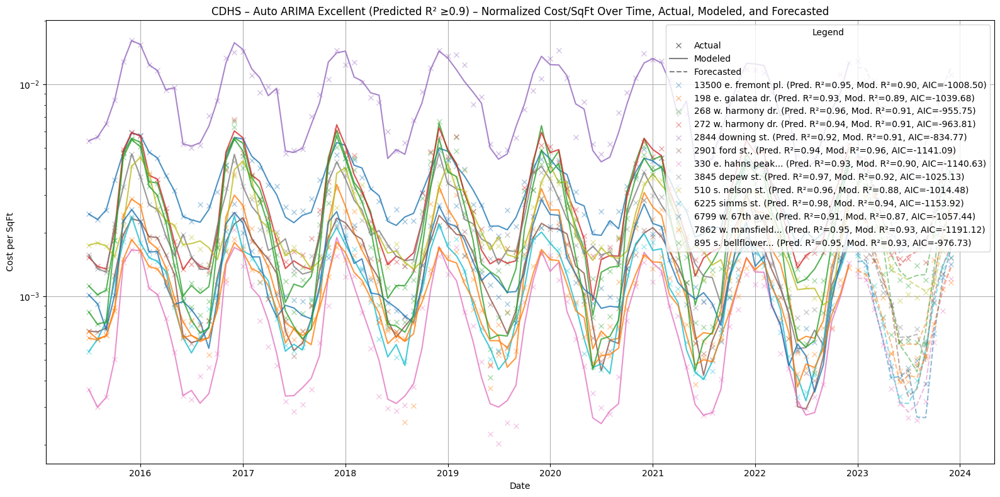

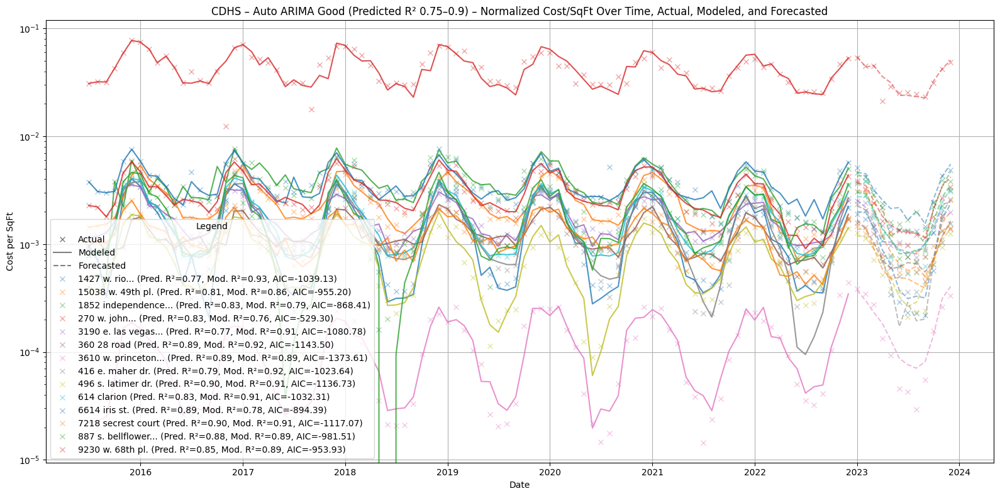

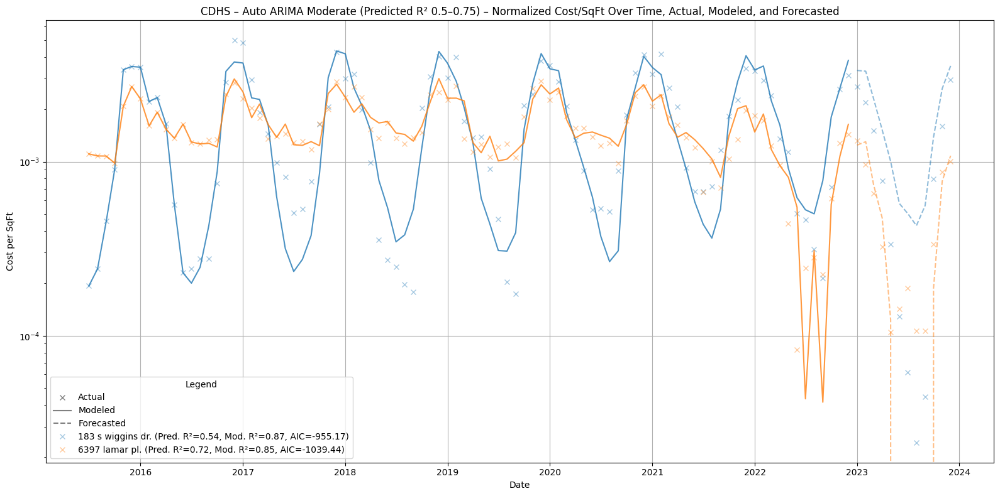

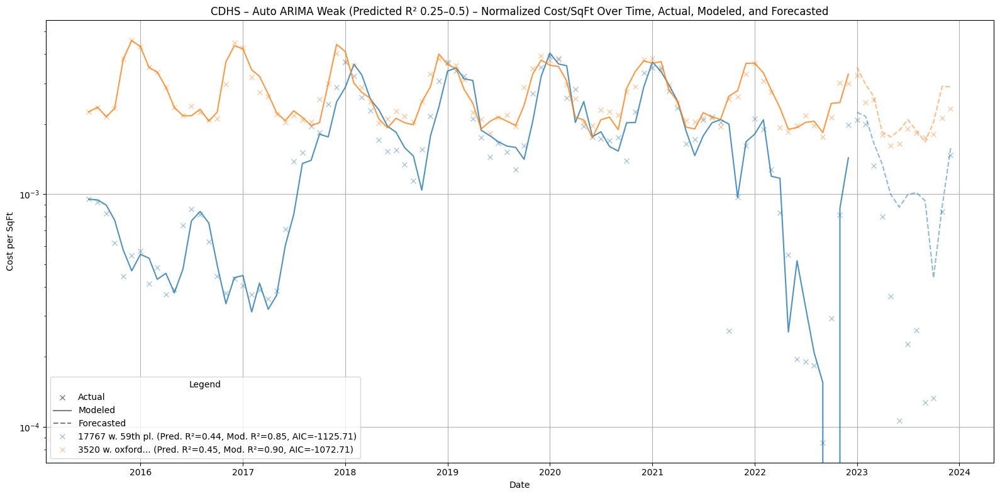

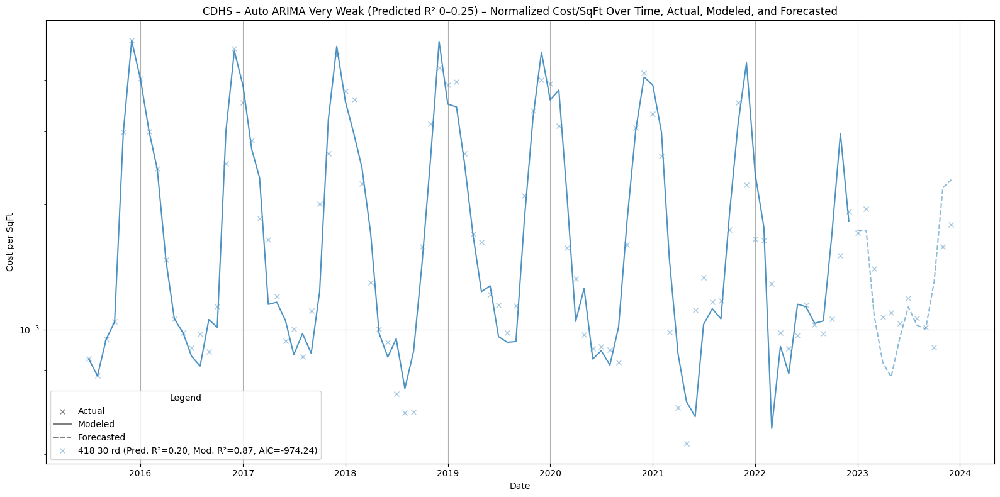

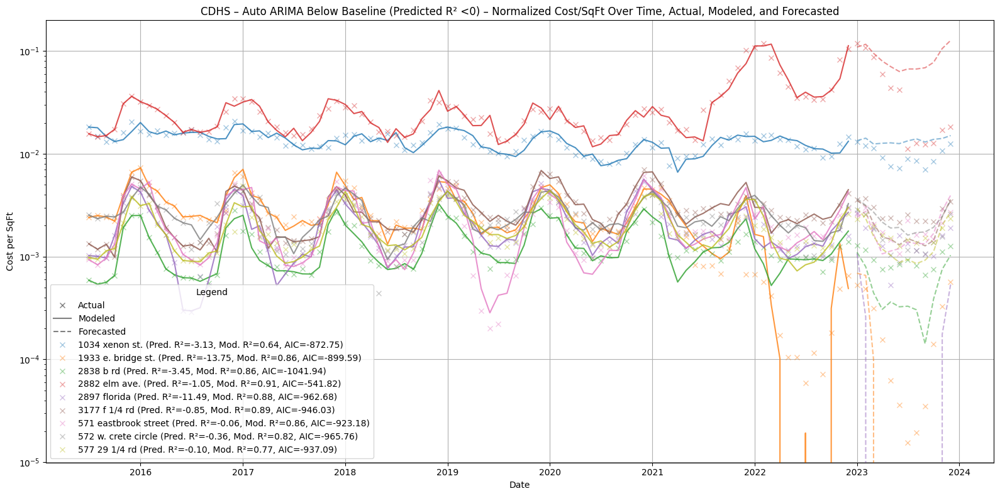

In [ ]:
# CDHS  Group buildings by predicted R² for Auto ARIMA

cdhs_auto_categories = group_buildings_by_r2(normalized_chds_with_lot_size,
    auto_error_cdhs_df)

# Plot grouped forecast results from SARIMAX (with weather)
plot_grouped_sarima_results(
    categories=cdhs_auto_categories,
    error_df=auto_error_cdhs_df,
    forecast_df=forecast_df,
    modeled_data=modeled_data,
    scaling_factor=1.0,
    title_prefix="CDHS – Auto ARIMA "
)

In [ ]:
forecast_df, failed_buildings, ts, error_metrics, modeled_data = backtest_auto_arima(normalized_dpa_with_lot_size)

Processing 1525 sherman st.

ARIMA(2,0,2)(1,1,1)[12] with drift        :-424.21807419289513

ARIMA(0,0,0)(0,1,0)[12] with drift        :-438.14503071463423

ARIMA(1,0,0)(1,1,0)[12] with drift        :-453.4835093367802

ARIMA(0,0,1)(0,1,1)[12] with drift        :-454.4574575253741

ARIMA(0,0,0)(0,1,0)[12]                   :-439.9018788431532

ARIMA(0,0,1)(0,1,0)[12] with drift        :-447.5796979619464

ARIMA(0,0,1)(1,1,1)[12] with drift        :-444.87326750541604

ARIMA(0,0,1)(0,1,2)[12] with drift        :-455.2289594724373

ARIMA(0,0,1)(1,1,2)[12] with drift        :-448.3703260163032

ARIMA(0,0,0)(0,1,2)[12] with drift        :-448.6643281340933

ARIMA(1,0,1)(0,1,2)[12] with drift        :-460.26691008716426

ARIMA(1,0,1)(0,1,1)[12] with drift        :-460.0961501188964

ARIMA(1,0,1)(1,1,2)[12] with drift        :-454.4115497067531

ARIMA(1,0,1)(1,1,1)[12] with drift        :-452.043620455704

ARIMA(1,0,0)(0,1,2)[12] with drift        :-460.5423294255867

ARIMA(1,0,0)(0,1,1)[12]

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-424.21807419289513

ARIMA(0,0,0)(0,1,0)[12] with drift        :-438.14503071463423

ARIMA(1,0,0)(1,1,0)[12] with drift        :-453.4835093367802

ARIMA(0,0,1)(0,1,1)[12] with drift        :-454.4574575253741

ARIMA(0,0,0)(0,1,0)[12]                   :-439.9018788431532

ARIMA(0,0,1)(0,1,0)[12] with drift        :-447.5796979619464

ARIMA(0,0,1)(1,1,1)[12] with drift        :-444.87326750541604

ARIMA(0,0,1)(0,1,2)[12] with drift        :-455.2289594724373

ARIMA(0,0,1)(1,1,2)[12] with drift        :-448.3703260163032

ARIMA(0,0,0)(0,1,2)[12] with drift        :-448.6643281340933

ARIMA(1,0,1)(0,1,2)[12] with drift        :-460.26691008716426

ARIMA(1,0,1)(0,1,1)[12] with drift        :-460.0961501188964

ARIMA(1,0,1)(1,1,2)[12] with drift        :-454.4115497067531

ARIMA(1,0,1)(1,1,1)[12] with drift        :-452.043620455704

ARIMA(1,0,0)(0,1,2)[12] with drift        :-460.5423294255867

ARIMA(1,0,0)(0,1,1)[12] with drift        :-459.420

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,0,1)[12] with drift        :inf

ARIMA(0,1,0) with drift        :-649.2358167958678

ARIMA(1,1,0)(1,0,0)[12] with drift        :-650.7819248589391

ARIMA(0,1,1)(0,0,1)[12] with drift        :-650.7353823626513

ARIMA(0,1,0)                   :-651.329135363935

ARIMA(0,1,0)(1,0,0)[12] with drift        :-647.2321869874423

ARIMA(0,1,0)(0,0,1)[12] with drift        :-647.2128775354096

ARIMA(0,1,0)(1,0,1)[12] with drift        :-639.8151600044182

ARIMA(1,1,0) with drift        :-649.8084564480408

ARIMA(0,1,1) with drift        :-650.0104844413071

ARIMA(1,1,1) with drift        :-661.7544323543118

ARIMA(1,1,1)(1,0,0)[12] with drift        :-661.3212303743147

ARIMA(1,1,1)(0,0,1)[12] with drift        :-662.206640282864

ARIMA(1,1,1)(1,0,1)[12] with drift        :inf

ARIMA(1,1,1)(0,0,2)[12] with drift        :-661.6299703429049

ARIMA(1,1,1)(1,0,2)[12] with drift        :inf

ARIMA(1,1,0)(0,0,1)[12] with drift        :-650.1921379808533

ARIMA(2,1,1)(0,0,1)[12] with d

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,0,1)[12] with non-zero mean:inf

ARIMA(0,0,0) with non-zero mean:-717.7721144903537

ARIMA(1,0,0)(1,0,0)[12] with non-zero mean:-758.8288444549078

ARIMA(0,0,1)(0,0,1)[12] with non-zero mean:-748.6515770811218

ARIMA(0,0,0) with zero mean    :-546.3516264208292

ARIMA(1,0,0) with non-zero mean:-760.471792608538

ARIMA(1,0,0)(0,0,1)[12] with non-zero mean:-758.7739619573136

ARIMA(1,0,0)(1,0,1)[12] with non-zero mean:-756.9370020028176

ARIMA(2,0,0) with non-zero mean:-759.0182959704499

ARIMA(1,0,1) with non-zero mean:-758.7657576930812

ARIMA(0,0,1) with non-zero mean:-748.0574639573498

ARIMA(2,0,1) with non-zero mean:-758.9214175503738

ARIMA(1,0,0) with zero mean    :-743.9221186357129
Now re-fitting the best model(s) without approximations...


ARIMA(1,0,0) with non-zero mean:-760.471792608538
Optimal parameters: ARIMA(1,0,0) with non-zero mean
Processing 201 e. colfax ave. / 1530 sherman

ARIMA(2,1,2)(1,0,1)[12] with drift        :inf

ARIMA(0,1,0) with drift     

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,1,2)(1,0,1)[12] with drift        :inf

ARIMA(0,1,0) with drift        :-854.4395473819084

ARIMA(1,1,0)(1,0,0)[12] with drift        :-887.4881491281986

ARIMA(0,1,1)(0,0,1)[12] with drift        :-883.7987695781918

ARIMA(0,1,0)                   :-856.2196894138193

ARIMA(1,1,0) with drift        :-870.5046249939842

ARIMA(1,1,0)(2,0,0)[12] with drift        :-885.9071233360431

ARIMA(1,1,0)(1,0,1)[12] with drift        :inf

ARIMA(1,1,0)(0,0,1)[12] with drift        :-880.505463811218

ARIMA(1,1,0)(2,0,1)[12] with drift        :-873.8325890718929

ARIMA(0,1,0)(1,0,0)[12] with drift        :-859.4648171390247

ARIMA(2,1,0)(1,0,0)[12] with drift        :-888.105515988968

ARIMA(2,1,0) with drift        :-868.8022129337493

ARIMA(2,1,0)(2,0,0)[12] with drift        :-886.9036560021614

ARIMA(2,1,0)(1,0,1)[12] with drift        :inf

ARIMA(2,1,0)(0,0,1)[12] with drift        :-879.288244395386

ARIMA(2,1,0)(2,0,1)[12] with drift        :inf

ARIMA(3,1,0)(1,0,0)[12] with drift 

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,0,1)[12] with non-zero mean:-1152.9691185543472

ARIMA(0,0,0) with non-zero mean:-1158.5029682667143

ARIMA(1,0,0)(1,0,0)[12] with non-zero mean:-1158.6538828345044

ARIMA(0,0,1)(0,0,1)[12] with non-zero mean:-1157.5673707263056

ARIMA(0,0,0) with zero mean    :-969.3596005070835

ARIMA(1,0,0) with non-zero mean:-1156.470879454265

ARIMA(1,0,0)(2,0,0)[12] with non-zero mean:-1157.4915914851797

ARIMA(1,0,0)(1,0,1)[12] with non-zero mean:-1156.9745852509552

ARIMA(1,0,0)(0,0,1)[12] with non-zero mean:-1157.4735646090721

ARIMA(1,0,0)(2,0,1)[12] with non-zero mean:-1156.1738954654302

ARIMA(0,0,0)(1,0,0)[12] with non-zero mean:-1160.6320813427815

ARIMA(0,0,0)(2,0,0)[12] with non-zero mean:-1160.402774361398

ARIMA(0,0,0)(1,0,1)[12] with non-zero mean:-1159.1863443693028

ARIMA(0,0,0)(0,0,1)[12] with non-zero mean:-1159.4784769407242

ARIMA(0,0,0)(2,0,1)[12] with non-zero mean:inf

ARIMA(0,0,1)(1,0,0)[12] with non-zero mean:-1158.7604410600084

ARIMA(1,0,1)(1,0,0)[12] wit

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,0,1)[12] with non-zero mean:inf

ARIMA(0,0,0) with non-zero mean:-651.8959743622382

ARIMA(1,0,0)(1,0,0)[12] with non-zero mean:-672.2577910298747

ARIMA(0,0,1)(0,0,1)[12] with non-zero mean:-667.3540486997822

ARIMA(0,0,0) with zero mean    :-538.3049849692267

ARIMA(1,0,0) with non-zero mean:-672.3485703849334

ARIMA(1,0,0)(0,0,1)[12] with non-zero mean:-672.1369607254134

ARIMA(1,0,0)(1,0,1)[12] with non-zero mean:inf

ARIMA(2,0,0) with non-zero mean:-670.3385669046985

ARIMA(1,0,1) with non-zero mean:-670.2682983318865

ARIMA(0,0,1) with non-zero mean:-666.5313563188796

ARIMA(2,0,1) with non-zero mean:-668.4608278854489

ARIMA(1,0,0) with zero mean    :-652.137821832448
Now re-fitting the best model(s) without approximations...


ARIMA(1,0,0) with non-zero mean:-672.3485703849334
Optimal parameters: ARIMA(1,0,0) with non-zero mean
Processing 400 e 8th ave.

ARIMA(2,0,2)(1,1,1)[12] with drift        :-819.3576324668546

ARIMA(0,0,0)(0,1,0)[12] with drift        :-84

Forecast:   0%|          | 0/1 [00:00<?, ?it/s]


ARIMA(2,0,2)(1,1,1)[12] with drift        :-819.3576324668546

ARIMA(0,0,0)(0,1,0)[12] with drift        :-840.9134550938048

ARIMA(1,0,0)(1,1,0)[12] with drift        :-836.5963118665527

ARIMA(0,0,1)(0,1,1)[12] with drift        :-845.8688916055855

ARIMA(0,0,0)(0,1,0)[12]                   :-842.3384694617547

ARIMA(0,0,1)(0,1,0)[12] with drift        :-838.7491307694804

ARIMA(0,0,1)(1,1,1)[12] with drift        :-838.474212007948

ARIMA(0,0,1)(0,1,2)[12] with drift        :-843.6358494473126

ARIMA(0,0,1)(1,1,0)[12] with drift        :-838.8617367405272

ARIMA(0,0,1)(1,1,2)[12] with drift        :inf

ARIMA(0,0,0)(0,1,1)[12] with drift        :-838.7491307694804

ARIMA(1,0,1)(0,1,1)[12] with drift        :-843.777166291189

ARIMA(0,0,2)(0,1,1)[12] with drift        :-843.8670750872287

ARIMA(1,0,0)(0,1,1)[12] with drift        :-845.876599446867

ARIMA(1,0,0)(0,1,0)[12] with drift        :-840.2640921232041

ARIMA(1,0,0)(1,1,1)[12] with drift        :-836.1097632692744

ARIMA(1,0

[]

In [ ]:
error_df_dpa = pd.DataFrame(error_metrics)

auto_error_dpa_df = error_df_dpa.copy()

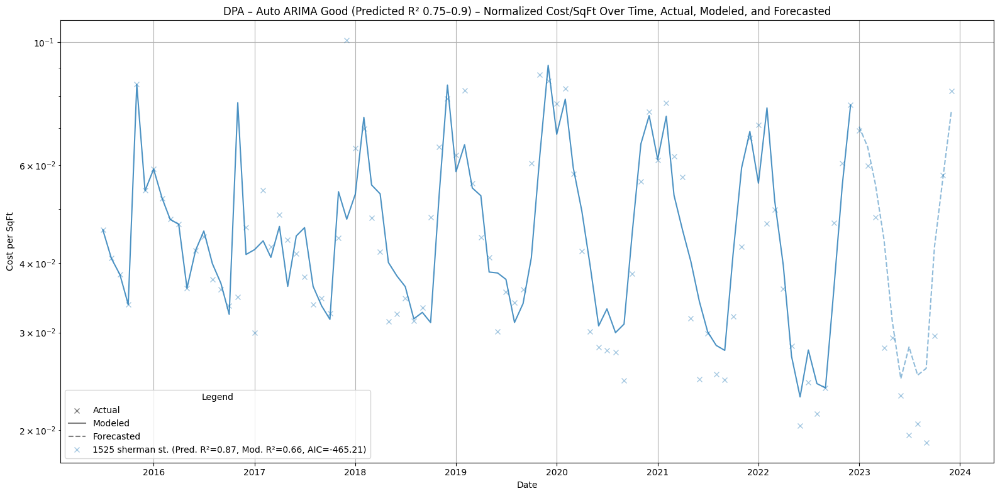

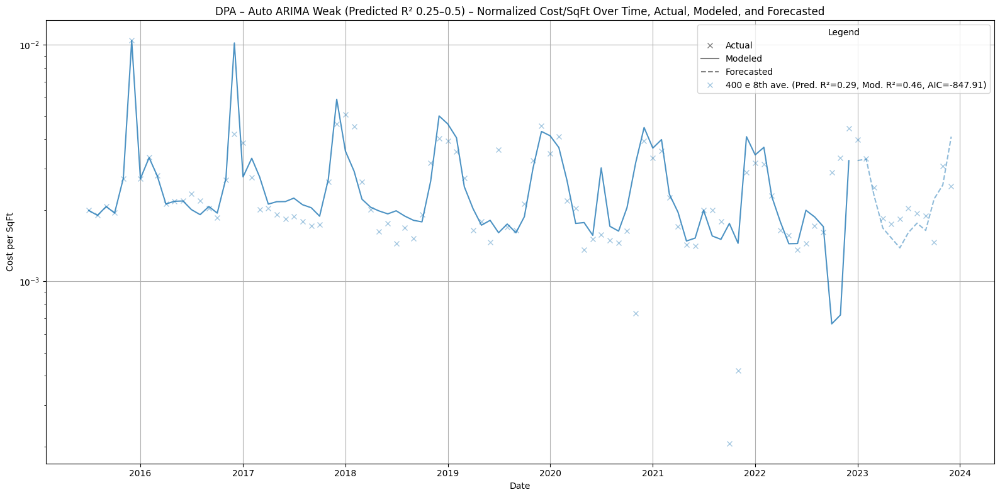

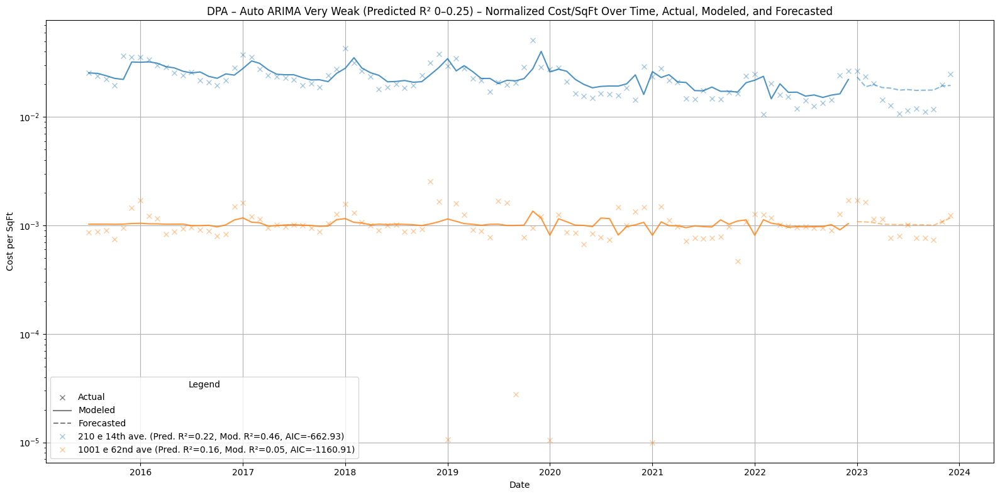

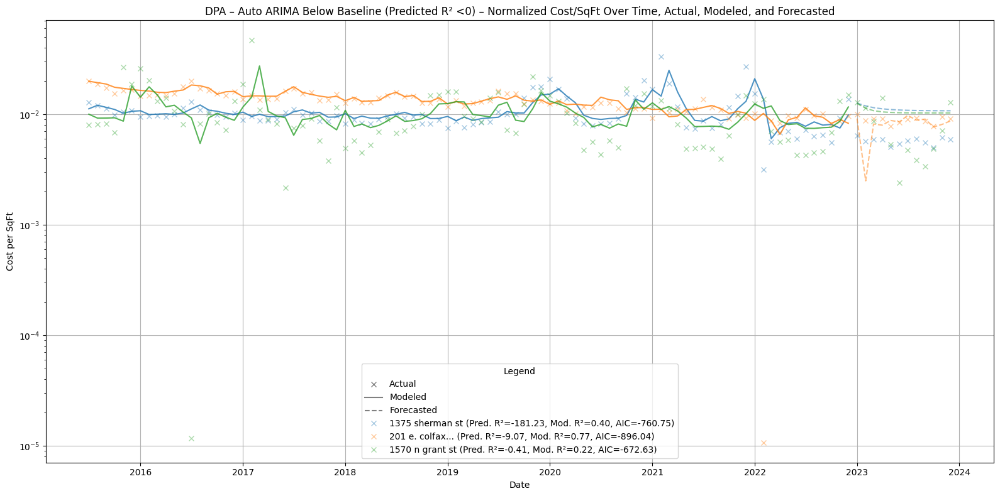

In [ ]:
# CDHS  Group buildings by predicted R² for Auto ARIMA

dpa_auto_categories = group_buildings_by_r2(normalized_dpa_with_lot_size,
    auto_error_dpa_df)

# Plot grouped forecast results from SARIMAX (with weather)
plot_grouped_sarima_results(
    categories=dpa_auto_categories,
    error_df=auto_error_dpa_df,
    forecast_df=forecast_df,
    modeled_data=modeled_data,
    scaling_factor=1.0,
    title_prefix="DPA – Auto ARIMA "
)

### Model Comparison

In [ ]:
# Columns to keep
keep_cols = ['Address', 'Predicted R²', 'Modeled R²', 'AIC']

# Rename and filter relevant columns
sarima_filtered = sarima_error_cdhs_df[[col for col in sarima_error_cdhs_df.columns if col in keep_cols]].rename(
    columns={col: f"{col}_SARIMA" for col in sarima_error_cdhs_df.columns if col != 'Address' and col in keep_cols})

weather_filtered = weather_error_cdhs_df[[col for col in weather_error_cdhs_df.columns if col in keep_cols]].rename(
    columns={col: f"{col}_Weather" for col in weather_error_cdhs_df.columns if col != 'Address' and col in keep_cols})

auto_filtered = auto_error_cdhs_df[[col for col in auto_error_cdhs_df.columns if col in keep_cols]].rename(
    columns={col: f"{col}_AutoSARIMA" for col in auto_error_cdhs_df.columns if col != 'Address' and col in keep_cols})

# Merge all three DataFrames on 'Address'
comparison_df = sarima_filtered.merge(weather_filtered, on='Address', how='outer')
comparison_df = comparison_df.merge(auto_filtered, on='Address', how='outer')

print('CDHS Comparison DF:\n')
display(comparison_df)

CDHS Comparison DF:



,Address,Predicted R²_SARIMA,Modeled R²_SARIMA,AIC_SARIMA,Predicted R²_Weather,Modeled R²_Weather,AIC_Weather,Predicted R²_AutoSARIMA,Modeled R²_AutoSARIMA,AIC_AutoSARIMA
0,1034 xenon st.,-0.605759,0.022048,-737.264299,-0.583243,0.009675,-739.801034,-3.132585,0.643282,-872.752725
1,13500 e. fremont pl.,0.898463,0.677555,-940.529271,NaN,NaN,NaN,0.948804,0.903742,-1008.501360
2,1427 w. rio grande st.,0.872424,0.799272,-990.179887,0.838131,0.823187,-1022.632455,0.770957,0.933105,-1039.128480
3,15038 w. 49th pl.,0.409465,0.739107,-935.275285,-2.070730,0.709018,-922.951071,0.808096,0.856930,-955.198576
4,17767 w. 59th pl.,0.794219,0.838747,-951.193206,0.761946,0.823494,-947.618529,0.437565,0.854439,-1125.713019
5,183 s wiggins dr.,0.873122,0.765398,-907.718765,0.895335,0.759861,-911.296298,0.540365,0.874999,-955.166196
6,1852 independence st.,0.693474,0.516961,-836.003539,0.680339,0.582957,-850.682168,0.830003,0.790793,-868.409108
7,1933 e. bridge st.,-36.629278,0.737694,-885.755257,-31.728570,0.737552,-894.941193,-13.754796,0.858501,-899.585690
8,198 e. galatea dr.,-1.246435,-0.233216,-830.913497,0.883041,0.781849,-998.926889,0.932165,0.894698,-1039.684311
9,268 w. harmony dr.,0.933774,0.732574,-880.059122,0.960665,0.800971,-914.369097,0.959396,0.909546,-955.753030


In [ ]:
# Columns to keep
keep_cols = ['Address', 'Predicted R²', 'Modeled R²', 'AIC']

# Rename and filter relevant columns
sarima_filtered = sarima_dpa_error_df[[col for col in sarima_dpa_error_df.columns if col in keep_cols]].rename(
    columns={col: f"{col}_SARIMA" for col in sarima_dpa_error_df.columns if col != 'Address' and col in keep_cols})

weather_filtered = weather_error_dpa_df[[col for col in weather_error_dpa_df.columns if col in keep_cols]].rename(
    columns={col: f"{col}_Weather" for col in weather_error_dpa_df.columns if col != 'Address' and col in keep_cols})

auto_filtered = auto_error_dpa_df[[col for col in auto_error_dpa_df.columns if col in keep_cols]].rename(
    columns={col: f"{col}_AutoSARIMA" for col in auto_error_dpa_df.columns if col != 'Address' and col in keep_cols})

# Merge all three DataFrames on 'Address'
comparison_df = sarima_filtered.merge(weather_filtered, on='Address', how='outer')
comparison_df = comparison_df.merge(auto_filtered, on='Address', how='outer')

print('DPA Comparison DF:\n')
display(comparison_df)

DPA Comparison DF:



,Address,Predicted R²_SARIMA,Modeled R²_SARIMA,AIC_SARIMA,Predicted R²_Weather,Modeled R²_Weather,AIC_Weather,Predicted R²_AutoSARIMA,Modeled R²_AutoSARIMA,AIC_AutoSARIMA
0,1001 e 62nd ave,-0.326397,-0.333339,-1032.179727,-0.019685,-0.592492,-952.119775,0.162029,0.052303,-1160.911151
1,1375 sherman st,-18.824920,0.092141,-662.245695,-158.128836,0.220225,-609.551855,-181.230531,0.395728,-760.750862
2,1525 sherman st.,0.757366,0.221668,-464.800991,0.761124,0.322456,-441.966875,0.867103,0.655193,-465.214882
3,1570 n grant st,0.164007,-0.339086,-579.942398,0.498641,-0.206581,-548.794698,-0.411922,0.224166,-672.627640
4,201 e. colfax ave. / 1530 sherman,-10.293363,0.014185,-816.329316,-12.565280,0.171093,-767.807273,-9.071643,0.772069,-896.035092
5,210 e 14th ave.,0.489474,0.047386,-589.435901,0.865959,0.170677,-567.843059,0.219470,0.456868,-662.929532
6,400 e 8th ave.,-9.148156,-1.433012,-842.481724,-3.932963,-0.996046,-771.356963,0.291317,0.461716,-847.910757


The **Akaike Information Criterion (AIC)** evaluates the relative quality of statistical models by balancing **model fit** and **complexity**.

**Formula**

AIC = 2k - 2 ln(L), where:
- \( k \) = Number of parameters (model complexity)
- \( L \) = Maximized likelihood (how well the model fits)

- **Model Fit vs. Complexity**:
  - **\( 2k \)** penalizes model complexity (more parameters).
  - **\( -2 ln(L) \)** rewards model fit (higher likelihood).
  
  A lower (or more negative) AIC favors a balance between a good fit and model simplicity.

**Overfitting & Underfitting**

- **Overfitting**: Too many parameters can lead to a high R^2 but a high AIC, indicating a model that overfits and generalizes poorly.
- **Underfitting**: A simpler model with fewer parameters may not fit the data well but could generalize better, though AIC penalizes models with poor fit.

**Generalizability vs. Accuracy**

- **Accuracy**: A higher R^2 on training data doesn't guarantee good performance on new data.
- **Generalizability**: A simpler model with a lower AIC might generalize better to unseen data.

**Conclusion**

We can notice a more negative AIC in each of the Auto ARIMA models, and while a lower AIC isn't always indicative of a better model, it generally balances accuracy and model complexity. With this said, our Auto ARIMA models are our best of the three models when considering the overfitting and accuracy tradeoff.

In [ ]:
# Delete dfs which would be irrelevant moving forward

del sarima_error_cdhs_df, weather_error_cdhs_df, auto_error_cdhs_df, sarima_dpa_error_df, \
    weather_error_dpa_df, auto_error_dpa_df

In [ ]:
# Computational Space

comparison_df.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7 entries, 0 to 6
Data columns (total 10 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Address                  7 non-null      object 
 1   Predicted R²_SARIMA      7 non-null      float64
 2   Modeled R²_SARIMA        7 non-null      float64
 3   AIC_SARIMA               7 non-null      float64
 4   Predicted R²_Weather     7 non-null      float64
 5   Modeled R²_Weather       7 non-null      float64
 6   AIC_Weather              7 non-null      float64
 7   Predicted R²_AutoSARIMA  7 non-null      float64
 8   Modeled R²_AutoSARIMA    7 non-null      float64
 9   AIC_AutoSARIMA           7 non-null      float64
dtypes: float64(9), object(1)
memory usage: 1.1 KB


# 7. Conclusions:

**Personal Takeaways**

**Manuela Carrasco -** My biggest takeaway from this project is the continuous innovation occurring in computer science and machine learning. Despite having a limited background in the field, I was able to learn about machine learning and modeling data, largely due to the collaborative efforts with my teammates. Working with real-world data elevated the importance of our work, and we collectively strived to present the best results possible. Overall, this experience was very challenging and rewarding.

**Andrew Ebert -** Throughout this project I have learned a lot about working on a real world project with real world data. In other courses and projects I am used to working with data which is either theoretical or needs minimal manipulation. That was not the case for this project, as a good portion of our time spent involved processing and reformatting our data for various reasons. We also didn't have the luxury of implementing one model that worked perfectly, but instead continued to research and finetune our best models. Also, doing a top-down approach in a Colab notebook, instead of having several files and classes, was a bit different than what I'm used to. Overall, I have learned more about the types of issues that come up in real world Data Science projects, and have learned new tools and libraries to help overcome these issues.

**Silas Torres -** Working on this project has taught me how to work with and deeply explore real world data. This experience has provided valuable insight into the challenges of working with real world data. This project was able to help me refine and improve upon my graphing, research, and analysis skills. Before this project, modeling data was completely new to me. Working with SARIMA gave me a deeper understanding of our dataset and showed me how modeling can help uncover insights from the data we have. Though our models weren't always the best fit, it was a valuable experience to problem-solve and work on improving them. In totality, I have been able to learn a lot from this project and gain experience with a real world problem to solve with a team.

**Reader Takeaways**

This notebook analyzed the total utility costs of over 50 buildings using machine learning methods such as linear regression and SARIMAX to inform funding allocation decisions. Our goal was to create a reproducible analysis that highlights buildings with the greatest need based on cost trends and efficiency patterns. In several cases, the models closely tracked historical cost trends, indicating their potential usefulness for future utility forecasting and funding prioritization.

**Results and Supporting Evidence**

Our primary goal was to identify buildings with the greatest need for funding. Through visualization and linear regression models, we face challenges in achieving this objective. Initially, we expected to observe growth in utility costs, but this trend was difficult to identify or verify using our models, as many of the $R^2$ values were negative or fell below an acceptable threshold. We suspect this is due to the data not exhibiting a linear relationship, which limits the effectiveness of linear modeling.

In our analysis, data wrangling techniques allowed us to group buildings by key indicators such as highest cost per square foot, highest cost variance, and overall costliness. To deepen our understanding and forecast future trends, we implemented SARIMA and SARIMAX models. These models confirmed that certain buildings are likely to continue experiencing similar or rising costs. However, the models appeared to overfit the data, producing unrealistically strong performance not typically seen in real-world scenarios. Moreover, evaluation metrics varied widely—from poor to excellent—suggesting inconsistencies in predictive quality.

Due to time constraints, we were unable to fully decompose the time series or apply robust parameter selection methods. As a workaround, we transitioned to using Auto ARIMA, which automatically selected parameters for our time series models. This improved our forecasting results and allowed us to categorize model performance more effectively. We also included more appropiate meassures of performace such as AIC scores.

**Issues and Future Considerations**

While some of our models for specific buildings have seen considerable improvement from the base models, there are still buildings that are not being properly modeled and forecasted. Indeed, there are some that would be reasonable to use when looking to future forecasted trends, but this is not the case for all buildings. That said, some of the modeled buildings still need work.

Additionally, with the use of certain plots and visual aids, we hope that trends in the data can be observed, and ultimately used for targeting buildings with certain underlying features. We hope that this project can be built upon and used given a range of plots and models that can be further improved.

#References

<a name="regression-id"></a>

#### Model Evaluation Metrics

Chicco, D., Warrens, M. J., & Jurman, G. (2021). The coefficient of determination R-squared is more informative than SMAPE, MAE, MAPE, MSE and RMSE in regression analysis evaluation. *PeerJ Computer Science, 7*, e623. https://doi.org/10.7717/peerj-cs.623


#### Statistical Methods & Resources

Bajaj, A. (2022, November 14). *ARIMA & SARIMA: Real-World Time Series Forecasting*. Neptune.ai. https://neptune.ai/blog/arima-sarima-real-world-time-series-forecasting-guide

Penn State. (n.d.). *STAT 501: Regression Methods*. STAT ONLINE. https://online.stat.psu.edu/stat501/

Seabold, S., & Perktold, J. (n.d.). *Examples - statsmodels 0.14.4*. statsmodels. https://www.statsmodels.org/stable/examples/index.html#time-series-analysis

Penn State. (n.d.). *STAT 510: Applied Time Series Analysis*. STAT ONLINE. https://online.stat.psu.edu/stat510/lesson/4/4.1


<a name="auto_arima-id"></a>

####Time Series Forecasting Techniques

Nixtla. (n.d.). *AutoARIMA Model - StatsForecast Documentation*. Nixtlaverse. https://nixtlaverse.nixtla.io/statsforecast/docs/models/autoarima.html
